# Compare networks on ImageNet

In this notebook we show how one can use **iNNvestigate** to analyze the prediction of *different* ImageNet-models!

This notebook is an extension of the [Comparing networks on ImagenNet](imagenet_network_comparison.ipynb) notebook.

-----


Note this script is fairly slow, because we are rebuilding models times analysis methods many computational graphs.

-----

**To use this notebook please download the example images using the following script:**

`innvestigate/examples/images/wget_imagenet_2011_samples.sh`

## Imports

In [1]:
#%load_ext autoreload
#%autoreload 2

import warnings
warnings.simplefilter('ignore')

In [3]:
%matplotlib inline  

import imp
import numpy as np
import os

import tensorflow.keras as keras
import tensorflow.keras.backend as keras_backend
import tensorflow.keras.models as keras_models

import innvestigate
import innvestigate.applications.imagenet
import innvestigate.utils as iutils

# Use utility libraries to focus on relevant iNNvestigate routines.
eutils = imp.load_source("utils", "../utils.py")
imgnetutils = imp.load_source("utils_imagenet", "../utils_imagenet.py")

# We create many graphs, let's not run out of memory.
#if keras.backend.backend() == "tensorflow":
#    config = keras.backend.tf.ConfigProto()
#    config.gpu_options.allow_growth = True
#    keras.backend.set_session(keras.backend.tf.Session(config=config))

## Models, data and analyzers

We choose a set of ImageNet models:

In [4]:
# Choose a list of models
netnames = ["vgg16",
            "resnet50",
            "inception_v3",
            "densenet121"]           
n_nets = len(netnames)

The following function will load a specific model, load the data in the respective format and create analyzers for this model.

**For a better understanding of this part we refer to the [Comparing networks on ImagenNet](imagenet_network_comparison.ipynb) notebook, from which this code segment is adopted from.**

In [5]:
def prepare_model_data_and_analyzers(netname):
    # Load the model definition.
    tmp = getattr(innvestigate.applications.imagenet, netname)
    net = tmp(load_weights=True, load_patterns="relu")

    # Build the model.
    model = keras.models.Model(inputs=net["in"], outputs=net["sm_out"])
    model.compile(optimizer="adam", loss="categorical_crossentropy")

    # Handle input depending on model and backend.
    channels_first = keras.backend.image_data_format() == "channels_first"
    color_conversion = "BGRtoRGB" if net["color_coding"] == "BGR" else None

    # Get some example test set images.
    images, label_to_class_name = eutils.get_imagenet_data(net["image_shape"][0])

    if not len(images):
        raise Exception("Please download the example images using: "
                        "'innvestigate/examples/images/wget_imagenet_2011_samples.sh'")

    patterns = net["patterns"]
    input_range = net["input_range"]

    noise_scale = (input_range[1]-input_range[0]) * 0.1

    # Methods we use and some properties.
    methods = [
        # NAME                    OPT.PARAMS                POSTPROC FXN                TITLE
        # Show input.
        ("input",                 {},                       imgnetutils.image,         "Input"),

        # Function
        ("gradient",              {"postprocess": "abs"},   imgnetutils.graymap,       "Gradient"),
        #("smoothgrad",            {"augment_by_n": 16,
        #                           "noise_scale": noise_scale,
        #                           "postprocess": "square"},imgnetutils.graymap,       "SmoothGrad"),

        # Signal
        ("deconvnet",             {},                       imgnetutils.bk_proj,       "Deconvnet"),
        ("guided_backprop",       {},                       imgnetutils.bk_proj,       "Guided Backprop",),
        #("pattern.net",           {"patterns": patterns},   imgnetutils.bk_proj,       "PatternNet"),

        # Interaction
        #("pattern.attribution",   {"patterns": patterns},   imgnetutils.heatmap,       "PatternAttribution"),
        ("deep_taylor.bounded",   {"low": input_range[0],
                                   "high": input_range[1]}, imgnetutils.heatmap,       "DeepTaylor"),
        #("input_t_gradient",      {},                       imgnetutils.heatmap,       "Input * Gradient"),
        #("integrated_gradients",  {"reference_inputs": input_range[0],
        #                           "steps": 16},            imgnetutils.heatmap,       "Integrated Gradients"),
        ("lrp.z",                 {},                       imgnetutils.heatmap,       "LRP-Z"),
        ("lrp.epsilon",           {"epsilon": 1},           imgnetutils.heatmap,       "LRP-Epsilon"),
        ("lrp.sequential_preset_a_flat",{"epsilon": 1},     imgnetutils.heatmap,       "LRP-PresetAFlat"),
        ("lrp.sequential_preset_b_flat",{"epsilon": 1},     imgnetutils.heatmap,       "LRP-PresetBFlat"),
    ]
    
    # Create model without trailing softmax
    model_wo_softmax = iutils.keras.graph.model_wo_softmax(model)

    # Create analyzers.
    analyzers = []
    for method in methods:
        try:
            analyzer = innvestigate.create_analyzer(method[0],        # analysis method identifier
                                                    model_wo_softmax, # model without softmax output
                                                    **method[1])      # optional analysis parameters
        except innvestigate.NotAnalyzeableModelException:
            # Not all methods work with all models.
            analyzer = None
        analyzers.append(analyzer)
        
    return (net, color_conversion, channels_first, images, label_to_class_name,
            methods, model, model_wo_softmax, analyzers,)

## Analysis

Now we analyze each image with the different networks and different analyzers:

In [ ]:
analyses = {}
texts = {}
    
for netname in netnames:
    print("Creating analyses for network {}.".format(netname))
    tmp = prepare_model_data_and_analyzers(netname)
    (net, color_conversion, channels_first, images, label_to_class_name,
     methods, model, model_wo_softmax, analyzers) = tmp
    
    analysis = np.zeros([len(images), len(analyzers)]+net["image_shape"]+[3])
    text = []

    for i, (x, y) in enumerate(images):
        # Add batch axis.
        x = x[None, :, :, :]
        x_pp = imgnetutils.preprocess(x, net)

        # Predict final activations, probabilites, and label.
        presm = model_wo_softmax.predict_on_batch(x_pp)[0]
        prob = model.predict_on_batch(x_pp)[0]
        y_hat = prob.argmax()

        # Save prediction info:
        text.append(("%s" % label_to_class_name[y],    # ground truth label
                     "%.2f" % presm.max(),             # pre-softmax logits
                     "%.2f" % prob.max(),              # probabilistic softmax output  
                     "%s" % label_to_class_name[y_hat] # predicted label
                    ))

        for aidx, analyzer in enumerate(analyzers):
            if methods[aidx][0] == "input":
                # Do not analyze, but keep not preprocessed input.
                a = x / 255
            elif analyzer:
                # Analyze.
                a = analyzer.analyze(x_pp)

                # Apply common postprocessing, e.g., re-ordering the channels for plotting.
                a = imgnetutils.postprocess(a, color_conversion, channels_first)
                # Apply analysis postprocessing, e.g., creating a heatmap.
                a = methods[aidx][2](a)
            else:
                a = np.zeros_like(x)
            # Store the analysis.
            analysis[i, aidx] = a[0]

        analyses[netname] = analysis
        texts[netname] = text

Creating analyses for network vgg16.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.


Instructions for updating:
If using Keras pass *_constraint arguments to layers.


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13be956500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13be956500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13be956500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>: default rule
INFO:tensorflow:Entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>> is not cached for key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13397180d0>, frozenset())


INFO:tensorflow:Entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>> is not cached for key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13397180d0>, frozenset())


Entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>> is not cached for key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13397180d0>, frozenset())
INFO:tensorflow:Converting <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>


INFO:tensorflow:Converting <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>


Converting <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
INFO:tensorflow:Source code of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    return self._apply_reduce(x, axis=self.axis, keepdims=self.keepdims)




INFO:tensorflow:Source code of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    return self._apply_reduce(x, axis=self.axis, keepdims=self.keepdims)




Source code of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    return self._apply_reduce(x, axis=self.axis, keepdims=self.keepdims)


INFO:tensorflow:Compiled output of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    do_return = True
    retval_ = call_scope.mark_return_value(ag__.converted_call(self._apply_reduce, call_scope.callopts, (x,), {'axis': self.axis, 'keepdims': self.keepdims}, call_scope))
  do_return,
  return ag__.retval(retval_)




INFO:tensorflow:Compiled output of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    do_return = True
    retval_ = call_scope.mark_return_value(ag__.converted_call(self._apply_reduce, call_scope.callopts, (x,), {'axis': self.axis, 'keepdims': self.keepdims}, call_scope))
  do_return,
  return ag__.retval(retval_)




Compiled output of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    do_return = True
    retval_ = call_scope.mark_return_value(ag__.converted_call(self._apply_reduce, call_scope.callopts, (x,), {'axis': self.axis, 'keepdims': self.keepdims}, call_scope))
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:213:13, QN: self, DEFINITIONS: (AnnotatedDef[139720544470672],), ORIG_DEFINITIONS: (AnnotatedDef[139720540057936],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=

INFO:tensorflow:Compiled AST of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:213:13, QN: self, DEFINITIONS: (AnnotatedDef[139720544470672],), ORIG_DEFINITIONS: (AnnotatedDef[139720540057936],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:213:19, QN: x, DEFINITIONS: (AnnotatedDef[139720544471248],), ORIG_DEFINITIONS: (AnnotatedDef[139720540058192],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[1397205

Compiled AST of <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:213:13, QN: self, DEFINITIONS: (AnnotatedDef[139720544470672],), ORIG_DEFINITIONS: (AnnotatedDef[139720540057936],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:213:19, QN: x, DEFINITIONS: (AnnotatedDef[139720544471248],), ORIG_DEFINITIONS: (AnnotatedDef[139720540058192],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[139720544846992],)}
| |

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> with
    self: <innvestigate.layers.Max object at 0x7f1338d7ead0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> with
    self: <innvestigate.layers.Max object at 0x7f1338d7ead0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1339295f80> with
    self: <innvestigate.layers.Max object at 0x7f1338d7ead0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d71e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d71e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d71e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>: default rule
INFO:tensorflow:Entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>> is not cached for key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d4b10>, frozenset())


INFO:tensorflow:Entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>> is not cached for key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d4b10>, frozenset())


Entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>> is not cached for key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d4b10>, frozenset())
INFO:tensorflow:Converting <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>


INFO:tensorflow:Converting <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>


Converting <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>
INFO:tensorflow:Source code of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def _apply_reduce(self, x, axis, keepdims):
    return K.max(x, axis=axis, keepdims=keepdims)




INFO:tensorflow:Source code of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def _apply_reduce(self, x, axis, keepdims):
    return K.max(x, axis=axis, keepdims=keepdims)




Source code of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def _apply_reduce(self, x, axis, keepdims):
    return K.max(x, axis=axis, keepdims=keepdims)


INFO:tensorflow:Compiled output of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

# coding=utf-8
def tf___apply_reduce(self, x, axis, keepdims):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('_apply_reduce', '_apply_reduce_scope', ag__.STD) as _apply_reduce_scope:
    do_return = True
    retval_ = _apply_reduce_scope.mark_return_value(ag__.converted_call(K.max, _apply_reduce_scope.callopts, (x,), {'axis': axis, 'keepdims': keepdims}, _apply_reduce_scope))
  do_return,
  return ag__.retval(retval_)




INFO:tensorflow:Compiled output of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

# coding=utf-8
def tf___apply_reduce(self, x, axis, keepdims):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('_apply_reduce', '_apply_reduce_scope', ag__.STD) as _apply_reduce_scope:
    do_return = True
    retval_ = _apply_reduce_scope.mark_return_value(ag__.converted_call(K.max, _apply_reduce_scope.callopts, (x,), {'axis': axis, 'keepdims': keepdims}, _apply_reduce_scope))
  do_return,
  return ag__.retval(retval_)




Compiled output of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

# coding=utf-8
def tf___apply_reduce(self, x, axis, keepdims):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('_apply_reduce', '_apply_reduce_scope', ag__.STD) as _apply_reduce_scope:
    do_return = True
    retval_ = _apply_reduce_scope.mark_return_value(ag__.converted_call(K.max, _apply_reduce_scope.callopts, (x,), {'axis': axis, 'keepdims': keepdims}, _apply_reduce_scope))
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

FunctionDef:
| name=u"tf___apply_reduce"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:22, QN: self, DEFINITIONS: (AnnotatedDef[139720544849808],), ORIG_DEFINITIONS: (AnnotatedDef[139720544472

INFO:tensorflow:Compiled AST of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

FunctionDef:
| name=u"tf___apply_reduce"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:22, QN: self, DEFINITIONS: (AnnotatedDef[139720544849808],), ORIG_DEFINITIONS: (AnnotatedDef[139720544472080],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:28, QN: x, DEFINITIONS: (AnnotatedDef[139720544472720],), ORIG_DEFINITIONS: (AnnotatedDef[139720544469456],)}
| | | Name:
| | | | id=u"axis"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:31, QN: axis, DEFINITIONS: (AnnotatedDef[139720544469200],), ORIG_DEFINITIONS: (AnnotatedDef[139720544471184],)}
| | | Name:
| | | | id=u"keepdims"
| | | | ctx=Param()
| | | | annotation=None
|

Compiled AST of <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d7ead0>>:

FunctionDef:
| name=u"tf___apply_reduce"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:22, QN: self, DEFINITIONS: (AnnotatedDef[139720544849808],), ORIG_DEFINITIONS: (AnnotatedDef[139720544472080],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:28, QN: x, DEFINITIONS: (AnnotatedDef[139720544472720],), ORIG_DEFINITIONS: (AnnotatedDef[139720544469456],)}
| | | Name:
| | | | id=u"axis"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:244:31, QN: axis, DEFINITIONS: (AnnotatedDef[139720544469200],), ORIG_DEFINITIONS: (AnnotatedDef[139720544471184],)}
| | | Name:
| | | | id=u"keepdims"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_a

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338d7ead0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338d7ead0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295e60> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338d7ead0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Whitelisted: <function max at 0x7f1344bc0050>: DoNotConvert rule for tensorflow


INFO:tensorflow:Whitelisted: <function max at 0x7f1344bc0050>: DoNotConvert rule for tensorflow


Whitelisted: <function max at 0x7f1344bc0050>: DoNotConvert rule for tensorflow
INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d71e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d71e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d71e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>: default rule
INFO:tensorflow:Entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>> is not cached for key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d40d0>, frozenset())


INFO:tensorflow:Entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>> is not cached for key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d40d0>, frozenset())


Entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>> is not cached for key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d40d0>, frozenset())
INFO:tensorflow:Converting <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>


INFO:tensorflow:Converting <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>


Converting <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>
INFO:tensorflow:Source code of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    return [K.ones_like(tmp) for tmp in iutils.to_list(x)]




INFO:tensorflow:Source code of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    return [K.ones_like(tmp) for tmp in iutils.to_list(x)]




Source code of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    return [K.ones_like(tmp) for tmp in iutils.to_list(x)]


INFO:tensorflow:Compiled output of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    do_return = True
    retval_ = call_scope.mark_return_value([ag__.converted_call(K.ones_like, call_scope.callopts, (tmp,), None, call_scope) for tmp in ag__.converted_call(iutils.to_list, call_scope.callopts, (x,), None, call_scope)])
  do_return,
  return ag__.retval(retval_)




INFO:tensorflow:Compiled output of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    do_return = True
    retval_ = call_scope.mark_return_value([ag__.converted_call(K.ones_like, call_scope.callopts, (tmp,), None, call_scope) for tmp in ag__.converted_call(iutils.to_list, call_scope.callopts, (x,), None, call_scope)])
  do_return,
  return ag__.retval(retval_)




Compiled output of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    do_return = True
    retval_ = call_scope.mark_return_value([ag__.converted_call(K.ones_like, call_scope.callopts, (tmp,), None, call_scope) for tmp in ag__.converted_call(iutils.to_list, call_scope.callopts, (x,), None, call_scope)])
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:99:13, QN: self, DEFINITIONS: (AnnotatedDef[139720544472720],), ORIG_DEFINITIONS: (AnnotatedDef[139720544485136],)}
| | | Nam

INFO:tensorflow:Compiled AST of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:99:13, QN: self, DEFINITIONS: (AnnotatedDef[139720544472720],), ORIG_DEFINITIONS: (AnnotatedDef[139720544485136],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:99:19, QN: x, DEFINITIONS: (AnnotatedDef[139720544470864],), ORIG_DEFINITIONS: (AnnotatedDef[139720544482576],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[139

Compiled AST of <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339287e90>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:99:13, QN: self, DEFINITIONS: (AnnotatedDef[139720544472720],), ORIG_DEFINITIONS: (AnnotatedDef[139720544485136],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:99:19, QN: x, DEFINITIONS: (AnnotatedDef[139720544470864],), ORIG_DEFINITIONS: (AnnotatedDef[139720544482576],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[139720544485264],)}

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1339287e90>
    x: Tensor("iNNvestigate_max/Max:0", shape=(1, ?), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1339287e90>
    x: Tensor("iNNvestigate_max/Max:0", shape=(1, ?), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd7a0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1339287e90>
    x: Tensor("iNNvestigate_max/Max:0", shape=(1, ?), dtype=float32)

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Entity <function to_list at 0x7f133b3bc290> is not cached for key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339791390>, frozenset())


INFO:tensorflow:Entity <function to_list at 0x7f133b3bc290> is not cached for key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339791390>, frozenset())


Entity <function to_list at 0x7f133b3bc290> is not cached for key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339791390>, frozenset())
INFO:tensorflow:Converting <function to_list at 0x7f133b3bc290>


INFO:tensorflow:Converting <function to_list at 0x7f133b3bc290>


Converting <function to_list at 0x7f133b3bc290>
INFO:tensorflow:Source code of <function to_list at 0x7f133b3bc290>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def to_list(l):
    """ If not list, wraps parameter into a list."""
    if not isinstance(l, list):
        return [l, ]
    else:
        return l




INFO:tensorflow:Source code of <function to_list at 0x7f133b3bc290>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def to_list(l):
    """ If not list, wraps parameter into a list."""
    if not isinstance(l, list):
        return [l, ]
    else:
        return l




Source code of <function to_list at 0x7f133b3bc290>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def to_list(l):
    """ If not list, wraps parameter into a list."""
    if not isinstance(l, list):
        return [l, ]
    else:
        return l


INFO:tensorflow:Compiled output of <function to_list at 0x7f133b3bc290>:

# coding=utf-8
def tf__to_list(l):
  """ If not list, wraps parameter into a list."""
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('to_list', 'to_list_scope', ag__.STD) as to_list_scope:

    def get_state():
      return ()

    def set_state(_):
      pass

    def if_true():
      do_return = True
      retval_ = to_list_scope.mark_return_value([l])
      return do_return, retval_

    def if_false():
      do_return = True
      retval_ = to_list_scope.mark_return_value(l)
      return do_return, retval_
    cond = ag__.n

INFO:tensorflow:Compiled output of <function to_list at 0x7f133b3bc290>:

# coding=utf-8
def tf__to_list(l):
  """ If not list, wraps parameter into a list."""
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('to_list', 'to_list_scope', ag__.STD) as to_list_scope:

    def get_state():
      return ()

    def set_state(_):
      pass

    def if_true():
      do_return = True
      retval_ = to_list_scope.mark_return_value([l])
      return do_return, retval_

    def if_false():
      do_return = True
      retval_ = to_list_scope.mark_return_value(l)
      return do_return, retval_
    cond = ag__.not_(ag__.converted_call(isinstance, to_list_scope.callopts, (l, list), None, to_list_scope))
    do_return, retval_ = ag__.if_stmt(cond, if_true, if_false, get_state, set_state, ('do_return', 'retval_'), ())
  do_return,
  return ag__.retval(retval_)




Compiled output of <function to_list at 0x7f133b3bc290>:

# coding=utf-8
def tf__to_list(l):
  """ If not list, wraps parameter into a list."""
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('to_list', 'to_list_scope', ag__.STD) as to_list_scope:

    def get_state():
      return ()

    def set_state(_):
      pass

    def if_true():
      do_return = True
      retval_ = to_list_scope.mark_return_value([l])
      return do_return, retval_

    def if_false():
      do_return = True
      retval_ = to_list_scope.mark_return_value(l)
      return do_return, retval_
    cond = ag__.not_(ag__.converted_call(isinstance, to_list_scope.callopts, (l, list), None, to_list_scope))
    do_return, retval_ = ag__.if_stmt(cond, if_true, if_false, get_state, set_state, ('do_return', 'retval_'), ())
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <function to_list at 0x7f133b3bc290>:

FunctionDef:
| name=u"tf__to_list"
| args=argu

INFO:tensorflow:Compiled AST of <function to_list at 0x7f133b3bc290>:

FunctionDef:
| name=u"tf__to_list"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"l"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: __init__.py:45:12, QN: l, DEFINITIONS: (AnnotatedDef[139720544227856],), ORIG_DEFINITIONS: (AnnotatedDef[139720544641424],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(l,)}}
| body=[
| | Expr:
| | | value=Str:
| | | | s=u" If not list, wraps parameter into a list."
| | | | ___pyct_anno={'lineno': 6, ORIGIN: __init__.py:46:4}
| | | ___pyct_anno={'lineno': 6, ORIGIN: __init__.py:46:4, SCOPE: Scope{r=(), w=()}, LIVE_VARS_OUT: frozenset({ag__.STD, ag__.if_stmt, to_list_scope.callopts, ag__.FunctionScope, isinstance, ag__, l, ag__.retval, ag__.converted_call, list, ag__.UndefinedReturnValue, to_list_scope.mark_return_value}), LIVE_VARS_IN: frozenset({ag__.STD,

Compiled AST of <function to_list at 0x7f133b3bc290>:

FunctionDef:
| name=u"tf__to_list"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"l"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: __init__.py:45:12, QN: l, DEFINITIONS: (AnnotatedDef[139720544227856],), ORIG_DEFINITIONS: (AnnotatedDef[139720544641424],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(l,)}}
| body=[
| | Expr:
| | | value=Str:
| | | | s=u" If not list, wraps parameter into a list."
| | | | ___pyct_anno={'lineno': 6, ORIGIN: __init__.py:46:4}
| | | ___pyct_anno={'lineno': 6, ORIGIN: __init__.py:46:4, SCOPE: Scope{r=(), w=()}, LIVE_VARS_OUT: frozenset({ag__.STD, ag__.if_stmt, to_list_scope.callopts, ag__.FunctionScope, isinstance, ag__, l, ag__.retval, ag__.converted_call, list, ag__.UndefinedReturnValue, to_list_scope.mark_return_value}), LIVE_VARS_IN: frozenset({ag__.STD, ag__.if_stmt, t

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> with
    l: Tensor("iNNvestigate_max/Max:0", shape=(1, ?), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> with
    l: Tensor("iNNvestigate_max/Max:0", shape=(1, ?), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133927f950> with
    l: Tensor("iNNvestigate_max/Max:0", shape=(1, ?), dtype=float32)

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>, <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>, <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>, <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Whitelisted: <function ones_like at 0x7f1344bbe830>: DoNotConvert rule for tensorflow


INFO:tensorflow:Whitelisted: <function ones_like at 0x7f1344bbe830>: DoNotConvert rule for tensorflow


Whitelisted: <function ones_like at 0x7f1344bbe830>: DoNotConvert rule for tensorflow
INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>, [<tf.Tensor 'ones_like/ones_like:0' shape=(1, ?) dtype=float32>]],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>, [<tf.Tensor 'ones_like/ones_like:0' shape=(1, ?) dtype=float32>]],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max/Max:0' shape=(1, ?) dtype=float32>, [<tf.Tensor 'ones_like/ones_like:0' shape=(1, ?) dtype=float32>]],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e71e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e71e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e71e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bc1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bc1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bc1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt/gradients/iNNvestigate_max/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt/gradients/iNNvestigate_max/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt/gradients/iNNvestigate_max/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396e6710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396e6710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396e6710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'gradient_wrt_1/gradients/dense_1/MatMul_grad/MatMul:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'gradient_wrt_1/gradients/dense_1/MatMul_grad/MatMul:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'gradient_wrt_1/gradients/dense_1/MatMul_grad/MatMul:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969cd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969cd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969cd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d4550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d4550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d4550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396cbd10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'gradient_wrt_2/gradients/fc2/MatMul_grad/MatMul:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'gradient_wrt_2/gradients/fc2/MatMul_grad/MatMul:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'gradient_wrt_2/gradients/fc2/MatMul_grad/MatMul:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396ebd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396ebd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396ebd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396e9fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396e9fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396e9fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradient_wrt_3/gradients/fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradient_wrt_3/gradients/fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradient_wrt_3/gradients/fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339693c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339693c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339693c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339287550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_4/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_4/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_4/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968dbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968dbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968dbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133927c810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133927c810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133927c810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_5/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_5/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_5/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339292500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339292500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339292500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bff10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bff10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bff10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339681650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_6/gradients/block5_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_6/gradients/block5_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_6/gradients/block5_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339680280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339680280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339680280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133927c990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133927c990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133927c990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfc90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    unsupported_features_checker.verify(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_7/gradients/block5_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_7/gradients/block5_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_7/gradients/block5_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d74b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d74b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396d74b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d46d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d46d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396d46d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339671890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_8/gradients/block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_8/gradients/block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_8/gradients/block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e05f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e05f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e05f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396ac950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396ac950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396ac950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bfb90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_9/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_9/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_9/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964f8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964f8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964f8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133966a410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133966a410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133966a410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bff10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_10/gradients/block4_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_10/gradients/block4_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_10/gradients/block4_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339662910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339662910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339662910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396ac510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396ac510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396ac510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_11/gradients/block4_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_11/gradients/block4_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_11/gradients/block4_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133966dc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133966dc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133966dc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395fb150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395fb150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395fb150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bc7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_12/gradients/block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_12/gradients/block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_12/gradients/block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f1410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f1410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f1410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339603210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339603210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339603210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339693190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_13/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_13/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_13/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395fd730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395fd730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395fd730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339610cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339610cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339610cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339695ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_14/gradients/block3_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_14/gradients/block3_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_14/gradients/block3_conv3/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339615910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339615910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339615910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339646d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339646d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339646d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a390>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are n

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_15/gradients/block3_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_15/gradients/block3_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_15/gradients/block3_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969caa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969caa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969caa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133961a710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133961a710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133961a710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966afd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_16/gradients/block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_16/gradients/block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_16/gradients/block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396a61e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396a61e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396a61e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962bad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962bad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962bad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966abd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_17/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_17/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_17/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0d0870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0d0870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0d0870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962a6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962a6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962a6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133966a890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_18/gradients/block2_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_18/gradients/block2_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_18/gradients/block2_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964afa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964afa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964afa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339654f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339654f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339654f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339654c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_19/gradients/block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_19/gradients/block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_19/gradients/block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964ac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964ac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964ac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339629c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339629c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339629c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396ac090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_20/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_20/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_20/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964cbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964cbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133964cbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962a610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962a610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133962a610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396033d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_21/gradients/block1_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_21/gradients/block1_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_21/gradients/block1_conv2/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396590a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396590a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396590a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395caf50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395caf50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395caf50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339603490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339689050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339689050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339689050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395c4710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395c4710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13395c4590>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395c4710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> with
    self: <innvestigate.layers.Max object at 0x7f13395c4590>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> with
    self: <innvestigate.layers.Max object at 0x7f13395c4590>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13396fd710> with
    self: <innvestigate.layers.Max object at 0x7f13395c4590>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396dd6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396dd6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396dd6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395c4c10>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395c4c10>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13395c4590>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13395c4c10>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13395c4590>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13395c4590>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1339295f80> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13395c4590>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_1/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_1/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_1/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_1/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_1/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_1/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339502a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339502a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339502a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133956af10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_23/gradients/iNNvestigate_max_1/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_23/gradients/iNNvestigate_max_1/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_23/gradients/iNNvestigate_max_1/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339516190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339516190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339516190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394efbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradients_1/reversed_fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradients_1/reversed_fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradients_1/reversed_fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133975af50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133975af50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133975af50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133951c990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133951c990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133951c990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339516c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_25/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_25/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_25/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394c0410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394c0410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394c0410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339507150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradients_4/reversed_block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradients_4/reversed_block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradients_4/reversed_block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969cbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969cbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969cbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394e0310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394e0310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394e0310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394bb790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradients_7/reversed_block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradients_7/reversed_block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradients_7/reversed_block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133967ed70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133967ed70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133967ed70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339482990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339482990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339482990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394e70d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradients_10/reversed_block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradients_10/reversed_block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradients_10/reversed_block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e0550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e0550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e0550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394a9ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394a9ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394a9ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339482490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_12/reversed_block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_12/reversed_block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_12/reversed_block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133944a9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133944a9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133944a9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133943ae90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133943ae90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133943ae90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133949ad20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133949ad20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133949ad20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393f7650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393f7650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339462990>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393f7650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> with
    self: <innvestigate.layers.Max object at 0x7f1339462990>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> with
    self: <innvestigate.layers.Max object at 0x7f1339462990>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a08c0> with
    self: <innvestigate.layers.Max object at 0x7f1339462990>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133960f690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133960f690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133960f690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394439d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394439d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339462990>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13394439d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1339462990>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1339462990>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a04d0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1339462990>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_2/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_2/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_2/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_2/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_2/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_2/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339409750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339409750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339409750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339409190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_31/gradients/iNNvestigate_max_2/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_31/gradients/iNNvestigate_max_2/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_31/gradients/iNNvestigate_max_2/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13b822ec80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13b822ec80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13b822ec80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339415490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339415490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339415490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393fd490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradients_16/fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradients_16/fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'gradients_16/fc1/MatMul_grad/MatMul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133966dbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133966dbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133966dbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339413d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339413d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339413d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393adc50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_33/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_33/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_33/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133941d110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133941d110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133941d110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394626d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradients_19/block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradients_19/block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'gradients_19/block5_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0d3460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0d3460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0d3460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393c2310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393c2310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393c2310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339422c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradients_22/block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradients_22/block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'gradients_22/block4_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f1b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f1b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f1b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393e4090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393e4090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393e4090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393e0b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradients_25/block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradients_25/block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'gradients_25/block3_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133967e780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133967e780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133967e780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339388710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339388710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339388710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393bccd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_27/block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_27/block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_27/block2_conv1/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393acb90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393acb90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393acb90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13393a1490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339445f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339445f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339445f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133935f190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133935f190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1339348dd0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133935f190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> with
    self: <innvestigate.layers.Max object at 0x7f1339348dd0>
    x: [<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> with
    self: <innvestigate.layers.Max object at 0x7f1339348dd0>
    x: [<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a04d0> with
    self: <innvestigate.layers.Max object at 0x7f1339348dd0>
    x: [<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339370fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339370fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339370fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339330510>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339330510>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1339348dd0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339330510>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1339348dd0>
    x: [<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1339348dd0>
    x: [<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13394a07a0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1339348dd0>
    x: [<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_3/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_3/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_3/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_3/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>
    args: ([<tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_3/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_3/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339376730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339376730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339376730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339102fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339102fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339102fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_39/gradients/iNNvestigate_max_3/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_39/gradients/iNNvestigate_max_3/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 're_lu/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_39/gradients/iNNvestigate_max_3/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339370d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339370d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339370d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133911ab50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133911ab50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133911ab50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390f6cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>
    args: ([<tf.Tensor 'gradient_wrt_40/gradients/re_lu/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>
    args: ([<tf.Tensor 'gradient_wrt_40/gradients/re_lu/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>
    args: ([<tf.Tensor 'gradient_wrt_40/gradients/re_lu/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395fd7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395fd7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395fd7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>: default rule
INFO:tensorflow:Entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>> is not cached for key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115a10>, frozenset())


INFO:tensorflow:Entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>> is not cached for key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115a10>, frozenset())


Entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>> is not cached for key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115a10>, frozenset())
INFO:tensorflow:Converting <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>


INFO:tensorflow:Converting <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>


Converting <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>
INFO:tensorflow:Source code of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    a, b = x
    return a / (b + iK.to_floatx(K.equal(b, K.constant(0))) * self._factor)




INFO:tensorflow:Source code of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    a, b = x
    return a / (b + iK.to_floatx(K.equal(b, K.constant(0))) * self._factor)




Source code of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    a, b = x
    return a / (b + iK.to_floatx(K.equal(b, K.constant(0))) * self._factor)


INFO:tensorflow:Compiled output of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    a, b = x
    do_return = True
    retval_ = call_scope.mark_return_value(a / (b + ag__.converted_call(iK.to_floatx, call_scope.callopts, (ag__.converted_call(K.equal, call_scope.callopts, (b, ag__.converted_call(K.constant, call_scope.callopts, (0,), None, call_scope)), None, call_scope),), None, call_scope) * self._factor))
 

INFO:tensorflow:Compiled output of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    a, b = x
    do_return = True
    retval_ = call_scope.mark_return_value(a / (b + ag__.converted_call(iK.to_floatx, call_scope.callopts, (ag__.converted_call(K.equal, call_scope.callopts, (b, ag__.converted_call(K.constant, call_scope.callopts, (0,), None, call_scope)), None, call_scope),), None, call_scope) * self._factor))
  do_return,
  return ag__.retval(retval_)




Compiled output of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    a, b = x
    do_return = True
    retval_ = call_scope.mark_return_value(a / (b + ag__.converted_call(iK.to_floatx, call_scope.callopts, (ag__.converted_call(K.equal, call_scope.callopts, (b, ag__.converted_call(K.constant, call_scope.callopts, (0,), None, call_scope)), None, call_scope),), None, call_scope) * self._factor))
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:452:13, QN: self, DEFINIT

INFO:tensorflow:Compiled AST of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:452:13, QN: self, DEFINITIONS: (AnnotatedDef[139720538305424],), ORIG_DEFINITIONS: (AnnotatedDef[139720538207632],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:452:19, QN: x, DEFINITIONS: (AnnotatedDef[139720538308240],), ORIG_DEFINITIONS: (AnnotatedDef[139720538207696],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedD

Compiled AST of <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133911a350>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:452:13, QN: self, DEFINITIONS: (AnnotatedDef[139720538305424],), ORIG_DEFINITIONS: (AnnotatedDef[139720538207632],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:452:19, QN: x, DEFINITIONS: (AnnotatedDef[139720538308240],), ORIG_DEFINITIONS: (AnnotatedDef[139720538207696],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[1397205385886

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133911a350>
    x: [<tf.Tensor 'gradient_wrt_40/gradients/re_lu/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133911a350>
    x: [<tf.Tensor 'gradient_wrt_40/gradients/re_lu/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133911a350>
    x: [<tf.Tensor 'gradient_wrt_40/gradients/re_lu/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Whitelisted: <function constant at 0x7f1344bbe050>: DoNotConvert rule for tensorflow


INFO:tensorflow:Whitelisted: <function constant at 0x7f1344bbe050>: DoNotConvert rule for tensorflow


Whitelisted: <function constant at 0x7f1344bbe050>: DoNotConvert rule for tensorflow
INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add/add:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Whitelisted: <function equal at 0x7f1344bc0d40>: DoNotConvert rule for tensorflow


INFO:tensorflow:Whitelisted: <function equal at 0x7f1344bc0d40>: DoNotConvert rule for tensorflow


Whitelisted: <function equal at 0x7f1344bc0d40>: DoNotConvert rule for tensorflow
INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Entity <function to_floatx at 0x7f133b3b7cb0> is not cached for key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133911a110>, frozenset())


INFO:tensorflow:Entity <function to_floatx at 0x7f133b3b7cb0> is not cached for key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133911a110>, frozenset())


Entity <function to_floatx at 0x7f133b3b7cb0> is not cached for key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133911a110>, frozenset())
INFO:tensorflow:Converting <function to_floatx at 0x7f133b3b7cb0>


INFO:tensorflow:Converting <function to_floatx at 0x7f133b3b7cb0>


Converting <function to_floatx at 0x7f133b3b7cb0>
INFO:tensorflow:Source code of <function to_floatx at 0x7f133b3b7cb0>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def to_floatx(x):
    return K.cast(x, K.floatx())




INFO:tensorflow:Source code of <function to_floatx at 0x7f133b3b7cb0>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def to_floatx(x):
    return K.cast(x, K.floatx())




Source code of <function to_floatx at 0x7f133b3b7cb0>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def to_floatx(x):
    return K.cast(x, K.floatx())


INFO:tensorflow:Compiled output of <function to_floatx at 0x7f133b3b7cb0>:

# coding=utf-8
def tf__to_floatx(x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('to_floatx', 'to_floatx_scope', ag__.STD) as to_floatx_scope:
    do_return = True
    retval_ = to_floatx_scope.mark_return_value(ag__.converted_call(K.cast, to_floatx_scope.callopts, (x, ag__.converted_call(K.floatx, to_floatx_scope.callopts, (), None, to_floatx_scope)), None, to_floatx_scope))
  do_return,
  return ag__.retval(retval_)




INFO:tensorflow:Compiled output of <function to_floatx at 0x7f133b3b7cb0>:

# coding=utf-8
def tf__to_floatx(x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('to_floatx', 'to_floatx_scope', ag__.STD) as to_floatx_scope:
    do_return = True
    retval_ = to_floatx_scope.mark_return_value(ag__.converted_call(K.cast, to_floatx_scope.callopts, (x, ag__.converted_call(K.floatx, to_floatx_scope.callopts, (), None, to_floatx_scope)), None, to_floatx_scope))
  do_return,
  return ag__.retval(retval_)




Compiled output of <function to_floatx at 0x7f133b3b7cb0>:

# coding=utf-8
def tf__to_floatx(x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('to_floatx', 'to_floatx_scope', ag__.STD) as to_floatx_scope:
    do_return = True
    retval_ = to_floatx_scope.mark_return_value(ag__.converted_call(K.cast, to_floatx_scope.callopts, (x, ag__.converted_call(K.floatx, to_floatx_scope.callopts, (), None, to_floatx_scope)), None, to_floatx_scope))
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <function to_floatx at 0x7f133b3b7cb0>:

FunctionDef:
| name=u"tf__to_floatx"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: backend.py:30:14, QN: x, DEFINITIONS: (AnnotatedDef[139720538552528],), ORIG_DEFINITIONS: (AnnotatedDef[139720538552848],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | __

INFO:tensorflow:Compiled AST of <function to_floatx at 0x7f133b3b7cb0>:

FunctionDef:
| name=u"tf__to_floatx"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: backend.py:30:14, QN: x, DEFINITIONS: (AnnotatedDef[139720538552528],), ORIG_DEFINITIONS: (AnnotatedDef[139720538552848],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x,)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[139720538554000],)}
| | | ]
| | | value=NameConstant:
| | | | value=False
| | | ___pyct_anno={SCOPE: Scope{r=(), w=(do_return,)}, LIVE_VARS_IN: frozenset({x, ag__.STD, ag__.FunctionScope, K.cast, ag__, ag__.retval, K.floatx, to_floatx_scope.callopts, ag__.converted_call, K, ag__.UndefinedReturn

Compiled AST of <function to_floatx at 0x7f133b3b7cb0>:

FunctionDef:
| name=u"tf__to_floatx"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: backend.py:30:14, QN: x, DEFINITIONS: (AnnotatedDef[139720538552528],), ORIG_DEFINITIONS: (AnnotatedDef[139720538552848],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x,)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[139720538554000],)}
| | | ]
| | | value=NameConstant:
| | | | value=False
| | | ___pyct_anno={SCOPE: Scope{r=(), w=(do_return,)}, LIVE_VARS_IN: frozenset({x, ag__.STD, ag__.FunctionScope, K.cast, ag__, ag__.retval, K.floatx, to_floatx_scope.callopts, ag__.converted_call, K, ag__.UndefinedReturnValue, to_floatx

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> with
    x: Tensor("safe_divide/Equal:0", shape=(?, 1000), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> with
    x: Tensor("safe_divide/Equal:0", shape=(?, 1000), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390ebdd0> with
    x: Tensor("safe_divide/Equal:0", shape=(?, 1000), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Whitelisted: <function floatx at 0x7f1344b89f80>: DoNotConvert rule for tensorflow


INFO:tensorflow:Whitelisted: <function floatx at 0x7f1344b89f80>: DoNotConvert rule for tensorflow


Whitelisted: <function floatx at 0x7f1344b89f80>: DoNotConvert rule for tensorflow
INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Whitelisted: <function cast at 0x7f1344bbeb00>: DoNotConvert rule for tensorflow


INFO:tensorflow:Whitelisted: <function cast at 0x7f1344bbeb00>: DoNotConvert rule for tensorflow


Whitelisted: <function cast at 0x7f1344bbeb00>: DoNotConvert rule for tensorflow
INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
    args: ([<tf.Tensor 'lambda_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_dense_1/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
    args: ([<tf.Tensor 'lambda_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_dense_1/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
    args: ([<tf.Tensor 'lambda_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_dense_1/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
    args: ([<tf.Tensor 'lambda_35/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_dense_1/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
    args: ([<tf.Tensor 'lambda_35/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_dense_1/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
    args: ([<tf.Tensor 'lambda_35/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_dense_1/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133932d690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133932d690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133932d690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339115250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390ade90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>>
    args: ([<tf.Tensor 'add_1/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>>
    args: ([<tf.Tensor 'add_1/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>>
    args: ([<tf.Tensor 'add_1/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133937e960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133937e960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133937e960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>
    x: [<tf.Tensor 'add_1/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>
    x: [<tf.Tensor 'add_1/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13390adfd0>
    x: [<tf.Tensor 'add_1/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_2/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_1/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_1/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_1/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390cacd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390cacd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390cacd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> with
    x: Tensor("safe_divide_1/Equal:0", shape=(?, 4096), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> with
    x: Tensor("safe_divide_1/Equal:0", shape=(?, 4096), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> with
    x: Tensor("safe_divide_1/Equal:0", shape=(?, 4096), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_1/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_1/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_1/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
    args: ([<tf.Tensor 'lambda_38/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_fc2/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
    args: ([<tf.Tensor 'lambda_38/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_fc2/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
    args: ([<tf.Tensor 'lambda_38/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_fc2/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
    args: ([<tf.Tensor 'lambda_39/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_fc2/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
    args: ([<tf.Tensor 'lambda_39/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_fc2/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
    args: ([<tf.Tensor 'lambda_39/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_fc2/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390bc500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390bc500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390bc500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390c3190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339102ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>>
    args: ([<tf.Tensor 'add_3/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>>
    args: ([<tf.Tensor 'add_3/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>>
    args: ([<tf.Tensor 'add_3/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395ee820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395ee820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395ee820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390dbf90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390dbf90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133950ed50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390dbf90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133950ed50>
    x: [<tf.Tensor 'add_3/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133950ed50>
    x: [<tf.Tensor 'add_3/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13394a00e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133950ed50>
    x: [<tf.Tensor 'add_3/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_4/add:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_2/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_2/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_2/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390d35d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390d35d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390d35d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> with
    x: Tensor("safe_divide_2/Equal:0", shape=(?, 4096), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> with
    x: Tensor("safe_divide_2/Equal:0", shape=(?, 4096), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb7a0> with
    x: Tensor("safe_divide_2/Equal:0", shape=(?, 4096), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_2/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_2/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_2/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
    args: ([<tf.Tensor 'lambda_42/mul:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_fc1/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
    args: ([<tf.Tensor 'lambda_42/mul:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_fc1/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
    args: ([<tf.Tensor 'lambda_42/mul:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_fc1/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133a0cb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390dbd50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390dbd50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390dbd50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
    args: ([<tf.Tensor 'lambda_43/mul:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_fc1/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
    args: ([<tf.Tensor 'lambda_43/mul:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_fc1/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
    args: ([<tf.Tensor 'lambda_43/mul:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_fc1/MatMul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133969c6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390e94d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390e94d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390e94d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339117b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'add_5/add:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'add_5/add:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'add_5/add:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c6b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c6b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c6b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339111910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339111910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339111910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911af50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_44/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_44/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_44/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339672c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339672c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339672c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339047a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339047a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339047a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133911ac50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>>
    args: ([<tf.Tensor 'gradient_wrt_45/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>>
    args: ([<tf.Tensor 'gradient_wrt_45/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>>
    args: ([<tf.Tensor 'gradient_wrt_45/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390760f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390760f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390760f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390abe90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390abe90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133908d150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390abe90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133908d150>
    x: [<tf.Tensor 'gradient_wrt_45/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133908d150>
    x: [<tf.Tensor 'gradient_wrt_45/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133936b200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133908d150>
    x: [<tf.Tensor 'gradient_wrt_45/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_6/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_3/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_3/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_3/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390ab510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390ab510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390ab510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> with
    x: Tensor("safe_divide_3/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> with
    x: Tensor("safe_divide_3/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133936bef0> with
    x: Tensor("safe_divide_3/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_3/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_3/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_3/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
    args: ([<tf.Tensor 'lambda_46/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
    args: ([<tf.Tensor 'lambda_46/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
    args: ([<tf.Tensor 'lambda_46/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e7230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e7230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396e7230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390abf50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390abf50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390abf50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
    args: ([<tf.Tensor 'lambda_47/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
    args: ([<tf.Tensor 'lambda_47/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
    args: ([<tf.Tensor 'lambda_47/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13394d6a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13394d6a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13394d6a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339031fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339031fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339031fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13390e9f90>>


  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>>
    args: ([<tf.Tensor 'add_7/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>>
    args: ([<tf.Tensor 'add_7/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>>
    args: ([<tf.Tensor 'add_7/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965ddc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965ddc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965ddc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133905ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133905ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1339700290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133905ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1339700290>
    x: [<tf.Tensor 'add_7/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1339700290>
    x: [<tf.Tensor 'add_7/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1339700290>
    x: [<tf.Tensor 'add_7/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_8/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_4/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_4/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_4/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13397003d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13397003d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13397003d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> with
    x: Tensor("safe_divide_4/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> with
    x: Tensor("safe_divide_4/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff00e0> with
    x: Tensor("safe_divide_4/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_4/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_4/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_4/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
    args: ([<tf.Tensor 'lambda_50/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
    args: ([<tf.Tensor 'lambda_50/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
    args: ([<tf.Tensor 'lambda_50/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133905e650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133905e650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133905e650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
    args: ([<tf.Tensor 'lambda_51/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
    args: ([<tf.Tensor 'lambda_51/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
    args: ([<tf.Tensor 'lambda_51/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339065190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339065190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339065190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339415250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>>
    args: ([<tf.Tensor 'add_9/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>>
    args: ([<tf.Tensor 'add_9/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>>
    args: ([<tf.Tensor 'add_9/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390871e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390871e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390871e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff99d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff99d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff99d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>
    x: [<tf.Tensor 'add_9/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>
    x: [<tf.Tensor 'add_9/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff07a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ffdcd0>
    x: [<tf.Tensor 'add_9/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_10/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_5/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_5/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_5/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390da150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390da150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390da150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> with
    x: Tensor("safe_divide_5/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> with
    x: Tensor("safe_divide_5/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0710> with
    x: Tensor("safe_divide_5/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_5/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_5/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_5/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
    args: ([<tf.Tensor 'lambda_54/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
    args: ([<tf.Tensor 'lambda_54/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
    args: ([<tf.Tensor 'lambda_54/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff9450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff9450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff9450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
    args: ([<tf.Tensor 'lambda_55/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
    args: ([<tf.Tensor 'lambda_55/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
    args: ([<tf.Tensor 'lambda_55/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1/Conv2D:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff9090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff9090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ff9090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_11/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_11/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_11/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339335f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339335f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339335f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390310d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390310d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13390310d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339063210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>>
    args: ([<tf.Tensor 'gradient_wrt_49/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>>
    args: ([<tf.Tensor 'gradient_wrt_49/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>>
    args: ([<tf.Tensor 'gradient_wrt_49/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907efa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907efa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907efa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>
    x: [<tf.Tensor 'gradient_wrt_49/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>
    x: [<tf.Tensor 'gradient_wrt_49/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338ff0560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13394e06d0>
    x: [<tf.Tensor 'gradient_wrt_49/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_12/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_6/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_6/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_6/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> with
    x: Tensor("safe_divide_6/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> with
    x: Tensor("safe_divide_6/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338ff0ef0> with
    x: Tensor("safe_divide_6/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_6/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_6/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_6/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
    args: ([<tf.Tensor 'lambda_58/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
    args: ([<tf.Tensor 'lambda_58/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
    args: ([<tf.Tensor 'lambda_58/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fad850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
    args: ([<tf.Tensor 'lambda_59/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
    args: ([<tf.Tensor 'lambda_59/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
    args: ([<tf.Tensor 'lambda_59/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339034dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339034dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339034dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fd4290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fd4290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fd4290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339065150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>>
    args: ([<tf.Tensor 'add_13/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>>
    args: ([<tf.Tensor 'add_13/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>>
    args: ([<tf.Tensor 'add_13/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390285a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390285a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390285a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdf550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdf550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdf550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>
    x: [<tf.Tensor 'add_13/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>
    x: [<tf.Tensor 'add_13/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13390ebb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338fd1a90>
    x: [<tf.Tensor 'add_13/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_14/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_7/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_7/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_7/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdf9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdf9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdf9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> with
    x: Tensor("safe_divide_7/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> with
    x: Tensor("safe_divide_7/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13390eb4d0> with
    x: Tensor("safe_divide_7/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_7/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_7/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_7/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
    args: ([<tf.Tensor 'lambda_62/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
    args: ([<tf.Tensor 'lambda_62/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
    args: ([<tf.Tensor 'lambda_62/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f5820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdfd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdfd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fdfd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
    args: ([<tf.Tensor 'lambda_63/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
    args: ([<tf.Tensor 'lambda_63/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
    args: ([<tf.Tensor 'lambda_63/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fde320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fde320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fde320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fd7390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fd7390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fd7390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339107a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>>
    args: ([<tf.Tensor 'add_15/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>>
    args: ([<tf.Tensor 'add_15/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>>
    args: ([<tf.Tensor 'add_15/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7e4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7e4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7e4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>
    x: [<tf.Tensor 'add_15/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>
    x: [<tf.Tensor 'add_15/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f820d0>
    x: [<tf.Tensor 'add_15/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_16/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_8/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_8/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_8/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> with
    x: Tensor("safe_divide_8/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> with
    x: Tensor("safe_divide_8/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85cb0> with
    x: Tensor("safe_divide_8/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_8/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_8/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_8/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
    args: ([<tf.Tensor 'lambda_66/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
    args: ([<tf.Tensor 'lambda_66/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
    args: ([<tf.Tensor 'lambda_66/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7ec90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7ec90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f7ec90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
    args: ([<tf.Tensor 'lambda_67/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
    args: ([<tf.Tensor 'lambda_67/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
    args: ([<tf.Tensor 'lambda_67/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f88250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f88250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f88250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339000dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'add_17/add:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'add_17/add:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'add_17/add:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133901a820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133901a820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133901a820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339117ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339117ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339117ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fd7710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>>
    args: ([<tf.Tensor 'gradient_wrt_53/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>>
    args: ([<tf.Tensor 'gradient_wrt_53/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>>
    args: ([<tf.Tensor 'gradient_wrt_53/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339028870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339028870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339028870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fa3d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fa3d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f40850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fa3d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f40850>
    x: [<tf.Tensor 'gradient_wrt_53/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f40850>
    x: [<tf.Tensor 'gradient_wrt_53/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f85cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f40850>
    x: [<tf.Tensor 'gradient_wrt_53/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_18/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_9/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_9/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_9/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f40fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f40fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f40fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> with
    x: Tensor("safe_divide_9/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> with
    x: Tensor("safe_divide_9/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> with
    x: Tensor("safe_divide_9/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_9/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_9/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_9/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
    args: ([<tf.Tensor 'lambda_70/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
    args: ([<tf.Tensor 'lambda_70/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
    args: ([<tf.Tensor 'lambda_70/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fa3210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fa3210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338fa3210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
    args: ([<tf.Tensor 'lambda_71/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
    args: ([<tf.Tensor 'lambda_71/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
    args: ([<tf.Tensor 'lambda_71/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133933c500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133933c500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133933c500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f40310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f40310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f40310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339031c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>>
    args: ([<tf.Tensor 'add_19/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>>
    args: ([<tf.Tensor 'add_19/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>>
    args: ([<tf.Tensor 'add_19/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f549d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f549d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f549d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>
    x: [<tf.Tensor 'add_19/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>
    x: [<tf.Tensor 'add_19/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f855f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f43a10>
    x: [<tf.Tensor 'add_19/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_20/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_10/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_10/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_10/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> with
    x: Tensor("safe_divide_10/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> with
    x: Tensor("safe_divide_10/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f85440> with
    x: Tensor("safe_divide_10/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_10/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_10/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_10/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
    args: ([<tf.Tensor 'lambda_74/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
    args: ([<tf.Tensor 'lambda_74/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
    args: ([<tf.Tensor 'lambda_74/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc65f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc65f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc65f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
    args: ([<tf.Tensor 'lambda_75/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
    args: ([<tf.Tensor 'lambda_75/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
    args: ([<tf.Tensor 'lambda_75/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fcabe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fcabe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fcabe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f54790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f8abd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>>
    args: ([<tf.Tensor 'add_21/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>>
    args: ([<tf.Tensor 'add_21/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>>
    args: ([<tf.Tensor 'add_21/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390821e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390821e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390821e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef62d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef62d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef62d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>
    x: [<tf.Tensor 'add_21/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>
    x: [<tf.Tensor 'add_21/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f07290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ef2810>
    x: [<tf.Tensor 'add_21/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_22/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_11/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_11/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_11/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef6a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef6a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef6a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> with
    x: Tensor("safe_divide_11/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> with
    x: Tensor("safe_divide_11/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f070e0> with
    x: Tensor("safe_divide_11/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_11/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_11/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_11/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
    args: ([<tf.Tensor 'lambda_78/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
    args: ([<tf.Tensor 'lambda_78/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
    args: ([<tf.Tensor 'lambda_78/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc65f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc65f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc65f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef6390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef6390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ef6390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
    args: ([<tf.Tensor 'lambda_79/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
    args: ([<tf.Tensor 'lambda_79/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
    args: ([<tf.Tensor 'lambda_79/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f6c3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f6c3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f6c3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f403d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'add_23/add:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'add_23/add:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'add_23/add:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133901a460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133901a460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133901a460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ffd350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ffd350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ffd350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f40990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>>
    args: ([<tf.Tensor 'gradient_wrt_57/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>>
    args: ([<tf.Tensor 'gradient_wrt_57/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>>
    args: ([<tf.Tensor 'gradient_wrt_57/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f7ac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f7ac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f7ac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f0f510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f0f510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f0f510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>
    x: [<tf.Tensor 'gradient_wrt_57/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>
    x: [<tf.Tensor 'gradient_wrt_57/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338f10cd0>
    x: [<tf.Tensor 'gradient_wrt_57/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_24/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_12/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_12/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_12/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f16050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f16050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f16050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> with
    x: Tensor("safe_divide_12/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> with
    x: Tensor("safe_divide_12/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e3b0> with
    x: Tensor("safe_divide_12/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_12/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_12/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_12/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
    args: ([<tf.Tensor 'lambda_82/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
    args: ([<tf.Tensor 'lambda_82/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
    args: ([<tf.Tensor 'lambda_82/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f0fd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f0fd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f0fd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
    args: ([<tf.Tensor 'lambda_83/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
    args: ([<tf.Tensor 'lambda_83/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
    args: ([<tf.Tensor 'lambda_83/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396a61e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396a61e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396a61e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f14f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f14f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338f14f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f4cfd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>>
    args: ([<tf.Tensor 'add_25/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>>
    args: ([<tf.Tensor 'add_25/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>>
    args: ([<tf.Tensor 'add_25/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc6fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc6fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc6fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338eb6f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338eb6f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133943a190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338eb6f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133943a190>
    x: [<tf.Tensor 'add_25/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133943a190>
    x: [<tf.Tensor 'add_25/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1eb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133943a190>
    x: [<tf.Tensor 'add_25/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_26/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_13/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_13/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_13/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed42d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed42d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed42d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> with
    x: Tensor("safe_divide_13/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> with
    x: Tensor("safe_divide_13/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e950> with
    x: Tensor("safe_divide_13/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_13/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_13/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_13/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
    args: ([<tf.Tensor 'lambda_86/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv1/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
    args: ([<tf.Tensor 'lambda_86/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv1/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
    args: ([<tf.Tensor 'lambda_86/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv1/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed4810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed4810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed4810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
    args: ([<tf.Tensor 'lambda_87/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv1/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
    args: ([<tf.Tensor 'lambda_87/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv1/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
    args: ([<tf.Tensor 'lambda_87/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv1/Conv2D:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907adc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907adc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907adc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ebe210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ebe210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ebe210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_27/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_27/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_27/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fe3640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fe3640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fe3640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ebeb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ebeb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ebeb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338eeff10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>>
    args: ([<tf.Tensor 'gradient_wrt_60/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>>
    args: ([<tf.Tensor 'gradient_wrt_60/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>>
    args: ([<tf.Tensor 'gradient_wrt_60/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133960f190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133960f190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133960f190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edc2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edc2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edc2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>
    x: [<tf.Tensor 'gradient_wrt_60/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>
    x: [<tf.Tensor 'gradient_wrt_60/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338f1e7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338ee1790>
    x: [<tf.Tensor 'gradient_wrt_60/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_28/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_14/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_14/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_14/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edc350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edc350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edc350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> with
    x: Tensor("safe_divide_14/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> with
    x: Tensor("safe_divide_14/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338f1e830> with
    x: Tensor("safe_divide_14/Equal:0", shape=(?, 224, 224, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_14/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_14/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_14/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
    args: ([<tf.Tensor 'lambda_90/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv2/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
    args: ([<tf.Tensor 'lambda_90/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv2/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
    args: ([<tf.Tensor 'lambda_90/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv2/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390044b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390044b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390044b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edcdd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edcdd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338edcdd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
    args: ([<tf.Tensor 'lambda_91/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv2/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
    args: ([<tf.Tensor 'lambda_91/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv2/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
    args: ([<tf.Tensor 'lambda_91/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv2/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e88250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e88250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e88250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f14690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>>
    args: ([<tf.Tensor 'add_29/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>>
    args: ([<tf.Tensor 'add_29/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>>
    args: ([<tf.Tensor 'add_29/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fde320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fde320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fde320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e84e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e84e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e84e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>
    x: [<tf.Tensor 'add_29/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>
    x: [<tf.Tensor 'add_29/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338edc2d0>
    x: [<tf.Tensor 'add_29/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'subtract/sub:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_15/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_15/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_15/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e96ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e96ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e96ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> with
    x: Tensor("safe_divide_15/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> with
    x: Tensor("safe_divide_15/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99170> with
    x: Tensor("safe_divide_15/Equal:0", shape=(?, 224, 224, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_15/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_15/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_15/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907a0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907a0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907a0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e84110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e84110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e84110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'lambda_92/add:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'lambda_92/add:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'lambda_92/add:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339094b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e96810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e96810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338e96810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'lambda_93/add:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'lambda_93/add:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
    args: ([<tf.Tensor 'lambda_93/add:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv1/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed56d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed56d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ed56d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338ee7310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fee7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fee7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fee7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338dfa250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338dfa250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338e317d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338dfa250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> with
    self: <innvestigate.layers.Max object at 0x7f1338e317d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> with
    self: <innvestigate.layers.Max object at 0x7f1338e317d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99950> with
    self: <innvestigate.layers.Max object at 0x7f1338e317d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339445f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339445f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339445f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338dff310>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338dff310>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338e317d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338dff310>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338e317d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338e317d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338e99830> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338e317d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_4/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_4/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_4/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_4/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_4/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_4/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fb7410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fb7410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fb7410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d03310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d03310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d03310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d6cc50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>>
    args: ([<tf.Tensor 'gradient_wrt_63/gradients/iNNvestigate_max_4/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>>
    args: ([<tf.Tensor 'gradient_wrt_63/gradients/iNNvestigate_max_4/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>>
    args: ([<tf.Tensor 'gradient_wrt_63/gradients/iNNvestigate_max_4/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f7ac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f7ac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f7ac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>
    x: [<tf.Tensor 'gradient_wrt_63/gradients/iNNvestigate_max_4/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>
    x: [<tf.Tensor 'gradient_wrt_63/gradients/iNNvestigate_max_4/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cfe8d0>
    x: [<tf.Tensor 'gradient_wrt_63/gradients/iNNvestigate_max_4/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_16/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_16/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_16/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_16/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_16/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_16/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> with
    x: Tensor("safe_divide_16/Equal:0", shape=(?, 1000), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> with
    x: Tensor("safe_divide_16/Equal:0", shape=(?, 1000), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> with
    x: Tensor("safe_divide_16/Equal:0", shape=(?, 1000), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_16/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_16/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_16/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_16/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_16/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_16/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fca140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fca140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fca140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d13450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338e09650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>>
    args: ([<tf.Tensor 'multiply_33/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>>
    args: ([<tf.Tensor 'multiply_33/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>>
    args: ([<tf.Tensor 'multiply_33/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339087be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339087be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339087be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d17710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338d17710>
    x: [<tf.Tensor 'multiply_33/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338d17710>
    x: [<tf.Tensor 'multiply_33/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338d17710>
    x: [<tf.Tensor 'multiply_33/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_17/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_17/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_17/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_17/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_17/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_17/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> with
    x: Tensor("safe_divide_17/Equal:0", shape=(?, 4096), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> with
    x: Tensor("safe_divide_17/Equal:0", shape=(?, 4096), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> with
    x: Tensor("safe_divide_17/Equal:0", shape=(?, 4096), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_17/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_17/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_17/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_17/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_17/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_17/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbec80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbec80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbec80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d1e510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cfe510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>>
    args: ([<tf.Tensor 'multiply_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>>
    args: ([<tf.Tensor 'multiply_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>>
    args: ([<tf.Tensor 'multiply_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907e050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907e050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907e050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cc32d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cc32d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cc32d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>
    x: [<tf.Tensor 'multiply_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>
    x: [<tf.Tensor 'multiply_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338d174d0>
    x: [<tf.Tensor 'multiply_34/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_18/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_18/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_18/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_18/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_18/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_18/Equal:0' shape=(?, 4096) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb70d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb70d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb70d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> with
    x: Tensor("safe_divide_18/Equal:0", shape=(?, 4096), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> with
    x: Tensor("safe_divide_18/Equal:0", shape=(?, 4096), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99680> with
    x: Tensor("safe_divide_18/Equal:0", shape=(?, 4096), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_18/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_18/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_18/Equal:0' shape=(?, 4096) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_18/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_18/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'safe_divide_18/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd47d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd47d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd47d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cc3c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cc3c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cc3c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cf7990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_35/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_35/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_35/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338d2cf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338d2cf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338d2cf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cd9750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cd9750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cd9750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d17950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_67/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_67/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_67/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdb210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdb210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdb210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d03910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>>
    args: ([<tf.Tensor 'gradient_wrt_68/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>>
    args: ([<tf.Tensor 'gradient_wrt_68/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>>
    args: ([<tf.Tensor 'gradient_wrt_68/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdab10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdab10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdab10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>
    x: [<tf.Tensor 'gradient_wrt_68/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>
    x: [<tf.Tensor 'gradient_wrt_68/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cb7e90>
    x: [<tf.Tensor 'gradient_wrt_68/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_19/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_19/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_19/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_19/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_19/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_19/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdb4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdb4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cdb4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> with
    x: Tensor("safe_divide_19/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> with
    x: Tensor("safe_divide_19/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e998c0> with
    x: Tensor("safe_divide_19/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_19/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_19/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_19/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_19/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_19/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_19/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c784b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c784b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c784b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cda350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cda350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cda350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d0f990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>>
    args: ([<tf.Tensor 'multiply_36/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>>
    args: ([<tf.Tensor 'multiply_36/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>>
    args: ([<tf.Tensor 'multiply_36/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8bf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8bf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8bf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb7290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb7290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338cda050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb7290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cda050>
    x: [<tf.Tensor 'multiply_36/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cda050>
    x: [<tf.Tensor 'multiply_36/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338cda050>
    x: [<tf.Tensor 'multiply_36/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_20/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_20/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_20/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_20/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_20/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_20/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cd93d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cd93d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cd93d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> with
    x: Tensor("safe_divide_20/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> with
    x: Tensor("safe_divide_20/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e995f0> with
    x: Tensor("safe_divide_20/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_20/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_20/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_20/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_20/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_20/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_20/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907da50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907da50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907da50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb7250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb7250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb7250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cc3850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>>
    args: ([<tf.Tensor 'multiply_37/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>>
    args: ([<tf.Tensor 'multiply_37/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>>
    args: ([<tf.Tensor 'multiply_37/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a25f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a25f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a25f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>
    x: [<tf.Tensor 'multiply_37/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>
    x: [<tf.Tensor 'multiply_37/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e994d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c834d0>
    x: [<tf.Tensor 'multiply_37/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_21/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_21/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_21/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_21/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_21/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_21/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c87a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c87a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c87a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> with
    x: Tensor("safe_divide_21/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> with
    x: Tensor("safe_divide_21/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99440> with
    x: Tensor("safe_divide_21/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_21/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_21/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_21/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_21/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_21/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_21/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb6150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb6150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cb6150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13394c0650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'multiply_38/mul:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'multiply_38/mul:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'multiply_38/mul:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f707d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f707d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f707d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c99b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c99b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c99b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>>
    args: ([<tf.Tensor 'gradient_wrt_72/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>>
    args: ([<tf.Tensor 'gradient_wrt_72/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>>
    args: ([<tf.Tensor 'gradient_wrt_72/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133965d0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ce1250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ce1250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ce1250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c32490>
    x: [<tf.Tensor 'gradient_wrt_72/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c32490>
    x: [<tf.Tensor 'gradient_wrt_72/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e997a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c32490>
    x: [<tf.Tensor 'gradient_wrt_72/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_22/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_22/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_22/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_22/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_22/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_22/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c99710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c99710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c99710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> with
    x: Tensor("safe_divide_22/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> with
    x: Tensor("safe_divide_22/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1339329dd0> with
    x: Tensor("safe_divide_22/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_22/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_22/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_22/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_22/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_22/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_22/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338d1fb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338d1fb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338d1fb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ce1110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ce1110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ce1110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d1e950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>>
    args: ([<tf.Tensor 'multiply_39/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>>
    args: ([<tf.Tensor 'multiply_39/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>>
    args: ([<tf.Tensor 'multiply_39/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c312d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c312d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c32850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c312d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c32850>
    x: [<tf.Tensor 'multiply_39/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c32850>
    x: [<tf.Tensor 'multiply_39/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c460e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c32850>
    x: [<tf.Tensor 'multiply_39/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_23/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_23/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_23/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_23/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_23/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_23/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cacc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cacc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338cacc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> with
    x: Tensor("safe_divide_23/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> with
    x: Tensor("safe_divide_23/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c46200> with
    x: Tensor("safe_divide_23/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_23/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_23/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_23/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_23/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_23/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_23/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd6870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd6870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd6870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c311d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c311d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c311d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cb6890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>>
    args: ([<tf.Tensor 'multiply_40/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>>
    args: ([<tf.Tensor 'multiply_40/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>>
    args: ([<tf.Tensor 'multiply_40/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ce2690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ce2690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ce2690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>
    x: [<tf.Tensor 'multiply_40/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>
    x: [<tf.Tensor 'multiply_40/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c31c90>
    x: [<tf.Tensor 'multiply_40/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_24/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_24/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_24/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_24/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_24/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_24/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> with
    x: Tensor("safe_divide_24/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> with
    x: Tensor("safe_divide_24/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> with
    x: Tensor("safe_divide_24/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_24/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_24/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_24/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_24/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_24/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_24/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2e690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2e690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c2e690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c9e610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'multiply_41/mul:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'multiply_41/mul:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'multiply_41/mul:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c86c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c86c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c86c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c5ea10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c5ea10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c5ea10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c996d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>>
    args: ([<tf.Tensor 'gradient_wrt_76/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>>
    args: ([<tf.Tensor 'gradient_wrt_76/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>>
    args: ([<tf.Tensor 'gradient_wrt_76/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c80e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c80e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c80e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>
    x: [<tf.Tensor 'gradient_wrt_76/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>
    x: [<tf.Tensor 'gradient_wrt_76/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338e99200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c34c90>
    x: [<tf.Tensor 'gradient_wrt_76/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_25/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_25/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_25/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_25/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_25/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_25/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> with
    x: Tensor("safe_divide_25/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> with
    x: Tensor("safe_divide_25/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99b00> with
    x: Tensor("safe_divide_25/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_25/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_25/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_25/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_25/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_25/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_25/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c45850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cd9b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>>
    args: ([<tf.Tensor 'multiply_42/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>>
    args: ([<tf.Tensor 'multiply_42/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>>
    args: ([<tf.Tensor 'multiply_42/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb21e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb21e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb21e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c531d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c531d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c531d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>
    x: [<tf.Tensor 'multiply_42/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>
    x: [<tf.Tensor 'multiply_42/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c6a5d0>
    x: [<tf.Tensor 'multiply_42/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_26/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_26/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_26/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_26/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_26/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_26/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c621d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c621d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c621d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> with
    x: Tensor("safe_divide_26/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> with
    x: Tensor("safe_divide_26/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c578c0> with
    x: Tensor("safe_divide_26/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_26/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_26/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_26/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_26/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_26/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_26/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339080cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339080cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339080cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c50c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>>
    args: ([<tf.Tensor 'multiply_43/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>>
    args: ([<tf.Tensor 'multiply_43/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>>
    args: ([<tf.Tensor 'multiply_43/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc8230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc8230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc8230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c65710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c65710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c65710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>
    x: [<tf.Tensor 'multiply_43/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>
    x: [<tf.Tensor 'multiply_43/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c081d0>
    x: [<tf.Tensor 'multiply_43/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_27/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_27/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_27/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_27/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_27/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_27/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> with
    x: Tensor("safe_divide_27/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> with
    x: Tensor("safe_divide_27/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57710> with
    x: Tensor("safe_divide_27/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_27/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_27/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_27/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_27/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_27/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_27/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc4aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc4aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc4aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c62a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c34e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'multiply_44/mul:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'multiply_44/mul:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'multiply_44/mul:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ceb460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ceb460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ceb460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c17090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c17090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c17090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c45190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>>
    args: ([<tf.Tensor 'gradient_wrt_80/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>>
    args: ([<tf.Tensor 'gradient_wrt_80/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>>
    args: ([<tf.Tensor 'gradient_wrt_80/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c62050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c62050>
    x: [<tf.Tensor 'gradient_wrt_80/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c62050>
    x: [<tf.Tensor 'gradient_wrt_80/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c62050>
    x: [<tf.Tensor 'gradient_wrt_80/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_28/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_28/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_28/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_28/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_28/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_28/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> with
    x: Tensor("safe_divide_28/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> with
    x: Tensor("safe_divide_28/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338e99290> with
    x: Tensor("safe_divide_28/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_28/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_28/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_28/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_28/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_28/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_28/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bf5810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339430090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>>
    args: ([<tf.Tensor 'multiply_45/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>>
    args: ([<tf.Tensor 'multiply_45/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>>
    args: ([<tf.Tensor 'multiply_45/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907a0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907a0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133907a0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>
    x: [<tf.Tensor 'multiply_45/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>
    x: [<tf.Tensor 'multiply_45/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c57a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338c284d0>
    x: [<tf.Tensor 'multiply_45/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_29/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_29/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_29/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_29/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_29/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_29/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> with
    x: Tensor("safe_divide_29/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> with
    x: Tensor("safe_divide_29/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c575f0> with
    x: Tensor("safe_divide_29/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_29/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_29/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_29/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_29/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_29/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_29/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c0ac90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c0ac90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c0ac90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdb8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'multiply_46/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'multiply_46/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'multiply_46/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc1550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc1550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc1550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c624d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>>
    args: ([<tf.Tensor 'gradient_wrt_83/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>>
    args: ([<tf.Tensor 'gradient_wrt_83/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>>
    args: ([<tf.Tensor 'gradient_wrt_83/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390437d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390437d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390437d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc3610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc3610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc3610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>
    x: [<tf.Tensor 'gradient_wrt_83/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>
    x: [<tf.Tensor 'gradient_wrt_83/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338bceb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338bc3850>
    x: [<tf.Tensor 'gradient_wrt_83/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_30/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_30/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_30/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_30/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_30/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_30/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc18d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc18d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bc18d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> with
    x: Tensor("safe_divide_30/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> with
    x: Tensor("safe_divide_30/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338bcec20> with
    x: Tensor("safe_divide_30/Equal:0", shape=(?, 224, 224, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_30/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_30/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_30/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_30/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_30/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_30/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc6050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc6050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fc6050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338c19710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338cdbe50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>>
    args: ([<tf.Tensor 'multiply_47/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>>
    args: ([<tf.Tensor 'multiply_47/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>>
    args: ([<tf.Tensor 'multiply_47/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c92730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c92730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c92730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbe9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbe9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbe9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>
    x: [<tf.Tensor 'multiply_47/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>
    x: [<tf.Tensor 'multiply_47/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338c578c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338bc3f90>
    x: [<tf.Tensor 'multiply_47/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_31/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_31/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_31/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_31/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_31/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_31/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbea50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbea50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbea50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> with
    x: Tensor("safe_divide_31/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> with
    x: Tensor("safe_divide_31/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338c57d40> with
    x: Tensor("safe_divide_31/Equal:0", shape=(?, 224, 224, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_31/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_31/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_31/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_31/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_31/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_31/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8b0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8b0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8b0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbe150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbe150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bbe150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338c99650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c6db90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c6db90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c6db90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338be4c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338be4c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338bd89d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338be4c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> with
    self: <innvestigate.layers.Max object at 0x7f1338bd89d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> with
    self: <innvestigate.layers.Max object at 0x7f1338bd89d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6f80> with
    self: <innvestigate.layers.Max object at 0x7f1338bd89d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13395f4aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338b882d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338b882d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338bd89d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338b882d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338bd89d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338bd89d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1338be6b00> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338bd89d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_5/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_5/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_5/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_5/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_5/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_5/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cdfe10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cdfe10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cdfe10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ac0790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ac0790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338ac0790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aaeb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>
    args: ([<tf.Tensor 'gradient_wrt_86/gradients/iNNvestigate_max_5/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_94/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>
    args: ([<tf.Tensor 'gradient_wrt_86/gradients/iNNvestigate_max_5/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_94/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>
    args: ([<tf.Tensor 'gradient_wrt_86/gradients/iNNvestigate_max_5/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_94/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>: default rule
INFO:tensorflow:Entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>> is not cached for key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adc350>, frozenset())


INFO:tensorflow:Entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>> is not cached for key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adc350>, frozenset())


Entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>> is not cached for key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adc350>, frozenset())
INFO:tensorflow:Converting <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>


INFO:tensorflow:Converting <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>


Converting <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>
INFO:tensorflow:Source code of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    a, b = x
    return a / b




INFO:tensorflow:Source code of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    a, b = x
    return a / b




Source code of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    a, b = x
    return a / b


INFO:tensorflow:Compiled output of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    a, b = x
    do_return = True
    retval_ = call_scope.mark_return_value(a / b)
  do_return,
  return ag__.retval(retval_)




INFO:tensorflow:Compiled output of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    a, b = x
    do_return = True
    retval_ = call_scope.mark_return_value(a / b)
  do_return,
  return ag__.retval(retval_)




Compiled output of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    a, b = x
    do_return = True
    retval_ = call_scope.mark_return_value(a / b)
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:434:13, QN: self, DEFINITIONS: (AnnotatedDef[139720531619088],), ORIG_DEFINITIONS: (AnnotatedDef[139720531585168],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:434:19, QN: x, DEFINITIONS: (AnnotatedDef[1397

INFO:tensorflow:Compiled AST of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:434:13, QN: self, DEFINITIONS: (AnnotatedDef[139720531619088],), ORIG_DEFINITIONS: (AnnotatedDef[139720531585168],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:434:19, QN: x, DEFINITIONS: (AnnotatedDef[139720531617744],), ORIG_DEFINITIONS: (AnnotatedDef[139720531585040],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[13972

Compiled AST of <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338ad2090>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:434:13, QN: self, DEFINITIONS: (AnnotatedDef[139720531619088],), ORIG_DEFINITIONS: (AnnotatedDef[139720531585168],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: layers.py:434:19, QN: x, DEFINITIONS: (AnnotatedDef[139720531617744],), ORIG_DEFINITIONS: (AnnotatedDef[139720531585040],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_return"
| | | | | ctx=Store()
| | | | | annotation=None
| | | | | ___pyct_anno={QN: do_return, DEFINITIONS: (AnnotatedDef[139720531619664],)}
|

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> with
    self: <innvestigate.layers.Divide object at 0x7f1338ad2090>
    x: [<tf.Tensor 'gradient_wrt_86/gradients/iNNvestigate_max_5/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_94/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> with
    self: <innvestigate.layers.Divide object at 0x7f1338ad2090>
    x: [<tf.Tensor 'gradient_wrt_86/gradients/iNNvestigate_max_5/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_94/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6a70> with
    self: <innvestigate.layers.Divide object at 0x7f1338ad2090>
    x: [<tf.Tensor 'gradient_wrt_86/gradients/iNNvestigate_max_5/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_94/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adc810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adc810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adc810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338abab10>>


  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>>
    args: ([<tf.Tensor 'multiply_49/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_95/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>>
    args: ([<tf.Tensor 'multiply_49/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_95/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>>
    args: ([<tf.Tensor 'multiply_49/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_95/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a7af10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> with
    self: <innvestigate.layers.Divide object at 0x7f1338a7af10>
    x: [<tf.Tensor 'multiply_49/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_95/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> with
    self: <innvestigate.layers.Divide object at 0x7f1338a7af10>
    x: [<tf.Tensor 'multiply_49/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_95/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be6050> with
    self: <innvestigate.layers.Divide object at 0x7f1338a7af10>
    x: [<tf.Tensor 'multiply_49/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_95/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_1/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a2410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a2410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a2410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adf050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adf050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338adf050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338be3750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>>
    args: ([<tf.Tensor 'multiply_50/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_96/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>>
    args: ([<tf.Tensor 'multiply_50/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_96/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>>
    args: ([<tf.Tensor 'multiply_50/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_96/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338acb2d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> with
    self: <innvestigate.layers.Divide object at 0x7f1338acb2d0>
    x: [<tf.Tensor 'multiply_50/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_96/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> with
    self: <innvestigate.layers.Divide object at 0x7f1338acb2d0>
    x: [<tf.Tensor 'multiply_50/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_96/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be65f0> with
    self: <innvestigate.layers.Divide object at 0x7f1338acb2d0>
    x: [<tf.Tensor 'multiply_50/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_96/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_1/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_2/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8ee90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8ee90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8ee90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adc190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_51/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_51/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_51/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a30af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a30af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a30af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338aa7710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338aa7710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338aa7710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338adf710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_90/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_90/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_90/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa0780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa0780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa0780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a2d8d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a2d8d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a2d8d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338b8dc10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>>
    args: ([<tf.Tensor 'gradient_wrt_91/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_97/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>>
    args: ([<tf.Tensor 'gradient_wrt_91/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_97/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>>
    args: ([<tf.Tensor 'gradient_wrt_91/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_97/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f4f140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f4f140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f4f140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a7e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a7e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a73050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a7e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a73050>
    x: [<tf.Tensor 'gradient_wrt_91/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_97/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a73050>
    x: [<tf.Tensor 'gradient_wrt_91/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_97/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338be67a0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a73050>
    x: [<tf.Tensor 'gradient_wrt_91/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_97/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>
    args: ([<tf.Tensor 'block5_conv2/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_3/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a8b5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a8b5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a8b5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a734d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>>
    args: ([<tf.Tensor 'multiply_52/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_98/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>>
    args: ([<tf.Tensor 'multiply_52/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_98/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>>
    args: ([<tf.Tensor 'multiply_52/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_98/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c707d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c707d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c707d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4b650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4b650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a4c0d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4b650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> with
    self: <innvestigate.layers.Divide object at 0x7f1338a4c0d0>
    x: [<tf.Tensor 'multiply_52/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_98/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> with
    self: <innvestigate.layers.Divide object at 0x7f1338a4c0d0>
    x: [<tf.Tensor 'multiply_52/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_98/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338a50170> with
    self: <innvestigate.layers.Divide object at 0x7f1338a4c0d0>
    x: [<tf.Tensor 'multiply_52/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_98/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>
    args: ([<tf.Tensor 'block5_conv1/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_4/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5e460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5e460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5e460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4bc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4bc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4bc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a8ee90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>>
    args: ([<tf.Tensor 'multiply_53/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_99/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>>
    args: ([<tf.Tensor 'multiply_53/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_99/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>>
    args: ([<tf.Tensor 'multiply_53/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_99/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ca0b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ca0b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ca0b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a64310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a64310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a516d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a64310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> with
    self: <innvestigate.layers.Divide object at 0x7f1338a516d0>
    x: [<tf.Tensor 'multiply_53/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_99/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> with
    self: <innvestigate.layers.Divide object at 0x7f1338a516d0>
    x: [<tf.Tensor 'multiply_53/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_99/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5710> with
    self: <innvestigate.layers.Divide object at 0x7f1338a516d0>
    x: [<tf.Tensor 'multiply_53/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'lambda_99/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>
    args: ([<tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'divide_5/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f17d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f17d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f17d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a645d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a645d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a645d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a73cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'multiply_54/mul:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'multiply_54/mul:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'multiply_54/mul:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c3e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389fcbd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389fcbd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389fcbd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a81cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>>
    args: ([<tf.Tensor 'gradient_wrt_95/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_100/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>>
    args: ([<tf.Tensor 'gradient_wrt_95/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_100/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>>
    args: ([<tf.Tensor 'gradient_wrt_95/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_100/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd6a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd6a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd6a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a003d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a8e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a003d0>
    x: [<tf.Tensor 'gradient_wrt_95/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_100/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a003d0>
    x: [<tf.Tensor 'gradient_wrt_95/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_100/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f5cb0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a003d0>
    x: [<tf.Tensor 'gradient_wrt_95/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_100/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>
    args: ([<tf.Tensor 'block4_conv2/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_6/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb29b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb29b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb29b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4b590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4b590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a4b590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a4ce50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>>
    args: ([<tf.Tensor 'multiply_55/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_101/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>>
    args: ([<tf.Tensor 'multiply_55/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_101/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>>
    args: ([<tf.Tensor 'multiply_55/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_101/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c18550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c18550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c18550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a06e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a06e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338a64b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a06e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a64b10>
    x: [<tf.Tensor 'multiply_55/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_101/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a64b10>
    x: [<tf.Tensor 'multiply_55/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_101/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389f50e0> with
    self: <innvestigate.layers.Divide object at 0x7f1338a64b10>
    x: [<tf.Tensor 'multiply_55/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_101/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>
    args: ([<tf.Tensor 'block4_conv1/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_7/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc83c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc83c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc83c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a06510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a06510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a06510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338aa7b10>>


INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>>
    args: ([<tf.Tensor 'multiply_56/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_102/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>>
    args: ([<tf.Tensor 'multiply_56/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_102/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>>
    args: ([<tf.Tensor 'multiply_56/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_102/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a39870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a39870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a39870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a1e390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a1e390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389af410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a1e390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> with
    self: <innvestigate.layers.Divide object at 0x7f13389af410>
    x: [<tf.Tensor 'multiply_56/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_102/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> with
    self: <innvestigate.layers.Divide object at 0x7f13389af410>
    x: [<tf.Tensor 'multiply_56/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_102/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd680> with
    self: <innvestigate.layers.Divide object at 0x7f13389af410>
    x: [<tf.Tensor 'multiply_56/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_102/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>
    args: ([<tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_8/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a1e290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a1e290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a1e290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a06510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'multiply_57/mul:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'multiply_57/mul:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'multiply_57/mul:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ec30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ec30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ec30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389c2590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389c2590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389c2590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bc1d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>>
    args: ([<tf.Tensor 'gradient_wrt_99/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_103/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>>
    args: ([<tf.Tensor 'gradient_wrt_99/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_103/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>>
    args: ([<tf.Tensor 'gradient_wrt_99/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_103/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a4ab40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a4ab40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a4ab40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389b4390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389b4390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389c8710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389b4390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> with
    self: <innvestigate.layers.Divide object at 0x7f13389c8710>
    x: [<tf.Tensor 'gradient_wrt_99/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_103/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> with
    self: <innvestigate.layers.Divide object at 0x7f13389c8710>
    x: [<tf.Tensor 'gradient_wrt_99/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_103/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> with
    self: <innvestigate.layers.Divide object at 0x7f13389c8710>
    x: [<tf.Tensor 'gradient_wrt_99/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_103/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>
    args: ([<tf.Tensor 'block3_conv2/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_9/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a444b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a444b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a444b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a04cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a04cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a04cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a6ad50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>>
    args: ([<tf.Tensor 'multiply_58/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_104/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>>
    args: ([<tf.Tensor 'multiply_58/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_104/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>>
    args: ([<tf.Tensor 'multiply_58/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_104/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389d8810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389d8810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389dd0d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389d8810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> with
    self: <innvestigate.layers.Divide object at 0x7f13389dd0d0>
    x: [<tf.Tensor 'multiply_58/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_104/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> with
    self: <innvestigate.layers.Divide object at 0x7f13389dd0d0>
    x: [<tf.Tensor 'multiply_58/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_104/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bdc20> with
    self: <innvestigate.layers.Divide object at 0x7f13389dd0d0>
    x: [<tf.Tensor 'multiply_58/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_104/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>
    args: ([<tf.Tensor 'block3_conv1/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_10/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ceb500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ceb500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ceb500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a2cc50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a2cc50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338a2cc50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a04cd0>>


INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>>
    args: ([<tf.Tensor 'multiply_59/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_105/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>>
    args: ([<tf.Tensor 'multiply_59/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_105/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>>
    args: ([<tf.Tensor 'multiply_59/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_105/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338974390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338974390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389b4450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338974390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> with
    self: <innvestigate.layers.Divide object at 0x7f13389b4450>
    x: [<tf.Tensor 'multiply_59/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_105/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> with
    self: <innvestigate.layers.Divide object at 0x7f13389b4450>
    x: [<tf.Tensor 'multiply_59/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_105/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13389bd9e0> with
    self: <innvestigate.layers.Divide object at 0x7f13389b4450>
    x: [<tf.Tensor 'multiply_59/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_105/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>
    args: ([<tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_11/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c92730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c92730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c92730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338974150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338974150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338974150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338a2cc50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'multiply_60/mul:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'multiply_60/mul:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'multiply_60/mul:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389789d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389789d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389789d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d85d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>>
    args: ([<tf.Tensor 'gradient_wrt_103/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_106/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>>
    args: ([<tf.Tensor 'gradient_wrt_103/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_106/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>>
    args: ([<tf.Tensor 'gradient_wrt_103/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_106/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a25f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a25f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13393a25f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389710d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389710d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133898c550>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389710d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> with
    self: <innvestigate.layers.Divide object at 0x7f133898c550>
    x: [<tf.Tensor 'gradient_wrt_103/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_106/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> with
    self: <innvestigate.layers.Divide object at 0x7f133898c550>
    x: [<tf.Tensor 'gradient_wrt_103/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_106/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338998170> with
    self: <innvestigate.layers.Divide object at 0x7f133898c550>
    x: [<tf.Tensor 'gradient_wrt_103/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_106/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>
    args: ([<tf.Tensor 'block2_conv1/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'divide_12/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd8f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd8f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd8f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133898ccd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133898ccd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133898ccd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389e3690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>>
    args: ([<tf.Tensor 'multiply_61/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_107/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>>
    args: ([<tf.Tensor 'multiply_61/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_107/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>>
    args: ([<tf.Tensor 'multiply_61/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_107/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a34b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a34b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a34b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a2b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a2b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6890>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a2b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> with
    self: <innvestigate.layers.Divide object at 0x7f13389a6890>
    x: [<tf.Tensor 'multiply_61/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_107/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> with
    self: <innvestigate.layers.Divide object at 0x7f13389a6890>
    x: [<tf.Tensor 'multiply_61/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_107/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fc20> with
    self: <innvestigate.layers.Divide object at 0x7f13389a6890>
    x: [<tf.Tensor 'multiply_61/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'lambda_107/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>
    args: ([<tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'divide_13/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa37d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa37d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa37d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a2310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a2310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a2310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389d8150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_g

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'multiply_62/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'multiply_62/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'multiply_62/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a8ba50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a8ba50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a8ba50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133893a5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133893a5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133893a5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338971250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>>
    args: ([<tf.Tensor 'gradient_wrt_106/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_108/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>>
    args: ([<tf.Tensor 'gradient_wrt_106/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_108/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>>
    args: ([<tf.Tensor 'gradient_wrt_106/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_108/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a44eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a44eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a44eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a0210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a0210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338940110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a0210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> with
    self: <innvestigate.layers.Divide object at 0x7f1338940110>
    x: [<tf.Tensor 'gradient_wrt_106/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_108/add:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> with
    self: <innvestigate.layers.Divide object at 0x7f1338940110>
    x: [<tf.Tensor 'gradient_wrt_106/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_108/add:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892fb90> with
    self: <innvestigate.layers.Divide object at 0x7f1338940110>
    x: [<tf.Tensor 'gradient_wrt_106/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_108/add:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>
    args: ([<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'divide_14/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2f640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2f640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2f640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a0b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a0b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a0b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133898c690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>>
    args: ([<tf.Tensor 'multiply_63/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_109/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>>
    args: ([<tf.Tensor 'multiply_63/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_109/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>>
    args: ([<tf.Tensor 'multiply_63/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_109/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbad70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbad70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cbad70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a85d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a85d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f1338954890>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a85d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> with
    self: <innvestigate.layers.Divide object at 0x7f1338954890>
    x: [<tf.Tensor 'multiply_63/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_109/add:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> with
    self: <innvestigate.layers.Divide object at 0x7f1338954890>
    x: [<tf.Tensor 'multiply_63/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_109/add:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f5f0> with
    self: <innvestigate.layers.Divide object at 0x7f1338954890>
    x: [<tf.Tensor 'multiply_63/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'lambda_109/add:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_2/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'divide_15/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb8410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb8410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb8410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a8810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a8810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13389a8810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a0b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338910310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338910310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13388ed850>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338910310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> with
    self: <innvestigate.layers.Max object at 0x7f13388ed850>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> with
    self: <innvestigate.layers.Max object at 0x7f13388ed850>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133892f8c0> with
    self: <innvestigate.layers.Max object at 0x7f13388ed850>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338914d50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338914d50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13388ed850>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338914d50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13388ed850>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13388ed850>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133892f320> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13388ed850>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_6/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_6/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_6/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_6/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_6/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_6/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd62d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd62d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd62d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338716c50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338716c50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338716c50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387066d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>>
    args: ([<tf.Tensor 'gradient_wrt_109/gradients/iNNvestigate_max_6/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_110/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>>
    args: ([<tf.Tensor 'gradient_wrt_109/gradients/iNNvestigate_max_6/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_110/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>>
    args: ([<tf.Tensor 'gradient_wrt_109/gradients/iNNvestigate_max_6/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_110/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339083910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386af610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386af610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13389a6e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386af610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> with
    self: <innvestigate.layers.Divide object at 0x7f13389a6e10>
    x: [<tf.Tensor 'gradient_wrt_109/gradients/iNNvestigate_max_6/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_110/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> with
    self: <innvestigate.layers.Divide object at 0x7f13389a6e10>
    x: [<tf.Tensor 'gradient_wrt_109/gradients/iNNvestigate_max_6/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_110/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcb00> with
    self: <innvestigate.layers.Divide object at 0x7f13389a6e10>
    x: [<tf.Tensor 'gradient_wrt_109/gradients/iNNvestigate_max_6/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_110/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_2/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_16/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_2/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_16/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_2/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_16/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386afd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386afd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386afd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338710f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>>
    args: ([<tf.Tensor 'multiply_65/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_111/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>>
    args: ([<tf.Tensor 'multiply_65/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_111/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>>
    args: ([<tf.Tensor 'multiply_65/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_111/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c784b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c784b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c784b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386b3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386b3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386ca210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386b3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> with
    self: <innvestigate.layers.Divide object at 0x7f13386ca210>
    x: [<tf.Tensor 'multiply_65/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_111/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> with
    self: <innvestigate.layers.Divide object at 0x7f13386ca210>
    x: [<tf.Tensor 'multiply_65/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_111/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bcc20> with
    self: <innvestigate.layers.Divide object at 0x7f13386ca210>
    x: [<tf.Tensor 'multiply_65/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_111/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_17/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_17/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_17/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f2730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f2730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f2730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386b3610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386b3610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386b3610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13387100d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>>
    args: ([<tf.Tensor 'multiply_66/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_112/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>>
    args: ([<tf.Tensor 'multiply_66/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_112/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>>
    args: ([<tf.Tensor 'multiply_66/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_112/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396ebe10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396ebe10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396ebe10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386d5e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386d5e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13386d1f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386d5e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> with
    self: <innvestigate.layers.Divide object at 0x7f13386d1f90>
    x: [<tf.Tensor 'multiply_66/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_112/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> with
    self: <innvestigate.layers.Divide object at 0x7f13386d1f90>
    x: [<tf.Tensor 'multiply_66/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_112/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc830> with
    self: <innvestigate.layers.Divide object at 0x7f13386d1f90>
    x: [<tf.Tensor 'multiply_66/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_112/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_18/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_18/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_2/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_18/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386d5310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386d5310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386d5310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389a6f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_67/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_67/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_67/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c1a9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c1a9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c1a9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133867ddd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133867ddd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133867ddd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386afdd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_113/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_113/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_113/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386e9550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386e9550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386e9550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386810d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386810d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386810d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386b2450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>>
    args: ([<tf.Tensor 'gradient_wrt_114/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>>
    args: ([<tf.Tensor 'gradient_wrt_114/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>>
    args: ([<tf.Tensor 'gradient_wrt_114/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13390a0280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133867de50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133867de50>
    x: [<tf.Tensor 'gradient_wrt_114/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133867de50>
    x: [<tf.Tensor 'gradient_wrt_114/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133867de50>
    x: [<tf.Tensor 'gradient_wrt_114/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_32/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_32/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_32/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_32/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> with
    x: Tensor("safe_divide_32/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> with
    x: Tensor("safe_divide_32/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bc680> with
    x: Tensor("safe_divide_32/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_32/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_32/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_32/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
    args: ([<tf.Tensor 'lambda_115/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
    args: ([<tf.Tensor 'lambda_115/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
    args: ([<tf.Tensor 'lambda_115/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339708390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
    args: ([<tf.Tensor 'lambda_116/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
    args: ([<tf.Tensor 'lambda_116/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
    args: ([<tf.Tensor 'lambda_116/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_32/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd2c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133867ded0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133867ded0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133867ded0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>>
    args: ([<tf.Tensor 'add_33/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>>
    args: ([<tf.Tensor 'add_33/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>>
    args: ([<tf.Tensor 'add_33/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8c140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8c140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c8c140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386acd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386acd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386acd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>
    x: [<tf.Tensor 'add_33/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>
    x: [<tf.Tensor 'add_33/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13386bc0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13386a33d0>
    x: [<tf.Tensor 'add_33/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_34/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_33/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_33/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_33/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386392d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386392d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386392d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> with
    x: Tensor("safe_divide_33/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> with
    x: Tensor("safe_divide_33/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13386bcc20> with
    x: Tensor("safe_divide_33/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_33/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_33/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_33/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
    args: ([<tf.Tensor 'lambda_119/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
    args: ([<tf.Tensor 'lambda_119/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
    args: ([<tf.Tensor 'lambda_119/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386ac990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386ac990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386ac990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
    args: ([<tf.Tensor 'lambda_120/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
    args: ([<tf.Tensor 'lambda_120/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
    args: ([<tf.Tensor 'lambda_120/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_33/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ec30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ec30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ec30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386ac150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386ac150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386ac150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339700c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>>
    args: ([<tf.Tensor 'add_35/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>>
    args: ([<tf.Tensor 'add_35/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>>
    args: ([<tf.Tensor 'add_35/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338666870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338666870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338666870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338650e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338650e90>
    x: [<tf.Tensor 'add_35/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338650e90>
    x: [<tf.Tensor 'add_35/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338650e90>
    x: [<tf.Tensor 'add_35/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_36/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_34/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_34/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_34/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133865e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133865e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133865e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> with
    x: Tensor("safe_divide_34/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> with
    x: Tensor("safe_divide_34/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669200> with
    x: Tensor("safe_divide_34/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_34/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_34/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_34/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
    args: ([<tf.Tensor 'lambda_123/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
    args: ([<tf.Tensor 'lambda_123/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
    args: ([<tf.Tensor 'lambda_123/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c78f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
    args: ([<tf.Tensor 'lambda_124/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
    args: ([<tf.Tensor 'lambda_124/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
    args: ([<tf.Tensor 'lambda_124/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_1/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_34/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338655d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_37/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_37/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_37/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cec050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cec050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cec050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339700e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339700e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339700e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386a7cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>>
    args: ([<tf.Tensor 'gradient_wrt_118/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>>
    args: ([<tf.Tensor 'gradient_wrt_118/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>>
    args: ([<tf.Tensor 'gradient_wrt_118/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb2cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb2cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb2cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338605c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338605c10>
    x: [<tf.Tensor 'gradient_wrt_118/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338605c10>
    x: [<tf.Tensor 'gradient_wrt_118/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338669830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338605c10>
    x: [<tf.Tensor 'gradient_wrt_118/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_38/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_35/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_35/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_35/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> with
    x: Tensor("safe_divide_35/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> with
    x: Tensor("safe_divide_35/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338669710> with
    x: Tensor("safe_divide_35/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_35/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_35/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_35/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
    args: ([<tf.Tensor 'lambda_127/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
    args: ([<tf.Tensor 'lambda_127/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
    args: ([<tf.Tensor 'lambda_127/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133861e6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
    args: ([<tf.Tensor 'lambda_128/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
    args: ([<tf.Tensor 'lambda_128/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
    args: ([<tf.Tensor 'lambda_128/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_35/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386053d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386053d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386053d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338f74050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>>
    args: ([<tf.Tensor 'add_39/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>>
    args: ([<tf.Tensor 'add_39/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>>
    args: ([<tf.Tensor 'add_39/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa0190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa0190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338aa0190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385d0110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385d0110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385b4590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385d0110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385b4590>
    x: [<tf.Tensor 'add_39/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385b4590>
    x: [<tf.Tensor 'add_39/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385b4590>
    x: [<tf.Tensor 'add_39/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_40/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_36/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_36/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_36/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338607cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338607cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338607cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> with
    x: Tensor("safe_divide_36/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> with
    x: Tensor("safe_divide_36/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5200> with
    x: Tensor("safe_divide_36/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_36/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_36/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_36/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
    args: ([<tf.Tensor 'lambda_131/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
    args: ([<tf.Tensor 'lambda_131/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
    args: ([<tf.Tensor 'lambda_131/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385b1f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385b1f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385b1f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
    args: ([<tf.Tensor 'lambda_132/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
    args: ([<tf.Tensor 'lambda_132/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
    args: ([<tf.Tensor 'lambda_132/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_36/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cdf1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cdf1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cdf1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385bdb90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385bdb90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385bdb90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>>
    args: ([<tf.Tensor 'add_41/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>>
    args: ([<tf.Tensor 'add_41/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>>
    args: ([<tf.Tensor 'add_41/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133864c410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133864c410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133864c410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385eb110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385eb110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385eb110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>
    x: [<tf.Tensor 'add_41/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>
    x: [<tf.Tensor 'add_41/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d50e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385e1f90>
    x: [<tf.Tensor 'add_41/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_42/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_37/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_37/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_37/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385eb450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385eb450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385eb450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> with
    x: Tensor("safe_divide_37/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> with
    x: Tensor("safe_divide_37/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d5950> with
    x: Tensor("safe_divide_37/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_37/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_37/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_37/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
    args: ([<tf.Tensor 'lambda_135/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
    args: ([<tf.Tensor 'lambda_135/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
    args: ([<tf.Tensor 'lambda_135/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338654640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385e6dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385e6dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385e6dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
    args: ([<tf.Tensor 'lambda_136/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
    args: ([<tf.Tensor 'lambda_136/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
    args: ([<tf.Tensor 'lambda_136/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_37/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385e6f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385e6f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385e6f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338fdf950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'add_43/add:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'add_43/add:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'add_43/add:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386018c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386018c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386018c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386430d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386430d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13386430d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13385b9fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>>
    args: ([<tf.Tensor 'gradient_wrt_122/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>>
    args: ([<tf.Tensor 'gradient_wrt_122/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>>
    args: ([<tf.Tensor 'gradient_wrt_122/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385ee960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385ee960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385ee960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385924d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385924d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338587790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385924d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338587790>
    x: [<tf.Tensor 'gradient_wrt_122/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338587790>
    x: [<tf.Tensor 'gradient_wrt_122/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13385d5560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338587790>
    x: [<tf.Tensor 'gradient_wrt_122/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_44/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_38/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_38/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_38/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338592d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338592d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338592d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> with
    x: Tensor("safe_divide_38/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> with
    x: Tensor("safe_divide_38/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13385d54d0> with
    x: Tensor("safe_divide_38/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_38/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_38/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_38/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
    args: ([<tf.Tensor 'lambda_139/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
    args: ([<tf.Tensor 'lambda_139/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
    args: ([<tf.Tensor 'lambda_139/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338592850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338592850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338592850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
    args: ([<tf.Tensor 'lambda_140/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
    args: ([<tf.Tensor 'lambda_140/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
    args: ([<tf.Tensor 'lambda_140/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_38/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386e9730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386e9730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386e9730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385a6fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385a6fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385a6fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338605290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>>
    args: ([<tf.Tensor 'add_45/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>>
    args: ([<tf.Tensor 'add_45/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>>
    args: ([<tf.Tensor 'add_45/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385ed8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385ed8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385ed8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338552890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338552890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338941c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338552890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338941c50>
    x: [<tf.Tensor 'add_45/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338941c50>
    x: [<tf.Tensor 'add_45/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338941c50>
    x: [<tf.Tensor 'add_45/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_46/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_39/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_39/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_39/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338552650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338552650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338552650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> with
    x: Tensor("safe_divide_39/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> with
    x: Tensor("safe_divide_39/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854a200> with
    x: Tensor("safe_divide_39/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_39/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_39/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_39/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
    args: ([<tf.Tensor 'lambda_143/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
    args: ([<tf.Tensor 'lambda_143/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
    args: ([<tf.Tensor 'lambda_143/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385520d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385520d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385520d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
    args: ([<tf.Tensor 'lambda_144/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
    args: ([<tf.Tensor 'lambda_144/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
    args: ([<tf.Tensor 'lambda_144/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_39/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338698d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338698d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338698d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338539790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338539790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338539790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13386431d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>>
    args: ([<tf.Tensor 'add_47/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>>
    args: ([<tf.Tensor 'add_47/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>>
    args: ([<tf.Tensor 'add_47/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd8fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd8fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd8fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>
    x: [<tf.Tensor 'add_47/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>
    x: [<tf.Tensor 'add_47/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133854ae60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133855bbd0>
    x: [<tf.Tensor 'add_47/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_48/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_40/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_40/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_40/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384fa3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384fa3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384fa3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> with
    x: Tensor("safe_divide_40/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> with
    x: Tensor("safe_divide_40/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133854ac20> with
    x: Tensor("safe_divide_40/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_40/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_40/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_40/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
    args: ([<tf.Tensor 'lambda_147/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
    args: ([<tf.Tensor 'lambda_147/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
    args: ([<tf.Tensor 'lambda_147/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133867ab90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
    args: ([<tf.Tensor 'lambda_148/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
    args: ([<tf.Tensor 'lambda_148/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
    args: ([<tf.Tensor 'lambda_148/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_40/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338568850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133970c790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'add_49/add:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'add_49/add:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'add_49/add:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f4410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f4410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f4410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385a6ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385a6ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13385a6ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>>
    args: ([<tf.Tensor 'gradient_wrt_126/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>>
    args: ([<tf.Tensor 'gradient_wrt_126/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>>
    args: ([<tf.Tensor 'gradient_wrt_126/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f7aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f7aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f7aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13385a6850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385a6850>
    x: [<tf.Tensor 'gradient_wrt_126/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385a6850>
    x: [<tf.Tensor 'gradient_wrt_126/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13385a6850>
    x: [<tf.Tensor 'gradient_wrt_126/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_50/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_41/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_41/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_41/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338526310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338526310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338526310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> with
    x: Tensor("safe_divide_41/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> with
    x: Tensor("safe_divide_41/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851aa70> with
    x: Tensor("safe_divide_41/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_41/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_41/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_41/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
    args: ([<tf.Tensor 'lambda_151/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
    args: ([<tf.Tensor 'lambda_151/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
    args: ([<tf.Tensor 'lambda_151/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
    args: ([<tf.Tensor 'lambda_152/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
    args: ([<tf.Tensor 'lambda_152/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
    args: ([<tf.Tensor 'lambda_152/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_41/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133851f690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338643450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>>
    args: ([<tf.Tensor 'add_51/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>>
    args: ([<tf.Tensor 'add_51/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>>
    args: ([<tf.Tensor 'add_51/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c95780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384ad090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13384ad090>
    x: [<tf.Tensor 'add_51/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13384ad090>
    x: [<tf.Tensor 'add_51/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ae60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13384ad090>
    x: [<tf.Tensor 'add_51/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_52/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_42/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_42/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_42/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> with
    x: Tensor("safe_divide_42/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> with
    x: Tensor("safe_divide_42/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a3b0> with
    x: Tensor("safe_divide_42/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_42/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_42/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_42/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
    args: ([<tf.Tensor 'lambda_155/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
    args: ([<tf.Tensor 'lambda_155/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
    args: ([<tf.Tensor 'lambda_155/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d6d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b75d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b75d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b75d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
    args: ([<tf.Tensor 'lambda_156/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
    args: ([<tf.Tensor 'lambda_156/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
    args: ([<tf.Tensor 'lambda_156/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv1_1/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_42/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384b7950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133853d310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_53/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_53/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>
    args: ([<tf.Tensor 'block1_conv2/Relu:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_53/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d3d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d3d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d3d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133850b150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133850b150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133850b150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338505890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>>
    args: ([<tf.Tensor 'gradient_wrt_129/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>>
    args: ([<tf.Tensor 'gradient_wrt_129/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>>
    args: ([<tf.Tensor 'gradient_wrt_129/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f75e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f75e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f75e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>
    x: [<tf.Tensor 'gradient_wrt_129/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>
    x: [<tf.Tensor 'gradient_wrt_129/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338475170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13384d5f10>
    x: [<tf.Tensor 'gradient_wrt_129/gradients/block1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_54/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_43/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_43/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_43/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> with
    x: Tensor("safe_divide_43/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> with
    x: Tensor("safe_divide_43/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338475200> with
    x: Tensor("safe_divide_43/Equal:0", shape=(?, 224, 224, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_43/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_43/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_43/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
    args: ([<tf.Tensor 'lambda_159/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
    args: ([<tf.Tensor 'lambda_159/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
    args: ([<tf.Tensor 'lambda_159/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384d4790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
    args: ([<tf.Tensor 'lambda_160/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
    args: ([<tf.Tensor 'lambda_160/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
    args: ([<tf.Tensor 'lambda_160/mul:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block1_conv2_1/BiasAdd:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_43/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338685aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338685aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338685aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384dca50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384dca50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384dca50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133850bbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d3aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d3aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385d3aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384923d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384923d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133850b950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384923d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133850b950>
    x: [<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133850b950>
    x: [<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851a3b0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133850b950>
    x: [<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> with
    l: [<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> with
    l: [<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133851ae60> with
    l: [<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>>
    args: ([<tf.Tensor 'add_55/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>>
    args: ([<tf.Tensor 'add_55/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>>
    args: ([<tf.Tensor 'add_55/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133860cf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133860cf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133860cf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133850be50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133850be50>
    x: [<tf.Tensor 'add_55/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133850be50>
    x: [<tf.Tensor 'add_55/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133850be50>
    x: [<tf.Tensor 'add_55/add:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_44/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_44/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_block1_conv1_4/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_44/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_44/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_44/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_44/Equal:0' shape=(?, 224, 224, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133847db90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133847db90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133847db90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> with
    x: Tensor("safe_divide_44/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> with
    x: Tensor("safe_divide_44/Equal:0", shape=(?, 224, 224, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133851a680> with
    x: Tensor("safe_divide_44/Equal:0", shape=(?, 224, 224, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_44/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_44/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_44/Equal:0' shape=(?, 224, 224, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_3/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_44/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_3/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_44/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>
    args: ([<tf.Tensor 'input_1:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_block1_conv1_3/Conv2D:0' shape=(?, 224, 224, 64) dtype=float32>, <tf.Tensor 'safe_divide_44/truediv:0' shape=(?, 224, 224, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133861a960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133861a960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133861a960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338481650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338561910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f1640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f1640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385f1640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133845c6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133845c6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13384576d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133845c6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> with
    self: <innvestigate.layers.Max object at 0x7f13384576d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> with
    self: <innvestigate.layers.Max object at 0x7f13384576d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c9e0> with
    self: <innvestigate.layers.Max object at 0x7f13384576d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133845c8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133845c8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13384576d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133845c8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13384576d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13384576d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f133848c3b0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13384576d0>
    x: [<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_7/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_7/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_7/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_7/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>
    args: ([<tf.Tensor 'dense_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_7/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_7/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f1820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f1820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f1820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338262ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338262ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338262ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338255a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>>
    args: ([<tf.Tensor 'gradient_wrt_132/gradients/iNNvestigate_max_7/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_161/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>>
    args: ([<tf.Tensor 'gradient_wrt_132/gradients/iNNvestigate_max_7/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_161/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>>
    args: ([<tf.Tensor 'gradient_wrt_132/gradients/iNNvestigate_max_7/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_161/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5e460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5e460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5e460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381f6cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381f6cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381fc690>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381f6cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> with
    self: <innvestigate.layers.Divide object at 0x7f13381fc690>
    x: [<tf.Tensor 'gradient_wrt_132/gradients/iNNvestigate_max_7/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_161/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> with
    self: <innvestigate.layers.Divide object at 0x7f13381fc690>
    x: [<tf.Tensor 'gradient_wrt_132/gradients/iNNvestigate_max_7/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_161/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133851ab00> with
    self: <innvestigate.layers.Divide object at 0x7f13381fc690>
    x: [<tf.Tensor 'gradient_wrt_132/gradients/iNNvestigate_max_7/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_161/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_19/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_19/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>
    args: ([<tf.Tensor 'fc2/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_1_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_19/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338fd5af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381f6250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381f6250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381f6250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133825c4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>>
    args: ([<tf.Tensor 'multiply_92/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_162/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>>
    args: ([<tf.Tensor 'multiply_92/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_162/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>>
    args: ([<tf.Tensor 'multiply_92/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_162/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c70780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381fe650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381fe650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f13381f1ad0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381fe650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> with
    self: <innvestigate.layers.Divide object at 0x7f13381f1ad0>
    x: [<tf.Tensor 'multiply_92/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_162/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> with
    self: <innvestigate.layers.Divide object at 0x7f13381f1ad0>
    x: [<tf.Tensor 'multiply_92/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_162/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848c950> with
    self: <innvestigate.layers.Divide object at 0x7f13381f1ad0>
    x: [<tf.Tensor 'multiply_92/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_162/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_3/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_20/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_3/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_20/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>
    args: ([<tf.Tensor 'fc1/Relu:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'reversed_kernel_fc2_3/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_20/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c987d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c987d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338c987d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381fb910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381fb910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381fb910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338262bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>>
    args: ([<tf.Tensor 'multiply_93/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_163/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>>
    args: ([<tf.Tensor 'multiply_93/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_163/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>>
    args: ([<tf.Tensor 'multiply_93/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_163/add:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385fb820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385fb820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385fb820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13382171d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13382171d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f133825ca90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13382171d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> with
    self: <innvestigate.layers.Divide object at 0x7f133825ca90>
    x: [<tf.Tensor 'multiply_93/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_163/add:0' shape=(?, 4096) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> with
    self: <innvestigate.layers.Divide object at 0x7f133825ca90>
    x: [<tf.Tensor 'multiply_93/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_163/add:0' shape=(?, 4096) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848ca70> with
    self: <innvestigate.layers.Divide object at 0x7f133825ca90>
    x: [<tf.Tensor 'multiply_93/mul:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'lambda_163/add:0' shape=(?, 4096) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_3/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_21/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_3/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_21/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>
    args: ([<tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'reversed_kernel_fc1_3/BiasAdd:0' shape=(?, 4096) dtype=float32>, <tf.Tensor 'divide_21/truediv:0' shape=(?, 4096) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338531eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338531eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338531eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338217250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338217250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338217250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fc2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_94/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_94/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>
    args: ([<tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'flatten/Reshape:0' shape=(?, 25088) dtype=float32>, <tf.Tensor 'multiply_94/mul:0' shape=(?, 25088) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338496aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338496aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338496aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381c5350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381c5350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381c5350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fef10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_136/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_136/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>
    args: ([<tf.Tensor 'block5_conv3/Relu:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_136/gradients/flatten/Reshape_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381ccc10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381ccc10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381ccc10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381fb910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>>
    args: ([<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>>
    args: ([<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>>
    args: ([<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b23d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b23d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b23d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>
    x: [<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>
    x: [<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133848cb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13381d0fd0>
    x: [<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_56/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_45/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_45/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_45/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381d0a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381d0a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381d0a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> with
    x: Tensor("safe_divide_45/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> with
    x: Tensor("safe_divide_45/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133848c560> with
    x: Tensor("safe_divide_45/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_45/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_45/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_45/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_166/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_166/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_166/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385fb820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385fb820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13385fb820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b2c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b2c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b2c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_167/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_167/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_167/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_45/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381db8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381db8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381db8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b6710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b6710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381b6710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>>
    args: ([<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>>
    args: ([<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>>
    args: ([<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338184a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338184a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338184a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338179550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338179550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338266610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338179550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338266610>
    x: [<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338266610>
    x: [<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338194170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338266610>
    x: [<tf.Tensor 'gradient_wrt_137/gradients/block5_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_58/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_46/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_46/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_46/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338179fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338179fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338179fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> with
    x: Tensor("safe_divide_46/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> with
    x: Tensor("safe_divide_46/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381943b0> with
    x: Tensor("safe_divide_46/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_46/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_46/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_46/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_166/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_166/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_166/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv3_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb8d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb8d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cb8d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381790d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381790d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381790d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    unsupported_features_checker.verify(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_167/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_167/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
    args: ([<tf.Tensor 'lambda_167/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv3_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_46/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338176140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338176140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338176140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133817e550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133817e550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133817e550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381d0290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>>
    args: ([<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>>
    args: ([<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>>
    args: ([<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>
    x: [<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>
    x: [<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13381944d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13381a79d0>
    x: [<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_60/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_47/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_47/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_47/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> with
    x: Tensor("safe_divide_47/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> with
    x: Tensor("safe_divide_47/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381940e0> with
    x: Tensor("safe_divide_47/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_47/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_47/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_47/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_170/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_170/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_170/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133975af50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133975af50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133975af50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_171/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_171/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_171/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_47/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338141350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>>
    args: ([<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>>
    args: ([<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>>
    args: ([<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814dbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814dbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814dbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>
    x: [<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>
    x: [<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338141fd0>
    x: [<tf.Tensor 'subtract_2/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_62/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_48/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_48/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_48/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> with
    x: Tensor("safe_divide_48/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> with
    x: Tensor("safe_divide_48/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13381678c0> with
    x: Tensor("safe_divide_48/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_48/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_48/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_48/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_170/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_170/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_170/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv2_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338614230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338614230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338614230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_171/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_171/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
    args: ([<tf.Tensor 'lambda_171/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv2_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_48/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5faa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5faa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a5faa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338158190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13381b6410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>>
    args: ([<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>>
    args: ([<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>>
    args: ([<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338118890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338118890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338118890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>
    x: [<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>
    x: [<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1338167830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338110fd0>
    x: [<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_64/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_49/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_49/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_49/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380f4850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380f4850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380f4850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> with
    x: Tensor("safe_divide_49/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> with
    x: Tensor("safe_divide_49/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1338194560> with
    x: Tensor("safe_divide_49/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_49/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_49/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_49/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_174/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_174/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_174/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381182d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381182d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13381182d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_175/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_175/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_175/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_2/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_49/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd7f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380fb2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380fb2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380fb2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are n

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>>
    args: ([<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>>
    args: ([<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>>
    args: ([<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc7550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338124cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338124cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13380fba90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338124cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13380fba90>
    x: [<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13380fba90>
    x: [<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13380fba90>
    x: [<tf.Tensor 'subtract_3/sub:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_66/add:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_50/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_50/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_50/Equal:0' shape=(?, 14, 14, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338124790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338124790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338124790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> with
    x: Tensor("safe_divide_50/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> with
    x: Tensor("safe_divide_50/Equal:0", shape=(?, 14, 14, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c050> with
    x: Tensor("safe_divide_50/Equal:0", shape=(?, 14, 14, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_50/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_50/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_50/Equal:0' shape=(?, 14, 14, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_174/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_174/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_174/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block5_conv1_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133812c5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133812c5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133812c5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_175/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_175/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
    args: ([<tf.Tensor 'lambda_175/mul:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block5_conv1_3/BiasAdd:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'safe_divide_50/truediv:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133817cb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133817cb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133817cb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338129d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338129d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338129d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133819a750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'subtract_4/sub:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'subtract_4/sub:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>
    args: ([<tf.Tensor 'block4_conv3/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 14, 14, 512) dtype=float32>, <tf.Tensor 'subtract_4/sub:0' shape=(?, 14, 14, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338106690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338106690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338106690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338036090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338036090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338036090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13383f4a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>>
    args: ([<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>>
    args: ([<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>>
    args: ([<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380512d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380512d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338036b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380512d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338036b10>
    x: [<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338036b10>
    x: [<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338036b10>
    x: [<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_68/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_51/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_51/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_51/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380517d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380517d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13380517d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> with
    x: Tensor("safe_divide_51/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> with
    x: Tensor("safe_divide_51/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133803c440> with
    x: Tensor("safe_divide_51/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_51/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_51/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_51/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_178/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_178/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_178/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338051590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338051590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338051590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_179/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_179/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_179/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_51/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133896f320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338051dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338051dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338051dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>>
    args: ([<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>>
    args: ([<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>>
    args: ([<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338106b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338106b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338106b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177cfb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177cfb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177d7090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177cfb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177d7090>
    x: [<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177d7090>
    x: [<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133803c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177d7090>
    x: [<tf.Tensor 'gradient_wrt_141/gradients/block4_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_52/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_52/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_52/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133805ed50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133805ed50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133805ed50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> with
    x: Tensor("safe_divide_52/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> with
    x: Tensor("safe_divide_52/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177e0050> with
    x: Tensor("safe_divide_52/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_52/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_52/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_52/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_178/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_178/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_178/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv3_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381df140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381df140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381df140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177cf550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177cf550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177cf550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_179/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_179/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
    args: ([<tf.Tensor 'lambda_179/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv3_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_52/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c8690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c8690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c8690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177d7690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177d7690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177d7690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>>
    args: ([<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>>
    args: ([<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>>
    args: ([<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177855d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177855d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177855d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>
    x: [<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>
    x: [<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177e3c90>
    x: [<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_72/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_53/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_53/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_53/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317785bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317785bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317785bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> with
    x: Tensor("safe_divide_53/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> with
    x: Tensor("safe_divide_53/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f4950> with
    x: Tensor("safe_divide_53/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_53/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_53/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_53/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_182/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_182/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_182/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc4690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc4690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cc4690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177850d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177850d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177850d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_183/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_183/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_183/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_53/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177e9f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177e9f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177e9f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>>
    args: ([<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>>
    args: ([<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>>
    args: ([<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338533140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338533140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338533140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778e6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778e6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317797c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778e6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317797c50>
    x: [<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317797c50>
    x: [<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13177f4680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317797c50>
    x: [<tf.Tensor 'subtract_5/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_74/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_54/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_54/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_54/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778e150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778e150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778e150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> with
    x: Tensor("safe_divide_54/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> with
    x: Tensor("safe_divide_54/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13177f43b0> with
    x: Tensor("safe_divide_54/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_54/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_54/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_54/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_182/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_182/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_182/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv2_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381082d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381082d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381082d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778ea10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778ea10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131778ea10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_183/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_183/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
    args: ([<tf.Tensor 'lambda_183/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv2_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_54/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133819c960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133819c960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133819c960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177977d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177977d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177977d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133847dd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>>
    args: ([<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>>
    args: ([<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>>
    args: ([<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177502d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177502d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13177ad790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177502d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177ad790>
    x: [<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177ad790>
    x: [<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13177ad790>
    x: [<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_55/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_55/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_55/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317750490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317750490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317750490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> with
    x: Tensor("safe_divide_55/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> with
    x: Tensor("safe_divide_55/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740710> with
    x: Tensor("safe_divide_55/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_55/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_55/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_55/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_186/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_186/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_186/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317750210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317750210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317750210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_187/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_187/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_187/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_2/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_55/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381805a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177b7f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177b7f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177b7f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>>
    args: ([<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>>
    args: ([<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>>
    args: ([<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131775b6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131775b6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131778ee90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131775b6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f131778ee90>
    x: [<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f131778ee90>
    x: [<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317740950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f131778ee90>
    x: [<tf.Tensor 'subtract_6/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_78/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_56/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_56/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_56/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131775b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131775b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131775b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> with
    x: Tensor("safe_divide_56/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> with
    x: Tensor("safe_divide_56/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317740440> with
    x: Tensor("safe_divide_56/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_56/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_56/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_56/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_186/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_186/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_186/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block4_conv1_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816efa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816efa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816efa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317763c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317763c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317763c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_187/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_187/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
    args: ([<tf.Tensor 'lambda_187/mul:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block4_conv1_3/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_56/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816ebe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816ebe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816ebe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317763750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317763750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317763750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177f1410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'subtract_7/sub:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'subtract_7/sub:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>
    args: ([<tf.Tensor 'block3_conv3/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 28, 28, 256) dtype=float32>, <tf.Tensor 'subtract_7/sub:0' shape=(?, 28, 28, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338157730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338157730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338157730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131777aad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131777aad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131777aad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338044c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>>
    args: ([<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>>
    args: ([<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>>
    args: ([<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338172f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338172f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338172f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317714910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317714910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317716610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317714910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317716610>
    x: [<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317716610>
    x: [<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317716610>
    x: [<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_80/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_57/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_57/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_57/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317714c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317714c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317714c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> with
    x: Tensor("safe_divide_57/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> with
    x: Tensor("safe_divide_57/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710950> with
    x: Tensor("safe_divide_57/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_57/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_57/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_57/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_190/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_190/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_190/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177146d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177146d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177146d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_191/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_191/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_191/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_57/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c0af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177161d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177161d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13177161d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>>
    args: ([<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>>
    args: ([<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>>
    args: ([<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f17d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f17d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13389f17d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317730b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317730b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317766890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317730b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317766890>
    x: [<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317766890>
    x: [<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1317710290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317766890>
    x: [<tf.Tensor 'gradient_wrt_145/gradients/block3_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_82/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_58/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_58/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_58/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317730610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317730610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317730610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> with
    x: Tensor("safe_divide_58/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> with
    x: Tensor("safe_divide_58/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1317710710> with
    x: Tensor("safe_divide_58/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_58/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_58/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_58/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_190/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_190/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_190/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv3_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381ebb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317728550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317728550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317728550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_191/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_191/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
    args: ([<tf.Tensor 'lambda_191/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv3_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_58/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338155960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317728d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317728d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317728d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131777c410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>>
    args: ([<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>>
    args: ([<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>>
    args: ([<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ef050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ef050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ef050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>
    x: [<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>
    x: [<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176d17d0>
    x: [<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_84/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_59/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_59/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_59/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ff610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ff610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ff610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> with
    x: Tensor("safe_divide_59/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> with
    x: Tensor("safe_divide_59/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dda70> with
    x: Tensor("safe_divide_59/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_59/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_59/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_59/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_194/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_194/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_194/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381d5fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381d5fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381d5fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ecc50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ecc50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176ecc50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_195/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_195/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_195/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_59/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338172f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338172f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338172f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176c9150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176c9150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176c9150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>>
    args: ([<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>>
    args: ([<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>>
    args: ([<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338185d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338185d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338185d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176fdf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176fdf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176815d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176fdf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176815d0>
    x: [<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176815d0>
    x: [<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ddcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176815d0>
    x: [<tf.Tensor 'subtract_8/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_86/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_60/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_60/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_60/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176fd990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176fd990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176fd990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> with
    x: Tensor("safe_divide_60/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> with
    x: Tensor("safe_divide_60/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176dd5f0> with
    x: Tensor("safe_divide_60/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_60/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_60/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_60/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_194/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_194/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_194/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv2_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381e1730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176f4650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176f4650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176f4650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_195/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_195/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
    args: ([<tf.Tensor 'lambda_195/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv2_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_60/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816e7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816e7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816e7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176f41d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176f41d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176f41d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317734f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>>
    args: ([<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>>
    args: ([<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>>
    args: ([<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381724b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381724b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381724b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13176a0410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176a0410>
    x: [<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176a0410>
    x: [<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13176a0410>
    x: [<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_88/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_61/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_61/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_61/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> with
    x: Tensor("safe_divide_61/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> with
    x: Tensor("safe_divide_61/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae4d0> with
    x: Tensor("safe_divide_61/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_61/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_61/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_61/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_198/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_198/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_198/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381489b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381489b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381489b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176b9410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_199/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_199/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_199/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_2/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_61/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338695460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131769bb50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131769bb50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131769bb50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>>
    args: ([<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>>
    args: ([<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>>
    args: ([<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133817b370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133817b370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133817b370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764ad10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764ad10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317653190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764ad10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317653190>
    x: [<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317653190>
    x: [<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13176ae560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317653190>
    x: [<tf.Tensor 'subtract_9/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_90/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_62/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_62/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_62/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764d3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764d3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764d3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> with
    x: Tensor("safe_divide_62/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> with
    x: Tensor("safe_divide_62/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13176ae200> with
    x: Tensor("safe_divide_62/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_62/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_62/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_62/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_198/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_198/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_198/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block3_conv1_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386018c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386018c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13386018c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764a090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764a090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764a090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_199/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_199/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
    args: ([<tf.Tensor 'lambda_199/mul:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block3_conv1_3/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_62/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814d820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814d820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814d820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764ad90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764ad90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131764ad90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13177344d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'subtract_10/sub:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'subtract_10/sub:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>
    args: ([<tf.Tensor 'block2_conv2/Relu:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 56, 56, 128) dtype=float32>, <tf.Tensor 'subtract_10/sub:0' shape=(?, 56, 56, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338196a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338196a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338196a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176603d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176603d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13176603d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317763750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>>
    args: ([<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>>
    args: ([<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>>
    args: ([<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338165780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338165780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338165780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1317661e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317661e10>
    x: [<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317661e10>
    x: [<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1317661e10>
    x: [<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_92/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_63/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_63/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_63/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> with
    x: Tensor("safe_divide_63/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> with
    x: Tensor("safe_divide_63/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e3b0> with
    x: Tensor("safe_divide_63/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_63/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_63/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_63/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_202/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_202/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_202/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ce0280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ce0280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338ce0280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_203/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_203/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_203/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_2/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_63/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381d5280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381d5280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381d5280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175fe810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>>
    args: ([<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>>
    args: ([<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>>
    args: ([<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338496910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338496910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338496910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>
    x: [<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>
    x: [<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f131760e680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f131761b4d0>
    x: [<tf.Tensor 'gradient_wrt_149/gradients/block2_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_94/add:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_64/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_64/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_64/Equal:0' shape=(?, 112, 112, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> with
    x: Tensor("safe_divide_64/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> with
    x: Tensor("safe_divide_64/Equal:0", shape=(?, 112, 112, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f131760e9e0> with
    x: Tensor("safe_divide_64/Equal:0", shape=(?, 112, 112, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_64/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_64/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_64/Equal:0' shape=(?, 112, 112, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_202/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_3/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_202/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_3/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_202/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_block2_conv2_3/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816efa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816efa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133816efa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761d950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_203/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_3/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_203/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_3/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
    args: ([<tf.Tensor 'lambda_203/mul:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_block2_conv2_3/BiasAdd:0' shape=(?, 112, 112, 128) dtype=float32>, <tf.Tensor 'safe_divide_64/truediv:0' shape=(?, 112, 112, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338185e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338185e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338185e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761bd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761bd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131761bd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317669450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Creating analyses for network resnet50.
102973440/102967424 [==============================] - 4s 0us/step
INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f755f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f755f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f755f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d98150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d98150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1338d9a490>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d98150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> with
    self: <innvestigate.layers.Max object at 0x7f1338d9a490>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> with
    self: <innvestigate.layers.Max object at 0x7f1338d9a490>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a39830> with
    self: <innvestigate.layers.Max object at 0x7f1338d9a490>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d98bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d98bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1338d9a490>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d98bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338d9a490>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338d9a490>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1315a398c0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1338d9a490>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339273910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339273910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1339273f50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339273910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1339273f50>
    x: Tensor("iNNvestigate_max_8/Max:0", shape=(1, ?), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1339273f50>
    x: Tensor("iNNvestigate_max_8/Max:0", shape=(1, ?), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1315a395f0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1339273f50>
    x: Tensor("iNNvestigate_max_8/Max:0", shape=(1, ?), dtype=float32)

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339273c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339273c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1339273c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> with
    l: Tensor("iNNvestigate_max_8/Max:0", shape=(1, ?), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> with
    l: Tensor("iNNvestigate_max_8/Max:0", shape=(1, ?), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1315a39680> with
    l: Tensor("iNNvestigate_max_8/Max:0", shape=(1, ?), dtype=float32)

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>, <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>, <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>, <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>, [<tf.Tensor 'ones_like_3/ones_like:0' shape=(1, ?) dtype=float32>]],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>, [<tf.Tensor 'ones_like_3/ones_like:0' shape=(1, ?) dtype=float32>]],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_8/Max:0' shape=(1, ?) dtype=float32>, [<tf.Tensor 'ones_like_3/ones_like:0' shape=(1, ?) dtype=float32>]],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d86b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d86b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338d86b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339273b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_155/gradients/iNNvestigate_max_8/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_155/gradients/iNNvestigate_max_8/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_155/gradients/iNNvestigate_max_8/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131660c610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131660c610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131660c610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d8b590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_156/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_156/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_156/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c39b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c39b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c39b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315b03f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315b03f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315b03f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>
    args: ([<tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_157/gradients/avg_pool/Mean_grad/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>
    args: ([<tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_157/gradients/avg_pool/Mean_grad/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>
    args: ([<tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_157/gradients/avg_pool/Mean_grad/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a2dc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a2dc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a2dc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a15190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_158/gradients/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_158/gradients/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_158/gradients/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a7df50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a7df50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a7df50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315c00b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_159/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_159/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_159/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315b03e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315b03e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315b03e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315afe250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_160/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_160/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_160/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fea5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fea5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fea5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a4bdd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a4bdd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a4bdd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a84750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>
    args: ([<tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_161/gradients/conv5_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>
    args: ([<tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_161/gradients/conv5_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>
    args: ([<tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_161/gradients/conv5_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a23a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a23a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a23a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315bb1b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_162/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_162/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_162/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f97290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f97290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f97290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583990>>


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_163/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_163/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_163/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f97250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f97250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f97250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317583750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>
    args: ([<tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_164/gradients/conv5_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>
    args: ([<tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_164/gradients/conv5_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>
    args: ([<tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_164/gradients/conv5_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333fb47d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333fb47d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333fb47d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a86ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_165/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_165/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_165/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a5f4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a5f4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1315a5f4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315b03b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_166/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_166/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_166/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f953d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f953d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f953d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a5f4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>
    args: ([<tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_104/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>
    args: ([<tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_104/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>
    args: ([<tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_104/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b8140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b8140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b8140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f59110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f59110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f59110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f45390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_168/gradients/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_168/gradients/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_168/gradients/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f54310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f54310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f54310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fba450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_169/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_169/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_169/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c3500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c3500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c3500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f60150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f60150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f60150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_170/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_170/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_170/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f60d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f60d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f60d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f54cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>
    args: ([<tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_171/gradients/conv5_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>
    args: ([<tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_171/gradients/conv5_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>
    args: ([<tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_171/gradients/conv5_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd57d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd57d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd57d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f03510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f03510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f03510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a77250>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    unsupported_features_checker.verify(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_172/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_172/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_172/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f71990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f71990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f71990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f97ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_173/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_173/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_173/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f5a310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f5a310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f5a310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131662d090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>
    args: ([<tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_174/gradients/conv5_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>
    args: ([<tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_174/gradients/conv5_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>
    args: ([<tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_174/gradients/conv5_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f0d0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f0d0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f0d0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333fbd350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_175/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_175/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_175/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a724b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a724b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a724b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f5a5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f5a5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f5a5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f03a90>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_graph(node, context)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    unsupported_features_checker.verify(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
 

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_176/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_176/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_176/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f0bc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f0bc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f0bc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f95cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>
    args: ([<tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>
    args: ([<tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>
    args: ([<tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ec3a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ec3a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ec3a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f60210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_178/gradients/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_178/gradients/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_178/gradients/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f36210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f36210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333f36210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f59b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_179/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_179/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_179/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a87d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a87d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a87d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ed5550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ed5550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ed5550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5aa90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_179/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_179/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_179/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ed4850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ed4850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ed4850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_181/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_181/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_181/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eec610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eec610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eec610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cfd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_180/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_180/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_180/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333efebd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333efebd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333efebd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f1cc90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>
    args: ([<tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_182/gradients/conv5_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>
    args: ([<tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_182/gradients/conv5_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>
    args: ([<tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_182/gradients/conv5_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff2140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff2140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff2140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eed190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eed190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eed190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ece550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_184/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_184/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_184/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338097320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338097320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338097320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e97a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e97a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e97a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f66e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_185/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_185/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_185/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ef8f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ef8f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ef8f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f5a550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>
    args: ([<tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_186/gradients/conv5_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>
    args: ([<tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_186/gradients/conv5_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>
    args: ([<tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_186/gradients/conv5_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ea1210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ea1210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ea1210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f36450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_187/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_187/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_187/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eb8690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eb8690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333eb8690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f29490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_188/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_188/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_188/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e90690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e90690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e90690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea1290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>
    args: ([<tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_106/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>
    args: ([<tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_106/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>
    args: ([<tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_106/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e5c650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e5c650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e5c650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9d6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_190/gradients/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_190/gradients/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_190/gradients/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f945f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f945f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f945f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e4ef50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e4ef50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e4ef50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_191/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_191/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_191/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e979d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e979d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e979d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333eb5790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_192/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_192/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_192/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e599d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e599d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e599d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ea8d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>
    args: ([<tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_193/gradients/conv4_block6_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>
    args: ([<tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_193/gradients/conv4_block6_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>
    args: ([<tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_193/gradients/conv4_block6_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e006d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e006d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e006d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_194/gradients/conv4_block6_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_194/gradients/conv4_block6_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_194/gradients/conv4_block6_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bee60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bee60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bee60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e5cf50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e5cf50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e5cf50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ebf1d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_195/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_195/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_195/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e59090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e59090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e59090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4e610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>
    args: ([<tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_196/gradients/conv4_block6_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>
    args: ([<tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_196/gradients/conv4_block6_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>
    args: ([<tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_196/gradients/conv4_block6_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e18790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e18790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e18790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e4ef10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_197/gradients/conv4_block6_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_197/gradients/conv4_block6_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_197/gradients/conv4_block6_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e2e250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e2e250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e2e250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e00810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_198/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_198/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_198/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffba50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffba50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffba50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e0a450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e0a450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333e0a450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e5cf10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>
    args: ([<tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_107/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>
    args: ([<tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_107/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>
    args: ([<tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_107/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a722d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a722d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a722d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dc5090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dc5090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dc5090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e19f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_200/gradients/conv4_block5_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_200/gradients/conv4_block5_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_200/gradients/conv4_block5_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd0190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd0190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd0190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_201/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_201/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_201/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd93d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd93d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd93d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e21f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_202/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_202/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_202/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ddb290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ddb290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ddb290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e3a2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>
    args: ([<tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_203/gradients/conv4_block5_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>
    args: ([<tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_203/gradients/conv4_block5_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>
    args: ([<tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_203/gradients/conv4_block5_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ddb090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ddb090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ddb090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e34290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_204/gradients/conv4_block5_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_204/gradients/conv4_block5_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_204/gradients/conv4_block5_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dfe4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dfe4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dfe4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e0ac50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_205/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_205/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_205/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333df5f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333df5f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333df5f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333deaf10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>
    args: ([<tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_206/gradients/conv4_block5_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>
    args: ([<tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_206/gradients/conv4_block5_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>
    args: ([<tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_206/gradients/conv4_block5_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd9d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd9d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd9d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333e9db10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_207/gradients/conv4_block5_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_207/gradients/conv4_block5_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_207/gradients/conv4_block5_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dfc750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dfc750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dfc750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddba10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_208/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_208/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_208/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333da5f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333da5f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333da5f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ddb050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>
    args: ([<tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_108/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>
    args: ([<tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_108/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>
    args: ([<tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_108/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333db8a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333db8a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333db8a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_210/gradients/conv4_block4_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_210/gradients/conv4_block4_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_210/gradients/conv4_block4_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333db9710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333db9710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333db9710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333f30d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_211/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_211/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_211/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d40510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d40510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d40510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd9c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_212/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_212/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_212/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd1c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd1c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333dd1c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dac590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>
    args: ([<tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_213/gradients/conv4_block4_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>
    args: ([<tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_213/gradients/conv4_block4_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>
    args: ([<tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_213/gradients/conv4_block4_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d9e750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d9e750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d9e750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dfc190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_214/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_214/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_214/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d9e090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d9e090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d9e090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333daf990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_215/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_215/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_215/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d7e990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d7e990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d7e990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333df54d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>
    args: ([<tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_216/gradients/conv4_block4_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>
    args: ([<tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_216/gradients/conv4_block4_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>
    args: ([<tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_216/gradients/conv4_block4_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d589d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d589d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d589d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d9e210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_217/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_217/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_217/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d58990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d58990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d58990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333da58d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_218/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_218/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_218/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bed20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bed20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bed20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d7e6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d7e6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d7e6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d65810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>
    args: ([<tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_109/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>
    args: ([<tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_109/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>
    args: ([<tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_109/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d2b390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d2b390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d2b390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333dd17d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_220/gradients/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_220/gradients/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_220/gradients/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feaeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feaeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feaeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d30bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d30bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d30bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_221/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_221/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_221/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d30c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d30c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d30c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d25cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_222/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_222/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_222/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d366d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d366d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d366d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d708d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>
    args: ([<tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_223/gradients/conv4_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>
    args: ([<tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_223/gradients/conv4_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>
    args: ([<tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_223/gradients/conv4_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbdc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbdc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbdc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d302d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d302d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333d302d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_224/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_224/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_224/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cdb2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cdb2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cdb2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ccffd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_225/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_225/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_225/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cd6b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cd6b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cd6b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d40050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>
    args: ([<tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_226/gradients/conv4_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>
    args: ([<tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_226/gradients/conv4_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>
    args: ([<tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_226/gradients/conv4_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cfb910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cfb910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cfb910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d70c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_227/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_227/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_227/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c80b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c80b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c80b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cf2f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_228/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_228/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_228/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c80c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c80c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c80c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d38510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>
    args: ([<tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_110/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>
    args: ([<tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_110/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>
    args: ([<tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_110/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdcc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdcc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdcc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cfb290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cfb290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cfb290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c99f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_230/gradients/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_230/gradients/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_230/gradients/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd50f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd50f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd50f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ca4a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ca4a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ca4a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333d30e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_231/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_231/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_231/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ca4750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ca4750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ca4750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_232/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_232/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_232/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb81d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb81d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb81d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>
    args: ([<tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_233/gradients/conv4_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>
    args: ([<tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_233/gradients/conv4_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>
    args: ([<tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_233/gradients/conv4_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a81e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a81e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a81e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c49e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c49e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c49e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca1710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_234/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_234/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_234/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a728c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a728c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a728c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb91d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb91d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb91d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_235/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_235/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_235/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c59050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c59050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c59050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb92d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>
    args: ([<tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_236/gradients/conv4_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>
    args: ([<tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_236/gradients/conv4_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>
    args: ([<tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_236/gradients/conv4_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c6ad90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c6ad90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c6ad90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cb91d0>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_g

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_237/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_237/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_237/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c7f490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c7f490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c7f490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cd6950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_238/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_238/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_238/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c7fb90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c7fb90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c7fb90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333caefd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>
    args: ([<tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_111/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>
    args: ([<tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_111/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>
    args: ([<tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_111/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb8490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb8490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333cb8490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_240/gradients/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_240/gradients/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_240/gradients/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c06e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c06e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c06e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c153d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c153d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c153d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_241/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_241/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_241/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c283d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c283d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c283d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c49ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_241/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_241/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_241/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c30750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c30750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c30750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333cff810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_243/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_243/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_243/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c2c150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c2c150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333c2c150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_242/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_242/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_242/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bc3ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bc3ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bc3ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c73e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>
    args: ([<tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_244/gradients/conv4_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>
    args: ([<tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_244/gradients/conv4_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>
    args: ([<tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_244/gradients/conv4_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bcfb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bcfb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bcfb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c11b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_246/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_246/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_246/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c3df50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_247/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_247/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_247/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c7f2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>
    args: ([<tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_248/gradients/conv4_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>
    args: ([<tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_248/gradients/conv4_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>
    args: ([<tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_248/gradients/conv4_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bd8ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bd8ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bd8ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c32fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_249/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_249/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_249/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bef950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf8cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_250/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_250/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_250/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b992d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b992d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b992d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c2c3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>
    args: ([<tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_112/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>
    args: ([<tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_112/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>
    args: ([<tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_112/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b99390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b99390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b99390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333c30810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_252/gradients/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_252/gradients/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_252/gradients/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbb1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbb1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbb1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333be6d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_253/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_253/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_253/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bb5110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bb5110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bb5110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ba1ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_254/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_254/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_254/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbf590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbf590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbf590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bdc810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>
    args: ([<tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_255/gradients/conv3_block4_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>
    args: ([<tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_255/gradients/conv3_block4_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>
    args: ([<tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_255/gradients/conv3_block4_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbf610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbf610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bbf610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bf9250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_256/gradients/conv3_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_256/gradients/conv3_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_256/gradients/conv3_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ba6550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ba6550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ba6550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b97ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_257/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_257/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_257/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bb4250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bb4250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333bb4250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b8f310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>
    args: ([<tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_258/gradients/conv3_block4_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>
    args: ([<tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_258/gradients/conv3_block4_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>
    args: ([<tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_258/gradients/conv3_block4_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b77d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b77d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b77d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_259/gradients/conv3_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_259/gradients/conv3_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_259/gradients/conv3_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b7ca90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b7ca90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b7ca90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b99c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_260/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_260/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_260/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c1780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c1780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c1780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b62390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b62390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b62390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333bb5350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>
    args: ([<tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_113/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>
    args: ([<tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_113/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>
    args: ([<tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_113/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b7a750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b7a750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b7a750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b62390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_262/gradients/conv3_block3_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_262/gradients/conv3_block3_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_262/gradients/conv3_block3_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b26390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b26390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b26390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b50590>>


Traceback (most recent call last):


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_263/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_263/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_263/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b18b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b18b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b18b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b0fe50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_264/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_264/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_264/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150aca50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150aca50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150aca50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b314d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b314d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b314d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b77f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>
    args: ([<tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_265/gradients/conv3_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>
    args: ([<tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_265/gradients/conv3_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>
    args: ([<tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_265/gradients/conv3_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b373d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b373d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333b373d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b27250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_266/gradients/conv3_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_266/gradients/conv3_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_266/gradients/conv3_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c09b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c09b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c09b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ad9110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ad9110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ad9110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7a390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_267/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_267/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_267/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ad9310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ad9310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ad9310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7c6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>
    args: ([<tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_268/gradients/conv3_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>
    args: ([<tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_268/gradients/conv3_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>
    args: ([<tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_268/gradients/conv3_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ae8ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ae8ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333ae8ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333b7cb50>>
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_283/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_283/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_283/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b2e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a70c50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a70c50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a70c50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa4210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_283/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_283/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_283/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b82d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b82d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b82d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333abfd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333abfd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333abfd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7ae90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_285/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_285/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_285/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a190d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a190d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a190d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_284/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_284/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_284/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339c0f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339c0f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339c0f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333aa01d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>
    args: ([<tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_286/gradients/conv3_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>
    args: ([<tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_286/gradients/conv3_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>
    args: ([<tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_286/gradients/conv3_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a1a390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a1a390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a1a390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_288/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_288/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_288/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a1a310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a1a310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a1a310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ad9f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_289/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_289/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_289/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a08b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a08b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a08b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a75cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a75cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a75cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a2ebd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>
    args: ([<tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_290/gradients/conv3_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>
    args: ([<tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_290/gradients/conv3_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>
    args: ([<tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_290/gradients/conv3_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a751d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a751d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333a751d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a26990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_291/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_291/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_291/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339d6410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339d6410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339d6410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a70090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_292/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_292/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_292/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339c6410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339c6410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339c6410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339c0d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>
    args: ([<tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_116/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>
    args: ([<tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_116/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>
    args: ([<tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_116/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339a3b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339a3b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339a3b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339d6c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_294/gradients/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_294/gradients/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_294/gradients/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133399e790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133399e790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133399e790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_295/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_295/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_295/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333993e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333993e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333993e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339eafd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_296/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_296/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_296/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339abc10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339abc10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339abc10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333abf790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>
    args: ([<tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_297/gradients/conv2_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>
    args: ([<tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_297/gradients/conv2_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>
    args: ([<tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_297/gradients/conv2_block3_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339f2d10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339f2d10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339f2d10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a75990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_298/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_298/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_298/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333950d10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333950d10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333950d10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339ea550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_299/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_299/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_299/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a720a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a720a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a720a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339a3090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339a3090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339a3090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a1a390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>
    args: ([<tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_300/gradients/conv2_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>
    args: ([<tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_300/gradients/conv2_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>
    args: ([<tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_300/gradients/conv2_block3_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd99b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd99b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd99b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333962b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333962b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333962b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e3950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_301/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_301/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_301/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133396d390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133396d390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133396d390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339bdb50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_302/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_302/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_302/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339509d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339509d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339509d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339f2610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>
    args: ([<tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_117/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>
    args: ([<tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_117/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>
    args: ([<tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_117/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339509d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339509d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13339509d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a3f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_304/gradients/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_304/gradients/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_304/gradients/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c65a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c65a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c65a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333904f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333904f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333904f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339e0150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_305/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_305/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_305/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fa4410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fa4410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fa4410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333918210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333918210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333918210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339a37d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_306/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_306/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_306/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814ddc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814ddc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133814ddc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333950150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333950150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333950150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339628d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>
    args: ([<tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_307/gradients/conv2_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>
    args: ([<tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_307/gradients/conv2_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>
    args: ([<tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_307/gradients/conv2_block2_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133390ba90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133390ba90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133390ba90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333958290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_308/gradients/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_308/gradients/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_308/gradients/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133393e650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133393e650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133393e650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333931f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_309/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_309/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_309/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133392c350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133392c350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133392c350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333916cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>
    args: ([<tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_310/gradients/conv2_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>
    args: ([<tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_310/gradients/conv2_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>
    args: ([<tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_310/gradients/conv2_block2_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338cd69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338dc250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338dc250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338dc250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333950190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_311/gradients/conv2_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_311/gradients/conv2_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_311/gradients/conv2_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133393b990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133393b990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133393b990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13339579d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_312/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_312/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_312/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133396dc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133396dc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133396dc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333957410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>
    args: ([<tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_118/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>
    args: ([<tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_118/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>
    args: ([<tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_118/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1339272960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338feed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338feed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338feed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133396d6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_314/gradients/conv2_block1_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_314/gradients/conv2_block1_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_314/gradients/conv2_block1_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333880890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333880890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333880890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_315/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_315/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_315/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333918050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333918050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333918050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133392c850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_315/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_315/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_315/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338e91d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338e91d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338e91d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133390b250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_317/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_317/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_317/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333898190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333898190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333898190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fefd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_316/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_316/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_316/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338b3390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338b3390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338b3390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338fe2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>
    args: ([<tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_318/gradients/conv2_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>
    args: ([<tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_318/gradients/conv2_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>
    args: ([<tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_318/gradients/conv2_block1_3_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333892950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333892950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333892950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338dc510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_320/gradients/conv2_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_320/gradients/conv2_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_320/gradients/conv2_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd99b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd99b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd99b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338e9210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338e9210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338e9210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338924d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_321/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_321/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_321/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338abe90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338abe90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338abe90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>
    args: ([<tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_322/gradients/conv2_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>
    args: ([<tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_322/gradients/conv2_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>
    args: ([<tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_322/gradients/conv2_block1_2_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13392726e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13392726e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13392726e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333845d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333845d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333845d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333892e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_323/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_323/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_323/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a29460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333845390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333845390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333845390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338ab5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_324/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_324/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_324/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a291e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a291e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a291e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338b9d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338b9d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338b9d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338803d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_119/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_119/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_119/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f96e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333851e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333851e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333851e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133389b2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_326/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_326/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_326/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338582d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338582d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13338582d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338bff50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>
    args: ([<tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_327/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>
    args: ([<tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_327/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>
    args: ([<tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_327/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a69d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133387b110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133387b110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133387b110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_328/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_328/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_328/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133387ba10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133387ba10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133387ba10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13338b9b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_329/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_329/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_329/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133382a0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133382a0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133382a0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333858750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_330/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_330/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_330/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a290f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a290f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a290f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333822790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333822790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333822790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133385d2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6db90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6db90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6db90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337cef90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337cef90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13337ceb10>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337cef90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> with
    self: <innvestigate.layers.Max object at 0x7f13337ceb10>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> with
    self: <innvestigate.layers.Max object at 0x7f13337ceb10>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333810830> with
    self: <innvestigate.layers.Max object at 0x7f13337ceb10>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bed20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bed20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bed20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337ce650>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337ce650>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13337ceb10>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337ce650>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13337ceb10>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13337ceb10>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333810320> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13337ceb10>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_9/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_9/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_9/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_9/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_9/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_9/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337b2410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337b2410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13337b2410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337a9f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_332/gradients/iNNvestigate_max_9/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_332/gradients/iNNvestigate_max_9/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_332/gradients/iNNvestigate_max_9/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333742310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333742310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333742310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ccb50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_333/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_333/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_333/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333755d10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333755d10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333755d10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333836e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_30/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_30/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_30/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333744590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333744590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333744590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_335/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_335/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_335/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333744090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333744090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333744090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333760810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_336/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_336/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_336/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338685aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338685aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338685aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333704590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333704590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333704590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133387f190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_31/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_31/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_31/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133377b4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133377b4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133377b4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133371d890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_338/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_338/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_338/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133372a290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133372a290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133372a290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_32/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_32/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_32/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133372a850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133372a850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133372a850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704910>>


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_340/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_340/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_340/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336cfbd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336cfbd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336cfbd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337bee10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_33/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_33/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_33/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b8780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b8780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b8780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333734a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333734a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333734a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336c30d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_342/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_342/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_342/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133377daf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133377daf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133377daf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336f09d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336f09d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336f09d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337348d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_343/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_343/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_343/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336e6250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336e6250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336e6250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f07d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_34/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_34/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_34/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333694b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333694b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333694b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336f0850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_345/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_345/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_345/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133369bad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133369bad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133369bad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336e1f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_35/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_35/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_35/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f900f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f900f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f900f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133369b050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133369b050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133369b050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_347/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_347/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_347/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd0550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd0550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd0550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336a2310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336a2310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336a2310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336cf210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_36/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_36/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_36/grad_ys_0:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336a2d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336a2d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336a2d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365acd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_349/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_349/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_349/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333664890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333664890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333664890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_349/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_349/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_349/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133371c230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133371c230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133371c230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133367d450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133367d450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133367d450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a2d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_351/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_351/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_351/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333614250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333614250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333614250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133365a250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_350/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_350/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_350/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c00a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c00a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c00a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336649d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336649d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13336649d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333669190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_37/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_37/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_37/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362a990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362a990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362a990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333647dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_354/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_354/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_354/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362ae90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362ae90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362ae90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13336a1490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_38/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_38/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_38/grad_ys_0:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362a290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362a290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133362a290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333607d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_356/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_356/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_356/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff62d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff62d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff62d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335ca5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335ca5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335ca5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362aa50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_39/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_39/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_39/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335d38d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335d38d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335d38d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133362a290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_358/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_358/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_358/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133377daf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133377daf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133377daf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335f5490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335f5490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335f5490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_359/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_359/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_359/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335fd190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335fd190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335fd190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335c8c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_40/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_40/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_40/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335a4750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335a4750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335a4750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335ca190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_361/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_361/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_361/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff2140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff2140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff2140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335f9bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335f9bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335f9bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335d7610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_41/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_41/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_41/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab38c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab38c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab38c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335fd810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335fd810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335fd810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335959d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_363/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_363/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_363/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333541490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333541490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333541490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333595dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_42/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_42/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_42/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335ba8d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335ba8d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335ba8d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133354b090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_365/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_365/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_365/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335b6e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335b6e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13335b6e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133359b9d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_366/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_366/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_366/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc6550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc6550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc6550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333579650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333579650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333579650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_43/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_43/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_43/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133356cd10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133356cd10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133356cd10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335b6e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_368/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_368/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_368/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337774b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337774b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337774b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333510350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333510350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333510350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333797750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_44/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_44/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_44/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333579ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333579ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333579ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133350cd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_370/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_370/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_370/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133353d6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133353d6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133353d6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335a3350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_45/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_45/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_45/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133351a610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133351a610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133351a610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334cde10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_372/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_372/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_372/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337004b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337004b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337004b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333519b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_373/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_373/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_373/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff62d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff62d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff62d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334defd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_46/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_46/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_46/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334df3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334de610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_375/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_375/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_375/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333706f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333706f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333706f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133348f890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133348f890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133348f890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335791d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_47/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_47/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_47/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333499e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333499e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333499e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334f8890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_377/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_377/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_377/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334ae510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334ae510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334ae510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334fde90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_48/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_48/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_48/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133353d3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133353d3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133353d3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e05d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_379/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_379/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_379/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c39b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c39b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c39b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345e9d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345e9d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345e9d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_380/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_380/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_380/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd0550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd0550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd0550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345b950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345b950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345b950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334e1210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_49/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_49/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_49/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334aeed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334aeed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13334aeed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13334a4f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_382/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_382/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_382/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133347b650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133347b650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133347b650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133345b150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_50/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_50/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_50/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345b2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345b2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133345b2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333456b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_384/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_384/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_384/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133341b890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133341b890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133341b890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333413c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_51/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_51/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_51/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333429e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333429e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333429e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333c0f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_386/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_386/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_386/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffd910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffd910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffd910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333c6810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333c6810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333c6810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_387/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_387/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_387/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333cca50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333cca50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333cca50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_52/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_52/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_52/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333ef790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333ef790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333ef790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133340b890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_389/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_389/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_389/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c08c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c08c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c08c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333ef990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333ef990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333ef990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333ccad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_53/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_53/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_53/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133339e310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133339e310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133339e310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333efd50>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_391/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_391/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_391/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333397450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333397450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333397450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e7ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_54/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_54/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_54/grad_ys_0:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150adf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333fa790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333fa790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333fa790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133338ead0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_393/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_393/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_393/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff6a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff6a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff6a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333bc610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333bc610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333bc610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133339edd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_393/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_393/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_393/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333700370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333411d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333411d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333411d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333fbbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_395/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_395/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_395/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337772d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337772d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337772d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333360b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333360b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333360b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333e0c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_394/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_394/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_394/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333740d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333740d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333740d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133341b890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_55/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_55/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_55/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333354050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333354050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333354050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bd5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_398/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_398/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_398/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333379f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333379f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333379f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333bc610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_56/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_56/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_56/grad_ys_0:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333fa310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333fa310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333fa310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333379fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_400/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_400/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_400/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133331ee90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133331ee90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133331ee90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133336b250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_57/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_57/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_57/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc48c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc48c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc48c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333063d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333063d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13333063d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ebd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_402/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_402/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_402/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333770fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333770fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333770fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332c4390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332c4390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332c4390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133331ee90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_403/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_403/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_403/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd9370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332d1990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332d1990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332d1990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_58/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_58/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_58/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f755f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f755f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338f755f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332f04d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332f04d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332f04d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332c4250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_405/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_405/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_405/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333335c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333335c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333335c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332ebdd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_59/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_59/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_59/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ac690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332cf650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332cf650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332cf650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f0710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_407/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_407/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_407/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332a0a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332a0a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332a0a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332f84d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_60/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_60/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_60/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332a0250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332a0250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332a0250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332cf290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_409/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_409/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_409/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175561d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175561d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13175561d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1315a23c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_410/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_410/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_410/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131756ab50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131756ab50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131756ab50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332a0a90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_61/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_61/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_61/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131756ab50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131756ab50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131756ab50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317550990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_412/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_412/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_412/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384eccd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384eccd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13384eccd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317553210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_62/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_62/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_62/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bd4dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bd4dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bd4dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bd8c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_414/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_414/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_414/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a70f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a70f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a70f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bd4e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bd4e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338bd4e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13389148d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_63/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_63/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_63/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b6870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393488d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393488d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393488d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338bb2310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_416/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_416/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_416/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317589500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317589500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317589500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338467d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338467d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338467d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133849ff90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_417/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_417/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_417/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393f7650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393f7650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13393f7650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338467d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_64/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_64/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_64/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bcfd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bcfd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13396bcfd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339403910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_419/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_419/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_419/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338b8d510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338b8d510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1338b8d510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13396bcfd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_65/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_65/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_65/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133975b810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133975b810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133975b810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338958190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_421/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_421/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_421/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317502450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317502450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317502450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_66/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_66/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_66/grad_ys_0:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756b690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756b690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756b690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317502b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317502b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317502b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1339334210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_423/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_423/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_423/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332d9b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332d9b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332d9b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317506690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317506690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1317506690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338d7e6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_423/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_423/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_423/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131750d6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131750d6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f131750d6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13395c4a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_425/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_425/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_425/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333254350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333254350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333254350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750f9d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_424/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_424/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_424/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333707eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333250490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333250490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333250490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1338492890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_67/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_67/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_67/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333254190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333254190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333254190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750d090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_428/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_428/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_428/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332567d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332567d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332567d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1317507c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_68/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_68/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_68/grad_ys_0:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332560d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332560d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332560d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333260e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_430/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_430/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_430/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332709d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332709d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13332709d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133325da10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_69/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_69/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_69/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333270190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333270190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333270190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13332640d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_432/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_432/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_432/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333202650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333202650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333202650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_433/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_433/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_433/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133327a050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133327a050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133327a050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333264190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_70/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_70/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_70/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133326e6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133326e6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133326e6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333216e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_435/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_435/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_435/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333229910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333229910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333229910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133326eb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_71/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_71/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_71/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffb190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133323c890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133323c890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133323c890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133321d350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_437/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_437/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_437/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333229110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333229110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333229110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333245ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_72/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_72/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_72/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331c0310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331c0310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331c0310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_439/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_439/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_439/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332fad70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332fad70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332fad70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331f0290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331f0290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331f0290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_440/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_440/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_440/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a76e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a76e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a76e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331ff310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331ff310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331ff310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333229250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_73/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_73/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_73/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f94be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331ffbd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331ffbd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13331ffbd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331cc0d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_442/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_442/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_442/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333195390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333195390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333195390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133322c6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_74/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_74/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_74/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753bf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753bf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753bf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133319a190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133319a190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133319a190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133318ebd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_444/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_444/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_444/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a3320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a3320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a3320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333140a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333140a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333140a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13337ec210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_75/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_75/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_75/grad_ys_0:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333156f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333156f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333156f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133314fd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_446/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_446/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_446/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133315e1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133315e1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133315e1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331562d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_446/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_446/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_446/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133315e890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133315e890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133315e890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333156450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_448/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_448/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_448/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefe60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefe60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefe60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133317dfd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133317dfd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133317dfd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_447/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_447/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_447/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff42d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff42d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff42d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133311a0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133311a0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133311a0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331be350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_76/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_76/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_76/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a723c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a723c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a723c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333125310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333125310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333125310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133317dd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_451/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_451/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_451/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f15f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f15f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f15f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333125cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333125cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333125cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333195790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_77/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_77/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_77/grad_ys_0:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133312a110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133312a110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133312a110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331252d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_453/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_453/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_453/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a79b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a79b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a79b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330cf310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330cf310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330cf310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13331bf7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_135/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_135/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_135/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a85f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a85f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a85f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330e3e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330e3e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330e3e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_455/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_455/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_455/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332998c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332998c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332998c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330e3ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330e3ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330e3ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133312a810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_78/grad_ys_0:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_78/grad_ys_0:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_78/grad_ys_0:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a728c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a728c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a728c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330c4450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330c4450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330c4450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133311abd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_457/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_457/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_457/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317557960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317557960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317557960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330f8390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330f8390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330f8390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330cf190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_458/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_458/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_458/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a76e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a76e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a76e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330835d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330835d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13330835d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333083650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333062d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333062d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13330626d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333062d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> with
    self: <innvestigate.layers.Max object at 0x7f13330626d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> with
    self: <innvestigate.layers.Max object at 0x7f13330626d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1333116b90> with
    self: <innvestigate.layers.Max object at 0x7f13330626d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a70f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a70f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a70f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333062710>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333062710>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13330626d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333062710>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13330626d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13330626d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1333116170> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13330626d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_10/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_10/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_10/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_10/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_10/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_10/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333064cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333064cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333064cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333064110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_460/gradients/iNNvestigate_max_10/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_460/gradients/iNNvestigate_max_10/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_460/gradients/iNNvestigate_max_10/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c62d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c62d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c62d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133301d650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133301d650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133301d650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a31d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_461/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_461/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_461/gradients/dense_3/MatMul_grad/MatMul:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333016b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333016b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333016b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330a4ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_79/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_79/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_79/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feba00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feba00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feba00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333026e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333026e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333026e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_463/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_463/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_463/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333026310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333026310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1333026310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333036bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_464/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_464/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_464/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fcda90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fcda90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fcda90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13330230d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_80/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_80/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_80/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fd2310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fd2310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fd2310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333026410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_466/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_466/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_466/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ffae10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ffae10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ffae10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133303c090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_81/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_81/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_81/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b45a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b45a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b45a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fa1b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fa1b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fa1b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ffaf50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_468/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_468/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_468/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332faa250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332faa250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332faa250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f98d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_82/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_82/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_82/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fac410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fac410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fac410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_470/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_470/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_470/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13384a6cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13384a6cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13384a6cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fbf750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fbf750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fbf750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332faaf10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_471/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_471/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_471/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317542d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317542d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317542d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f4f410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f4f410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f4f410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f8a610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_83/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_83/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_83/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ebe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ebe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1338a2ebe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fd5a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fd5a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332fd5a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f4ead0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_473/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_473/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_473/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332fac490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_84/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_84/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_84/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f11210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_475/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_475/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_475/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f14290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f14290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f14290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7e050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_85/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_85/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradients_85/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f7b910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f2f690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_g

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_477/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_477/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_477/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ec3b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ec3b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ec3b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f14d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_477/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_477/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_477/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd70a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd70a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd70a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f39350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f39350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332f39350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f72210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_479/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_479/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_479/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ed8a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ed8a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ed8a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f1d590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_478/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_478/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_478/gradients/AddN:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756beb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756beb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756beb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ef9350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ef9350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ef9350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f7b790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_86/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_86/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_86/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b80f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b80f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b80f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ed8bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ed8bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ed8bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_482/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_482/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_482/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f13c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f13c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f13c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e8c4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e8c4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e8c4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef4fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_87/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_87/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradients_87/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a75a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a75a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a75a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ea3f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ea3f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ea3f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e8f290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_484/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_484/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_484/gradients/AddN:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ea7910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ea7910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ea7910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332efccd0>>


  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_88/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_88/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_88/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175207d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175207d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175207d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e84ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e84ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e84ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e47a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_486/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_486/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_486/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e525d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e525d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e525d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332f39950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_487/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_487/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_487/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e60650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e60650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e60650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_89/conv4_block6_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_89/conv4_block6_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_89/conv4_block6_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e74c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e74c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e74c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ef9650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_489/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_489/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_489/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e56d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e56d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e56d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e84b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_90/conv4_block6_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_90/conv4_block6_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block6_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_90/conv4_block6_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f942d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f942d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f942d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e19c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e19c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e19c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_491/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_491/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_491/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffbd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e071d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e071d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e071d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e13e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_91/conv4_block5_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_91/conv4_block5_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_91/conv4_block5_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e26690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e26690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e26690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e03810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_493/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_493/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_493/gradients/conv4_block5_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dc0710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dc0710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dc0710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_494/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_494/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_494/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e26210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e26210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332e26210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_92/conv4_block5_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_92/conv4_block5_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_92/conv4_block5_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dc9d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dc9d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dc9d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332de6f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_496/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_496/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_496/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a723c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a723c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a723c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332df6b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332df6b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332df6b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dc0090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_93/conv4_block5_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_93/conv4_block5_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block5_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_93/conv4_block5_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b80f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b80f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b80f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dece50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dece50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dece50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332df61d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_498/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_498/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_498/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d99d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d99d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d99d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d8d8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_94/conv4_block4_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_94/conv4_block4_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_94/conv4_block4_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dec8d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dec8d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dec8d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbd6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_500/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_500/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_500/gradients/conv4_block4_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753baa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753baa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753baa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dec8d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dec8d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332dec8d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dcc390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_501/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_501/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_501/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332da2cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332da2cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332da2cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332e07ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_95/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_95/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_95/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fea0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fea0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fea0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d60850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d60850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d60850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dec810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_503/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_503/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_503/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d60dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d60dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d60dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332dbda50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_96/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_96/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_96/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d6bb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d6bb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d6bb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d60490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_505/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_505/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_505/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d0e790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d0e790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d0e790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d68ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_97/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_97/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_97/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d05790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d05790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d05790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_507/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_507/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_507/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753bf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753bf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753bf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d2f190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d2f190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d2f190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332da2610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_508/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_508/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_508/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d00ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d00ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d00ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d55d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_98/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_98/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_98/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d10ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d10ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332d10ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333ca4290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_510/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_510/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_510/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ce2a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ce2a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ce2a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332d25ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_99/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_99/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_99/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cf5f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cf5f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cf5f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf38d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_512/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_512/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_512/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cfb690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cfb690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cfb690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cf3fd0>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_graph(node, context)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    unsupported_features_checker.verify(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py"

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_100/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_100/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_100/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c84690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c84690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c84690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce1d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_514/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_514/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_514/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c844d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c844d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c844d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ce17d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_515/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_515/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_515/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe62d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe62d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe62d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c84c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c84c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c84c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cfb6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_101/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_101/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_101/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c57e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c57e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c57e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c844d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_517/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_517/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_517/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c4e910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c4e910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c4e910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c84650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_102/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_102/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_102/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cfbad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cfbad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332cfbad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332cb7410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_519/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_519/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_519/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c704d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c704d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c704d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c6b5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_103/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_103/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradients_103/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c70490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c70490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c70490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_521/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_521/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_521/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c1c190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c1c190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c1c190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_521/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_521/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_521/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c209d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c209d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c209d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c201d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_523/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_523/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_523/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c20c50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c20c50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c20c50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c38b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_522/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_522/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_522/gradients/AddN:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317776a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317776a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317776a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c20d10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c20d10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332c20d10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c11350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_104/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_104/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_104/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f1370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332be2450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332be2450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332be2450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c33e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_526/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_526/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_526/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332be7050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332be7050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332be7050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c209d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_105/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_105/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradients_105/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332bc0950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332bc0950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332bc0950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be2b90>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_528/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_528/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_528/gradients/AddN:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b89710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b89710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b89710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332c20b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_106/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_106/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_106/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefaa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefaa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fefaa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b8cc50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b8cc50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b8cc50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ba1090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_530/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_530/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_530/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ba43d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ba43d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ba43d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be9350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_531/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_531/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_531/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753b3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753b3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131753b3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b8cb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b8cb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b8cb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332be90d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_107/conv3_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_107/conv3_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_107/conv3_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332bad410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332bad410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332bad410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cc90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_533/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_533/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_533/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd95a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd95a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd95a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b4f650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b4f650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b4f650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b8cf50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_108/conv3_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_108/conv3_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block4_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_108/conv3_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab33c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab33c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab33c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b775d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b775d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b775d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b4fed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_535/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_535/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_535/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150beaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150beaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150beaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b77210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b77210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b77210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bad0d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_109/conv3_block3_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_109/conv3_block3_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_109/conv3_block3_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b01fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b01fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b01fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b54490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_537/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_537/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_537/gradients/conv3_block3_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9fa50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9fa50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9fa50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b019d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b019d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b019d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b053d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_538/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_538/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_538/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150beaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150beaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150beaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b25b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b25b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332b25b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332bb1210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_110/conv3_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_110/conv3_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_110/conv3_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c8d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c8d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13396c8d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad1a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad1a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad1a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_540/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_540/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_540/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad3690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad3690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad3690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b3b890>>


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_111/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_111/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_111/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ac3a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ac3a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ac3a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ad3110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_542/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_542/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_542/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332aed550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332aed550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332aed550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b21e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_112/conv3_block2_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_112/conv3_block2_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_112/conv3_block2_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ac8a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ac8a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ac8a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_544/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_544/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_544/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a97110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a97110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a97110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332aed650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_545/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_545/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_545/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ab1490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ab1490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ab1490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333a7a190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_113/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_113/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_113/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad35d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad35d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332ad35d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332ab5fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_547/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_547/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_547/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a90b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a90b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a90b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a88f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_114/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_114/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_114/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a6b4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a6b4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a6b4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abb110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_549/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_549/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_549/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a72640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a66690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a66690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a66690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332b26f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_115/conv3_block1_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_115/conv3_block1_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradients_115/conv3_block1_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150b4af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a61090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a61090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a61090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a7be10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_551/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_551/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_551/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c0cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a1bd10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a1bd10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a1bd10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_551/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_551/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_551/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a1bc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a1bc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a1bc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332abbdd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_553/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_553/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_553/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133303a0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133303a0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133303a0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a66d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a66d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332a66d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1bd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_552/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_552/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_552/gradients/AddN:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175743c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175743c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175743c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329c6bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329c6bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329c6bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a61310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_116/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_116/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_116/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe61e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe61e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe61e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329c6690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329c6690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329c6690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d4bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_556/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_556/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_556/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329d3b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329d3b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329d3b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a66b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_117/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_117/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradients_117/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329d34d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329d34d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329d34d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d45d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_558/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_558/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'gradient_wrt_558/gradients/AddN:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329e4090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329e4090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329e4090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332a1b850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_118/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_118/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_118/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ba320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329fd890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329fd890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329fd890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329d9bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_560/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_560/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_560/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329fd510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329fd510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329fd510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329c6d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_561/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_561/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_561/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133299f650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133299f650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133299f650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333904e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_119/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_119/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_119/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332950150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332950150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332950150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329beb50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_563/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_563/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_563/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150bce10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133294e410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133294e410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133294e410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329be310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_120/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_120/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_120/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329ba9d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329ba9d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13329ba9d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_565/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_565/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_565/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333775f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332974d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332974d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332974d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_121/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_121/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_121/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133296ef90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133296ef90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133296ef90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294e8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_567/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_567/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_567/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f9f6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332913b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332913b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332913b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332905fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_568/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_568/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_568/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317776a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317776a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317776a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332930dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332930dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332930dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133294efd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_122/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_122/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_122/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332930450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332930450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332930450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332933c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_570/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_570/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_570/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc3c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133293ba50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133293ba50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133293ba50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13329664d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_123/conv2_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_123/conv2_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_123/conv2_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe4190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328e9310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328e9310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328e9310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332936e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_572/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_572/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_572/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133968d910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328e9990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328e9990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328e9990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dab10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_124/conv2_block1_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_124/conv2_block1_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradients_124/conv2_block1_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ff4d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328ec350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328ec350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328ec350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332880790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_574/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_574/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_574/gradients/conv2_block1_add/add_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd5c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332890950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332890950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332890950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328dec50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_574/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_574/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_574/gradients/conv2_block1_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ad0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328a3550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328a3550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328a3550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293bf50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_576/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_576/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_576/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328a3450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328a3450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328a3450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133293b410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_575/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_575/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_575/gradients/AddN:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328b83d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328b83d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328b83d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328ec3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_125/conv2_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_125/conv2_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_125/conv2_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756bc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756bc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756bc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332854750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332854750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332854750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328a3090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_579/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_579/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_579/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332850410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332850410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332850410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13328e8450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_126/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_126/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradients_126/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd7690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd7690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd7690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332854490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332854490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332854490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133286af10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_581/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_581/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_581/gradients/AddN:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332872910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332872910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332872910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332854490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_151/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_151/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_151/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332853150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332853150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332853150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_583/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_583/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_583/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a694b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a694b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a694b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133281a650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133281a650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133281a650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332872850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_127/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_127/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradients_127/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150a8f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133287b3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133287b3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133287b3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133281e090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_585/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_585/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_585/gradients/AddN:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333777780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328244d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328244d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13328244d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332810c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_586/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_586/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'gradient_wrt_586/gradients/conv1_conv/Conv2D_grad/Conv2DBackpropInput:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327c1910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327c1910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327c1910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133287e450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c3500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c3500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c3500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332741b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332741b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f1332741b10>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332741b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> with
    self: <innvestigate.layers.Max object at 0x7f1332741b10>
    x: [<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> with
    self: <innvestigate.layers.Max object at 0x7f1332741b10>
    x: [<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d2d40> with
    self: <innvestigate.layers.Max object at 0x7f1332741b10>
    x: [<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13384a6cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13384a6cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13384a6cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332741c50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332741c50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f1332741b10>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332741c50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1332741b10>
    x: [<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1332741b10>
    x: [<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f13327d2b90> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f1332741b10>
    x: [<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>: default rule
INFO:tensorflow:Entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>> is not cached for key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327b0d10>, frozenset())


INFO:tensorflow:Entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>> is not cached for key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327b0d10>, frozenset())


Entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>> is not cached for key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327b0d10>, frozenset())
INFO:tensorflow:Converting <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>


INFO:tensorflow:Converting <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>


Converting <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>
INFO:tensorflow:Source code of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    ret = (x * self.kernel)
    if self.use_bias:
        ret += self.bias
    return ret




INFO:tensorflow:Source code of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    ret = (x * self.kernel)
    if self.use_bias:
        ret += self.bias
    return ret




Source code of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    ret = (x * self.kernel)
    if self.use_bias:
        ret += self.bias
    return ret


INFO:tensorflow:Compiled output of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    ret = x * self.kernel

    def get_state():
      return ()



INFO:tensorflow:Compiled output of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    ret = x * self.kernel

    def get_state():
      return ()

    def set_state(_):
      pass

    def if_true():
      ret_1, = ret,
      ret_1 += self.bias
      return ret_1

    def if_false():
      return ret
    cond = self.use_bias
    ret = ag__.if_stmt(cond, if_true, if_false, get_state, set_state, ('ret',), ())
    do_return = True
    retval_ = call_scope.mark_return_value(ret)
  do_return,
  return ag__.retval(retval_)




Compiled output of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

# coding=utf-8
def tf__call(self, x):
  do_return = False
  retval_ = ag__.UndefinedReturnValue()
  with ag__.FunctionScope('call', 'call_scope', ag__.STD) as call_scope:
    ret = x * self.kernel

    def get_state():
      return ()

    def set_state(_):
      pass

    def if_true():
      ret_1, = ret,
      ret_1 += self.bias
      return ret_1

    def if_false():
      return ret
    cond = self.use_bias
    ret = ag__.if_stmt(cond, if_true, if_false, get_state, set_state, ('ret',), ())
    do_return = True
    retval_ = call_scope.mark_return_value(ret)
  do_return,
  return ag__.retval(retval_)


INFO:tensorflow:Compiled AST of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.

INFO:tensorflow:Compiled AST of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: graph.py:510:21, QN: self, DEFINITIONS: (AnnotatedDef[139720427062736],), ORIG_DEFINITIONS: (AnnotatedDef[139720427400016],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: graph.py:510:27, QN: x, DEFINITIONS: (AnnotatedDef[139720427063056],), ORIG_DEFINITIONS: (AnnotatedDef[139720427399568],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | 

Compiled AST of <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>>:

FunctionDef:
| name=u"tf__call"
| args=arguments:
| | args=[
| | | Name:
| | | | id=u"self"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: graph.py:510:21, QN: self, DEFINITIONS: (AnnotatedDef[139720427062736],), ORIG_DEFINITIONS: (AnnotatedDef[139720427400016],)}
| | | Name:
| | | | id=u"x"
| | | | ctx=Param()
| | | | annotation=None
| | | | ___pyct_anno={'lineno': 5, ORIGIN: graph.py:510:27, QN: x, DEFINITIONS: (AnnotatedDef[139720427063056],), ORIG_DEFINITIONS: (AnnotatedDef[139720427399568],)}
| | ]
| | vararg=None
| | kwonlyargs=[]
| | kw_defaults=[]
| | kwarg=None
| | defaults=[]
| | ___pyct_anno={SCOPE: Scope{r=(), w=(x, self)}}
| body=[
| | Assign:
| | | targets=[
| | | | Name:
| | | | | id=u"do_retu

INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133270b560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b27d0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150c6640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332716450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332716450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332716450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327140e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272b110>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fdc640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13326ecdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13326ecdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13326ecdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326f1320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326eb590>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317574a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133270f7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133270f7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133270f7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332716210>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133265b050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133265b050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133265b050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bf8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332650890>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133260cf10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133260cf10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133260cf10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13326086d0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317565dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317565dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317565dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325c6090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325c6090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325c6090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13326bfe60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133263c4d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fed410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fed410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fed410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325f5ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325f5ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325f5ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ff200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325ef590>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd43c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325af110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325af110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13325af110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a5750>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fa4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fa4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fa4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332563210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332563210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332563210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332558910>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332518350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332518350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332518350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325ae9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133250d9d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13174c7a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13324c9510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13324c9510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13324c9510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13325aedd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133253fb90>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fda5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fda5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fda5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13324fe690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13324fe690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13324fe690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332487050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9110>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133244d790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133244d790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133244d790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332448210>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c8b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c8b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13381c8b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332465a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332465a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332465a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332460110>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133241abd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133241abd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133241abd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244f830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332415290>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13323cbd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13323cbd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13323cbd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5450>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332381f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332381f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332381f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133244fdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fc610>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333ffe500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13323b6190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13323b6190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13323b6190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13323bf170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323ad810>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a7a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133236d2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133236d2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133236d2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133235d990>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332370910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332370910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332370910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332320950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332320950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332320950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133231a2d0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13175372d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13322d5b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13322d5b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13322d5b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322cf1d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332286c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332286c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332286c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236b950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332282350>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13322b9e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13322b9e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13322b9e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133236bef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6510>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a75a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a75a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332a75a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332272090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332272090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332272090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133227a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267710>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150be640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332225210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332225210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332225210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322244d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133221b890>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13321f4290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13321f4290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13321f4290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13322247a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321ea910>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133218d510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133218d510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133218d510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332182ed0>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13321bf790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13321bf790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13321bf790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1332224d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bc1d0>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fe7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332175990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332175990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332175990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13321770e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332170050>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332126b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332126b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332126b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133212a320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122250>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13320dde50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13320dde50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13320dde50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d15f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6510>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333743b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332094090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332094090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332094090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d18c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332089610>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13320475d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13320475d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13320475d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320bef10>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327dd9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327dd9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13327dd9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13320d1e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332077190>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffecd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffecd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffecd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332025410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332025410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1332025410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133207d200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133201bb50>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd90f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331fd3650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331fd3650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331fd3650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320257d0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f85850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f85850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f85850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f81190>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd1a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331fbba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331fbba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331fbba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331fb60d0>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332aa500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332aa500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332aa500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f70b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f70b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f70b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331fd2cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f6b250>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe6a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f29190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f29190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331f29190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331f30050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331f20810>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ede310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ede310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ede310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ee7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ed39d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332370b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332370b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332370b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e8f550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e8f550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e8f550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e85ed0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e44790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e44790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e44790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ebe110>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e76a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e76a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331e76a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e71090>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331e609b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331e609b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331e609b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331dc5b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331dc5b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331dc5b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331e91dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dc0250>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd8460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ddde10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ddde10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ddde10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331de9170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8510>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d961d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d961d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d961d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d953b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d8d850>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d4b390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d4b390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d4b390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d40a10>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756bc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756bc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756bc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d00610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d00610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d00610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d72ed0>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d33890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d33890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331d33890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2d210>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d38f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d38f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d38f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ce6a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ce6a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ce6a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331d95ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331ce0110>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c9e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c9e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c9e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331ca7290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95710>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_11/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_11/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_11/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_11/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>
    args: ([<tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_11/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_11/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13325b4640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13325b4640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13325b4640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331cb8050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331cb8050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331cb8050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cabfd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_588/gradients/iNNvestigate_max_11/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_588/gradients/iNNvestigate_max_11/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 're_lu_1/Relu:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'gradient_wrt_588/gradients/iNNvestigate_max_11/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c4b810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c4b810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c4b810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c9e950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>>
    args: ([<tf.Tensor 'gradient_wrt_589/gradients/re_lu_1/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>>
    args: ([<tf.Tensor 'gradient_wrt_589/gradients/re_lu_1/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>>
    args: ([<tf.Tensor 'gradient_wrt_589/gradients/re_lu_1/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c43690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c43690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c50690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c43690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c50690>
    x: [<tf.Tensor 'gradient_wrt_589/gradients/re_lu_1/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c50690>
    x: [<tf.Tensor 'gradient_wrt_589/gradients/re_lu_1/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c50690>
    x: [<tf.Tensor 'gradient_wrt_589/gradients/re_lu_1/Relu_grad/ReluGrad:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_152_1/add:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_70/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_70/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_70/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c4b250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c4b250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c4b250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> with
    x: Tensor("safe_divide_70/Equal:0", shape=(?, 1000), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> with
    x: Tensor("safe_divide_70/Equal:0", shape=(?, 1000), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63440> with
    x: Tensor("safe_divide_70/Equal:0", shape=(?, 1000), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_70/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_70/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_70/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
    args: ([<tf.Tensor 'lambda_314/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_dense_3/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
    args: ([<tf.Tensor 'lambda_314/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_dense_3/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
    args: ([<tf.Tensor 'lambda_314/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_dense_3/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c43dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c43dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c43dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
    args: ([<tf.Tensor 'lambda_315/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_dense_3/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
    args: ([<tf.Tensor 'lambda_315/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_dense_3/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
    args: ([<tf.Tensor 'lambda_315/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_dense_3/MatMul:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_70/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c6e910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c6e910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c6e910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c6e650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'add_153_1/add:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'add_153_1/add:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'add_153_1/add:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c6edd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c6edd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c6edd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>
    args: ([<tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_591/gradients/avg_pool/Mean_grad/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>
    args: ([<tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_591/gradients/avg_pool/Mean_grad/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>
    args: ([<tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_591/gradients/avg_pool/Mean_grad/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c1a710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c1a710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c1a710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1332777d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_592/gradients/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_592/gradients/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_592/gradients/conv5_block3_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c30f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c30f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c30f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4ba50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333744b10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333744b10>
    x: [<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333744b10>
    x: [<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c634d0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333744b10>
    x: [<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c09050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c09050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c09050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> with
    l: [<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> with
    l: [<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63dd0> with
    l: [<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>
    args: (<tf.Tensor 'ones_like_4/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>
    args: (<tf.Tensor 'ones_like_4/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>
    args: (<tf.Tensor 'ones_like_4/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c3a790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>
    x: Tensor("ones_like_4/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>
    x: Tensor("ones_like_4/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331c95a10>
    x: Tensor("ones_like_4/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>>
    args: ([<tf.Tensor 'gradient_wrt_593/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>>
    args: ([<tf.Tensor 'gradient_wrt_593/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>>
    args: ([<tf.Tensor 'gradient_wrt_593/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>
    x: [<tf.Tensor 'gradient_wrt_593/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>
    x: [<tf.Tensor 'gradient_wrt_593/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c0fd10>
    x: [<tf.Tensor 'gradient_wrt_593/gradients/conv5_block3_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_71/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_71/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_52_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_71/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_71/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_71/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_71/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> with
    x: Tensor("safe_divide_71/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> with
    x: Tensor("safe_divide_71/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63e60> with
    x: Tensor("safe_divide_71/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_71/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_71/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_71/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_71/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_71/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_52/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_71/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0e910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0e910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0e910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331cb2750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>>
    args: ([<tf.Tensor 'gradient_wrt_594/gradients/reversed_kernel_scale_layer_52/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>>
    args: ([<tf.Tensor 'gradient_wrt_594/gradients/reversed_kernel_scale_layer_52/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>>
    args: ([<tf.Tensor 'gradient_wrt_594/gradients/reversed_kernel_scale_layer_52/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bce990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bce990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bce990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c00390>
    x: [<tf.Tensor 'gradient_wrt_594/gradients/reversed_kernel_scale_layer_52/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c00390>
    x: [<tf.Tensor 'gradient_wrt_594/gradients/reversed_kernel_scale_layer_52/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c00390>
    x: [<tf.Tensor 'gradient_wrt_594/gradients/reversed_kernel_scale_layer_52/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_154_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_72/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_72/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_72/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bced90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bced90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bced90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> with
    x: Tensor("safe_divide_72/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> with
    x: Tensor("safe_divide_72/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63830> with
    x: Tensor("safe_divide_72/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_72/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_72/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_72/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
    args: ([<tf.Tensor 'lambda_318/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
    args: ([<tf.Tensor 'lambda_318/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
    args: ([<tf.Tensor 'lambda_318/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bce7d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bce7d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bce7d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
    args: ([<tf.Tensor 'lambda_319/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
    args: ([<tf.Tensor 'lambda_319/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
    args: ([<tf.Tensor 'lambda_319/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_72/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bca950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bca950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bca950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c4b110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>
    args: ([<tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_155_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>
    args: ([<tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_155_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>
    args: ([<tf.Tensor 'conv5_block3_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_155_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c2a460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c2a460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c2a460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bca790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bca790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bca790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c638c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c74640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c74640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c74640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331c3e390>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331c3e390>
    x: [<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331c3e390>
    x: [<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63320> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331c3e390>
    x: [<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> with
    l: [<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> with
    l: [<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63c20> with
    l: [<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>
    args: (<tf.Tensor 'ones_like_5/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>
    args: (<tf.Tensor 'ones_like_5/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>
    args: (<tf.Tensor 'ones_like_5/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd5e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd5e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd5e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>
    x: Tensor("ones_like_5/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>
    x: Tensor("ones_like_5/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d33bd0>
    x: Tensor("ones_like_5/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>>
    args: ([<tf.Tensor 'gradient_wrt_596/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>>
    args: ([<tf.Tensor 'gradient_wrt_596/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>>
    args: ([<tf.Tensor 'gradient_wrt_596/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8d050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8d050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8d050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331c26690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>
    x: [<tf.Tensor 'gradient_wrt_596/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>
    x: [<tf.Tensor 'gradient_wrt_596/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331c00c50>
    x: [<tf.Tensor 'gradient_wrt_596/gradients/conv5_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_73/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_73/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_51_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_73/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_73/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_73/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_73/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> with
    x: Tensor("safe_divide_73/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> with
    x: Tensor("safe_divide_73/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c638c0> with
    x: Tensor("safe_divide_73/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_73/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_73/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_73/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_73/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_73/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_51/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_73/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bebb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bebb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bebb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b80dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b80dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b80dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331c09290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>>
    args: ([<tf.Tensor 'gradient_wrt_597/gradients/reversed_kernel_scale_layer_51/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>>
    args: ([<tf.Tensor 'gradient_wrt_597/gradients/reversed_kernel_scale_layer_51/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>>
    args: ([<tf.Tensor 'gradient_wrt_597/gradients/reversed_kernel_scale_layer_51/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>
    x: [<tf.Tensor 'gradient_wrt_597/gradients/reversed_kernel_scale_layer_51/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>
    x: [<tf.Tensor 'gradient_wrt_597/gradients/reversed_kernel_scale_layer_51/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331bb2050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331ba0790>
    x: [<tf.Tensor 'gradient_wrt_597/gradients/reversed_kernel_scale_layer_51/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_156_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_74/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_74/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_74/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> with
    x: Tensor("safe_divide_74/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> with
    x: Tensor("safe_divide_74/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331bb20e0> with
    x: Tensor("safe_divide_74/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_74/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_74/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_74/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
    args: ([<tf.Tensor 'lambda_322/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
    args: ([<tf.Tensor 'lambda_322/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
    args: ([<tf.Tensor 'lambda_322/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba40d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba40d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba40d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
    args: ([<tf.Tensor 'lambda_323/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
    args: ([<tf.Tensor 'lambda_323/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
    args: ([<tf.Tensor 'lambda_323/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_74/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba4250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>
    args: ([<tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_157_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>
    args: ([<tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_157_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>
    args: ([<tf.Tensor 'conv5_block3_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_157_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be4d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be4d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be4d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba0450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba0450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ba0450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333704450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf4250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c637a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beed20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beed20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beed20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336c38d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> with
    self: <innvestigate.layers.OnesLike object at 0x7f13336c38d0>
    x: [<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> with
    self: <innvestigate.layers.OnesLike object at 0x7f13336c38d0>
    x: [<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63680> with
    self: <innvestigate.layers.OnesLike object at 0x7f13336c38d0>
    x: [<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> with
    l: [<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> with
    l: [<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331c63560> with
    l: [<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>
    args: (<tf.Tensor 'ones_like_6/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>
    args: (<tf.Tensor 'ones_like_6/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>
    args: (<tf.Tensor 'ones_like_6/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b466d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b466d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b466d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>
    x: Tensor("ones_like_6/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>
    x: Tensor("ones_like_6/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d2df10>
    x: Tensor("ones_like_6/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>>
    args: ([<tf.Tensor 'gradient_wrt_599/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>>
    args: ([<tf.Tensor 'gradient_wrt_599/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>>
    args: ([<tf.Tensor 'gradient_wrt_599/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>
    x: [<tf.Tensor 'gradient_wrt_599/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>
    x: [<tf.Tensor 'gradient_wrt_599/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331c63950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b93c50>
    x: [<tf.Tensor 'gradient_wrt_599/gradients/conv5_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_75/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_75/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_50_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_75/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_75/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_75/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_75/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b43690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b43690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b43690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> with
    x: Tensor("safe_divide_75/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> with
    x: Tensor("safe_divide_75/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331c63680> with
    x: Tensor("safe_divide_75/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_75/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_75/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_75/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_75/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_75/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_50/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_75/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b46a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bef790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>>
    args: ([<tf.Tensor 'gradient_wrt_600/gradients/reversed_kernel_scale_layer_50/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>>
    args: ([<tf.Tensor 'gradient_wrt_600/gradients/reversed_kernel_scale_layer_50/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>>
    args: ([<tf.Tensor 'gradient_wrt_600/gradients/reversed_kernel_scale_layer_50/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6dfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>
    x: [<tf.Tensor 'gradient_wrt_600/gradients/reversed_kernel_scale_layer_50/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>
    x: [<tf.Tensor 'gradient_wrt_600/gradients/reversed_kernel_scale_layer_50/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331bbb7d0>
    x: [<tf.Tensor 'gradient_wrt_600/gradients/reversed_kernel_scale_layer_50/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_158_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_76/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_76/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_76/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> with
    x: Tensor("safe_divide_76/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> with
    x: Tensor("safe_divide_76/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f560> with
    x: Tensor("safe_divide_76/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_76/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_76/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_76/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
    args: ([<tf.Tensor 'lambda_326/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
    args: ([<tf.Tensor 'lambda_326/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
    args: ([<tf.Tensor 'lambda_326/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b44ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
    args: ([<tf.Tensor 'lambda_327/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
    args: ([<tf.Tensor 'lambda_327/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
    args: ([<tf.Tensor 'lambda_327/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_76/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ba0310>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_graph(node, context)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    unsupported_features_checker.verify(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py"

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>
    args: ([<tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_160_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>
    args: ([<tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_160_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>
    args: ([<tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_160_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315a6d190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b93a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_602/gradients/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_602/gradients/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_602/gradients/conv5_block2_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beed20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beed20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beed20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b61b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b61b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b61b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bbbe90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b61650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b61650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331b44950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b61650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331b44950>
    x: [<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331b44950>
    x: [<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331b44950>
    x: [<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b12d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b12d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b12d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> with
    l: [<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> with
    l: [<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4fe60> with
    l: [<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>
    args: (<tf.Tensor 'ones_like_7/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>
    args: (<tf.Tensor 'ones_like_7/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>
    args: (<tf.Tensor 'ones_like_7/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b01c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>
    x: Tensor("ones_like_7/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>
    x: Tensor("ones_like_7/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d7a250>
    x: Tensor("ones_like_7/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>>
    args: ([<tf.Tensor 'gradient_wrt_603/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>>
    args: ([<tf.Tensor 'gradient_wrt_603/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>>
    args: ([<tf.Tensor 'gradient_wrt_603/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feba00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feba00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feba00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b07490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b07490>
    x: [<tf.Tensor 'gradient_wrt_603/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b07490>
    x: [<tf.Tensor 'gradient_wrt_603/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b07490>
    x: [<tf.Tensor 'gradient_wrt_603/gradients/conv5_block2_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_77/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_77/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_49_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_77/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_77/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_77/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_77/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> with
    x: Tensor("safe_divide_77/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> with
    x: Tensor("safe_divide_77/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4fd40> with
    x: Tensor("safe_divide_77/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_77/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_77/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_77/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_77/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_77/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_49/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_77/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be70f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be70f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be70f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b04590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b931d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>>
    args: ([<tf.Tensor 'gradient_wrt_604/gradients/reversed_kernel_scale_layer_49/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>>
    args: ([<tf.Tensor 'gradient_wrt_604/gradients/reversed_kernel_scale_layer_49/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>>
    args: ([<tf.Tensor 'gradient_wrt_604/gradients/reversed_kernel_scale_layer_49/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>
    x: [<tf.Tensor 'gradient_wrt_604/gradients/reversed_kernel_scale_layer_49/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>
    x: [<tf.Tensor 'gradient_wrt_604/gradients/reversed_kernel_scale_layer_49/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4f9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b1dcd0>
    x: [<tf.Tensor 'gradient_wrt_604/gradients/reversed_kernel_scale_layer_49/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_161_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_78/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_78/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_78/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1ba50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1ba50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1ba50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> with
    x: Tensor("safe_divide_78/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> with
    x: Tensor("safe_divide_78/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> with
    x: Tensor("safe_divide_78/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_78/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_78/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_78/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
    args: ([<tf.Tensor 'lambda_330/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
    args: ([<tf.Tensor 'lambda_330/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
    args: ([<tf.Tensor 'lambda_330/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
    args: ([<tf.Tensor 'lambda_331/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
    args: ([<tf.Tensor 'lambda_331/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
    args: ([<tf.Tensor 'lambda_331/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_78/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b87640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b87640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b87640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b01050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>
    args: ([<tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_162_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>
    args: ([<tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_162_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>
    args: ([<tf.Tensor 'conv5_block2_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_162_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b15510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b15510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b15510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331bb5910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3d390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3d390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3d390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be4a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be4a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be4a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333694350>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333694350>
    x: [<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333694350>
    x: [<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333694350>
    x: [<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3f3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3f3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3f3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> with
    l: [<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> with
    l: [<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331b4f7a0> with
    l: [<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>
    args: (<tf.Tensor 'ones_like_8/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>
    args: (<tf.Tensor 'ones_like_8/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>
    args: (<tf.Tensor 'ones_like_8/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256baa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256baa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256baa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b1b650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>
    x: Tensor("ones_like_8/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>
    x: Tensor("ones_like_8/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fe60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d47a10>
    x: Tensor("ones_like_8/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>>
    args: ([<tf.Tensor 'gradient_wrt_606/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>>
    args: ([<tf.Tensor 'gradient_wrt_606/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>>
    args: ([<tf.Tensor 'gradient_wrt_606/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0bc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0bc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0bc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>
    x: [<tf.Tensor 'gradient_wrt_606/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>
    x: [<tf.Tensor 'gradient_wrt_606/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331b4fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b3d490>
    x: [<tf.Tensor 'gradient_wrt_606/gradients/conv5_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_79/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_79/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_48_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_79/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_79/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_79/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_79/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> with
    x: Tensor("safe_divide_79/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> with
    x: Tensor("safe_divide_79/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331b4f4d0> with
    x: Tensor("safe_divide_79/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_79/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_79/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_79/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_79/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_79/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_48/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_79/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37c50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37c50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b37c50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b61310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>>
    args: ([<tf.Tensor 'gradient_wrt_607/gradients/reversed_kernel_scale_layer_48/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>>
    args: ([<tf.Tensor 'gradient_wrt_607/gradients/reversed_kernel_scale_layer_48/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>>
    args: ([<tf.Tensor 'gradient_wrt_607/gradients/reversed_kernel_scale_layer_48/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>
    x: [<tf.Tensor 'gradient_wrt_607/gradients/reversed_kernel_scale_layer_48/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>
    x: [<tf.Tensor 'gradient_wrt_607/gradients/reversed_kernel_scale_layer_48/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331af8170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331ac7950>
    x: [<tf.Tensor 'gradient_wrt_607/gradients/reversed_kernel_scale_layer_48/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_163_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_80/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_80/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_80/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> with
    x: Tensor("safe_divide_80/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> with
    x: Tensor("safe_divide_80/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331af8290> with
    x: Tensor("safe_divide_80/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_80/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_80/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_80/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
    args: ([<tf.Tensor 'lambda_334/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
    args: ([<tf.Tensor 'lambda_334/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
    args: ([<tf.Tensor 'lambda_334/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
    args: ([<tf.Tensor 'lambda_335/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
    args: ([<tf.Tensor 'lambda_335/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
    args: ([<tf.Tensor 'lambda_335/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_80/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf3780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf3780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf3780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a865d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a865d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a865d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b15490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>
    args: ([<tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_164_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>
    args: ([<tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_164_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>
    args: ([<tf.Tensor 'conv5_block2_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_164_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beebe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beebe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beebe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a8e5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a8e5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a8e5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b37a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ae7790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331aeaf10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331aeaf10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13336f1790>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331aeaf10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13336f1790>
    x: [<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13336f1790>
    x: [<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f9e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13336f1790>
    x: [<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> with
    l: [<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> with
    l: [<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f950> with
    l: [<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>
    args: (<tf.Tensor 'ones_like_9/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>
    args: (<tf.Tensor 'ones_like_9/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>
    args: (<tf.Tensor 'ones_like_9/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c74640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c74640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c74640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ac72d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ac72d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331ac72d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>
    x: Tensor("ones_like_9/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>
    x: Tensor("ones_like_9/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331d92750>
    x: Tensor("ones_like_9/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>>
    args: ([<tf.Tensor 'gradient_wrt_609/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>>
    args: ([<tf.Tensor 'gradient_wrt_609/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>>
    args: ([<tf.Tensor 'gradient_wrt_609/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ceff50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ceff50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ceff50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9aed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9aed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9aed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>
    x: [<tf.Tensor 'gradient_wrt_609/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>
    x: [<tf.Tensor 'gradient_wrt_609/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133365a1d0>
    x: [<tf.Tensor 'gradient_wrt_609/gradients/conv5_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_81/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_81/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_47_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_81/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_81/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_81/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_81/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> with
    x: Tensor("safe_divide_81/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> with
    x: Tensor("safe_divide_81/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fe60> with
    x: Tensor("safe_divide_81/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_81/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_81/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_81/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_81/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_81/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_47/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_81/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b04a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>>
    args: ([<tf.Tensor 'gradient_wrt_610/gradients/reversed_kernel_scale_layer_47/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>>
    args: ([<tf.Tensor 'gradient_wrt_610/gradients/reversed_kernel_scale_layer_47/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>>
    args: ([<tf.Tensor 'gradient_wrt_610/gradients/reversed_kernel_scale_layer_47/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a86850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a86850>
    x: [<tf.Tensor 'gradient_wrt_610/gradients/reversed_kernel_scale_layer_47/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a86850>
    x: [<tf.Tensor 'gradient_wrt_610/gradients/reversed_kernel_scale_layer_47/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a86850>
    x: [<tf.Tensor 'gradient_wrt_610/gradients/reversed_kernel_scale_layer_47/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_165_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_82/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_82/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_82/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> with
    x: Tensor("safe_divide_82/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> with
    x: Tensor("safe_divide_82/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f3b0> with
    x: Tensor("safe_divide_82/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_82/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_82/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_82/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
    args: ([<tf.Tensor 'lambda_338/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
    args: ([<tf.Tensor 'lambda_338/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
    args: ([<tf.Tensor 'lambda_338/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe60a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
    args: ([<tf.Tensor 'lambda_339/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
    args: ([<tf.Tensor 'lambda_339/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
    args: ([<tf.Tensor 'lambda_339/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_82/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332d9b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332d9b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332d9b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9b0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331ae7750>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>
    args: ([<tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_167_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>
    args: ([<tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_167_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>
    args: ([<tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_167_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4af90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4af90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4af90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_612/gradients/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_612/gradients/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'gradient_wrt_612/gradients/conv5_block1_out/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4af90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4af90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4af90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aaa1d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4a950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4a950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4a950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331ae7290>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331ae7290>
    x: [<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331ae7290>
    x: [<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331ae7290>
    x: [<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> with
    l: [<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> with
    l: [<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8f290> with
    l: [<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>
    args: (<tf.Tensor 'ones_like_10/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>
    args: (<tf.Tensor 'ones_like_10/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>
    args: (<tf.Tensor 'ones_like_10/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a892d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a892d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a892d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>
    x: Tensor("ones_like_10/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>
    x: Tensor("ones_like_10/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e14210>
    x: Tensor("ones_like_10/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>>
    args: ([<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>>
    args: ([<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>>
    args: ([<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c33320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c33320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c33320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331b61690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b61690>
    x: [<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b61690>
    x: [<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331b61690>
    x: [<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_83/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_83/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_45_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_83/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_83/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_83/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_83/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a4d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> with
    x: Tensor("safe_divide_83/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> with
    x: Tensor("safe_divide_83/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8f5f0> with
    x: Tensor("safe_divide_83/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_83/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_83/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_83/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_83/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_83/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_45/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_83/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bcd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bcd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bcd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a55910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331aea6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a48c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a48c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a48c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a43fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a43fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331a4d990>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a43fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331a4d990>
    x: [<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331a4d990>
    x: [<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8fb00> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331a4d990>
    x: [<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> with
    l: [<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> with
    l: [<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a8fef0> with
    l: [<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>
    args: (<tf.Tensor 'ones_like_11/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>
    args: (<tf.Tensor 'ones_like_11/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>
    args: (<tf.Tensor 'ones_like_11/ones_like:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a9a710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>
    x: Tensor("ones_like_11/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>
    x: Tensor("ones_like_11/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331dd8e50>
    x: Tensor("ones_like_11/ones_like:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>>
    args: ([<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>>
    args: ([<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>>
    args: ([<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a55350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a55350>
    x: [<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a55350>
    x: [<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a55350>
    x: [<tf.Tensor 'gradient_wrt_613/gradients/conv5_block1_add/add_grad/Reshape_1:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_84/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_84/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_46_1/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_84/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_84/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_84/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_84/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a63390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a63390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a63390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> with
    x: Tensor("safe_divide_84/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> with
    x: Tensor("safe_divide_84/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb00> with
    x: Tensor("safe_divide_84/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_84/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_84/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_84/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_84/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_84/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_46/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_84/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756b690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756b690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f131756b690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a58e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331b12790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>>
    args: ([<tf.Tensor 'gradient_wrt_615/gradients/reversed_kernel_scale_layer_46/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>>
    args: ([<tf.Tensor 'gradient_wrt_615/gradients/reversed_kernel_scale_layer_46/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>>
    args: ([<tf.Tensor 'gradient_wrt_615/gradients/reversed_kernel_scale_layer_46/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7f590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7f590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7f590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>
    x: [<tf.Tensor 'gradient_wrt_615/gradients/reversed_kernel_scale_layer_46/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>
    x: [<tf.Tensor 'gradient_wrt_615/gradients/reversed_kernel_scale_layer_46/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a68ad0>
    x: [<tf.Tensor 'gradient_wrt_615/gradients/reversed_kernel_scale_layer_46/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_168_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_85/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_85/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_85/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7fe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7fe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7fe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> with
    x: Tensor("safe_divide_85/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> with
    x: Tensor("safe_divide_85/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a8fb90> with
    x: Tensor("safe_divide_85/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_85/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_85/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_85/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
    args: ([<tf.Tensor 'lambda_342/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
    args: ([<tf.Tensor 'lambda_342/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
    args: ([<tf.Tensor 'lambda_342/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7fc10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7fc10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7fc10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
    args: ([<tf.Tensor 'lambda_343/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
    args: ([<tf.Tensor 'lambda_343/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
    args: ([<tf.Tensor 'lambda_343/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_3_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_85/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7f310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7f310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a7f310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a550d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>>
    args: ([<tf.Tensor 'gradient_wrt_614/gradients/reversed_kernel_scale_layer_45/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>>
    args: ([<tf.Tensor 'gradient_wrt_614/gradients/reversed_kernel_scale_layer_45/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>>
    args: ([<tf.Tensor 'gradient_wrt_614/gradients/reversed_kernel_scale_layer_45/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>
    x: [<tf.Tensor 'gradient_wrt_614/gradients/reversed_kernel_scale_layer_45/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>
    x: [<tf.Tensor 'gradient_wrt_614/gradients/reversed_kernel_scale_layer_45/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a9b210>
    x: [<tf.Tensor 'gradient_wrt_614/gradients/reversed_kernel_scale_layer_45/mul_grad/Reshape:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_170_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_86/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_86/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_86/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> with
    x: Tensor("safe_divide_86/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> with
    x: Tensor("safe_divide_86/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2e8c0> with
    x: Tensor("safe_divide_86/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_86/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_86/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_86/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
    args: ([<tf.Tensor 'lambda_346/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_0_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
    args: ([<tf.Tensor 'lambda_346/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_0_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
    args: ([<tf.Tensor 'lambda_346/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_0_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a241d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a241d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a241d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
    args: ([<tf.Tensor 'lambda_347/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_0_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
    args: ([<tf.Tensor 'lambda_347/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_0_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
    args: ([<tf.Tensor 'lambda_347/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_0_conv/Conv2D:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_86/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331eabd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331eabd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331eabd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a24350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a8e7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>
    args: ([<tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_169_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>
    args: ([<tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_169_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>
    args: ([<tf.Tensor 'conv5_block1_2_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_169_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3dfd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3dfd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331b3dfd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a7ac90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133362a790>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.layers.OnesLike object at 0x7f133362a790>
    x: [<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.layers.OnesLike object at 0x7f133362a790>
    x: [<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f950> with
    self: <innvestigate.layers.OnesLike object at 0x7f133362a790>
    x: [<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> with
    l: [<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> with
    l: [<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e440> with
    l: [<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>
    args: (<tf.Tensor 'ones_like_12/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>
    args: (<tf.Tensor 'ones_like_12/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>
    args: (<tf.Tensor 'ones_like_12/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>
    x: Tensor("ones_like_12/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>
    x: Tensor("ones_like_12/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a8f050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e61590>
    x: Tensor("ones_like_12/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>>
    args: ([<tf.Tensor 'gradient_wrt_618/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>>
    args: ([<tf.Tensor 'gradient_wrt_618/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>>
    args: ([<tf.Tensor 'gradient_wrt_618/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>
    x: [<tf.Tensor 'gradient_wrt_618/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>
    x: [<tf.Tensor 'gradient_wrt_618/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331a63e10>
    x: [<tf.Tensor 'gradient_wrt_618/gradients/conv5_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_87/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_87/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_44_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_87/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_87/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_87/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_87/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a3d450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a3d450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a3d450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> with
    x: Tensor("safe_divide_87/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> with
    x: Tensor("safe_divide_87/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ed40> with
    x: Tensor("safe_divide_87/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_87/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_87/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_87/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_87/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_87/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_44/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_87/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331abd5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>>
    args: ([<tf.Tensor 'gradient_wrt_619/gradients/reversed_kernel_scale_layer_44/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>>
    args: ([<tf.Tensor 'gradient_wrt_619/gradients/reversed_kernel_scale_layer_44/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>>
    args: ([<tf.Tensor 'gradient_wrt_619/gradients/reversed_kernel_scale_layer_44/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133370f2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d45d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d45d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c3750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d45d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319c3750>
    x: [<tf.Tensor 'gradient_wrt_619/gradients/reversed_kernel_scale_layer_44/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319c3750>
    x: [<tf.Tensor 'gradient_wrt_619/gradients/reversed_kernel_scale_layer_44/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319c3750>
    x: [<tf.Tensor 'gradient_wrt_619/gradients/reversed_kernel_scale_layer_44/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_172_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_88/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_88/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_88/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d4d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d4d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d4d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> with
    x: Tensor("safe_divide_88/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> with
    x: Tensor("safe_divide_88/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2eb00> with
    x: Tensor("safe_divide_88/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_88/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_88/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_88/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
    args: ([<tf.Tensor 'lambda_350/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
    args: ([<tf.Tensor 'lambda_350/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
    args: ([<tf.Tensor 'lambda_350/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d4c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d4c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319d4c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
    args: ([<tf.Tensor 'lambda_351/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
    args: ([<tf.Tensor 'lambda_351/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
    args: ([<tf.Tensor 'lambda_351/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_2_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_88/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beeb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beeb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beeb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319e1610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319e1610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319e1610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a28bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>
    args: ([<tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_173_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>
    args: ([<tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_173_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>
    args: ([<tf.Tensor 'conv5_block1_1_bn/cond/Merge:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_173_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae8c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae8c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae8c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319c9050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a637d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2ecb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333607650>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333607650>
    x: [<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333607650>
    x: [<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e170> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333607650>
    x: [<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198d2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> with
    l: [<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> with
    l: [<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331a2e560> with
    l: [<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>
    args: (<tf.Tensor 'ones_like_13/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>
    args: (<tf.Tensor 'ones_like_13/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>
    args: (<tf.Tensor 'ones_like_13/ones_like:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7baf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7baf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7baf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198df90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198df90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198df90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>
    x: Tensor("ones_like_13/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>
    x: Tensor("ones_like_13/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331eb5210>
    x: Tensor("ones_like_13/ones_like:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>>
    args: ([<tf.Tensor 'gradient_wrt_621/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>>
    args: ([<tf.Tensor 'gradient_wrt_621/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>>
    args: ([<tf.Tensor 'gradient_wrt_621/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198bd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198bd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198bd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>
    x: [<tf.Tensor 'gradient_wrt_621/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>
    x: [<tf.Tensor 'gradient_wrt_621/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319c9f50>
    x: [<tf.Tensor 'gradient_wrt_621/gradients/conv5_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_89/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_89/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_43_1/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_89/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_89/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_89/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_89/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198bc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198bc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198bc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> with
    x: Tensor("safe_divide_89/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> with
    x: Tensor("safe_divide_89/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ecb0> with
    x: Tensor("safe_divide_89/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_89/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_89/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_89/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_89/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_89/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_43/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_89/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c31f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c31f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c31f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198b490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198b490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133198b490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331a638d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>>
    args: ([<tf.Tensor 'gradient_wrt_622/gradients/reversed_kernel_scale_layer_43/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>>
    args: ([<tf.Tensor 'gradient_wrt_622/gradients/reversed_kernel_scale_layer_43/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>>
    args: ([<tf.Tensor 'gradient_wrt_622/gradients/reversed_kernel_scale_layer_43/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc21e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc21e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc21e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319910d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319910d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319ff210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319910d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319ff210>
    x: [<tf.Tensor 'gradient_wrt_622/gradients/reversed_kernel_scale_layer_43/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319ff210>
    x: [<tf.Tensor 'gradient_wrt_622/gradients/reversed_kernel_scale_layer_43/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331a2e3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319ff210>
    x: [<tf.Tensor 'gradient_wrt_622/gradients/reversed_kernel_scale_layer_43/mul_grad/Reshape:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_174_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_90/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_90/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_90/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331984a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331984a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331984a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> with
    x: Tensor("safe_divide_90/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> with
    x: Tensor("safe_divide_90/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331a2ec20> with
    x: Tensor("safe_divide_90/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_90/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_90/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_90/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
    args: ([<tf.Tensor 'lambda_354/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
    args: ([<tf.Tensor 'lambda_354/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
    args: ([<tf.Tensor 'lambda_354/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block1_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331991e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331991e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331991e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are n

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
    args: ([<tf.Tensor 'lambda_355/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
    args: ([<tf.Tensor 'lambda_355/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
    args: ([<tf.Tensor 'lambda_355/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block1_1_conv/Conv2D:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_90/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133199b4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133199b4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133199b4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198d750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>
    args: ([<tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_176_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>
    args: ([<tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_176_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>
    args: ([<tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_176_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319bfcd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319bfcd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319bfcd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133199b990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_624/gradients/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_624/gradients/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_624/gradients/conv4_block6_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332371780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319427d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319427d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13319427d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133198dfd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333febfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195be90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195be90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133199b110>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195be90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133199b110>
    x: [<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133199b110>
    x: [<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319435f0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133199b110>
    x: [<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195b090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195b090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195b090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> with
    l: [<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> with
    l: [<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331943560> with
    l: [<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>
    args: (<tf.Tensor 'ones_like_14/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>
    args: (<tf.Tensor 'ones_like_14/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>
    args: (<tf.Tensor 'ones_like_14/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae8550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae8550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae8550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331984910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331984910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331984910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>
    x: Tensor("ones_like_14/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>
    x: Tensor("ones_like_14/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319433b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331e8ba50>
    x: Tensor("ones_like_14/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>>
    args: ([<tf.Tensor 'gradient_wrt_625/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>>
    args: ([<tf.Tensor 'gradient_wrt_625/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>>
    args: ([<tf.Tensor 'gradient_wrt_625/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195ba50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195ba50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195ba50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>
    x: [<tf.Tensor 'gradient_wrt_625/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>
    x: [<tf.Tensor 'gradient_wrt_625/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13319437a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13319bfdd0>
    x: [<tf.Tensor 'gradient_wrt_625/gradients/conv4_block6_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_91/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_91/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_42_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_91/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_91/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_91/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_91/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331942a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331942a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331942a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> with
    x: Tensor("safe_divide_91/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> with
    x: Tensor("safe_divide_91/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331943320> with
    x: Tensor("safe_divide_91/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_91/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_91/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_91/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_91/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_91/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_42/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_91/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bdb3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bdb3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bdb3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195b710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195b710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133195b710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13319e6890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>>
    args: ([<tf.Tensor 'gradient_wrt_626/gradients/reversed_kernel_scale_layer_42/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>>
    args: ([<tf.Tensor 'gradient_wrt_626/gradients/reversed_kernel_scale_layer_42/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>>
    args: ([<tf.Tensor 'gradient_wrt_626/gradients/reversed_kernel_scale_layer_42/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cf3370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cf3370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cf3370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331965c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331965c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331965c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>
    x: [<tf.Tensor 'gradient_wrt_626/gradients/reversed_kernel_scale_layer_42/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>
    x: [<tf.Tensor 'gradient_wrt_626/gradients/reversed_kernel_scale_layer_42/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331943b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331960fd0>
    x: [<tf.Tensor 'gradient_wrt_626/gradients/reversed_kernel_scale_layer_42/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_92/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_92/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_177_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_92/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_92/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_92/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_92/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331965bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331965bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331965bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> with
    x: Tensor("safe_divide_92/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> with
    x: Tensor("safe_divide_92/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13319439e0> with
    x: Tensor("safe_divide_92/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_92/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_92/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_104/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_104/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ef850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ef850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ef850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> with
    x: Tensor("safe_divide_104/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> with
    x: Tensor("safe_divide_104/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7170> with
    x: Tensor("safe_divide_104/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_104/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_104/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_104/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
    args: ([<tf.Tensor 'lambda_382/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_104/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
    args: ([<tf.Tensor 'lambda_382/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_104/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
    args: ([<tf.Tensor 'lambda_382/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_104/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ef490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ef490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ef490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
    args: ([<tf.Tensor 'lambda_383/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_104/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
    args: ([<tf.Tensor 'lambda_383/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_104/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
    args: ([<tf.Tensor 'lambda_383/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_104/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ea890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ea890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ea890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317cc7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>
    args: ([<tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_192_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>
    args: ([<tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_192_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>
    args: ([<tf.Tensor 'conv4_block4_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_192_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c11410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c11410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c11410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317d99d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317d99d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317d99d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317dd850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13334849d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13334849d0>
    x: [<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13334849d0>
    x: [<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13334849d0>
    x: [<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> with
    l: [<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> with
    l: [<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7320> with
    l: [<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>
    args: (<tf.Tensor 'ones_like_21/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>
    args: (<tf.Tensor 'ones_like_21/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>
    args: (<tf.Tensor 'ones_like_21/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fc4960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317949d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317949d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317949d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>
    x: Tensor("ones_like_21/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>
    x: Tensor("ones_like_21/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320211d0>
    x: Tensor("ones_like_21/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>>
    args: ([<tf.Tensor 'gradient_wrt_648/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>>
    args: ([<tf.Tensor 'gradient_wrt_648/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>>
    args: ([<tf.Tensor 'gradient_wrt_648/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331794810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>
    x: [<tf.Tensor 'gradient_wrt_648/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>
    x: [<tf.Tensor 'gradient_wrt_648/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13317ddfd0>
    x: [<tf.Tensor 'gradient_wrt_648/gradients/conv4_block4_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_105/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_105/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_35_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_105/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_105/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_105/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_105/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317d99d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317d99d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317d99d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> with
    x: Tensor("safe_divide_105/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> with
    x: Tensor("safe_divide_105/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7dd0> with
    x: Tensor("safe_divide_105/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_105/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_105/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_105/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_105/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_105/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_35/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_105/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331787b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331787b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331787b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ca910>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>>
    args: ([<tf.Tensor 'gradient_wrt_649/gradients/reversed_kernel_scale_layer_35/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>>
    args: ([<tf.Tensor 'gradient_wrt_649/gradients/reversed_kernel_scale_layer_35/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>>
    args: ([<tf.Tensor 'gradient_wrt_649/gradients/reversed_kernel_scale_layer_35/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133236eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133236eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133236eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b25d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b25d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1333499910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b25d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1333499910>
    x: [<tf.Tensor 'gradient_wrt_649/gradients/reversed_kernel_scale_layer_35/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1333499910>
    x: [<tf.Tensor 'gradient_wrt_649/gradients/reversed_kernel_scale_layer_35/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d77a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1333499910>
    x: [<tf.Tensor 'gradient_wrt_649/gradients/reversed_kernel_scale_layer_35/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_193_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_106/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_106/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_106/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b2910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b2910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b2910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> with
    x: Tensor("safe_divide_106/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> with
    x: Tensor("safe_divide_106/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7c20> with
    x: Tensor("safe_divide_106/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_106/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_106/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_106/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
    args: ([<tf.Tensor 'lambda_386/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
    args: ([<tf.Tensor 'lambda_386/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
    args: ([<tf.Tensor 'lambda_386/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b2650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b2650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317b2650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
    args: ([<tf.Tensor 'lambda_387/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
    args: ([<tf.Tensor 'lambda_387/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
    args: ([<tf.Tensor 'lambda_387/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_106/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ae790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ae790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ae790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c70d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>
    args: ([<tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>
    args: ([<tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>
    args: ([<tf.Tensor 'conv4_block4_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beedc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beedc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beedc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331790850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331790850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331790850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ea9d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331748290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331748290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331748290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331748c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331748c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13317b2350>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331748c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13317b2350>
    x: [<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13317b2350>
    x: [<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d79e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13317b2350>
    x: [<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317483d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317483d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317483d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> with
    l: [<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> with
    l: [<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317d7b00> with
    l: [<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>
    args: (<tf.Tensor 'ones_like_22/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>
    args: (<tf.Tensor 'ones_like_22/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>
    args: (<tf.Tensor 'ones_like_22/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b84640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b84640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b84640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317482d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317482d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317482d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>
    x: Tensor("ones_like_22/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>
    x: Tensor("ones_like_22/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320941d0>
    x: Tensor("ones_like_22/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>>
    args: ([<tf.Tensor 'gradient_wrt_651/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>>
    args: ([<tf.Tensor 'gradient_wrt_651/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>>
    args: ([<tf.Tensor 'gradient_wrt_651/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331750450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331750450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331829c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331750450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331829c50>
    x: [<tf.Tensor 'gradient_wrt_651/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331829c50>
    x: [<tf.Tensor 'gradient_wrt_651/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317d7cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331829c50>
    x: [<tf.Tensor 'gradient_wrt_651/gradients/conv4_block4_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_107/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_107/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_34_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_107/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_107/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_107/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_107/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317504d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317504d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317504d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> with
    x: Tensor("safe_divide_107/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> with
    x: Tensor("safe_divide_107/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13317d7950> with
    x: Tensor("safe_divide_107/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_107/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_107/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_107/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_107/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_107/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_34/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_107/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac4a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac4a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac4a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331750750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331750750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331750750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317c7ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>>
    args: ([<tf.Tensor 'gradient_wrt_652/gradients/reversed_kernel_scale_layer_34/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>>
    args: ([<tf.Tensor 'gradient_wrt_652/gradients/reversed_kernel_scale_layer_34/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>>
    args: ([<tf.Tensor 'gradient_wrt_652/gradients/reversed_kernel_scale_layer_34/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176aa50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176aa50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331763850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176aa50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331763850>
    x: [<tf.Tensor 'gradient_wrt_652/gradients/reversed_kernel_scale_layer_34/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331763850>
    x: [<tf.Tensor 'gradient_wrt_652/gradients/reversed_kernel_scale_layer_34/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133177b290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331763850>
    x: [<tf.Tensor 'gradient_wrt_652/gradients/reversed_kernel_scale_layer_34/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_195_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_108/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_108/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_108/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> with
    x: Tensor("safe_divide_108/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> with
    x: Tensor("safe_divide_108/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133177b0e0> with
    x: Tensor("safe_divide_108/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_108/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_108/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_108/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
    args: ([<tf.Tensor 'lambda_390/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
    args: ([<tf.Tensor 'lambda_390/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
    args: ([<tf.Tensor 'lambda_390/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf82d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176a510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176a510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133176a510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>


  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
    args: ([<tf.Tensor 'lambda_391/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
    args: ([<tf.Tensor 'lambda_391/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
    args: ([<tf.Tensor 'lambda_391/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_108/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d1ab90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d1ab90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d1ab90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331751410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331751410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331751410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317ae290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>
    args: ([<tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_197_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>
    args: ([<tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_197_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>
    args: ([<tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_197_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfbe10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfbe10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfbe10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317057d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317057d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317057d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317854d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_654/gradients/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_654/gradients/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_654/gradients/conv4_block3_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315bba050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ddc50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ddc50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317ddc50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317608d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317dd6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317dd6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13317dd6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad8320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331750c90>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331750c90>
    x: [<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331750c90>
    x: [<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331750c90>
    x: [<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> with
    l: [<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> with
    l: [<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713e60> with
    l: [<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>
    args: (<tf.Tensor 'ones_like_23/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>
    args: (<tf.Tensor 'ones_like_23/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>
    args: (<tf.Tensor 'ones_like_23/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170db50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170db50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170db50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>
    x: Tensor("ones_like_23/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>
    x: Tensor("ones_like_23/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332042c10>
    x: Tensor("ones_like_23/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>>
    args: ([<tf.Tensor 'gradient_wrt_655/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>>
    args: ([<tf.Tensor 'gradient_wrt_655/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>>
    args: ([<tf.Tensor 'gradient_wrt_655/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bbeb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bbeb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bbeb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133171a090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133171a090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331717b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133171a090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331717b90>
    x: [<tf.Tensor 'gradient_wrt_655/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331717b90>
    x: [<tf.Tensor 'gradient_wrt_655/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331717b90>
    x: [<tf.Tensor 'gradient_wrt_655/gradients/conv4_block3_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_109/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_109/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_33_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_109/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_109/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_109/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_109/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331705ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331705ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331705ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> with
    x: Tensor("safe_divide_109/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> with
    x: Tensor("safe_divide_109/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> with
    x: Tensor("safe_divide_109/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_109/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_109/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_109/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_109/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_109/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_33/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_109/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333765af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133171ae50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133171ae50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133171ae50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133178e510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>>
    args: ([<tf.Tensor 'gradient_wrt_656/gradients/reversed_kernel_scale_layer_33/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>>
    args: ([<tf.Tensor 'gradient_wrt_656/gradients/reversed_kernel_scale_layer_33/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>>
    args: ([<tf.Tensor 'gradient_wrt_656/gradients/reversed_kernel_scale_layer_33/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b26fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b26fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b26fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133172b190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133172b190>
    x: [<tf.Tensor 'gradient_wrt_656/gradients/reversed_kernel_scale_layer_33/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133172b190>
    x: [<tf.Tensor 'gradient_wrt_656/gradients/reversed_kernel_scale_layer_33/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317133b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133172b190>
    x: [<tf.Tensor 'gradient_wrt_656/gradients/reversed_kernel_scale_layer_33/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_110/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_110/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_110/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> with
    x: Tensor("safe_divide_110/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> with
    x: Tensor("safe_divide_110/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713ef0> with
    x: Tensor("safe_divide_110/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_110/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_110/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_110/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
    args: ([<tf.Tensor 'lambda_394/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
    args: ([<tf.Tensor 'lambda_394/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
    args: ([<tf.Tensor 'lambda_394/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
    args: ([<tf.Tensor 'lambda_395/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
    args: ([<tf.Tensor 'lambda_395/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
    args: ([<tf.Tensor 'lambda_395/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_110/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd2410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd2410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd2410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331730410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133171ae50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>
    args: ([<tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>
    args: ([<tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>
    args: ([<tf.Tensor 'conv4_block3_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133196a0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133196a0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133196a0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133170d110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331717150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d22d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d22d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331743890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d22d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331743890>
    x: [<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331743890>
    x: [<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317130e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331743890>
    x: [<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> with
    l: [<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> with
    l: [<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331713830> with
    l: [<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>
    args: (<tf.Tensor 'ones_like_24/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>
    args: (<tf.Tensor 'ones_like_24/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>
    args: (<tf.Tensor 'ones_like_24/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>
    x: Tensor("ones_like_24/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>
    x: Tensor("ones_like_24/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133208eed0>
    x: Tensor("ones_like_24/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>>
    args: ([<tf.Tensor 'gradient_wrt_658/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>>
    args: ([<tf.Tensor 'gradient_wrt_658/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>>
    args: ([<tf.Tensor 'gradient_wrt_658/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d38c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d38c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d38c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133170d450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133170d450>
    x: [<tf.Tensor 'gradient_wrt_658/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133170d450>
    x: [<tf.Tensor 'gradient_wrt_658/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713f80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133170d450>
    x: [<tf.Tensor 'gradient_wrt_658/gradients/conv4_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_111/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_111/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_32_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_111/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_111/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_111/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_111/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316cfe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316cfe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316cfe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> with
    x: Tensor("safe_divide_111/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> with
    x: Tensor("safe_divide_111/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713050> with
    x: Tensor("safe_divide_111/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_111/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_111/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_111/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_111/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_111/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_32/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_111/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13317b2290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>>
    args: ([<tf.Tensor 'gradient_wrt_659/gradients/reversed_kernel_scale_layer_32/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>>
    args: ([<tf.Tensor 'gradient_wrt_659/gradients/reversed_kernel_scale_layer_32/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>>
    args: ([<tf.Tensor 'gradient_wrt_659/gradients/reversed_kernel_scale_layer_32/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>
    x: [<tf.Tensor 'gradient_wrt_659/gradients/reversed_kernel_scale_layer_32/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>
    x: [<tf.Tensor 'gradient_wrt_659/gradients/reversed_kernel_scale_layer_32/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317139e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316d7d50>
    x: [<tf.Tensor 'gradient_wrt_659/gradients/reversed_kernel_scale_layer_32/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_112/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_112/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_112/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316efb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316efb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316efb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> with
    x: Tensor("safe_divide_112/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> with
    x: Tensor("safe_divide_112/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713b00> with
    x: Tensor("safe_divide_112/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_112/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_112/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_112/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
    args: ([<tf.Tensor 'lambda_398/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
    args: ([<tf.Tensor 'lambda_398/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
    args: ([<tf.Tensor 'lambda_398/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
    args: ([<tf.Tensor 'lambda_399/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
    args: ([<tf.Tensor 'lambda_399/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
    args: ([<tf.Tensor 'lambda_399/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_112/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b875a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b875a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b875a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d7950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d7950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d7950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170dbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>
    args: ([<tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_201_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>
    args: ([<tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_201_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>
    args: ([<tf.Tensor 'conv4_block3_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_201_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bebc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bebc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bebc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133172b450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beba00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beba00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beba00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331691050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331691050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316c2e10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331691050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> with
    self: <innvestigate.layers.OnesLike object at 0x7f13316c2e10>
    x: [<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> with
    self: <innvestigate.layers.OnesLike object at 0x7f13316c2e10>
    x: [<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713320> with
    self: <innvestigate.layers.OnesLike object at 0x7f13316c2e10>
    x: [<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> with
    l: [<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> with
    l: [<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13317138c0> with
    l: [<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>
    args: (<tf.Tensor 'ones_like_25/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>
    args: (<tf.Tensor 'ones_like_25/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>
    args: (<tf.Tensor 'ones_like_25/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8ddc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8ddc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8ddc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>
    x: Tensor("ones_like_25/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>
    x: Tensor("ones_like_25/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13317138c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13320d6e50>
    x: Tensor("ones_like_25/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>>
    args: ([<tf.Tensor 'gradient_wrt_661/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>>
    args: ([<tf.Tensor 'gradient_wrt_661/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>>
    args: ([<tf.Tensor 'gradient_wrt_661/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133168a410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133168a410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316ef090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133168a410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316ef090>
    x: [<tf.Tensor 'gradient_wrt_661/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316ef090>
    x: [<tf.Tensor 'gradient_wrt_661/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331713b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316ef090>
    x: [<tf.Tensor 'gradient_wrt_661/gradients/conv4_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_113/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_113/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_31_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_113/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_113/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_113/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_113/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133168a2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133168a2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133168a2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> with
    x: Tensor("safe_divide_113/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> with
    x: Tensor("safe_divide_113/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331713cb0> with
    x: Tensor("safe_divide_113/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_113/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_113/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_113/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_113/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_113/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_31/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_113/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c07960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c07960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c07960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f6f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f6f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316f6f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133170d490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>>
    args: ([<tf.Tensor 'gradient_wrt_662/gradients/reversed_kernel_scale_layer_31/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>>
    args: ([<tf.Tensor 'gradient_wrt_662/gradients/reversed_kernel_scale_layer_31/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>>
    args: ([<tf.Tensor 'gradient_wrt_662/gradients/reversed_kernel_scale_layer_31/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ade60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ade60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13150ade60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331695b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331695b50>
    x: [<tf.Tensor 'gradient_wrt_662/gradients/reversed_kernel_scale_layer_31/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331695b50>
    x: [<tf.Tensor 'gradient_wrt_662/gradients/reversed_kernel_scale_layer_31/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331695b50>
    x: [<tf.Tensor 'gradient_wrt_662/gradients/reversed_kernel_scale_layer_31/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_202_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_114/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_114/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_114/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> with
    x: Tensor("safe_divide_114/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> with
    x: Tensor("safe_divide_114/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3170> with
    x: Tensor("safe_divide_114/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_114/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_114/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_114/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
    args: ([<tf.Tensor 'lambda_402/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
    args: ([<tf.Tensor 'lambda_402/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
    args: ([<tf.Tensor 'lambda_402/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block3_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316a6d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
    args: ([<tf.Tensor 'lambda_403/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
    args: ([<tf.Tensor 'lambda_403/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
    args: ([<tf.Tensor 'lambda_403/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block3_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_114/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332096370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332096370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332096370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316afa10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316afa10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316afa10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>
    args: ([<tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_204_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>
    args: ([<tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_204_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>
    args: ([<tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_204_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133165bb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133165bb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133165bb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316f1910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_664/gradients/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_664/gradients/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_664/gradients/conv4_block2_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beba00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beba00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beba00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133165bb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133165bb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133165bb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331697ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beebe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beebe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beebe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13316ef890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> with
    self: <innvestigate.layers.OnesLike object at 0x7f13316ef890>
    x: [<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> with
    self: <innvestigate.layers.OnesLike object at 0x7f13316ef890>
    x: [<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3290> with
    self: <innvestigate.layers.OnesLike object at 0x7f13316ef890>
    x: [<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316568d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316568d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316568d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> with
    l: [<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> with
    l: [<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a3170> with
    l: [<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>
    args: (<tf.Tensor 'ones_like_26/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>
    args: (<tf.Tensor 'ones_like_26/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>
    args: (<tf.Tensor 'ones_like_26/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331656750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>
    x: Tensor("ones_like_26/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>
    x: Tensor("ones_like_26/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332122ad0>
    x: Tensor("ones_like_26/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>>
    args: ([<tf.Tensor 'gradient_wrt_665/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>>
    args: ([<tf.Tensor 'gradient_wrt_665/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>>
    args: ([<tf.Tensor 'gradient_wrt_665/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a2910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a2910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a2910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133164ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133164ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13316b2950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133164ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316b2950>
    x: [<tf.Tensor 'gradient_wrt_665/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316b2950>
    x: [<tf.Tensor 'gradient_wrt_665/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13316b2950>
    x: [<tf.Tensor 'gradient_wrt_665/gradients/conv4_block2_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_115/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_115/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_30_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_115/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_115/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_115/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_115/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133164cf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133164cf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133164cf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> with
    x: Tensor("safe_divide_115/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> with
    x: Tensor("safe_divide_115/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> with
    x: Tensor("safe_divide_115/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_115/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_115/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_115/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_115/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_115/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_30/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_115/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8d050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8d050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8d050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331654050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331654050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331654050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316c7150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>>
    args: ([<tf.Tensor 'gradient_wrt_666/gradients/reversed_kernel_scale_layer_30/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>>
    args: ([<tf.Tensor 'gradient_wrt_666/gradients/reversed_kernel_scale_layer_30/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>>
    args: ([<tf.Tensor 'gradient_wrt_666/gradients/reversed_kernel_scale_layer_30/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316725d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316725d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166cf50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316725d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133166cf50>
    x: [<tf.Tensor 'gradient_wrt_666/gradients/reversed_kernel_scale_layer_30/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133166cf50>
    x: [<tf.Tensor 'gradient_wrt_666/gradients/reversed_kernel_scale_layer_30/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133166cf50>
    x: [<tf.Tensor 'gradient_wrt_666/gradients/reversed_kernel_scale_layer_30/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_205_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_116/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_116/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_116/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331672950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331672950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331672950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> with
    x: Tensor("safe_divide_116/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> with
    x: Tensor("safe_divide_116/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a3050> with
    x: Tensor("safe_divide_116/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_116/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_116/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_116/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
    args: ([<tf.Tensor 'lambda_406/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
    args: ([<tf.Tensor 'lambda_406/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
    args: ([<tf.Tensor 'lambda_406/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331672750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331672750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331672750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
    args: ([<tf.Tensor 'lambda_407/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
    args: ([<tf.Tensor 'lambda_407/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
    args: ([<tf.Tensor 'lambda_407/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_116/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bee9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bee9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bee9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133166ebd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133166ebd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133166ebd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165bb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>
    args: ([<tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_206_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>
    args: ([<tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_206_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>
    args: ([<tf.Tensor 'conv4_block2_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_206_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a10cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a10cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a10cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133166e450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133166e450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133166e450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331695550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331660350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331660350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331660350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333299dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13333ef410>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13333ef410>
    x: [<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13333ef410>
    x: [<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a39e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13333ef410>
    x: [<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> with
    l: [<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> with
    l: [<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a33b0> with
    l: [<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>
    args: (<tf.Tensor 'ones_like_27/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>
    args: (<tf.Tensor 'ones_like_27/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>
    args: (<tf.Tensor 'ones_like_27/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316029d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316029d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13316029d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>
    x: Tensor("ones_like_27/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>
    x: Tensor("ones_like_27/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13321bfbd0>
    x: Tensor("ones_like_27/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>>
    args: ([<tf.Tensor 'gradient_wrt_668/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>>
    args: ([<tf.Tensor 'gradient_wrt_668/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>>
    args: ([<tf.Tensor 'gradient_wrt_668/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133166e310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133166e310>
    x: [<tf.Tensor 'gradient_wrt_668/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133166e310>
    x: [<tf.Tensor 'gradient_wrt_668/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a33b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133166e310>
    x: [<tf.Tensor 'gradient_wrt_668/gradients/conv4_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_117/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_117/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_29_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_117/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_117/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_117/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_117/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331610290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331610290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331610290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> with
    x: Tensor("safe_divide_117/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> with
    x: Tensor("safe_divide_117/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a39e0> with
    x: Tensor("safe_divide_117/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_117/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_117/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_117/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_117/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_117/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_29/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_117/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333439450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>>
    args: ([<tf.Tensor 'gradient_wrt_669/gradients/reversed_kernel_scale_layer_29/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>>
    args: ([<tf.Tensor 'gradient_wrt_669/gradients/reversed_kernel_scale_layer_29/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>>
    args: ([<tf.Tensor 'gradient_wrt_669/gradients/reversed_kernel_scale_layer_29/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133160cc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133160cc10>
    x: [<tf.Tensor 'gradient_wrt_669/gradients/reversed_kernel_scale_layer_29/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133160cc10>
    x: [<tf.Tensor 'gradient_wrt_669/gradients/reversed_kernel_scale_layer_29/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a38c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133160cc10>
    x: [<tf.Tensor 'gradient_wrt_669/gradients/reversed_kernel_scale_layer_29/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_207_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_118/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_118/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_118/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331612210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331612210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331612210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> with
    x: Tensor("safe_divide_118/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> with
    x: Tensor("safe_divide_118/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13316a37a0> with
    x: Tensor("safe_divide_118/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_118/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_118/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_118/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
    args: ([<tf.Tensor 'lambda_410/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
    args: ([<tf.Tensor 'lambda_410/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
    args: ([<tf.Tensor 'lambda_410/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162c650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162c650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162c650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
    args: ([<tf.Tensor 'lambda_411/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
    args: ([<tf.Tensor 'lambda_411/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
    args: ([<tf.Tensor 'lambda_411/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_118/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331908730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331908730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331908730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162c6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162c6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133162c6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>
    args: ([<tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_208_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>
    args: ([<tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_208_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>
    args: ([<tf.Tensor 'conv4_block2_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_208_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331660110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331660110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331660110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331612fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133160e950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133339eb50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> with
    self: <innvestigate.layers.OnesLike object at 0x7f133339eb50>
    x: [<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> with
    self: <innvestigate.layers.OnesLike object at 0x7f133339eb50>
    x: [<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> with
    self: <innvestigate.layers.OnesLike object at 0x7f133339eb50>
    x: [<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> with
    l: [<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> with
    l: [<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13316a37a0> with
    l: [<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>
    args: (<tf.Tensor 'ones_like_28/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>
    args: (<tf.Tensor 'ones_like_28/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>
    args: (<tf.Tensor 'ones_like_28/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8ddc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8ddc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8ddc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>
    x: Tensor("ones_like_28/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>
    x: Tensor("ones_like_28/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133218d750>
    x: Tensor("ones_like_28/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>>
    args: ([<tf.Tensor 'gradient_wrt_671/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>>
    args: ([<tf.Tensor 'gradient_wrt_671/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>>
    args: ([<tf.Tensor 'gradient_wrt_671/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331610990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315d2f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331610990>
    x: [<tf.Tensor 'gradient_wrt_671/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331610990>
    x: [<tf.Tensor 'gradient_wrt_671/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13316a3170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331610990>
    x: [<tf.Tensor 'gradient_wrt_671/gradients/conv4_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_119/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_119/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_28_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_119/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_119/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_119/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_119/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331632050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331632050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331632050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> with
    x: Tensor("safe_divide_119/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> with
    x: Tensor("safe_divide_119/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315e8050> with
    x: Tensor("safe_divide_119/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_119/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_119/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_119/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_119/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_119/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_28/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_119/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fd0c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331632f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331632f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331632f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13316b2790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>>
    args: ([<tf.Tensor 'gradient_wrt_672/gradients/reversed_kernel_scale_layer_28/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>>
    args: ([<tf.Tensor 'gradient_wrt_672/gradients/reversed_kernel_scale_layer_28/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>>
    args: ([<tf.Tensor 'gradient_wrt_672/gradients/reversed_kernel_scale_layer_28/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332093d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332093d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332093d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d1310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315d1310>
    x: [<tf.Tensor 'gradient_wrt_672/gradients/reversed_kernel_scale_layer_28/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315d1310>
    x: [<tf.Tensor 'gradient_wrt_672/gradients/reversed_kernel_scale_layer_28/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315d1310>
    x: [<tf.Tensor 'gradient_wrt_672/gradients/reversed_kernel_scale_layer_28/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_209_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_120/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_120/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_120/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> with
    x: Tensor("safe_divide_120/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> with
    x: Tensor("safe_divide_120/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe170> with
    x: Tensor("safe_divide_120/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_120/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_120/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_120/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
    args: ([<tf.Tensor 'lambda_414/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
    args: ([<tf.Tensor 'lambda_414/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
    args: ([<tf.Tensor 'lambda_414/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0d10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0d10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e0d10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
    args: ([<tf.Tensor 'lambda_415/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
    args: ([<tf.Tensor 'lambda_415/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
    args: ([<tf.Tensor 'lambda_415/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_120/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331910050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331910050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331910050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158f1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158f1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158f1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>
    args: ([<tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_211_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>
    args: ([<tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_211_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>
    args: ([<tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_211_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7a280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315930d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315930d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315930d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331632490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_674/gradients/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_674/gradients/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'gradient_wrt_674/gradients/conv4_block1_out/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be40a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331593510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331593510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331593510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133166e650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ada460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ada460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ada460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e3a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e3a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315e3a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159ecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159ecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315d0850>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159ecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13315d0850>
    x: [<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13315d0850>
    x: [<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13315d0850>
    x: [<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> with
    l: [<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> with
    l: [<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fec20> with
    l: [<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>
    args: (<tf.Tensor 'ones_like_29/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>
    args: (<tf.Tensor 'ones_like_29/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>
    args: (<tf.Tensor 'ones_like_29/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8de10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8de10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8de10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>
    x: Tensor("ones_like_29/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>
    x: Tensor("ones_like_29/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133223e2d0>
    x: Tensor("ones_like_29/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>>
    args: ([<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>>
    args: ([<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>>
    args: ([<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acd780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acd780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acd780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133159e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>
    x: [<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>
    x: [<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315d17d0>
    x: [<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_121/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_121/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_26_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_121/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_121/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_121/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_121/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> with
    x: Tensor("safe_divide_121/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> with
    x: Tensor("safe_divide_121/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe200> with
    x: Tensor("safe_divide_121/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_121/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_121/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_121/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_121/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_121/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_26/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_121/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331908690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331908690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331908690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133165b350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133158c8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133159e310>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> with
    self: <innvestigate.layers.OnesLike object at 0x7f133159e310>
    x: [<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> with
    self: <innvestigate.layers.OnesLike object at 0x7f133159e310>
    x: [<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> with
    self: <innvestigate.layers.OnesLike object at 0x7f133159e310>
    x: [<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> with
    l: [<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> with
    l: [<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe5f0> with
    l: [<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>
    args: (<tf.Tensor 'ones_like_30/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>
    args: (<tf.Tensor 'ones_like_30/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>
    args: (<tf.Tensor 'ones_like_30/ones_like:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b47e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>
    x: Tensor("ones_like_30/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>
    x: Tensor("ones_like_30/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332187a90>
    x: Tensor("ones_like_30/ones_like:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>>
    args: ([<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>>
    args: ([<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>>
    args: ([<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b26fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b26fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b26fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133159eb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b0210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133159eb10>
    x: [<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133159eb10>
    x: [<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133159eb10>
    x: [<tf.Tensor 'gradient_wrt_675/gradients/conv4_block1_add/add_grad/Reshape_1:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_122/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_122/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_27_1/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_122/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_122/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_122/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_122/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331595e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331595e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331595e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> with
    x: Tensor("safe_divide_122/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> with
    x: Tensor("safe_divide_122/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe5f0> with
    x: Tensor("safe_divide_122/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_122/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_122/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_122/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_122/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_122/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_27/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_122/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315959d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315959d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315959d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315ea190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>>
    args: ([<tf.Tensor 'gradient_wrt_677/gradients/reversed_kernel_scale_layer_27/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>>
    args: ([<tf.Tensor 'gradient_wrt_677/gradients/reversed_kernel_scale_layer_27/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>>
    args: ([<tf.Tensor 'gradient_wrt_677/gradients/reversed_kernel_scale_layer_27/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133154b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133154b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13315b6710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133154b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315b6710>
    x: [<tf.Tensor 'gradient_wrt_677/gradients/reversed_kernel_scale_layer_27/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315b6710>
    x: [<tf.Tensor 'gradient_wrt_677/gradients/reversed_kernel_scale_layer_27/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13315b6710>
    x: [<tf.Tensor 'gradient_wrt_677/gradients/reversed_kernel_scale_layer_27/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_212_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_123/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_123/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_123/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> with
    x: Tensor("safe_divide_123/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> with
    x: Tensor("safe_divide_123/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> with
    x: Tensor("safe_divide_123/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_123/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_123/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_123/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
    args: ([<tf.Tensor 'lambda_418/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
    args: ([<tf.Tensor 'lambda_418/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
    args: ([<tf.Tensor 'lambda_418/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133154b450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133154b450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133154b450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
    args: ([<tf.Tensor 'lambda_419/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
    args: ([<tf.Tensor 'lambda_419/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
    args: ([<tf.Tensor 'lambda_419/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_3_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_123/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133154c690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133154c690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133154c690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b3510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b3510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315b3510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331588f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>>
    args: ([<tf.Tensor 'gradient_wrt_676/gradients/reversed_kernel_scale_layer_26/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>>
    args: ([<tf.Tensor 'gradient_wrt_676/gradients/reversed_kernel_scale_layer_26/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>>
    args: ([<tf.Tensor 'gradient_wrt_676/gradients/reversed_kernel_scale_layer_26/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331919cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331919cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331919cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>
    x: [<tf.Tensor 'gradient_wrt_676/gradients/reversed_kernel_scale_layer_26/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>
    x: [<tf.Tensor 'gradient_wrt_676/gradients/reversed_kernel_scale_layer_26/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133154b3d0>
    x: [<tf.Tensor 'gradient_wrt_676/gradients/reversed_kernel_scale_layer_26/mul_grad/Reshape:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_214_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_124/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_124/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_124/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> with
    x: Tensor("safe_divide_124/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> with
    x: Tensor("safe_divide_124/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315feb00> with
    x: Tensor("safe_divide_124/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_124/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_124/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_124/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
    args: ([<tf.Tensor 'lambda_422/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_0_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
    args: ([<tf.Tensor 'lambda_422/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_0_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
    args: ([<tf.Tensor 'lambda_422/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_0_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
    args: ([<tf.Tensor 'lambda_423/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_0_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
    args: ([<tf.Tensor 'lambda_423/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_0_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
    args: ([<tf.Tensor 'lambda_423/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_0_conv/Conv2D:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_124/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fef500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156f650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>
    args: ([<tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_213_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>
    args: ([<tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_213_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>
    args: ([<tf.Tensor 'conv4_block1_2_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_213_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319210a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319210a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319210a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331593750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331546110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a20a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a20a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a20a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333354250>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333354250>
    x: [<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333354250>
    x: [<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe200> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333354250>
    x: [<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331511a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331511a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331511a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> with
    l: [<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> with
    l: [<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13315fe9e0> with
    l: [<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>
    args: (<tf.Tensor 'ones_like_31/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>
    args: (<tf.Tensor 'ones_like_31/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>
    args: (<tf.Tensor 'ones_like_31/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150b110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150b110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150b110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>
    x: Tensor("ones_like_31/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>
    x: Tensor("ones_like_31/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315fe440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332220790>
    x: Tensor("ones_like_31/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>>
    args: ([<tf.Tensor 'gradient_wrt_680/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>>
    args: ([<tf.Tensor 'gradient_wrt_680/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>>
    args: ([<tf.Tensor 'gradient_wrt_680/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be9410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331511910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331511910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133156de50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331511910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133156de50>
    x: [<tf.Tensor 'gradient_wrt_680/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133156de50>
    x: [<tf.Tensor 'gradient_wrt_680/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13315feb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133156de50>
    x: [<tf.Tensor 'gradient_wrt_680/gradients/conv4_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_125/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_125/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_25_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_125/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_125/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_125/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_125/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150f0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150f0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150f0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> with
    x: Tensor("safe_divide_125/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> with
    x: Tensor("safe_divide_125/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315fe7a0> with
    x: Tensor("safe_divide_125/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_125/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_125/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_125/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_125/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_125/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_25/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_125/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a17320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a17320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a17320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150f650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150f650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133150f650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315eef50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>>
    args: ([<tf.Tensor 'gradient_wrt_681/gradients/reversed_kernel_scale_layer_25/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>>
    args: ([<tf.Tensor 'gradient_wrt_681/gradients/reversed_kernel_scale_layer_25/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>>
    args: ([<tf.Tensor 'gradient_wrt_681/gradients/reversed_kernel_scale_layer_25/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1bd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1bd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1bd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315329d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315329d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133152d050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315329d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133152d050>
    x: [<tf.Tensor 'gradient_wrt_681/gradients/reversed_kernel_scale_layer_25/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133152d050>
    x: [<tf.Tensor 'gradient_wrt_681/gradients/reversed_kernel_scale_layer_25/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133152d050>
    x: [<tf.Tensor 'gradient_wrt_681/gradients/reversed_kernel_scale_layer_25/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_216_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_126/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_126/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_126/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331532ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331532ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331532ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> with
    x: Tensor("safe_divide_126/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> with
    x: Tensor("safe_divide_126/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> with
    x: Tensor("safe_divide_126/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_126/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_126/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_126/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
    args: ([<tf.Tensor 'lambda_426/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
    args: ([<tf.Tensor 'lambda_426/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
    args: ([<tf.Tensor 'lambda_426/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315327d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315327d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13315327d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
    args: ([<tf.Tensor 'lambda_427/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
    args: ([<tf.Tensor 'lambda_427/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
    args: ([<tf.Tensor 'lambda_427/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_2_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_126/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314cf190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314cf190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314cf190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331546390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>
    args: ([<tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_217_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>
    args: ([<tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_217_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>
    args: ([<tf.Tensor 'conv4_block1_1_bn/cond/Merge:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_217_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac65f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac65f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac65f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156c890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156c890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133156c890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331567310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133331ba90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133331ba90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133331ba90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a20a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a20a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13316a20a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314edad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314edad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133150f490>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314edad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> with
    self: <innvestigate.layers.OnesLike object at 0x7f133150f490>
    x: [<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> with
    self: <innvestigate.layers.OnesLike object at 0x7f133150f490>
    x: [<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522710> with
    self: <innvestigate.layers.OnesLike object at 0x7f133150f490>
    x: [<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> with
    l: [<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> with
    l: [<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522950> with
    l: [<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>
    args: (<tf.Tensor 'ones_like_32/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>
    args: (<tf.Tensor 'ones_like_32/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>
    args: (<tf.Tensor 'ones_like_32/ones_like:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c2a460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c2a460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c2a460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>
    x: Tensor("ones_like_32/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>
    x: Tensor("ones_like_32/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332267a10>
    x: Tensor("ones_like_32/ones_like:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>>
    args: ([<tf.Tensor 'gradient_wrt_683/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>>
    args: ([<tf.Tensor 'gradient_wrt_683/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>>
    args: ([<tf.Tensor 'gradient_wrt_683/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133150b850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314ed650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133150b850>
    x: [<tf.Tensor 'gradient_wrt_683/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133150b850>
    x: [<tf.Tensor 'gradient_wrt_683/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133150b850>
    x: [<tf.Tensor 'gradient_wrt_683/gradients/conv4_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_127/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_127/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_24_1/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_127/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_127/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_127/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_127/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> with
    x: Tensor("safe_divide_127/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> with
    x: Tensor("safe_divide_127/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13315227a0> with
    x: Tensor("safe_divide_127/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_127/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_127/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_127/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_127/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_127/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_24/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_127/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314e45d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314e45d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314e45d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13315461d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>>
    args: ([<tf.Tensor 'gradient_wrt_684/gradients/reversed_kernel_scale_layer_24/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>>
    args: ([<tf.Tensor 'gradient_wrt_684/gradients/reversed_kernel_scale_layer_24/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>>
    args: ([<tf.Tensor 'gradient_wrt_684/gradients/reversed_kernel_scale_layer_24/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c31a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c31a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c31a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314ea510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13314ea510>
    x: [<tf.Tensor 'gradient_wrt_684/gradients/reversed_kernel_scale_layer_24/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13314ea510>
    x: [<tf.Tensor 'gradient_wrt_684/gradients/reversed_kernel_scale_layer_24/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13314ea510>
    x: [<tf.Tensor 'gradient_wrt_684/gradients/reversed_kernel_scale_layer_24/mul_grad/Reshape:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_218_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_128/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_128/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_128/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d72d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d72d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d72d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> with
    x: Tensor("safe_divide_128/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> with
    x: Tensor("safe_divide_128/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522b00> with
    x: Tensor("safe_divide_128/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_128/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_128/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_128/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
    args: ([<tf.Tensor 'lambda_430/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
    args: ([<tf.Tensor 'lambda_430/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
    args: ([<tf.Tensor 'lambda_430/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
    args: ([<tf.Tensor 'lambda_431/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
    args: ([<tf.Tensor 'lambda_431/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
    args: ([<tf.Tensor 'lambda_431/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_1_conv/Conv2D:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_128/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331916dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331916dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331916dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133148c410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133148c410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133148c410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314e45d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>
    args: ([<tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_220_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>
    args: ([<tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_220_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>
    args: ([<tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_220_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133197cdc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133197cdc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133197cdc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314a0b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314a0b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314a0b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331518c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_686/gradients/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_686/gradients/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_686/gradients/conv3_block4_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314a08d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314a08d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314a08d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13314d2b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333fd4190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314e4850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314e4850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314e4850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13315167d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> with
    self: <innvestigate.layers.OnesLike object at 0x7f13315167d0>
    x: [<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> with
    self: <innvestigate.layers.OnesLike object at 0x7f13315167d0>
    x: [<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522680> with
    self: <innvestigate.layers.OnesLike object at 0x7f13315167d0>
    x: [<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> with
    l: [<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> with
    l: [<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331522c20> with
    l: [<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>
    args: (<tf.Tensor 'ones_like_33/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>
    args: (<tf.Tensor 'ones_like_33/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>
    args: (<tf.Tensor 'ones_like_33/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>
    x: Tensor("ones_like_33/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>
    x: Tensor("ones_like_33/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13322b6e50>
    x: Tensor("ones_like_33/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>>
    args: ([<tf.Tensor 'gradient_wrt_687/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>>
    args: ([<tf.Tensor 'gradient_wrt_687/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>>
    args: ([<tf.Tensor 'gradient_wrt_687/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331499850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>
    x: [<tf.Tensor 'gradient_wrt_687/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>
    x: [<tf.Tensor 'gradient_wrt_687/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331522dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13314a0ed0>
    x: [<tf.Tensor 'gradient_wrt_687/gradients/conv3_block4_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_129/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_129/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_23_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_129/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_129/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_129/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_129/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13314d7c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> with
    x: Tensor("safe_divide_129/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> with
    x: Tensor("safe_divide_129/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331522f80> with
    x: Tensor("safe_divide_129/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_129/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_129/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_129/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>>
    args: ([<tf.Tensor 'gradient_wrt_701/gradients/reversed_kernel_scale_layer_19/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>>
    args: ([<tf.Tensor 'gradient_wrt_701/gradients/reversed_kernel_scale_layer_19/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>>
    args: ([<tf.Tensor 'gradient_wrt_701/gradients/reversed_kernel_scale_layer_19/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a6b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a6b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313ad750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a6b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13313ad750>
    x: [<tf.Tensor 'gradient_wrt_701/gradients/reversed_kernel_scale_layer_19/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13313ad750>
    x: [<tf.Tensor 'gradient_wrt_701/gradients/reversed_kernel_scale_layer_19/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13313ad750>
    x: [<tf.Tensor 'gradient_wrt_701/gradients/reversed_kernel_scale_layer_19/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_230_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_138/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_138/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_138/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> with
    x: Tensor("safe_divide_138/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> with
    x: Tensor("safe_divide_138/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380560> with
    x: Tensor("safe_divide_138/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_138/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_138/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_138/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
    args: ([<tf.Tensor 'lambda_450/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
    args: ([<tf.Tensor 'lambda_450/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
    args: ([<tf.Tensor 'lambda_450/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a6c50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a6c50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313a6c50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
    args: ([<tf.Tensor 'lambda_451/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
    args: ([<tf.Tensor 'lambda_451/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
    args: ([<tf.Tensor 'lambda_451/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_138/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315428c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315428c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315428c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331394190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331394190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331394190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313af710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>
    args: ([<tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_231_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>
    args: ([<tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_231_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>
    args: ([<tf.Tensor 'conv3_block3_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_231_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefe10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefe10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefe10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313adad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313adad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313adad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313e3210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313adad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313adad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313adad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313687d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313687d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133138f890>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313687d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133138f890>
    x: [<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133138f890>
    x: [<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133138f890>
    x: [<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> with
    l: [<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> with
    l: [<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380f80> with
    l: [<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>
    args: (<tf.Tensor 'ones_like_38/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>
    args: (<tf.Tensor 'ones_like_38/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>
    args: (<tf.Tensor 'ones_like_38/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313680d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313680d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313680d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>
    x: Tensor("ones_like_38/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>
    x: Tensor("ones_like_38/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323adb10>
    x: Tensor("ones_like_38/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>>
    args: ([<tf.Tensor 'gradient_wrt_703/gradients/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>>
    args: ([<tf.Tensor 'gradient_wrt_703/gradients/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>>
    args: ([<tf.Tensor 'gradient_wrt_703/gradients/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331921280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13313afe50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13313afe50>
    x: [<tf.Tensor 'gradient_wrt_703/gradients/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13313afe50>
    x: [<tf.Tensor 'gradient_wrt_703/gradients/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13313afe50>
    x: [<tf.Tensor 'gradient_wrt_703/gradients/conv3_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_139/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_139/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_18_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_139/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_139/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_139/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_139/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331349b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331349b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331349b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> with
    x: Tensor("safe_divide_139/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> with
    x: Tensor("safe_divide_139/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> with
    x: Tensor("safe_divide_139/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_139/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_139/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_139/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_139/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_139/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_18/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_139/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b84780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b84780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b84780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331368fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133144ab90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>>
    args: ([<tf.Tensor 'gradient_wrt_704/gradients/reversed_kernel_scale_layer_18/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>>
    args: ([<tf.Tensor 'gradient_wrt_704/gradients/reversed_kernel_scale_layer_18/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>>
    args: ([<tf.Tensor 'gradient_wrt_704/gradients/reversed_kernel_scale_layer_18/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7e8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331370290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331370290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133134f790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331370290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133134f790>
    x: [<tf.Tensor 'gradient_wrt_704/gradients/reversed_kernel_scale_layer_18/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133134f790>
    x: [<tf.Tensor 'gradient_wrt_704/gradients/reversed_kernel_scale_layer_18/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313807a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133134f790>
    x: [<tf.Tensor 'gradient_wrt_704/gradients/reversed_kernel_scale_layer_18/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_232_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_140/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_140/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_140/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331370d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331370d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331370d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> with
    x: Tensor("safe_divide_140/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> with
    x: Tensor("safe_divide_140/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313805f0> with
    x: Tensor("safe_divide_140/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_140/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_140/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_140/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
    args: ([<tf.Tensor 'lambda_454/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
    args: ([<tf.Tensor 'lambda_454/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
    args: ([<tf.Tensor 'lambda_454/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133139e2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133139e2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133139e2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
    args: ([<tf.Tensor 'lambda_455/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
    args: ([<tf.Tensor 'lambda_455/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
    args: ([<tf.Tensor 'lambda_455/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_140/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd2410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd2410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd2410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313642d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313642d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313642d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>
    args: ([<tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_234_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>
    args: ([<tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_234_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>
    args: ([<tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_234_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f2c780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f2c780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f2c780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331309490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331309490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331309490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313a6550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_706/gradients/conv3_block2_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_706/gradients/conv3_block2_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_706/gradients/conv3_block2_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130eb90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130eb90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130eb90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331349c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313214d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313214d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313214d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313481e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313481e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313481e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313213d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313213d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331305d50>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13313213d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331305d50>
    x: [<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331305d50>
    x: [<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334050> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331305d50>
    x: [<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> with
    l: [<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> with
    l: [<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334b00> with
    l: [<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>
    args: (<tf.Tensor 'ones_like_39/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>
    args: (<tf.Tensor 'ones_like_39/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>
    args: (<tf.Tensor 'ones_like_39/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>
    x: Tensor("ones_like_39/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>
    x: Tensor("ones_like_39/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323fcf50>
    x: Tensor("ones_like_39/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>>
    args: ([<tf.Tensor 'gradient_wrt_707/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>>
    args: ([<tf.Tensor 'gradient_wrt_707/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>>
    args: ([<tf.Tensor 'gradient_wrt_707/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130ea50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130ea50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331305490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130ea50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331305490>
    x: [<tf.Tensor 'gradient_wrt_707/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331305490>
    x: [<tf.Tensor 'gradient_wrt_707/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313349e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331305490>
    x: [<tf.Tensor 'gradient_wrt_707/gradients/conv3_block2_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_141/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_141/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_17_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_141/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_141/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_141/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_141/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> with
    x: Tensor("safe_divide_141/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> with
    x: Tensor("safe_divide_141/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334b00> with
    x: Tensor("safe_divide_141/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_141/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_141/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_141/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_141/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_141/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_17/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_141/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a89dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130e550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130e550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133130e550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313ad290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>>
    args: ([<tf.Tensor 'gradient_wrt_708/gradients/reversed_kernel_scale_layer_17/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>>
    args: ([<tf.Tensor 'gradient_wrt_708/gradients/reversed_kernel_scale_layer_17/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>>
    args: ([<tf.Tensor 'gradient_wrt_708/gradients/reversed_kernel_scale_layer_17/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132e690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132e690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331327690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132e690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331327690>
    x: [<tf.Tensor 'gradient_wrt_708/gradients/reversed_kernel_scale_layer_17/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331327690>
    x: [<tf.Tensor 'gradient_wrt_708/gradients/reversed_kernel_scale_layer_17/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331327690>
    x: [<tf.Tensor 'gradient_wrt_708/gradients/reversed_kernel_scale_layer_17/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_235_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_142/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_142/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_142/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> with
    x: Tensor("safe_divide_142/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> with
    x: Tensor("safe_divide_142/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334560> with
    x: Tensor("safe_divide_142/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_142/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_142/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_142/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
    args: ([<tf.Tensor 'lambda_458/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
    args: ([<tf.Tensor 'lambda_458/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
    args: ([<tf.Tensor 'lambda_458/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132ee90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132ee90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133132ee90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
    args: ([<tf.Tensor 'lambda_459/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
    args: ([<tf.Tensor 'lambda_459/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
    args: ([<tf.Tensor 'lambda_459/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_142/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffe9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312d44d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312d44d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312d44d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>
    args: ([<tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_236_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>
    args: ([<tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_236_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>
    args: ([<tf.Tensor 'conv3_block2_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_236_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a160f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a160f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a160f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331321990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313320d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331364d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331364d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331364d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319212d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319212d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319212d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133132ed10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> with
    self: <innvestigate.layers.OnesLike object at 0x7f133132ed10>
    x: [<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> with
    self: <innvestigate.layers.OnesLike object at 0x7f133132ed10>
    x: [<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380f80> with
    self: <innvestigate.layers.OnesLike object at 0x7f133132ed10>
    x: [<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> with
    l: [<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> with
    l: [<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331380950> with
    l: [<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>
    args: (<tf.Tensor 'ones_like_40/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>
    args: (<tf.Tensor 'ones_like_40/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>
    args: (<tf.Tensor 'ones_like_40/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>
    x: Tensor("ones_like_40/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>
    x: Tensor("ones_like_40/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13323c5d90>
    x: Tensor("ones_like_40/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>>
    args: ([<tf.Tensor 'gradient_wrt_710/gradients/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>>
    args: ([<tf.Tensor 'gradient_wrt_710/gradients/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>>
    args: ([<tf.Tensor 'gradient_wrt_710/gradients/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b849b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b849b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b849b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>
    x: [<tf.Tensor 'gradient_wrt_710/gradients/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>
    x: [<tf.Tensor 'gradient_wrt_710/gradients/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380e60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338b8da90>
    x: [<tf.Tensor 'gradient_wrt_710/gradients/conv3_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_143/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_143/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_16_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_143/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_143/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_143/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_143/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312d4b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312d4b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312d4b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> with
    x: Tensor("safe_divide_143/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> with
    x: Tensor("safe_divide_143/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331380950> with
    x: Tensor("safe_divide_143/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_143/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_143/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_143/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_143/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_143/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_16/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_143/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331368290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>>
    args: ([<tf.Tensor 'gradient_wrt_711/gradients/reversed_kernel_scale_layer_16/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>>
    args: ([<tf.Tensor 'gradient_wrt_711/gradients/reversed_kernel_scale_layer_16/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>>
    args: ([<tf.Tensor 'gradient_wrt_711/gradients/reversed_kernel_scale_layer_16/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>
    x: [<tf.Tensor 'gradient_wrt_711/gradients/reversed_kernel_scale_layer_16/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>
    x: [<tf.Tensor 'gradient_wrt_711/gradients/reversed_kernel_scale_layer_16/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313348c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312d68d0>
    x: [<tf.Tensor 'gradient_wrt_711/gradients/reversed_kernel_scale_layer_16/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_237_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_144/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_144/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_144/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312f5c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312f5c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312f5c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> with
    x: Tensor("safe_divide_144/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> with
    x: Tensor("safe_divide_144/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334950> with
    x: Tensor("safe_divide_144/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_144/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_144/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_144/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
    args: ([<tf.Tensor 'lambda_462/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
    args: ([<tf.Tensor 'lambda_462/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
    args: ([<tf.Tensor 'lambda_462/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
    args: ([<tf.Tensor 'lambda_463/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
    args: ([<tf.Tensor 'lambda_463/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
    args: ([<tf.Tensor 'lambda_463/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_144/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cf3370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cf3370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cf3370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>
    args: ([<tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_238_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>
    args: ([<tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_238_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>
    args: ([<tf.Tensor 'conv3_block2_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_238_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e2b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331321e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312979d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312979d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312e2090>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312979d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13312e2090>
    x: [<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13312e2090>
    x: [<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313344d0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13312e2090>
    x: [<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> with
    l: [<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> with
    l: [<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1331334680> with
    l: [<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>
    args: (<tf.Tensor 'ones_like_41/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>
    args: (<tf.Tensor 'ones_like_41/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>
    args: (<tf.Tensor 'ones_like_41/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a87500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a87500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a87500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331297cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>
    x: Tensor("ones_like_41/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>
    x: Tensor("ones_like_41/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1332465d50>
    x: Tensor("ones_like_41/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>>
    args: ([<tf.Tensor 'gradient_wrt_713/gradients/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>>
    args: ([<tf.Tensor 'gradient_wrt_713/gradients/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>>
    args: ([<tf.Tensor 'gradient_wrt_713/gradients/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13337438c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331289cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331289cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331289cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>
    x: [<tf.Tensor 'gradient_wrt_713/gradients/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>
    x: [<tf.Tensor 'gradient_wrt_713/gradients/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312e2b10>
    x: [<tf.Tensor 'gradient_wrt_713/gradients/conv3_block2_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_145/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_145/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_15_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_145/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_145/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_145/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_145/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312897d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312897d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312897d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> with
    x: Tensor("safe_divide_145/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> with
    x: Tensor("safe_divide_145/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1331334320> with
    x: Tensor("safe_divide_145/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_145/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_145/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_145/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_145/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_145/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_15/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_145/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313d9640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313d9640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313d9640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312e8450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331332090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>>
    args: ([<tf.Tensor 'gradient_wrt_714/gradients/reversed_kernel_scale_layer_15/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>>
    args: ([<tf.Tensor 'gradient_wrt_714/gradients/reversed_kernel_scale_layer_15/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>>
    args: ([<tf.Tensor 'gradient_wrt_714/gradients/reversed_kernel_scale_layer_15/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133128db10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133128db10>
    x: [<tf.Tensor 'gradient_wrt_714/gradients/reversed_kernel_scale_layer_15/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133128db10>
    x: [<tf.Tensor 'gradient_wrt_714/gradients/reversed_kernel_scale_layer_15/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331380ef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133128db10>
    x: [<tf.Tensor 'gradient_wrt_714/gradients/reversed_kernel_scale_layer_15/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_239_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_146/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_146/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_146/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> with
    x: Tensor("safe_divide_146/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> with
    x: Tensor("safe_divide_146/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13313343b0> with
    x: Tensor("safe_divide_146/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_146/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_146/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_146/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
    args: ([<tf.Tensor 'lambda_466/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
    args: ([<tf.Tensor 'lambda_466/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
    args: ([<tf.Tensor 'lambda_466/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cefb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312b2490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
    args: ([<tf.Tensor 'lambda_467/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
    args: ([<tf.Tensor 'lambda_467/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
    args: ([<tf.Tensor 'lambda_467/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_146/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ceff50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ceff50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ceff50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331291f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331291f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331291f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f16d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>
    args: ([<tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_241_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>
    args: ([<tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_241_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>
    args: ([<tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_241_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133124e610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133124e610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133124e610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_716/gradients/conv3_block1_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_716/gradients/conv3_block1_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'gradient_wrt_716/gradients/conv3_block1_out/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133128d8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f15f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f15f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13332f15f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312546d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312546d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312546d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13312918d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13312918d0>
    x: [<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13312918d0>
    x: [<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f3b0> with
    self: <innvestigate.layers.OnesLike object at 0x7f13312918d0>
    x: [<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> with
    l: [<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> with
    l: [<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f7a0> with
    l: [<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>
    args: (<tf.Tensor 'ones_like_42/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>
    args: (<tf.Tensor 'ones_like_42/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>
    args: (<tf.Tensor 'ones_like_42/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>
    x: Tensor("ones_like_42/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>
    x: Tensor("ones_like_42/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324fee10>
    x: Tensor("ones_like_42/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>>
    args: ([<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>>
    args: ([<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>>
    args: ([<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331291c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331254c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331291c10>
    x: [<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331291c10>
    x: [<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331291c10>
    x: [<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_147/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_147/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_13_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_147/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_147/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_147/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_147/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> with
    x: Tensor("safe_divide_147/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> with
    x: Tensor("safe_divide_147/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fb00> with
    x: Tensor("safe_divide_147/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_147/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_147/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_147/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_147/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_147/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_13/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_147/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b33c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133126f410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13312f13d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312783d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312783d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13312783d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133126f950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> with
    self: <innvestigate.layers.OnesLike object at 0x7f133126f950>
    x: [<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> with
    self: <innvestigate.layers.OnesLike object at 0x7f133126f950>
    x: [<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f680> with
    self: <innvestigate.layers.OnesLike object at 0x7f133126f950>
    x: [<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> with
    l: [<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> with
    l: [<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f830> with
    l: [<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>
    args: (<tf.Tensor 'ones_like_43/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>
    args: (<tf.Tensor 'ones_like_43/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>
    args: (<tf.Tensor 'ones_like_43/ones_like:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256bc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>
    x: Tensor("ones_like_43/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>
    x: Tensor("ones_like_43/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324523d0>
    x: Tensor("ones_like_43/ones_like:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>>
    args: ([<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>>
    args: ([<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>>
    args: ([<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133126f190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133126f190>
    x: [<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133126f190>
    x: [<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133126f190>
    x: [<tf.Tensor 'gradient_wrt_717/gradients/conv3_block1_add/add_grad/Reshape_1:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_148/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_148/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_14_1/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_148/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_148/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_148/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_148/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133124aa50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133124aa50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133124aa50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> with
    x: Tensor("safe_divide_148/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> with
    x: Tensor("safe_divide_148/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fc20> with
    x: Tensor("safe_divide_148/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_148/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_148/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_148/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_148/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_148/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_14/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_148/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331278b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331297fd0>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>>
    args: ([<tf.Tensor 'gradient_wrt_719/gradients/reversed_kernel_scale_layer_14/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>>
    args: ([<tf.Tensor 'gradient_wrt_719/gradients/reversed_kernel_scale_layer_14/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>>
    args: ([<tf.Tensor 'gradient_wrt_719/gradients/reversed_kernel_scale_layer_14/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133120ffd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133120ffd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312756d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133120ffd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312756d0>
    x: [<tf.Tensor 'gradient_wrt_719/gradients/reversed_kernel_scale_layer_14/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312756d0>
    x: [<tf.Tensor 'gradient_wrt_719/gradients/reversed_kernel_scale_layer_14/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312756d0>
    x: [<tf.Tensor 'gradient_wrt_719/gradients/reversed_kernel_scale_layer_14/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_242_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_149/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_149/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_149/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331217850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331217850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331217850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> with
    x: Tensor("safe_divide_149/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> with
    x: Tensor("safe_divide_149/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125f050> with
    x: Tensor("safe_divide_149/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_149/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_149/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_149/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
    args: ([<tf.Tensor 'lambda_470/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
    args: ([<tf.Tensor 'lambda_470/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
    args: ([<tf.Tensor 'lambda_470/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c744b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133120f650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133120f650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133120f650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
    args: ([<tf.Tensor 'lambda_471/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
    args: ([<tf.Tensor 'lambda_471/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
    args: ([<tf.Tensor 'lambda_471/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_3_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_149/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331218230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331218230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331218230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331235590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331235590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331235590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331278e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>>
    args: ([<tf.Tensor 'gradient_wrt_718/gradients/reversed_kernel_scale_layer_13/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>>
    args: ([<tf.Tensor 'gradient_wrt_718/gradients/reversed_kernel_scale_layer_13/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>>
    args: ([<tf.Tensor 'gradient_wrt_718/gradients/reversed_kernel_scale_layer_13/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13312389d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312389d0>
    x: [<tf.Tensor 'gradient_wrt_718/gradients/reversed_kernel_scale_layer_13/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312389d0>
    x: [<tf.Tensor 'gradient_wrt_718/gradients/reversed_kernel_scale_layer_13/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1331334950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13312389d0>
    x: [<tf.Tensor 'gradient_wrt_718/gradients/reversed_kernel_scale_layer_13/mul_grad/Reshape:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_244_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_150/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_150/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_150/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_150/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_150/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_150/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_150/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_150/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_150/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
    args: ([<tf.Tensor 'lambda_474/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_0_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
    args: ([<tf.Tensor 'lambda_474/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_0_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
    args: ([<tf.Tensor 'lambda_474/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_0_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
    args: ([<tf.Tensor 'lambda_475/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_0_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
    args: ([<tf.Tensor 'lambda_475/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_0_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
    args: ([<tf.Tensor 'lambda_475/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_0_conv/Conv2D:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_150/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c02d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123c510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123c510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123c510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331212990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>
    args: ([<tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_243_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>
    args: ([<tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_243_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>
    args: ([<tf.Tensor 'conv3_block1_2_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_243_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e66e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e66e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e66e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331212650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331212650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331212650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ada460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ada460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ada460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133127bed0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133127bed0>
    x: [<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133127bed0>
    x: [<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.layers.OnesLike object at 0x7f133127bed0>
    x: [<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dcdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dcdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dcdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> with
    l: [<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> with
    l: [<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f133125f200> with
    l: [<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>
    args: (<tf.Tensor 'ones_like_44/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>
    args: (<tf.Tensor 'ones_like_44/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>
    args: (<tf.Tensor 'ones_like_44/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dc090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>
    x: Tensor("ones_like_44/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>
    x: Tensor("ones_like_44/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324f9cd0>
    x: Tensor("ones_like_44/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>>
    args: ([<tf.Tensor 'gradient_wrt_722/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>>
    args: ([<tf.Tensor 'gradient_wrt_722/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>>
    args: ([<tf.Tensor 'gradient_wrt_722/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331218dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331218dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331218dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123dd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123dd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133325db90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123dd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133325db90>
    x: [<tf.Tensor 'gradient_wrt_722/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133325db90>
    x: [<tf.Tensor 'gradient_wrt_722/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fcb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133325db90>
    x: [<tf.Tensor 'gradient_wrt_722/gradients/conv3_block1_2_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_151/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_151/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_12_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_151/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_151/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_151/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_151/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123dd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123dd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133123dd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_151/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_151/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_151/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_151/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_151/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_151/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_151/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_151/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_12/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_151/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311de610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311de610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311de610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331238450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>>
    args: ([<tf.Tensor 'gradient_wrt_723/gradients/reversed_kernel_scale_layer_12/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>>
    args: ([<tf.Tensor 'gradient_wrt_723/gradients/reversed_kernel_scale_layer_12/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>>
    args: ([<tf.Tensor 'gradient_wrt_723/gradients/reversed_kernel_scale_layer_12/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1bd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1bd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1bd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311ebb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311ebb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311ebb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13311f5490>
    x: [<tf.Tensor 'gradient_wrt_723/gradients/reversed_kernel_scale_layer_12/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13311f5490>
    x: [<tf.Tensor 'gradient_wrt_723/gradients/reversed_kernel_scale_layer_12/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133125fdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13311f5490>
    x: [<tf.Tensor 'gradient_wrt_723/gradients/reversed_kernel_scale_layer_12/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_246_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_152/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_152/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_152/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311f5c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311f5c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311f5c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_152/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_152/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133125fef0> with
    x: Tensor("safe_divide_152/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_152/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_152/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_152/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
    args: ([<tf.Tensor 'lambda_478/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
    args: ([<tf.Tensor 'lambda_478/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
    args: ([<tf.Tensor 'lambda_478/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311ebe10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311ebe10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311ebe10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
    args: ([<tf.Tensor 'lambda_479/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
    args: ([<tf.Tensor 'lambda_479/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
    args: ([<tf.Tensor 'lambda_479/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_2_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_152/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311f5c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311f5c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311f5c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311de610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>
    args: ([<tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_247_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>
    args: ([<tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_247_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>
    args: ([<tf.Tensor 'conv3_block1_1_bn/cond/Merge:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_247_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331afdc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331afdc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331afdc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dce50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dce50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311dce50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331231550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311965d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311965d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13311f9910>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311965d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> with
    self: <innvestigate.layers.OnesLike object at 0x7f13311f9910>
    x: [<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> with
    self: <innvestigate.layers.OnesLike object at 0x7f13311f9910>
    x: [<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3a70> with
    self: <innvestigate.layers.OnesLike object at 0x7f13311f9910>
    x: [<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311931d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311931d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311931d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> with
    l: [<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> with
    l: [<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3050> with
    l: [<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>
    args: (<tf.Tensor 'ones_like_45/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>
    args: (<tf.Tensor 'ones_like_45/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>
    args: (<tf.Tensor 'ones_like_45/ones_like:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133209c230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331196f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331196f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331196f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>
    x: Tensor("ones_like_45/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>
    x: Tensor("ones_like_45/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13324c6b50>
    x: Tensor("ones_like_45/ones_like:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>>
    args: ([<tf.Tensor 'gradient_wrt_725/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>>
    args: ([<tf.Tensor 'gradient_wrt_725/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>>
    args: ([<tf.Tensor 'gradient_wrt_725/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13311f5050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13311f5050>
    x: [<tf.Tensor 'gradient_wrt_725/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13311f5050>
    x: [<tf.Tensor 'gradient_wrt_725/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13311f5050>
    x: [<tf.Tensor 'gradient_wrt_725/gradients/conv3_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_153/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_153/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_11_1/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_153/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_153/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_153/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_153/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> with
    x: Tensor("safe_divide_153/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> with
    x: Tensor("safe_divide_153/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3440> with
    x: Tensor("safe_divide_153/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_153/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_153/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_153/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_153/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_153/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_11/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_153/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b81050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331193950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133123c210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>>
    args: ([<tf.Tensor 'gradient_wrt_726/gradients/reversed_kernel_scale_layer_11/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>>
    args: ([<tf.Tensor 'gradient_wrt_726/gradients/reversed_kernel_scale_layer_11/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>>
    args: ([<tf.Tensor 'gradient_wrt_726/gradients/reversed_kernel_scale_layer_11/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311f3550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311f3550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311f3550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>
    x: [<tf.Tensor 'gradient_wrt_726/gradients/reversed_kernel_scale_layer_11/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>
    x: [<tf.Tensor 'gradient_wrt_726/gradients/reversed_kernel_scale_layer_11/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133119a2d0>
    x: [<tf.Tensor 'gradient_wrt_726/gradients/reversed_kernel_scale_layer_11/mul_grad/Reshape:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_248_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_154/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_154/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_154/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133119ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133119ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133119ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> with
    x: Tensor("safe_divide_154/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> with
    x: Tensor("safe_divide_154/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3c20> with
    x: Tensor("safe_divide_154/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_154/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_154/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_154/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
    args: ([<tf.Tensor 'lambda_482/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
    args: ([<tf.Tensor 'lambda_482/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
    args: ([<tf.Tensor 'lambda_482/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
    args: ([<tf.Tensor 'lambda_483/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
    args: ([<tf.Tensor 'lambda_483/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
    args: ([<tf.Tensor 'lambda_483/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_1_conv/Conv2D:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_154/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beeb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beeb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beeb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311b6250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311f91d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>
    args: ([<tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_250_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>
    args: ([<tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_250_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>
    args: ([<tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_250_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bee3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bee3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bee3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331157610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331157610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331157610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311dcd10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_728/gradients/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_728/gradients/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_728/gradients/conv2_block3_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331172690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331172690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331172690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13313383d0>>


INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a10cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a10cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a10cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1333216dd0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333216dd0>
    x: [<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333216dd0>
    x: [<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3200> with
    self: <innvestigate.layers.OnesLike object at 0x7f1333216dd0>
    x: [<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331196250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331196250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331196250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> with
    l: [<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> with
    l: [<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3a70> with
    l: [<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>
    args: (<tf.Tensor 'ones_like_46/ones_like:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>
    args: (<tf.Tensor 'ones_like_46/ones_like:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>
    args: (<tf.Tensor 'ones_like_46/ones_like:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a11dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115bf90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115bf90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115bf90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>
    x: Tensor("ones_like_46/ones_like:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>
    x: Tensor("ones_like_46/ones_like:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13313804d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325128d0>
    x: Tensor("ones_like_46/ones_like:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>>
    args: ([<tf.Tensor 'gradient_wrt_729/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>>
    args: ([<tf.Tensor 'gradient_wrt_729/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>>
    args: ([<tf.Tensor 'gradient_wrt_729/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13312725a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13312725a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13312725a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331196890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331196890>
    x: [<tf.Tensor 'gradient_wrt_729/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331196890>
    x: [<tf.Tensor 'gradient_wrt_729/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331196890>
    x: [<tf.Tensor 'gradient_wrt_729/gradients/conv2_block3_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_155/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_155/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_10_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_155/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_155/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_155/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_155/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331172990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331172990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331172990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> with
    x: Tensor("safe_divide_155/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> with
    x: Tensor("safe_divide_155/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3290> with
    x: Tensor("safe_divide_155/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_155/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_155/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_155/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_155/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_155/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_10/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_155/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133115b110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331244d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>>
    args: ([<tf.Tensor 'gradient_wrt_730/gradients/reversed_kernel_scale_layer_10/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>>
    args: ([<tf.Tensor 'gradient_wrt_730/gradients/reversed_kernel_scale_layer_10/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>>
    args: ([<tf.Tensor 'gradient_wrt_730/gradients/reversed_kernel_scale_layer_10/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117e350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117e350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331155510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117e350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331155510>
    x: [<tf.Tensor 'gradient_wrt_730/gradients/reversed_kernel_scale_layer_10/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331155510>
    x: [<tf.Tensor 'gradient_wrt_730/gradients/reversed_kernel_scale_layer_10/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331155510>
    x: [<tf.Tensor 'gradient_wrt_730/gradients/reversed_kernel_scale_layer_10/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_251_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_156/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_156/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_156/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117e250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117e250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117e250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> with
    x: Tensor("safe_divide_156/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> with
    x: Tensor("safe_divide_156/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a3b00> with
    x: Tensor("safe_divide_156/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_156/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_156/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_156/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
    args: ([<tf.Tensor 'lambda_486/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
    args: ([<tf.Tensor 'lambda_486/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
    args: ([<tf.Tensor 'lambda_486/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117ead0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117ead0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133117ead0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
    args: ([<tf.Tensor 'lambda_487/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
    args: ([<tf.Tensor 'lambda_487/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
    args: ([<tf.Tensor 'lambda_487/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_156/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a160f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a160f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a160f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331173390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331173390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331173390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133115b3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>
    args: ([<tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_252_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>
    args: ([<tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_252_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>
    args: ([<tf.Tensor 'conv2_block3_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_252_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8de10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8de10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b8de10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331171410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331171410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331171410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331196650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112eed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112eed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112eed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311c1690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311c1690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311c1690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133321db10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112e190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.layers.OnesLike object at 0x7f133321db10>
    x: [<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.layers.OnesLike object at 0x7f133321db10>
    x: [<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.layers.OnesLike object at 0x7f133321db10>
    x: [<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> with
    l: [<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> with
    l: [<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13311a3950> with
    l: [<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>
    args: (<tf.Tensor 'ones_like_47/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>
    args: (<tf.Tensor 'ones_like_47/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>
    args: (<tf.Tensor 'ones_like_47/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133112ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>
    x: Tensor("ones_like_47/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>
    x: Tensor("ones_like_47/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272c2d0>
    x: Tensor("ones_like_47/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>>
    args: ([<tf.Tensor 'gradient_wrt_732/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>>
    args: ([<tf.Tensor 'gradient_wrt_732/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>>
    args: ([<tf.Tensor 'gradient_wrt_732/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffeaa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffeaa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332ffeaa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133110c4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133110c4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331171350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133110c4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331171350>
    x: [<tf.Tensor 'gradient_wrt_732/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331171350>
    x: [<tf.Tensor 'gradient_wrt_732/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331171350>
    x: [<tf.Tensor 'gradient_wrt_732/gradients/conv2_block3_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_157/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_157/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_9_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_157/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_157/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_157/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_157/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133110c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133110c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133110c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> with
    x: Tensor("safe_divide_157/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> with
    x: Tensor("safe_divide_157/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13311a37a0> with
    x: Tensor("safe_divide_157/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_157/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_157/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_157/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_157/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_157/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_9/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_157/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf3e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf3e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf3e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311176d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311176d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311176d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133114b350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>>
    args: ([<tf.Tensor 'gradient_wrt_733/gradients/reversed_kernel_scale_layer_9/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>>
    args: ([<tf.Tensor 'gradient_wrt_733/gradients/reversed_kernel_scale_layer_9/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>>
    args: ([<tf.Tensor 'gradient_wrt_733/gradients/reversed_kernel_scale_layer_9/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331136490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331136490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331110d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331136490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331110d50>
    x: [<tf.Tensor 'gradient_wrt_733/gradients/reversed_kernel_scale_layer_9/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331110d50>
    x: [<tf.Tensor 'gradient_wrt_733/gradients/reversed_kernel_scale_layer_9/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310c8050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331110d50>
    x: [<tf.Tensor 'gradient_wrt_733/gradients/reversed_kernel_scale_layer_9/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_253_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_158/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_158/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_158/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331113550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331113550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331113550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> with
    x: Tensor("safe_divide_158/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> with
    x: Tensor("safe_divide_158/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310c80e0> with
    x: Tensor("safe_divide_158/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_158/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_158/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_158/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
    args: ([<tf.Tensor 'lambda_490/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
    args: ([<tf.Tensor 'lambda_490/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
    args: ([<tf.Tensor 'lambda_490/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331133750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331133750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331133750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
    args: ([<tf.Tensor 'lambda_491/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
    args: ([<tf.Tensor 'lambda_491/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
    args: ([<tf.Tensor 'lambda_491/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_158/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c1b960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311330d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311330d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13311330d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>
    args: ([<tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_254_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>
    args: ([<tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_254_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>
    args: ([<tf.Tensor 'conv2_block3_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_254_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331171b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331171b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331171b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331117190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d96d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d96d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331113950>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d96d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331113950>
    x: [<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331113950>
    x: [<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331113950>
    x: [<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d92d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d92d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d92d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> with
    l: [<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> with
    l: [<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3ef0> with
    l: [<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>
    args: (<tf.Tensor 'ones_like_48/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>
    args: (<tf.Tensor 'ones_like_48/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>
    args: (<tf.Tensor 'ones_like_48/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d9490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d9490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d9490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>
    x: Tensor("ones_like_48/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>
    x: Tensor("ones_like_48/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325a96d0>
    x: Tensor("ones_like_48/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>>
    args: ([<tf.Tensor 'gradient_wrt_735/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>>
    args: ([<tf.Tensor 'gradient_wrt_735/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>>
    args: ([<tf.Tensor 'gradient_wrt_735/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331de8f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331de8f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331de8f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310cd590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310cd590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310cd590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>
    x: [<tf.Tensor 'gradient_wrt_735/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>
    x: [<tf.Tensor 'gradient_wrt_735/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133112e8d0>
    x: [<tf.Tensor 'gradient_wrt_735/gradients/conv2_block3_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_159/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_159/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_8_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_159/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_159/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_159/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_159/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d5250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d5250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d5250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> with
    x: Tensor("safe_divide_159/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> with
    x: Tensor("safe_divide_159/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e37a0> with
    x: Tensor("safe_divide_159/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_159/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_159/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_159/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_159/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_159/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_8/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_159/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7bc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d5e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d5e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310d5e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311176d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>>
    args: ([<tf.Tensor 'gradient_wrt_736/gradients/reversed_kernel_scale_layer_8/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>>
    args: ([<tf.Tensor 'gradient_wrt_736/gradients/reversed_kernel_scale_layer_8/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>>
    args: ([<tf.Tensor 'gradient_wrt_736/gradients/reversed_kernel_scale_layer_8/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f05d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f05d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310dc250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f05d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13310dc250>
    x: [<tf.Tensor 'gradient_wrt_736/gradients/reversed_kernel_scale_layer_8/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13310dc250>
    x: [<tf.Tensor 'gradient_wrt_736/gradients/reversed_kernel_scale_layer_8/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13310dc250>
    x: [<tf.Tensor 'gradient_wrt_736/gradients/reversed_kernel_scale_layer_8/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_255_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_160/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_160/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_160/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f5d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f5d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f5d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> with
    x: Tensor("safe_divide_160/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> with
    x: Tensor("safe_divide_160/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3d40> with
    x: Tensor("safe_divide_160/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_160/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_160/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_160/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
    args: ([<tf.Tensor 'lambda_494/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
    args: ([<tf.Tensor 'lambda_494/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
    args: ([<tf.Tensor 'lambda_494/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f0810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f0810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f0810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
    args: ([<tf.Tensor 'lambda_495/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
    args: ([<tf.Tensor 'lambda_495/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
    args: ([<tf.Tensor 'lambda_495/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_160/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f0150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f0150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310f0150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331136cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>
    args: ([<tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_257_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>
    args: ([<tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_257_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>
    args: ([<tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_257_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332375d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331090210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331090210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331090210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133323cd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_738/gradients/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_738/gradients/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'gradient_wrt_738/gradients/conv2_block2_out/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310a7a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310a7a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310a7a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1331173dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108a650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108a650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108a650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad89b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad89b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad89b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108aa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108aa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13310d22d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108aa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> with
    self: <innvestigate.layers.OnesLike object at 0x7f13310d22d0>
    x: [<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> with
    self: <innvestigate.layers.OnesLike object at 0x7f13310d22d0>
    x: [<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> with
    self: <innvestigate.layers.OnesLike object at 0x7f13310d22d0>
    x: [<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310968d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310968d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310968d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> with
    l: [<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> with
    l: [<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3f80> with
    l: [<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>
    args: (<tf.Tensor 'ones_like_49/ones_like:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>
    args: (<tf.Tensor 'ones_like_49/ones_like:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>
    args: (<tf.Tensor 'ones_like_49/ones_like:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f84280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f84280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333f84280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108a9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108a9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133108a9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>
    x: Tensor("ones_like_49/ones_like:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>
    x: Tensor("ones_like_49/ones_like:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325eff50>
    x: Tensor("ones_like_49/ones_like:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>>
    args: ([<tf.Tensor 'gradient_wrt_739/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>>
    args: ([<tf.Tensor 'gradient_wrt_739/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>>
    args: ([<tf.Tensor 'gradient_wrt_739/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311834b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311834b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311834b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331096850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331096850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331090390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331096850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331090390>
    x: [<tf.Tensor 'gradient_wrt_739/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331090390>
    x: [<tf.Tensor 'gradient_wrt_739/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1331090390>
    x: [<tf.Tensor 'gradient_wrt_739/gradients/conv2_block2_add/add_grad/Reshape_1:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_161/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_161/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_7_1/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_161/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_161/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_161/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_161/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331113ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331113ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331113ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> with
    x: Tensor("safe_divide_161/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> with
    x: Tensor("safe_divide_161/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> with
    x: Tensor("safe_divide_161/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_161/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_161/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_161/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_161/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_161/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_7/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_161/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331200690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331200690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331200690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331096d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331096d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331096d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13311710d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>>
    args: ([<tf.Tensor 'gradient_wrt_740/gradients/reversed_kernel_scale_layer_7/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>>
    args: ([<tf.Tensor 'gradient_wrt_740/gradients/reversed_kernel_scale_layer_7/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>>
    args: ([<tf.Tensor 'gradient_wrt_740/gradients/reversed_kernel_scale_layer_7/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ed0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ed0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ed0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b0250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b0250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13310933d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b0250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13310933d0>
    x: [<tf.Tensor 'gradient_wrt_740/gradients/reversed_kernel_scale_layer_7/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13310933d0>
    x: [<tf.Tensor 'gradient_wrt_740/gradients/reversed_kernel_scale_layer_7/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13310933d0>
    x: [<tf.Tensor 'gradient_wrt_740/gradients/reversed_kernel_scale_layer_7/mul_grad/Reshape:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_258/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_162/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_162/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_162/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310ba250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310ba250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310ba250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> with
    x: Tensor("safe_divide_162/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> with
    x: Tensor("safe_divide_162/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13310e3b90> with
    x: Tensor("safe_divide_162/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_162/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_162/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_162/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
    args: ([<tf.Tensor 'lambda_498/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
    args: ([<tf.Tensor 'lambda_498/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
    args: ([<tf.Tensor 'lambda_498/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b0f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b0f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b0f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
    args: ([<tf.Tensor 'lambda_499/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
    args: ([<tf.Tensor 'lambda_499/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
    args: ([<tf.Tensor 'lambda_499/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_3_conv/Conv2D:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_162/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf8eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108a950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>
    args: ([<tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_259/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>
    args: ([<tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_259/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>
    args: ([<tf.Tensor 'conv2_block2_2_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_259/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311247d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311247d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311247d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133108ae50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be2e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13310b5350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332565e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133104c790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133104c790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f1331090150>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133104c790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331090150>
    x: [<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331090150>
    x: [<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3cb0> with
    self: <innvestigate.layers.OnesLike object at 0x7f1331090150>
    x: [<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331058310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331058310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331058310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> with
    l: [<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> with
    l: [<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f13310e3a70> with
    l: [<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>
    args: (<tf.Tensor 'ones_like_50/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>
    args: (<tf.Tensor 'ones_like_50/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>
    args: (<tf.Tensor 'ones_like_50/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331058c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331058c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331058c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>
    x: Tensor("ones_like_50/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>
    x: Tensor("ones_like_50/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13310e3a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13325c2f10>
    x: Tensor("ones_like_50/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>>
    args: ([<tf.Tensor 'gradient_wrt_742/gradients/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_6_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>>
    args: ([<tf.Tensor 'gradient_wrt_742/gradients/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_6_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>>
    args: ([<tf.Tensor 'gradient_wrt_742/gradients/conv2_block2_2_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_6_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133120daa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133120daa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133120daa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133104ce50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1331096690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133104ce50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>>
    args: ([<tf.Tensor 'gradient_wrt_755/gradients/reversed_kernel_scale_layer_2/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>>
    args: ([<tf.Tensor 'gradient_wrt_755/gradients/reversed_kernel_scale_layer_2/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>>
    args: ([<tf.Tensor 'gradient_wrt_755/gradients/reversed_kernel_scale_layer_2/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac6fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac6fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac6fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f56550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f56550>
    x: [<tf.Tensor 'gradient_wrt_755/gradients/reversed_kernel_scale_layer_2/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f56550>
    x: [<tf.Tensor 'gradient_wrt_755/gradients/reversed_kernel_scale_layer_2/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f56550>
    x: [<tf.Tensor 'gradient_wrt_755/gradients/reversed_kernel_scale_layer_2/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_269/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_172/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_172/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_172/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> with
    x: Tensor("safe_divide_172/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> with
    x: Tensor("safe_divide_172/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43950> with
    x: Tensor("safe_divide_172/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_172/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_172/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_172/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
    args: ([<tf.Tensor 'lambda_518/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block1_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
    args: ([<tf.Tensor 'lambda_518/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block1_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
    args: ([<tf.Tensor 'lambda_518/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block1_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f01610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
    args: ([<tf.Tensor 'lambda_519/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block1_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
    args: ([<tf.Tensor 'lambda_519/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block1_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
    args: ([<tf.Tensor 'lambda_519/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block1_2_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_172/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f7e5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f7e5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f7e5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>
    args: ([<tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_270/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>
    args: ([<tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_270/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>
    args: ([<tf.Tensor 'conv2_block1_1_bn/cond/Merge:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_270/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f75a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f75a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f75a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fb5cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f5a890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f5a890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f5a890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f133313ff10>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> with
    self: <innvestigate.layers.OnesLike object at 0x7f133313ff10>
    x: [<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> with
    self: <innvestigate.layers.OnesLike object at 0x7f133313ff10>
    x: [<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43320> with
    self: <innvestigate.layers.OnesLike object at 0x7f133313ff10>
    x: [<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> with
    l: [<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> with
    l: [<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330f43290> with
    l: [<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>
    args: (<tf.Tensor 'ones_like_55/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>
    args: (<tf.Tensor 'ones_like_55/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>
    args: (<tf.Tensor 'ones_like_55/ones_like:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331be7a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1fe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1fe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1fe10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>
    x: Tensor("ones_like_55/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>
    x: Tensor("ones_like_55/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133272be10>
    x: Tensor("ones_like_55/ones_like:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>>
    args: ([<tf.Tensor 'gradient_wrt_757/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>>
    args: ([<tf.Tensor 'gradient_wrt_757/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>>
    args: ([<tf.Tensor 'gradient_wrt_757/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b92320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>
    x: [<tf.Tensor 'gradient_wrt_757/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>
    x: [<tf.Tensor 'gradient_wrt_757/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330fbc790>
    x: [<tf.Tensor 'gradient_wrt_757/gradients/conv2_block1_1_relu/Relu_grad/ReluGrad:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_173/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_173/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_1_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_173/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_173/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_173/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_173/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1bc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1bc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1bc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> with
    x: Tensor("safe_divide_173/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> with
    x: Tensor("safe_divide_173/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43e60> with
    x: Tensor("safe_divide_173/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_173/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_173/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_173/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_173/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_173/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_1/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_173/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133256b5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f1f850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fad710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>>
    args: ([<tf.Tensor 'gradient_wrt_758/gradients/reversed_kernel_scale_layer_1/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>>
    args: ([<tf.Tensor 'gradient_wrt_758/gradients/reversed_kernel_scale_layer_1/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>>
    args: ([<tf.Tensor 'gradient_wrt_758/gradients/reversed_kernel_scale_layer_1/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315145a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315145a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315145a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f37750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f37750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f37750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>
    x: [<tf.Tensor 'gradient_wrt_758/gradients/reversed_kernel_scale_layer_1/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>
    x: [<tf.Tensor 'gradient_wrt_758/gradients/reversed_kernel_scale_layer_1/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f2bed0>
    x: [<tf.Tensor 'gradient_wrt_758/gradients/reversed_kernel_scale_layer_1/mul_grad/Reshape:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_271/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_174/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_174/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_174/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f37dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f37dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f37dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> with
    x: Tensor("safe_divide_174/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> with
    x: Tensor("safe_divide_174/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330f43320> with
    x: Tensor("safe_divide_174/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_174/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_174/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_174/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
    args: ([<tf.Tensor 'lambda_522/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block1_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
    args: ([<tf.Tensor 'lambda_522/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block1_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
    args: ([<tf.Tensor 'lambda_522/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block1_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f377d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f377d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f377d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
    args: ([<tf.Tensor 'lambda_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block1_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
    args: ([<tf.Tensor 'lambda_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block1_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
    args: ([<tf.Tensor 'lambda_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block1_1_conv/Conv2D:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_174/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f2b850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f2b850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330f2b850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_273/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_273/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_273/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331869a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331869a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331869a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ed0390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ed0390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ed0390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fe8590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_760/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_760/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_760/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331902910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330edc350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330edc350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330edc350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f517d0>>


  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>
    args: ([<tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_761/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>
    args: ([<tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_761/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>
    args: ([<tf.Tensor 'conv1_bn/cond/Merge:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_761/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e67d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e67d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e67d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330edc8d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330edc8d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330edc8d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f16310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule


Not whitelisted: <class 'innvestigate.layers.OnesLike'>: default rule
INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>>: default rule


Not whitelisted: <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef94d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


INFO:tensorflow:Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef94d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)


Cache hit for entity <bound method OnesLike.call of <innvestigate.layers.OnesLike object at 0x7f13330833d0>> key <code object call at 0x7f133b3a2f60, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 99> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef94d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp78tytz5p)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> with
    self: <innvestigate.layers.OnesLike object at 0x7f13330833d0>
    x: [<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> with
    self: <innvestigate.layers.OnesLike object at 0x7f13330833d0>
    x: [<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> with
    self: <innvestigate.layers.OnesLike object at 0x7f13330833d0>
    x: [<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: None



INFO:tensorflow:Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: None



Converted call: <function to_list at 0x7f133b3bc290>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3bc290>: default rule
INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


INFO:tensorflow:Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule


Not whitelisted: <function to_list at 0x7f133b3bc290>: default rule
INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


INFO:tensorflow:Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)


Cache hit for entity <function to_list at 0x7f133b3bc290> key <code object to_list at 0x7f133b3b7810, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/__init__.py", line 45> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_list in tmpd2hwy5j0)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> with
    l: [<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> with
    l: [<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_list at 0x7f1330ee0a70> with
    l: [<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>], <class 'list'>)
    kwargs: None



INFO:tensorflow:Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>], <class 'list'>)
    kwargs: None



Converted call: <built-in function isinstance>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>], <class 'list'>)
    kwargs: None

INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: None



INFO:tensorflow:Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: None



Converted call: <function ones_like at 0x7f1344bbe830>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: None

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>
    args: (<tf.Tensor 'ones_like_56/ones_like:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>
    args: (<tf.Tensor 'ones_like_56/ones_like:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>
    args: (<tf.Tensor 'ones_like_56/ones_like:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>
    x: Tensor("ones_like_56/ones_like:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>
    x: Tensor("ones_like_56/ones_like:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee03b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13327b2390>
    x: Tensor("ones_like_56/ones_like:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>>
    args: ([<tf.Tensor 'gradient_wrt_762/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>>
    args: ([<tf.Tensor 'gradient_wrt_762/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>>
    args: ([<tf.Tensor 'gradient_wrt_762/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310cc2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310cc2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310cc2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>
    x: [<tf.Tensor 'gradient_wrt_762/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>
    x: [<tf.Tensor 'gradient_wrt_762/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330f38b50>
    x: [<tf.Tensor 'gradient_wrt_762/gradients/conv1_relu/Relu_grad/ReluGrad:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_175/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_175/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_53/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_175/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_175/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_175/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_175/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ee8450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ee8450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ee8450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> with
    x: Tensor("safe_divide_175/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> with
    x: Tensor("safe_divide_175/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee03b0> with
    x: Tensor("safe_divide_175/Equal:0", shape=(?, 112, 112, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_175/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_175/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_175/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_175/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_175/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_175/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331979eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331979eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331979eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef9e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330fbc250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>>
    args: ([<tf.Tensor 'gradient_wrt_763/gradients/reversed_kernel_scale_layer/mul_grad/Reshape:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>>
    args: ([<tf.Tensor 'gradient_wrt_763/gradients/reversed_kernel_scale_layer/mul_grad/Reshape:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>>
    args: ([<tf.Tensor 'gradient_wrt_763/gradients/reversed_kernel_scale_layer/mul_grad/Reshape:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331919960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331919960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331919960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>
    x: [<tf.Tensor 'gradient_wrt_763/gradients/reversed_kernel_scale_layer/mul_grad/Reshape:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>
    x: [<tf.Tensor 'gradient_wrt_763/gradients/reversed_kernel_scale_layer/mul_grad/Reshape:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13330cfe10>
    x: [<tf.Tensor 'gradient_wrt_763/gradients/reversed_kernel_scale_layer/mul_grad/Reshape:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_274/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_176/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_176/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_176/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> with
    x: Tensor("safe_divide_176/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> with
    x: Tensor("safe_divide_176/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330ee05f0> with
    x: Tensor("safe_divide_176/Equal:0", shape=(?, 112, 112, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_176/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_176/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_176/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
    args: ([<tf.Tensor 'lambda_526/mul:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv1_conv/Conv2D:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
    args: ([<tf.Tensor 'lambda_526/mul:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv1_conv/Conv2D:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
    args: ([<tf.Tensor 'lambda_526/mul:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv1_conv/Conv2D:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13177c6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
    args: ([<tf.Tensor 'lambda_527/mul:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv1_conv/Conv2D:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
    args: ([<tf.Tensor 'lambda_527/mul:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv1_conv/Conv2D:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
    args: ([<tf.Tensor 'lambda_527/mul:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv1_conv/Conv2D:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_176/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd5e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd5e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bd5e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef7810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ef9e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'add_275/add:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'add_275/add:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'add_275/add:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f03eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f03eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f03eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef6490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef6490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ef6490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330f38850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a16500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a86f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a86f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f13318a6b50>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331a86f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> with
    self: <innvestigate.layers.Max object at 0x7f13318a6b50>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> with
    self: <innvestigate.layers.Max object at 0x7f13318a6b50>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0710> with
    self: <innvestigate.layers.Max object at 0x7f13318a6b50>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf47d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf47d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f13318a6b50>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf47d0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13318a6b50>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13318a6b50>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f1330ee04d0> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f13318a6b50>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c96cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c96cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c96cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330ee0050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330cf8410>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c5f890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c5f890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c5f890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330f43dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5d250>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331183550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331183550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331183550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c07550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c07550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c07550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13327d29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c7ded0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c3a990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c3a990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330c3a990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35050>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330bd5e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330bd5e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330bd5e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0510>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f02c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b82cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b82cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b82cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfd390>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330bab9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330bab9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330bab9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3e710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5090>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b53650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b53650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b53650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330c3ecb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4f150>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331904b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b7d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b7d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b7d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b05050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b72b10>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b251d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b251d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330b251d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b19850>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ac9f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ac9f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330ac9f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac45d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330af1d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330af1d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330af1d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aed450>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a9ba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a9ba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a9ba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a970d0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a4ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a4ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a4ef10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330b24dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4a5d0>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a6a4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a6a4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a6a4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a75170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a60b50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e68c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a15290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a15290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a15290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a143b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a0a910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a3e0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a3e0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330a3e0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a34650>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13309e1d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13309e1d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13309e1d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309db3d0>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133098ab90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133098ab90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133098ab90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985250>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331555370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13309b3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13309b3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13309b3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330a14ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309ae210>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133095c550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133095c550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133095c550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330965290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330952f10>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330908410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330908410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330908410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309074d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133097ca50>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13309660a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13309660a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13309660a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133092e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133092e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133092e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13309077a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330924690>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308d1dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308d1dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308d1dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cb490>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308f9c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308f9c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308f9c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330907d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5310>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1317501d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308a3910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308a3910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13308a3910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13308ad0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089f290>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133085b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133085b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133085b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330850b50>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330875a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330875a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330875a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330870150>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133081d910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133081d910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133081d910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085e8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817290>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc7280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc7280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc7280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13307c5610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13307c5610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13307c5610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085eb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133083bfd0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13307ef690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13307ef690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13307ef690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133085ee60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307ea110>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330798510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330798510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330798510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133079f200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133078db90>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d9730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d9730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d9730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330740190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330740190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330740190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307b6810>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a02cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a02cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a02cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330768250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330768250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330768250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133075e890>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a02cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a02cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331a02cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330713110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330713110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330713110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bf9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330709790>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133074a0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133074a0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133074a0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330737e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330737e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330737e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13307bfcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307304d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313dac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313dac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313dac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13306def10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13306def10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13306def10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306ea050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9610>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313dac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313dac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13313dac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330687e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330687e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330687e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133068a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306814d0>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13306aebd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13306aebd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13306aebd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8290>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330657d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330657d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330657d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b27a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330652310>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330601b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330601b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330601b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067b250>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330629950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330629950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330629950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13306b2dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625290>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305d39d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305d39d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305d39d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305dd170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cd090>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305fa7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305fa7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305fa7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f61d0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305a4550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305a4550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13305a4550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133059bed0>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133055d150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133055d150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133055d150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fc950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330553790>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330575690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330575690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330575690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcc20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571110>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133051e510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133051e510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133051e510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13305fcef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330513b90>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304c51d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304c51d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304c51d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133053c810>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304ef1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304ef1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304ef1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304e5950>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330498110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330498110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330498110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133048e790>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b91140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b91140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b91140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304bded0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304bded0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304bded0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cba70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7590>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331526a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304690d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304690d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304690d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461690>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_12/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_12/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_12/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_12/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_12/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_12/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13307ccc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13307ccc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13307ccc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133047fcd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133047fcd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133047fcd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133046fc90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>>
    args: ([<tf.Tensor 'gradient_wrt_766/gradients/iNNvestigate_max_12/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>>
    args: ([<tf.Tensor 'gradient_wrt_766/gradients/iNNvestigate_max_12/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>>
    args: ([<tf.Tensor 'gradient_wrt_766/gradients/iNNvestigate_max_12/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330419550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330419550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330477490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330419550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330477490>
    x: [<tf.Tensor 'gradient_wrt_766/gradients/iNNvestigate_max_12/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330477490>
    x: [<tf.Tensor 'gradient_wrt_766/gradients/iNNvestigate_max_12/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330477490>
    x: [<tf.Tensor 'gradient_wrt_766/gradients/iNNvestigate_max_12/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_177/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_177/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_177/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_177/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_177/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_177/Equal:0' shape=(?, 1000) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304157d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304157d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13304157d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> with
    x: Tensor("safe_divide_177/Equal:0", shape=(?, 1000), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> with
    x: Tensor("safe_divide_177/Equal:0", shape=(?, 1000), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429a70> with
    x: Tensor("safe_divide_177/Equal:0", shape=(?, 1000), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_177/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_177/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_177/Equal:0' shape=(?, 1000) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_177/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_177/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'safe_divide_177/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330415ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330415ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330415ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330cd4f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>>
    args: ([<tf.Tensor 'multiply_251/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>>
    args: ([<tf.Tensor 'multiply_251/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>>
    args: ([<tf.Tensor 'multiply_251/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330422b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330422b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330422b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330422050>
    x: [<tf.Tensor 'multiply_251/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330422050>
    x: [<tf.Tensor 'multiply_251/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330429cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330422050>
    x: [<tf.Tensor 'multiply_251/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_178/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_178/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_178/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_178/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_178/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_178/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330415d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330415d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330415d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> with
    x: Tensor("safe_divide_178/Equal:0", shape=(?, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> with
    x: Tensor("safe_divide_178/Equal:0", shape=(?, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330429290> with
    x: Tensor("safe_divide_178/Equal:0", shape=(?, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_178/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_178/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_178/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_178/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_178/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_178/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330422c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330422c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330422c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330ee8290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>>
    args: ([<tf.Tensor 'multiply_252/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>>
    args: ([<tf.Tensor 'multiply_252/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>>
    args: ([<tf.Tensor 'multiply_252/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041edc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041edc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041edc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303d0790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303d0790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330422650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303d0790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330422650>
    x: [<tf.Tensor 'multiply_252/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330422650>
    x: [<tf.Tensor 'multiply_252/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330422650>
    x: [<tf.Tensor 'multiply_252/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_179/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_179/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_179/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_179/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_179/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_179/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133043cb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133043cb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133043cb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> with
    x: Tensor("safe_divide_179/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> with
    x: Tensor("safe_divide_179/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cb950> with
    x: Tensor("safe_divide_179/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_179/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_179/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_179/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_179/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_179/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_179/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303d0750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303d0750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303d0750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330405090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303ea150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303ea150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303ea150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cb200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330461fd0>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>>
    args: ([<tf.Tensor 'multiply_254/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>>
    args: ([<tf.Tensor 'multiply_254/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>>
    args: ([<tf.Tensor 'multiply_254/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303eb410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303eb410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303eb410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303eaad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303eaad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303eaad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>
    x: [<tf.Tensor 'multiply_254/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>
    x: [<tf.Tensor 'multiply_254/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13304cbf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330433ad0>
    x: [<tf.Tensor 'multiply_254/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_180/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_180/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_180/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_180/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_180/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_180/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303cfcd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303cfcd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303cfcd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> with
    x: Tensor("safe_divide_180/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> with
    x: Tensor("safe_divide_180/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303ec050> with
    x: Tensor("safe_divide_180/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_180/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_180/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_180/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_180/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_180/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_105/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_180/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fbb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fbb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fbb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303ea250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303ea250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303ea250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>>
    args: ([<tf.Tensor 'multiply_255/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>>
    args: ([<tf.Tensor 'multiply_255/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>>
    args: ([<tf.Tensor 'multiply_255/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303ea990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303ea990>
    x: [<tf.Tensor 'multiply_255/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303ea990>
    x: [<tf.Tensor 'multiply_255/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303ea990>
    x: [<tf.Tensor 'multiply_255/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_181/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_181/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_181/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_181/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_181/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_181/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> with
    x: Tensor("safe_divide_181/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> with
    x: Tensor("safe_divide_181/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c170> with
    x: Tensor("safe_divide_181/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_181/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_181/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_181/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_181/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_181/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_181/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330438490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fbb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fbb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fbb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304b7ed0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>>
    args: ([<tf.Tensor 'multiply_256/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>>
    args: ([<tf.Tensor 'multiply_256/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>>
    args: ([<tf.Tensor 'multiply_256/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d95a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d95a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d95a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330387d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330387d50>
    x: [<tf.Tensor 'multiply_256/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330387d50>
    x: [<tf.Tensor 'multiply_256/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039cb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330387d50>
    x: [<tf.Tensor 'multiply_256/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_182/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_182/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_182/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_182/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_182/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_182/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330389950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> with
    x: Tensor("safe_divide_182/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> with
    x: Tensor("safe_divide_182/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c830> with
    x: Tensor("safe_divide_182/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_182/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_182/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_182/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_182/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_182/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_104/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_182/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330427640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330427640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330427640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a1b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303ea410>>


NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>>
    args: ([<tf.Tensor 'multiply_257/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>>
    args: ([<tf.Tensor 'multiply_257/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>>
    args: ([<tf.Tensor 'multiply_257/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303efad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303efad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303efad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>
    x: [<tf.Tensor 'multiply_257/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>
    x: [<tf.Tensor 'multiply_257/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303a1b90>
    x: [<tf.Tensor 'multiply_257/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_183/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_183/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_183/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_183/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_183/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_183/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a86d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a86d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303a86d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> with
    x: Tensor("safe_divide_183/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> with
    x: Tensor("safe_divide_183/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c5f0> with
    x: Tensor("safe_divide_183/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_183/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_183/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_183/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_183/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_183/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_183/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330e99e10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330e99e10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330e99e10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303eae50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330427640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330427640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330427640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303b80d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303b80d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303b80d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330492cd0>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>>
    args: ([<tf.Tensor 'multiply_258/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>>
    args: ([<tf.Tensor 'multiply_258/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>>
    args: ([<tf.Tensor 'multiply_258/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303b8850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303b8850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303b8850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303b3810>
    x: [<tf.Tensor 'multiply_258/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303b3810>
    x: [<tf.Tensor 'multiply_258/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303b3810>
    x: [<tf.Tensor 'multiply_258/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_184/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_184/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_184/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_184/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_184/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_184/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133034ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133034ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133034ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> with
    x: Tensor("safe_divide_184/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> with
    x: Tensor("safe_divide_184/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13304cba70> with
    x: Tensor("safe_divide_184/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_184/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_184/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_184/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_184/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_184/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_103/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_184/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133034ca10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133034ca10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133034ca10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>>
    args: ([<tf.Tensor 'multiply_259/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>>
    args: ([<tf.Tensor 'multiply_259/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>>
    args: ([<tf.Tensor 'multiply_259/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304351e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304351e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304351e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>
    x: [<tf.Tensor 'multiply_259/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>
    x: [<tf.Tensor 'multiply_259/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330360050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13303b3d90>
    x: [<tf.Tensor 'multiply_259/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_185/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_185/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_185/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_185/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_185/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_185/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035fa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035fa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035fa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> with
    x: Tensor("safe_divide_185/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> with
    x: Tensor("safe_divide_185/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133039c3b0> with
    x: Tensor("safe_divide_185/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_185/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_185/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_185/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_185/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_185/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_185/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bfb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035f110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035f110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035f110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>>
    args: ([<tf.Tensor 'add_276_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>>
    args: ([<tf.Tensor 'add_276_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>>
    args: ([<tf.Tensor 'add_276_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330361450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330361450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036a810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330361450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133036a810>
    x: [<tf.Tensor 'add_276_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133036a810>
    x: [<tf.Tensor 'add_276_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133036a810>
    x: [<tf.Tensor 'add_276_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_186/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_186/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_186/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_186/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_186/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_186/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035f2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035f2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133035f2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> with
    x: Tensor("safe_divide_186/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> with
    x: Tensor("safe_divide_186/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305320> with
    x: Tensor("safe_divide_186/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_186/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_186/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_186/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_186/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_186/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_186/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079eb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079eb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079eb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330361f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330361f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330361f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133038e4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330300f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330300f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330300f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304ebe10>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>>
    args: ([<tf.Tensor 'multiply_262/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>>
    args: ([<tf.Tensor 'multiply_262/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>>
    args: ([<tf.Tensor 'multiply_262/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303608d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303608d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133036af90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13303608d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133036af90>
    x: [<tf.Tensor 'multiply_262/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133036af90>
    x: [<tf.Tensor 'multiply_262/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133036af90>
    x: [<tf.Tensor 'multiply_262/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_187/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_187/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_187/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_187/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_187/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_187/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330375dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330375dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330375dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> with
    x: Tensor("safe_divide_187/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> with
    x: Tensor("safe_divide_187/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305e60> with
    x: Tensor("safe_divide_187/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_187/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_187/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_187/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_187/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_187/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_102/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_187/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a6dd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a6dd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a6dd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330375dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330375dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330375dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13303b7f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>>
    args: ([<tf.Tensor 'multiply_263/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>>
    args: ([<tf.Tensor 'multiply_263/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>>
    args: ([<tf.Tensor 'multiply_263/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133031ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133031ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133031ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330300990>
    x: [<tf.Tensor 'multiply_263/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330300990>
    x: [<tf.Tensor 'multiply_263/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330300990>
    x: [<tf.Tensor 'multiply_263/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_188/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_188/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_188/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_188/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_188/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_188/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133030ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133030ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133030ae90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> with
    x: Tensor("safe_divide_188/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> with
    x: Tensor("safe_divide_188/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13303053b0> with
    x: Tensor("safe_divide_188/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_188/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_188/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_188/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_188/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_188/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_188/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133030a6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133030a6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133030a6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133036a990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a6dd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a6dd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a6dd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13304c1d50>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>>
    args: ([<tf.Tensor 'multiply_264/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>>
    args: ([<tf.Tensor 'multiply_264/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>>
    args: ([<tf.Tensor 'multiply_264/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a736e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a736e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a736e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330300d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330300d10>
    x: [<tf.Tensor 'multiply_264/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330300d10>
    x: [<tf.Tensor 'multiply_264/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330300d10>
    x: [<tf.Tensor 'multiply_264/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_189/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_189/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_189/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_189/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_189/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_189/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330321890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330321890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330321890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> with
    x: Tensor("safe_divide_189/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> with
    x: Tensor("safe_divide_189/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305680> with
    x: Tensor("safe_divide_189/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_189/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_189/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_189/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_189/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_189/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_101/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_189/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330337110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330340b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>>
    args: ([<tf.Tensor 'multiply_265/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>>
    args: ([<tf.Tensor 'multiply_265/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>>
    args: ([<tf.Tensor 'multiply_265/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c8b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c8b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c8b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>
    x: [<tf.Tensor 'multiply_265/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>
    x: [<tf.Tensor 'multiply_265/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330337ad0>
    x: [<tf.Tensor 'multiply_265/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_190/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_190/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_190/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_190/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_190/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_190/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c8d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c8d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c8d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> with
    x: Tensor("safe_divide_190/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> with
    x: Tensor("safe_divide_190/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330305cb0> with
    x: Tensor("safe_divide_190/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_190/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_190/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_190/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_190/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_190/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_190/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c80d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c80d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302c80d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330360350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330519a90>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>>
    args: ([<tf.Tensor 'multiply_266/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>>
    args: ([<tf.Tensor 'multiply_266/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>>
    args: ([<tf.Tensor 'multiply_266/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304353c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304353c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304353c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330337c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330337c10>
    x: [<tf.Tensor 'multiply_266/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330337c10>
    x: [<tf.Tensor 'multiply_266/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f29e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330337c10>
    x: [<tf.Tensor 'multiply_266/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_191/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_191/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_191/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_191/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_191/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_191/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> with
    x: Tensor("safe_divide_191/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> with
    x: Tensor("safe_divide_191/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2950> with
    x: Tensor("safe_divide_191/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_191/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_191/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_191/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_191/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_191/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_100/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_191/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e2610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330300b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>>
    args: ([<tf.Tensor 'multiply_267/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>>
    args: ([<tf.Tensor 'multiply_267/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>>
    args: ([<tf.Tensor 'multiply_267/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>
    x: [<tf.Tensor 'multiply_267/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>
    x: [<tf.Tensor 'multiply_267/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13302e1dd0>
    x: [<tf.Tensor 'multiply_267/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_192/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_192/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_192/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_192/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_192/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_192/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> with
    x: Tensor("safe_divide_192/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> with
    x: Tensor("safe_divide_192/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f27a0> with
    x: Tensor("safe_divide_192/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_192/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_192/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_192/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_192/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_192/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_192/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f69b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f69b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f69b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e8750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e8750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302e8750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330320cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_graph(node, context)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>>
    args: ([<tf.Tensor 'add_277_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>>
    args: ([<tf.Tensor 'add_277_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>>
    args: ([<tf.Tensor 'add_277_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302fbb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302fbb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13336b9390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302fbb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13336b9390>
    x: [<tf.Tensor 'add_277_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13336b9390>
    x: [<tf.Tensor 'add_277_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13336b9390>
    x: [<tf.Tensor 'add_277_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_193/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_193/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_193/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_193/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_193/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_193/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> with
    x: Tensor("safe_divide_193/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> with
    x: Tensor("safe_divide_193/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f2320> with
    x: Tensor("safe_divide_193/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_193/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_193/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_193/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_193/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_193/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_193/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302f7950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330e99d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ea50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ea50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ea50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330294dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330294dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330294dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f24d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330558790>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>>
    args: ([<tf.Tensor 'multiply_269/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>>
    args: ([<tf.Tensor 'multiply_269/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>>
    args: ([<tf.Tensor 'multiply_269/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302948d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302948d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330290910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302948d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330290910>
    x: [<tf.Tensor 'multiply_269/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330290910>
    x: [<tf.Tensor 'multiply_269/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330290910>
    x: [<tf.Tensor 'multiply_269/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_194/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_194/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_194/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_194/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_194/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_194/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330292d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330292d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330292d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> with
    x: Tensor("safe_divide_194/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> with
    x: Tensor("safe_divide_194/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> with
    x: Tensor("safe_divide_194/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_194/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_194/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_194/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_194/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_194/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_98/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_194/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302942d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302942d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302942d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302e2f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133029fb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133029fb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133029fb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330571cd0>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>>
    args: ([<tf.Tensor 'multiply_270/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>>
    args: ([<tf.Tensor 'multiply_270/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>>
    args: ([<tf.Tensor 'multiply_270/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1315ab3e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b1290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b1290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330294e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b1290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330294e90>
    x: [<tf.Tensor 'multiply_270/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330294e90>
    x: [<tf.Tensor 'multiply_270/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302f25f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330294e90>
    x: [<tf.Tensor 'multiply_270/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_195/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_195/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_195/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_195/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_195/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_195/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b17d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b17d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b17d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> with
    x: Tensor("safe_divide_195/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> with
    x: Tensor("safe_divide_195/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302f24d0> with
    x: Tensor("safe_divide_195/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_195/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_195/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_195/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_195/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_195/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_99/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_195/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b1710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b1710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b1710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302902d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>>
    args: ([<tf.Tensor 'multiply_272/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>>
    args: ([<tf.Tensor 'multiply_272/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>>
    args: ([<tf.Tensor 'multiply_272/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b3110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b3110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13302943d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302b3110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13302943d0>
    x: [<tf.Tensor 'multiply_272/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13302943d0>
    x: [<tf.Tensor 'multiply_272/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330305560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13302943d0>
    x: [<tf.Tensor 'multiply_272/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_196/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_196/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_196/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_196/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_196/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_196/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302a4b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302a4b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302a4b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> with
    x: Tensor("safe_divide_196/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> with
    x: Tensor("safe_divide_196/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133025a050> with
    x: Tensor("safe_divide_196/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_196/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_196/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_196/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_196/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_196/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_196/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b84b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b84b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b84b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302a4bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302a4bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302a4bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330292e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>>
    args: ([<tf.Tensor 'multiply_271/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>>
    args: ([<tf.Tensor 'multiply_271/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>>
    args: ([<tf.Tensor 'multiply_271/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330266dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330266dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133024d190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330266dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133024d190>
    x: [<tf.Tensor 'multiply_271/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133024d190>
    x: [<tf.Tensor 'multiply_271/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133024d190>
    x: [<tf.Tensor 'multiply_271/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_197/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_197/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_197/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_197/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_197/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_197/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330266c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330266c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330266c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> with
    x: Tensor("safe_divide_197/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> with
    x: Tensor("safe_divide_197/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302760e0> with
    x: Tensor("safe_divide_197/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_197/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_197/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_197/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_197/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_197/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_197/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304371e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304371e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304371e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302665d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302665d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302665d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b84b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b84b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b84b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305a0c50>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>>
    args: ([<tf.Tensor 'multiply_273/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>>
    args: ([<tf.Tensor 'multiply_273/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>>
    args: ([<tf.Tensor 'multiply_273/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beecd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beecd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331beecd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330266790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330266790>
    x: [<tf.Tensor 'multiply_273/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330266790>
    x: [<tf.Tensor 'multiply_273/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330266790>
    x: [<tf.Tensor 'multiply_273/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_198/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_198/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_198/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_198/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_198/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_198/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133025a350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133025a350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133025a350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> with
    x: Tensor("safe_divide_198/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> with
    x: Tensor("safe_divide_198/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330276290> with
    x: Tensor("safe_divide_198/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_198/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_198/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_198/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_198/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_198/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_97/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_198/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330268090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330253c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>>
    args: ([<tf.Tensor 'multiply_275/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>>
    args: ([<tf.Tensor 'multiply_275/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>>
    args: ([<tf.Tensor 'multiply_275/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330252590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330252590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330268590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330252590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330268590>
    x: [<tf.Tensor 'multiply_275/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330268590>
    x: [<tf.Tensor 'multiply_275/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13302765f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330268590>
    x: [<tf.Tensor 'multiply_275/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_199/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_199/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_199/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_199/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_199/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_199/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133020f5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133020f5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133020f5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> with
    x: Tensor("safe_divide_199/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> with
    x: Tensor("safe_divide_199/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13302763b0> with
    x: Tensor("safe_divide_199/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_199/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_199/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_199/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_199/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_199/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_199/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041bbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041bbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041bbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302525d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302525d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302525d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330296c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133027bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133027bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133027bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305f6ed0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>>
    args: ([<tf.Tensor 'multiply_276/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>>
    args: ([<tf.Tensor 'multiply_276/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>>
    args: ([<tf.Tensor 'multiply_276/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302040d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302040d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020a350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302040d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133020a350>
    x: [<tf.Tensor 'multiply_276/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133020a350>
    x: [<tf.Tensor 'multiply_276/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f1330276710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133020a350>
    x: [<tf.Tensor 'multiply_276/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_200/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_200/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_200/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_200/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_200/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_200/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330204310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330204310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330204310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> with
    x: Tensor("safe_divide_200/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> with
    x: Tensor("safe_divide_200/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f1330227050> with
    x: Tensor("safe_divide_200/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_200/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_200/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_200/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_200/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_200/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_96/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_200/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330204890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330204890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330204890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13302b1d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>>
    args: ([<tf.Tensor 'multiply_277/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>>
    args: ([<tf.Tensor 'multiply_277/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>>
    args: ([<tf.Tensor 'multiply_277/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ed70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ed70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ed70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302131d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302131d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133020aa90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302131d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133020aa90>
    x: [<tf.Tensor 'multiply_277/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133020aa90>
    x: [<tf.Tensor 'multiply_277/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133020aa90>
    x: [<tf.Tensor 'multiply_277/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_201/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_201/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_201/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_201/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_201/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_201/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330215110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330215110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330215110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> with
    x: Tensor("safe_divide_201/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> with
    x: Tensor("safe_divide_201/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4050> with
    x: Tensor("safe_divide_201/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_201/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_201/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_201/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_201/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_201/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_201/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331e128c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331e128c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331e128c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330213c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330213c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330213c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133025af90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>>
    args: ([<tf.Tensor 'add_278_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>>
    args: ([<tf.Tensor 'add_278_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>>
    args: ([<tf.Tensor 'add_278_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330215250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330215250>
    x: [<tf.Tensor 'add_278_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330215250>
    x: [<tf.Tensor 'add_278_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330215250>
    x: [<tf.Tensor 'add_278_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_202/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_202/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_202/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_202/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_202/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_202/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330212d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330212d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330212d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> with
    x: Tensor("safe_divide_202/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> with
    x: Tensor("safe_divide_202/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4200> with
    x: Tensor("safe_divide_202/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_202/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_202/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_202/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_202/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_202/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_202/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d2b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d2b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d2b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133020a9d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133196a500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133196a500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133196a500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302392d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302392d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13302392d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c49e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13305cded0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>>
    args: ([<tf.Tensor 'multiply_280/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>>
    args: ([<tf.Tensor 'multiply_280/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>>
    args: ([<tf.Tensor 'multiply_280/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>
    x: [<tf.Tensor 'multiply_280/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>
    x: [<tf.Tensor 'multiply_280/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c48c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301d2b50>
    x: [<tf.Tensor 'multiply_280/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_203/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_203/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_203/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_203/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_203/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_203/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> with
    x: Tensor("safe_divide_203/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> with
    x: Tensor("safe_divide_203/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c47a0> with
    x: Tensor("safe_divide_203/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_203/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_203/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_203/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_203/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_203/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_95/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_203/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d0d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330213c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>>
    args: ([<tf.Tensor 'multiply_281/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>>
    args: ([<tf.Tensor 'multiply_281/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>>
    args: ([<tf.Tensor 'multiply_281/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d6b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d6b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f3050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d6b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301f3050>
    x: [<tf.Tensor 'multiply_281/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301f3050>
    x: [<tf.Tensor 'multiply_281/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301f3050>
    x: [<tf.Tensor 'multiply_281/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_204/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_204/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_204/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_204/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_204/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_204/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301ec210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301ec210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301ec210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> with
    x: Tensor("safe_divide_204/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> with
    x: Tensor("safe_divide_204/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c4170> with
    x: Tensor("safe_divide_204/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_204/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_204/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_204/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_204/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_204/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_204/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d6ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d6ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301d6ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330212f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331514f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330625610>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>>
    args: ([<tf.Tensor 'multiply_282/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>>
    args: ([<tf.Tensor 'multiply_282/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>>
    args: ([<tf.Tensor 'multiply_282/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f69d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f69d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f69d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>
    x: [<tf.Tensor 'multiply_282/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>
    x: [<tf.Tensor 'multiply_282/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301c4440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301f34d0>
    x: [<tf.Tensor 'multiply_282/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_205/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_205/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_205/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_205/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_205/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_205/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> with
    x: Tensor("safe_divide_205/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> with
    x: Tensor("safe_divide_205/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301c45f0> with
    x: Tensor("safe_divide_205/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_205/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_205/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_205/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_205/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_205/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_94/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_205/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f9f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f9f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f9f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13335fd910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>>
    args: ([<tf.Tensor 'multiply_283/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>>
    args: ([<tf.Tensor 'multiply_283/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>>
    args: ([<tf.Tensor 'multiply_283/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>
    x: [<tf.Tensor 'multiply_283/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>
    x: [<tf.Tensor 'multiply_283/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019e0d0>
    x: [<tf.Tensor 'multiply_283/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_206/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_206/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_206/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_206/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_206/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_206/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330191550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330191550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330191550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> with
    x: Tensor("safe_divide_206/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> with
    x: Tensor("safe_divide_206/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae950> with
    x: Tensor("safe_divide_206/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_206/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_206/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_206/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_206/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_206/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_206/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f32d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f32d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f32d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301f6490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301ecf90>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_g

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330191b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330191b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330191b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aef80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133067bb90>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>>
    args: ([<tf.Tensor 'multiply_284/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>>
    args: ([<tf.Tensor 'multiply_284/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>>
    args: ([<tf.Tensor 'multiply_284/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019ea10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019ea10>
    x: [<tf.Tensor 'multiply_284/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019ea10>
    x: [<tf.Tensor 'multiply_284/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aeb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019ea10>
    x: [<tf.Tensor 'multiply_284/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_207/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_207/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_207/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_207/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_207/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_207/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> with
    x: Tensor("safe_divide_207/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> with
    x: Tensor("safe_divide_207/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae5f0> with
    x: Tensor("safe_divide_207/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_207/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_207/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_207/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_207/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_207/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_93/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_207/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f4f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f4f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f4f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133019f110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301e0450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>>
    args: ([<tf.Tensor 'multiply_285/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>>
    args: ([<tf.Tensor 'multiply_285/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>>
    args: ([<tf.Tensor 'multiply_285/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301499d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301499d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f133019f490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301499d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019f490>
    x: [<tf.Tensor 'multiply_285/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019f490>
    x: [<tf.Tensor 'multiply_285/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f133019f490>
    x: [<tf.Tensor 'multiply_285/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_208/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_208/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_208/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_208/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_208/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_208/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301a9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301a9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301a9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> with
    x: Tensor("safe_divide_208/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> with
    x: Tensor("safe_divide_208/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae290> with
    x: Tensor("safe_divide_208/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_208/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_208/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_208/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_208/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_208/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_208/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301498d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301498d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301498d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f65d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>>
    args: ([<tf.Tensor 'add_279_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>>
    args: ([<tf.Tensor 'add_279_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>>
    args: ([<tf.Tensor 'add_279_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014e510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014e510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301531d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014e510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301531d0>
    x: [<tf.Tensor 'add_279_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301531d0>
    x: [<tf.Tensor 'add_279_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aecb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301531d0>
    x: [<tf.Tensor 'add_279_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_209/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_209/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_209/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_209/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_209/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_209/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014ef50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014ef50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014ef50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> with
    x: Tensor("safe_divide_209/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> with
    x: Tensor("safe_divide_209/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae4d0> with
    x: Tensor("safe_divide_209/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_209/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_209/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_209/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_209/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_209/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_209/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014e090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014e090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133014e090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f69d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303929b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303929b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303929b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330168a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330168a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330168a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330657310>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>>
    args: ([<tf.Tensor 'multiply_288/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>>
    args: ([<tf.Tensor 'multiply_288/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>>
    args: ([<tf.Tensor 'multiply_288/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f67230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330152cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330152cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330152cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330168210>
    x: [<tf.Tensor 'multiply_288/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330168210>
    x: [<tf.Tensor 'multiply_288/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301aedd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330168210>
    x: [<tf.Tensor 'multiply_288/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_210/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_210/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_210/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_210/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_210/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_210/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330168ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330168ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330168ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> with
    x: Tensor("safe_divide_210/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> with
    x: Tensor("safe_divide_210/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13301ae7a0> with
    x: Tensor("safe_divide_210/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_210/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_210/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_210/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_210/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_210/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_92/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_210/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330152150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330152150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330152150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1333579290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>>
    args: ([<tf.Tensor 'multiply_289/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>>
    args: ([<tf.Tensor 'multiply_289/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>>
    args: ([<tf.Tensor 'multiply_289/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330165150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330165150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330168610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330165150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330168610>
    x: [<tf.Tensor 'multiply_289/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330168610>
    x: [<tf.Tensor 'multiply_289/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13301ae290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330168610>
    x: [<tf.Tensor 'multiply_289/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_211/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_211/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_211/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_211/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_211/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_211/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301a9a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301a9a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13301a9a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> with
    x: Tensor("safe_divide_211/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> with
    x: Tensor("safe_divide_211/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133010a050> with
    x: Tensor("safe_divide_211/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_211/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_211/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_211/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_211/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_211/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_211/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f35f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f35f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f35f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330165fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330165fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330165fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330152150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330113390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330113390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330113390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306a8bd0>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>>
    args: ([<tf.Tensor 'multiply_290/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>>
    args: ([<tf.Tensor 'multiply_290/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>>
    args: ([<tf.Tensor 'multiply_290/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bc1500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330113e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330113e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330108250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330113e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330108250>
    x: [<tf.Tensor 'multiply_290/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330108250>
    x: [<tf.Tensor 'multiply_290/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330108250>
    x: [<tf.Tensor 'multiply_290/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_212/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_212/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_212/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_212/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_212/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_212/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010ce10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010ce10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010ce10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> with
    x: Tensor("safe_divide_212/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> with
    x: Tensor("safe_divide_212/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d5f0> with
    x: Tensor("safe_divide_212/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_212/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_212/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_212/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_212/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_212/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_91/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_212/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043a1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043a1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043a1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010b690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010b690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010b690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301bc1d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>>
    args: ([<tf.Tensor 'multiply_291/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>>
    args: ([<tf.Tensor 'multiply_291/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>>
    args: ([<tf.Tensor 'multiply_291/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330134050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330134050>
    x: [<tf.Tensor 'multiply_291/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330134050>
    x: [<tf.Tensor 'multiply_291/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012db00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330134050>
    x: [<tf.Tensor 'multiply_291/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_213/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_213/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_213/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_213/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_213/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_213/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> with
    x: Tensor("safe_divide_213/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> with
    x: Tensor("safe_divide_213/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012dcb0> with
    x: Tensor("safe_divide_213/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_213/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_213/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_213/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_213/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_213/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_213/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010bd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010bd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133010bd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301686d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043a1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043a1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043a1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cb690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cb690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cb690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330681e10>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>>
    args: ([<tf.Tensor 'multiply_292/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>>
    args: ([<tf.Tensor 'multiply_292/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>>
    args: ([<tf.Tensor 'multiply_292/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cbd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cbd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13301347d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cbd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301347d0>
    x: [<tf.Tensor 'multiply_292/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301347d0>
    x: [<tf.Tensor 'multiply_292/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012ddd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13301347d0>
    x: [<tf.Tensor 'multiply_292/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_214/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_214/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_214/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_214/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_214/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_214/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330130ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> with
    x: Tensor("safe_divide_214/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> with
    x: Tensor("safe_divide_214/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012d4d0> with
    x: Tensor("safe_divide_214/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_214/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_214/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_214/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_214/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_214/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_90/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_214/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cb350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cb350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300cb350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301a3ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>>
    args: ([<tf.Tensor 'multiply_293/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>>
    args: ([<tf.Tensor 'multiply_293/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>>
    args: ([<tf.Tensor 'multiply_293/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300db050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300db050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300df050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300db050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13300df050>
    x: [<tf.Tensor 'multiply_293/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13300df050>
    x: [<tf.Tensor 'multiply_293/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133012d0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13300df050>
    x: [<tf.Tensor 'multiply_293/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_215/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_215/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_215/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_215/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_215/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_215/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300db390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300db390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300db390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> with
    x: Tensor("safe_divide_215/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> with
    x: Tensor("safe_divide_215/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f133012df80> with
    x: Tensor("safe_divide_215/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_215/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_215/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_215/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_215/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_215/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_215/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319102d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319102d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319102d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133013c050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133013c050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133013c050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13301f6ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>>
    args: ([<tf.Tensor 'add_280_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>>
    args: ([<tf.Tensor 'add_280_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>>
    args: ([<tf.Tensor 'add_280_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc1050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc1050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc1050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>
    x: [<tf.Tensor 'add_280_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>
    x: [<tf.Tensor 'add_280_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fd200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f13300dbb10>
    x: [<tf.Tensor 'add_280_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_216/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_216/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_216/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_216/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_216/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_216/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ce390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ce390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ce390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> with
    x: Tensor("safe_divide_216/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> with
    x: Tensor("safe_divide_216/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f13300fd0e0> with
    x: Tensor("safe_divide_216/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_216/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_216/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_216/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_216/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_216/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_216/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f133010bd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e95a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e95a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e95a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330085ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330085ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1330085ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13306d9fd0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>>
    args: ([<tf.Tensor 'multiply_296/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_89/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>>
    args: ([<tf.Tensor 'multiply_296/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_89/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>>
    args: ([<tf.Tensor 'multiply_296/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_89/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1330085a50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f13300ea890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13300fdef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1330085a50>
    x: [<tf.Tensor 'multiply_296/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_89/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330792a90>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>>
    args: ([<tf.Tensor 'multiply_308/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>>
    args: ([<tf.Tensor 'multiply_308/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>>
    args: ([<tf.Tensor 'multiply_308/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>
    x: [<tf.Tensor 'multiply_308/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>
    x: [<tf.Tensor 'multiply_308/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeab90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ffde2d0>
    x: [<tf.Tensor 'multiply_308/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_228/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_228/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_228/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_228/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_228/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_228/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe1110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe1110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe1110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> with
    x: Tensor("safe_divide_228/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> with
    x: Tensor("safe_divide_228/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea320> with
    x: Tensor("safe_divide_228/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_228/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_228/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_228/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_228/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_228/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_84/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_228/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff59d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff59d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff59d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13300e21d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>>
    args: ([<tf.Tensor 'multiply_309/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>>
    args: ([<tf.Tensor 'multiply_309/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>>
    args: ([<tf.Tensor 'multiply_309/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133003ac50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133003ac50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f133003ac50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>
    x: [<tf.Tensor 'multiply_309/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>
    x: [<tf.Tensor 'multiply_309/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fff5e90>
    x: [<tf.Tensor 'multiply_309/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_229/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_229/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_229/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_229/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_229/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_229/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff84350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff84350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff84350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> with
    x: Tensor("safe_divide_229/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> with
    x: Tensor("safe_divide_229/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea0e0> with
    x: Tensor("safe_divide_229/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_229/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_229/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_229/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_229/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_229/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_229/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff849d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff849d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff849d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f1330036390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>>
    args: ([<tf.Tensor 'add_282_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>>
    args: ([<tf.Tensor 'add_282_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>>
    args: ([<tf.Tensor 'add_282_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe5310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe5310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe5310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff92150>
    x: [<tf.Tensor 'add_282_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff92150>
    x: [<tf.Tensor 'add_282_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff92150>
    x: [<tf.Tensor 'add_282_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_230/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_230/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_230/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_230/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_230/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_230/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff73d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff73d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff73d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> with
    x: Tensor("safe_divide_230/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> with
    x: Tensor("safe_divide_230/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffea5f0> with
    x: Tensor("safe_divide_230/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_230/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_230/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_230/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_230/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_230/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_230/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe5f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe5f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffe5f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffded90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffaca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffaca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffaca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffea7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307eacd0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>>
    args: ([<tf.Tensor 'multiply_312/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>>
    args: ([<tf.Tensor 'multiply_312/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>>
    args: ([<tf.Tensor 'multiply_312/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffacf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffacf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffacf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>
    x: [<tf.Tensor 'multiply_312/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>
    x: [<tf.Tensor 'multiply_312/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ffeaf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff92a90>
    x: [<tf.Tensor 'multiply_312/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_231/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_231/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_231/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_231/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_231/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_231/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> with
    x: Tensor("safe_divide_231/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> with
    x: Tensor("safe_divide_231/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ffeae60> with
    x: Tensor("safe_divide_231/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_231/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_231/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_231/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_231/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_231/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_83/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_231/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308accd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308accd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308accd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffac890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffac890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffac890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff87210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>>
    args: ([<tf.Tensor 'multiply_313/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>>
    args: ([<tf.Tensor 'multiply_313/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>>
    args: ([<tf.Tensor 'multiply_313/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb03d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb03d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fface10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb03d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fface10>
    x: [<tf.Tensor 'multiply_313/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fface10>
    x: [<tf.Tensor 'multiply_313/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fface10>
    x: [<tf.Tensor 'multiply_313/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_232/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_232/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_232/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_232/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_232/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_232/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff412d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff412d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff412d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> with
    x: Tensor("safe_divide_232/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> with
    x: Tensor("safe_divide_232/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4fb00> with
    x: Tensor("safe_divide_232/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_232/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_232/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_232/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_232/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_232/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_232/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb09d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb09d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb09d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f13333cc510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308accd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308accd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308accd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5b310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5b310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5b310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13307c1b90>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>>
    args: ([<tf.Tensor 'multiply_314/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>>
    args: ([<tf.Tensor 'multiply_314/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>>
    args: ([<tf.Tensor 'multiply_314/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5be90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5be90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff43090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5be90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff43090>
    x: [<tf.Tensor 'multiply_314/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff43090>
    x: [<tf.Tensor 'multiply_314/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff43090>
    x: [<tf.Tensor 'multiply_314/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_233/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_233/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_233/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_233/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_233/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_233/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1850>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> with
    x: Tensor("safe_divide_233/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> with
    x: Tensor("safe_divide_233/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4ff80> with
    x: Tensor("safe_divide_233/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_233/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_233/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_233/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_233/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_233/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_82/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_233/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5b250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5b250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff5b250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffacd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>>
    args: ([<tf.Tensor 'multiply_315/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>>
    args: ([<tf.Tensor 'multiply_315/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>>
    args: ([<tf.Tensor 'multiply_315/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fff5850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>
    x: [<tf.Tensor 'multiply_315/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>
    x: [<tf.Tensor 'multiply_315/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff5b250>
    x: [<tf.Tensor 'multiply_315/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_234/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_234/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_234/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_234/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_234/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_234/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffb0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> with
    x: Tensor("safe_divide_234/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> with
    x: Tensor("safe_divide_234/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> with
    x: Tensor("safe_divide_234/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_234/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_234/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_234/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_234/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_234/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_234/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330acfbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330acfbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330acfbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ffa1b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffac150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0c790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0c790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0c790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330817f90>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>>
    args: ([<tf.Tensor 'multiply_316/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>>
    args: ([<tf.Tensor 'multiply_316/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>>
    args: ([<tf.Tensor 'multiply_316/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0cad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0cad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff71450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0cad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff71450>
    x: [<tf.Tensor 'multiply_316/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff71450>
    x: [<tf.Tensor 'multiply_316/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff71450>
    x: [<tf.Tensor 'multiply_316/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_235/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_235/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_235/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_235/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_235/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_235/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0ca10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> with
    x: Tensor("safe_divide_235/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> with
    x: Tensor("safe_divide_235/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f320> with
    x: Tensor("safe_divide_235/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_235/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_235/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_235/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_235/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_235/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_81/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_235/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319102d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319102d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13319102d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0ce50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0ce50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff0ce50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffa1b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>>
    args: ([<tf.Tensor 'multiply_317/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>>
    args: ([<tf.Tensor 'multiply_317/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>>
    args: ([<tf.Tensor 'multiply_317/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>
    x: [<tf.Tensor 'multiply_317/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>
    x: [<tf.Tensor 'multiply_317/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff0c710>
    x: [<tf.Tensor 'multiply_317/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_236/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_236/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_236/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_236/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_236/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_236/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> with
    x: Tensor("safe_divide_236/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> with
    x: Tensor("safe_divide_236/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> with
    x: Tensor("safe_divide_236/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_236/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_236/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_236/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_236/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_236/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_236/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff73a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff73a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff73a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff41a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>>
    args: ([<tf.Tensor 'add_283_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>>
    args: ([<tf.Tensor 'add_283_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>>
    args: ([<tf.Tensor 'add_283_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>
    x: [<tf.Tensor 'add_283_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>
    x: [<tf.Tensor 'add_283_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff19fd0>
    x: [<tf.Tensor 'add_283_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_237/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_237/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_237/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_237/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_237/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_237/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff08650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff08650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff08650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> with
    x: Tensor("safe_divide_237/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> with
    x: Tensor("safe_divide_237/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b050> with
    x: Tensor("safe_divide_237/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_237/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_237/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_237/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_237/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_237/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_237/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff18250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ffbeb50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fec0fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fec0fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fec0fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f13311a3050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330857b50>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>>
    args: ([<tf.Tensor 'multiply_319/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>>
    args: ([<tf.Tensor 'multiply_319/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>>
    args: ([<tf.Tensor 'multiply_319/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff21fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff21fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff21fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>
    x: [<tf.Tensor 'multiply_319/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>
    x: [<tf.Tensor 'multiply_319/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff4f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ff245d0>
    x: [<tf.Tensor 'multiply_319/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_238/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_238/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_238/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_238/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_238/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_238/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff212d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff212d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff212d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> with
    x: Tensor("safe_divide_238/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> with
    x: Tensor("safe_divide_238/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f0e0> with
    x: Tensor("safe_divide_238/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_238/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_238/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_238/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_238/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_238/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_79/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_238/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f59a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f59a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f59a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff21c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff21c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ff21c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff0c850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308709d0>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>>
    args: ([<tf.Tensor 'multiply_320/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>>
    args: ([<tf.Tensor 'multiply_320/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>>
    args: ([<tf.Tensor 'multiply_320/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdcaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdcaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdcaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fec0750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fec0750>
    x: [<tf.Tensor 'multiply_320/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fec0750>
    x: [<tf.Tensor 'multiply_320/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fec0750>
    x: [<tf.Tensor 'multiply_320/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_239/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_239/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_239/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_239/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_239/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_239/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed54d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed54d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed54d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> with
    x: Tensor("safe_divide_239/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> with
    x: Tensor("safe_divide_239/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b3b0> with
    x: Tensor("safe_divide_239/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_239/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_239/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_239/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_239/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_239/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_80/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_239/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fed7790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff24210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>>
    args: ([<tf.Tensor 'multiply_322/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>>
    args: ([<tf.Tensor 'multiply_322/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>>
    args: ([<tf.Tensor 'multiply_322/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fef1250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fef1250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fed7810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fef1250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fed7810>
    x: [<tf.Tensor 'multiply_322/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fed7810>
    x: [<tf.Tensor 'multiply_322/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fed7810>
    x: [<tf.Tensor 'multiply_322/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_240/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_240/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_240/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_240/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_240/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_240/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fec7bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fec7bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fec7bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> with
    x: Tensor("safe_divide_240/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> with
    x: Tensor("safe_divide_240/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff3b710> with
    x: Tensor("safe_divide_240/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_240/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_240/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_240/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_240/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_240/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_240/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d2fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d2fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d2fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fef1e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fef1e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fef1e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ff19e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>>
    args: ([<tf.Tensor 'multiply_321/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>>
    args: ([<tf.Tensor 'multiply_321/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>>
    args: ([<tf.Tensor 'multiply_321/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7b0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fef1650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fef1650>
    x: [<tf.Tensor 'multiply_321/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fef1650>
    x: [<tf.Tensor 'multiply_321/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ff3b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fef1650>
    x: [<tf.Tensor 'multiply_321/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_241/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_241/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_241/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_241/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_241/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_241/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> with
    x: Tensor("safe_divide_241/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> with
    x: Tensor("safe_divide_241/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ff4f560> with
    x: Tensor("safe_divide_241/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_241/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_241/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_241/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_241/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_241/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_241/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe92590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d2fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d2fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d2fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f133089ff90>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>>
    args: ([<tf.Tensor 'multiply_323/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>>
    args: ([<tf.Tensor 'multiply_323/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>>
    args: ([<tf.Tensor 'multiply_323/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>
    x: [<tf.Tensor 'multiply_323/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>
    x: [<tf.Tensor 'multiply_323/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe92a90>
    x: [<tf.Tensor 'multiply_323/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_242/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_242/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_242/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_242/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_242/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_242/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> with
    x: Tensor("safe_divide_242/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> with
    x: Tensor("safe_divide_242/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea10e0> with
    x: Tensor("safe_divide_242/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_242/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_242/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_242/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_242/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_242/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_78/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_242/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041cfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041cfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041cfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fed7890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>>
    args: ([<tf.Tensor 'multiply_325/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>>
    args: ([<tf.Tensor 'multiply_325/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>>
    args: ([<tf.Tensor 'multiply_325/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330471f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330471f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330471f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feae190>
    x: [<tf.Tensor 'multiply_325/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feae190>
    x: [<tf.Tensor 'multiply_325/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feae190>
    x: [<tf.Tensor 'multiply_325/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_243/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_243/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_243/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_243/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_243/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_243/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe917d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe917d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe917d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> with
    x: Tensor("safe_divide_243/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> with
    x: Tensor("safe_divide_243/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1dd0> with
    x: Tensor("safe_divide_243/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_243/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_243/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_243/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_243/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_243/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_243/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13318487d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13318487d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13318487d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe91e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fef1ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041cfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041cfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041cfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe44310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe44310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe44310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea15f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308f5290>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>>
    args: ([<tf.Tensor 'multiply_326/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>>
    args: ([<tf.Tensor 'multiply_326/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>>
    args: ([<tf.Tensor 'multiply_326/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe445d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe445d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feae990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe445d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feae990>
    x: [<tf.Tensor 'multiply_326/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feae990>
    x: [<tf.Tensor 'multiply_326/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feae990>
    x: [<tf.Tensor 'multiply_326/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_244/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_244/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_244/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_244/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_244/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_244/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe9e490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe9e490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe9e490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> with
    x: Tensor("safe_divide_244/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> with
    x: Tensor("safe_divide_244/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1710> with
    x: Tensor("safe_divide_244/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_244/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_244/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_244/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_244/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_244/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_77/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_244/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe442d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe442d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe442d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8b8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>>
    args: ([<tf.Tensor 'multiply_327/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>>
    args: ([<tf.Tensor 'multiply_327/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>>
    args: ([<tf.Tensor 'multiply_327/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132feae1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132feae1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132feaba90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132feae1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feaba90>
    x: [<tf.Tensor 'multiply_327/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feaba90>
    x: [<tf.Tensor 'multiply_327/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea19e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132feaba90>
    x: [<tf.Tensor 'multiply_327/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_245/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_245/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_245/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_245/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_245/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_245/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe4d350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe4d350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe4d350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> with
    x: Tensor("safe_divide_245/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> with
    x: Tensor("safe_divide_245/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fea1830> with
    x: Tensor("safe_divide_245/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_245/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_245/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_245/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_245/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_245/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_245/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe5a2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe5a2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe5a2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fec40d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>>
    args: ([<tf.Tensor 'add_284_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>>
    args: ([<tf.Tensor 'add_284_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>>
    args: ([<tf.Tensor 'add_284_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe57a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe57a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe57a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>
    x: [<tf.Tensor 'add_284_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>
    x: [<tf.Tensor 'add_284_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fea1c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe6f210>
    x: [<tf.Tensor 'add_284_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_246/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_246/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_246/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_246/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_246/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_246/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe572d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe572d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe572d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> with
    x: Tensor("safe_divide_246/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> with
    x: Tensor("safe_divide_246/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe78050> with
    x: Tensor("safe_divide_246/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_246/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_246/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_246/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_246/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_246/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_246/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ed70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ed70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ed70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe57950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe57950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe57950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe917d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe03750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe03750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe03750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe08050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13308cbdd0>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>>
    args: ([<tf.Tensor 'multiply_330/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>>
    args: ([<tf.Tensor 'multiply_330/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>>
    args: ([<tf.Tensor 'multiply_330/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332fe5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>
    x: [<tf.Tensor 'multiply_330/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>
    x: [<tf.Tensor 'multiply_330/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe090e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe6fc90>
    x: [<tf.Tensor 'multiply_330/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_247/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_247/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_247/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_247/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_247/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_247/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> with
    x: Tensor("safe_divide_247/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> with
    x: Tensor("safe_divide_247/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe09170> with
    x: Tensor("safe_divide_247/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_247/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_247/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_247/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_247/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_247/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_76/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_247/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cdc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cdc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cdc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe73f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>>
    args: ([<tf.Tensor 'multiply_331/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>>
    args: ([<tf.Tensor 'multiply_331/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>>
    args: ([<tf.Tensor 'multiply_331/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303929b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303929b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303929b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe139d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe139d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe03990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe139d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe03990>
    x: [<tf.Tensor 'multiply_331/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe03990>
    x: [<tf.Tensor 'multiply_331/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe03990>
    x: [<tf.Tensor 'multiply_331/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_248/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_248/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_248/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_248/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_248/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_248/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe13650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe13650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe13650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> with
    x: Tensor("safe_divide_248/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> with
    x: Tensor("safe_divide_248/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25c20> with
    x: Tensor("safe_divide_248/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_248/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_248/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_248/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_248/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_248/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_248/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe13dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe13dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe13dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe6fd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cdc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cdc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cdc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2f8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2f8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2f8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330928f90>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>>
    args: ([<tf.Tensor 'multiply_332/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>>
    args: ([<tf.Tensor 'multiply_332/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>>
    args: ([<tf.Tensor 'multiply_332/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8c870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8c870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8c870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>
    x: [<tf.Tensor 'multiply_332/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>
    x: [<tf.Tensor 'multiply_332/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe13b90>
    x: [<tf.Tensor 'multiply_332/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_249/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_249/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_249/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_249/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_249/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_249/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2ff90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2ff90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2ff90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> with
    x: Tensor("safe_divide_249/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> with
    x: Tensor("safe_divide_249/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25b00> with
    x: Tensor("safe_divide_249/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_249/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_249/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_249/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_249/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_249/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_75/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_249/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2f590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2f590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe2f590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe57b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>>
    args: ([<tf.Tensor 'multiply_333/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>>
    args: ([<tf.Tensor 'multiply_333/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>>
    args: ([<tf.Tensor 'multiply_333/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae3410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae3410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ae3410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>
    x: [<tf.Tensor 'multiply_333/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>
    x: [<tf.Tensor 'multiply_333/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fe2f5d0>
    x: [<tf.Tensor 'multiply_333/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_250/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_250/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_250/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_250/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_250/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_250/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> with
    x: Tensor("safe_divide_250/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> with
    x: Tensor("safe_divide_250/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe25a70> with
    x: Tensor("safe_divide_250/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_250/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_250/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_250/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_250/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_250/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_250/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b3a280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fe19b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe8eb90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ee60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ee60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ee60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe255f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330901a50>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>>
    args: ([<tf.Tensor 'multiply_334/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>>
    args: ([<tf.Tensor 'multiply_334/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>>
    args: ([<tf.Tensor 'multiply_334/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbaa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbaa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbaa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>
    x: [<tf.Tensor 'multiply_334/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>
    x: [<tf.Tensor 'multiply_334/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fe25680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdc6b50>
    x: [<tf.Tensor 'multiply_334/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_251/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_251/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_251/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_251/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_251/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_251/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> with
    x: Tensor("safe_divide_251/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> with
    x: Tensor("safe_divide_251/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fe255f0> with
    x: Tensor("safe_divide_251/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_251/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_251/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_251/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_251/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_251/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_74/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_251/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331869820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331869820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331869820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdc1690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe5cb50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>>
    args: ([<tf.Tensor 'multiply_335/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>>
    args: ([<tf.Tensor 'multiply_335/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>>
    args: ([<tf.Tensor 'multiply_335/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040b190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040b190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040b190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdeadd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdeadd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdeadd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>
    x: [<tf.Tensor 'multiply_335/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>
    x: [<tf.Tensor 'multiply_335/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fdf60e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdc1690>
    x: [<tf.Tensor 'multiply_335/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_252/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_252/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_252/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_252/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_252/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_252/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdea5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdea5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdea5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> with
    x: Tensor("safe_divide_252/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> with
    x: Tensor("safe_divide_252/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fdf6200> with
    x: Tensor("safe_divide_252/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_252/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_252/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_252/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_252/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_252/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_252/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310cc0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310cc0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310cc0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdded10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdded10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdded10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe13dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>>
    args: ([<tf.Tensor 'add_285_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>>
    args: ([<tf.Tensor 'add_285_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>>
    args: ([<tf.Tensor 'add_285_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079e2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079e2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079e2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd83ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd83ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fddee90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd83ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fddee90>
    x: [<tf.Tensor 'add_285_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fddee90>
    x: [<tf.Tensor 'add_285_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fddee90>
    x: [<tf.Tensor 'add_285_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_253/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_253/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_253/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_253/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_253/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_253/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdecf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdecf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdecf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> with
    x: Tensor("safe_divide_253/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> with
    x: Tensor("safe_divide_253/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92a70> with
    x: Tensor("safe_divide_253/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_253/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_253/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_253/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_253/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_253/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_253/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd83150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd83150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd83150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe34d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e6870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e6870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e6870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd8cc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd8cc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd8cc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330956b10>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>>
    args: ([<tf.Tensor 'multiply_338/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>>
    args: ([<tf.Tensor 'multiply_338/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>>
    args: ([<tf.Tensor 'multiply_338/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdf2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdf2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdea190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdf2650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdea190>
    x: [<tf.Tensor 'multiply_338/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdea190>
    x: [<tf.Tensor 'multiply_338/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdea190>
    x: [<tf.Tensor 'multiply_338/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_254/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_254/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_254/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_254/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_254/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_254/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd87950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd87950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd87950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> with
    x: Tensor("safe_divide_254/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> with
    x: Tensor("safe_divide_254/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92b00> with
    x: Tensor("safe_divide_254/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_254/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_254/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_254/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_254/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_254/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_73/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_254/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040caf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040caf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040caf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdf2950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdf2950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fdf2950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdde210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>>
    args: ([<tf.Tensor 'multiply_339/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>>
    args: ([<tf.Tensor 'multiply_339/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>>
    args: ([<tf.Tensor 'multiply_339/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fda6590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fda6590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fda6590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>
    x: [<tf.Tensor 'multiply_339/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>
    x: [<tf.Tensor 'multiply_339/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd924d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd8c090>
    x: [<tf.Tensor 'multiply_339/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_255/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_255/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_255/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_255/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_255/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_255/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fda68d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fda68d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fda68d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> with
    x: Tensor("safe_divide_255/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> with
    x: Tensor("safe_divide_255/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd92050> with
    x: Tensor("safe_divide_255/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_255/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_255/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_255/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_255/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_255/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_255/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd87c50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd87c50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd87c50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdccc50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040caf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040caf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040caf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd43290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd43290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd43290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd927a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309aef10>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>>
    args: ([<tf.Tensor 'multiply_340/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>>
    args: ([<tf.Tensor 'multiply_340/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>>
    args: ([<tf.Tensor 'multiply_340/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e0910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e0910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e0910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd439d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd439d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd439d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>
    x: [<tf.Tensor 'multiply_340/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>
    x: [<tf.Tensor 'multiply_340/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd92680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fdabd10>
    x: [<tf.Tensor 'multiply_340/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_256/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_256/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_256/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_256/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_256/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_256/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd43b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd43b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd43b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> with
    x: Tensor("safe_divide_256/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> with
    x: Tensor("safe_divide_256/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd927a0> with
    x: Tensor("safe_divide_256/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_256/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_256/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_256/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_256/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_256/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_72/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_256/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd437d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd437d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd437d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fe32b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>>
    args: ([<tf.Tensor 'multiply_341/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>>
    args: ([<tf.Tensor 'multiply_341/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>>
    args: ([<tf.Tensor 'multiply_341/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f00a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f00a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f00a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>
    x: [<tf.Tensor 'multiply_341/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>
    x: [<tf.Tensor 'multiply_341/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f133039c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd437d0>
    x: [<tf.Tensor 'multiply_341/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_257/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_257/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_257/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_257/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_257/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_257/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> with
    x: Tensor("safe_divide_257/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> with
    x: Tensor("safe_divide_257/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd5e050> with
    x: Tensor("safe_divide_257/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_257/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_257/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_257/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_257/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_257/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_257/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308ac780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308ac780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308ac780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd54ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd87c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1332f80910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd58d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd58d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd58d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330985ad0>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>>
    args: ([<tf.Tensor 'multiply_342/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>>
    args: ([<tf.Tensor 'multiply_342/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>>
    args: ([<tf.Tensor 'multiply_342/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6b390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6b390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6b390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>
    x: [<tf.Tensor 'multiply_342/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>
    x: [<tf.Tensor 'multiply_342/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7ac20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd54a90>
    x: [<tf.Tensor 'multiply_342/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_258/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_258/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_258/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_258/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_258/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_258/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> with
    x: Tensor("safe_divide_258/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> with
    x: Tensor("safe_divide_258/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> with
    x: Tensor("safe_divide_258/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_258/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_258/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_258/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_258/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_258/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_71/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_258/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6b210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6b210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6b210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdf2e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>>
    args: ([<tf.Tensor 'multiply_343/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>>
    args: ([<tf.Tensor 'multiply_343/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>>
    args: ([<tf.Tensor 'multiply_343/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd5cb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd5cb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd5cb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>
    x: [<tf.Tensor 'multiply_343/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>
    x: [<tf.Tensor 'multiply_343/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7aa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd6b690>
    x: [<tf.Tensor 'multiply_343/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_259/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_259/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_259/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_259/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_259/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_259/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd5c050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd5c050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd5c050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> with
    x: Tensor("safe_divide_259/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> with
    x: Tensor("safe_divide_259/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7ae60> with
    x: Tensor("safe_divide_259/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_259/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_259/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_259/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_259/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_259/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_259/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd70390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd70390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd70390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd43cd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>>
    args: ([<tf.Tensor 'add_286_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>>
    args: ([<tf.Tensor 'add_286_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>>
    args: ([<tf.Tensor 'add_286_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd18310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd18310>
    x: [<tf.Tensor 'add_286_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd18310>
    x: [<tf.Tensor 'add_286_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd18310>
    x: [<tf.Tensor 'add_286_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_260/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_260/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_260/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_260/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_260/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_260/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> with
    x: Tensor("safe_divide_260/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> with
    x: Tensor("safe_divide_260/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a7a0> with
    x: Tensor("safe_divide_260/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_260/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_260/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_260/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_260/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_260/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_260/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd01ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6b210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd28ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd28ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd28ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13309dbd10>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>>
    args: ([<tf.Tensor 'multiply_346/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>>
    args: ([<tf.Tensor 'multiply_346/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>>
    args: ([<tf.Tensor 'multiply_346/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d6a140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d6a140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d6a140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd17110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd17110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd17110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd28810>
    x: [<tf.Tensor 'multiply_346/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd28810>
    x: [<tf.Tensor 'multiply_346/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd28810>
    x: [<tf.Tensor 'multiply_346/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_261/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_261/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_261/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_261/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_261/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_261/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd06b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd06b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd06b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> with
    x: Tensor("safe_divide_261/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> with
    x: Tensor("safe_divide_261/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a290> with
    x: Tensor("safe_divide_261/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_261/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_261/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_261/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_261/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_261/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_70/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_261/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd17bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd17bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd17bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fdea050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>>
    args: ([<tf.Tensor 'multiply_347/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>>
    args: ([<tf.Tensor 'multiply_347/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>>
    args: ([<tf.Tensor 'multiply_347/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>
    x: [<tf.Tensor 'multiply_347/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>
    x: [<tf.Tensor 'multiply_347/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fd7a440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd28c50>
    x: [<tf.Tensor 'multiply_347/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_262/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_262/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_262/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_262/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_262/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_262/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> with
    x: Tensor("safe_divide_262/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> with
    x: Tensor("safe_divide_262/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a710> with
    x: Tensor("safe_divide_262/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_262/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_262/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_262/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_262/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_262/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_262/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd5cf10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a1e4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a39f10>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>>
    args: ([<tf.Tensor 'multiply_348/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>>
    args: ([<tf.Tensor 'multiply_348/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>>
    args: ([<tf.Tensor 'multiply_348/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ce10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ce10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ce10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>
    x: [<tf.Tensor 'multiply_348/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>
    x: [<tf.Tensor 'multiply_348/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fd3f450>
    x: [<tf.Tensor 'multiply_348/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_263/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_263/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_263/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_263/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_263/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_263/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> with
    x: Tensor("safe_divide_263/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> with
    x: Tensor("safe_divide_263/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3680> with
    x: Tensor("safe_divide_263/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_263/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_263/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_263/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_263/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_263/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_69/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_263/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd6610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd282d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>>
    args: ([<tf.Tensor 'multiply_349/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>>
    args: ([<tf.Tensor 'multiply_349/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>>
    args: ([<tf.Tensor 'multiply_349/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd3350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd3350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcd3350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>
    x: [<tf.Tensor 'multiply_349/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>
    x: [<tf.Tensor 'multiply_349/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce38c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcd6910>
    x: [<tf.Tensor 'multiply_349/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_264/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_264/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_264/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_264/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_264/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_264/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd3d210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> with
    x: Tensor("safe_divide_264/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> with
    x: Tensor("safe_divide_264/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3050> with
    x: Tensor("safe_divide_264/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_264/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_264/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_264/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_264/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_264/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_264/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e0910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e0910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e0910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6bed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6bed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fd6bed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd28b50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a11910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>>
    args: ([<tf.Tensor 'multiply_350/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>>
    args: ([<tf.Tensor 'multiply_350/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>>
    args: ([<tf.Tensor 'multiply_350/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e48c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e48c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e48c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>
    x: [<tf.Tensor 'multiply_350/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>
    x: [<tf.Tensor 'multiply_350/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce3200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fceb5d0>
    x: [<tf.Tensor 'multiply_350/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_265/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_265/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_265/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_265/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_265/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_265/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fceed10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fceed10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fceed10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> with
    x: Tensor("safe_divide_265/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> with
    x: Tensor("safe_divide_265/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce35f0> with
    x: Tensor("safe_divide_265/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_265/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_265/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_265/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_265/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_265/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_68/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_265/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc82590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bc10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>>
    args: ([<tf.Tensor 'multiply_351/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>>
    args: ([<tf.Tensor 'multiply_351/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>>
    args: ([<tf.Tensor 'multiply_351/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc81850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc81850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc82690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc81850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc82690>
    x: [<tf.Tensor 'multiply_351/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc82690>
    x: [<tf.Tensor 'multiply_351/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fce37a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc82690>
    x: [<tf.Tensor 'multiply_351/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_266/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_266/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_266/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_266/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_266/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_266/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> with
    x: Tensor("safe_divide_266/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> with
    x: Tensor("safe_divide_266/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fce3440> with
    x: Tensor("safe_divide_266/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_266/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_266/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_266/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_266/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_266/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_266/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc81910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc81910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc81910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd6bed0>>


  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>>
    args: ([<tf.Tensor 'add_287_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>>
    args: ([<tf.Tensor 'add_287_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>>
    args: ([<tf.Tensor 'add_287_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f1338e46650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338e46650>
    x: [<tf.Tensor 'add_287_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338e46650>
    x: [<tf.Tensor 'add_287_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fcb20e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f1338e46650>
    x: [<tf.Tensor 'add_287_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_267/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_267/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_267/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_267/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_267/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_267/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> with
    x: Tensor("safe_divide_267/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> with
    x: Tensor("safe_divide_267/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fcb2200> with
    x: Tensor("safe_divide_267/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_267/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_267/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_267/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_267/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_267/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_267/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc944d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc944d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc944d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcf1a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcbced0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcbced0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fcbced0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a4af10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>>
    args: ([<tf.Tensor 'multiply_353/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>>
    args: ([<tf.Tensor 'multiply_353/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>>
    args: ([<tf.Tensor 'multiply_353/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be3780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be3780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be3780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcee590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcee590>
    x: [<tf.Tensor 'multiply_353/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcee590>
    x: [<tf.Tensor 'multiply_353/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcee590>
    x: [<tf.Tensor 'multiply_353/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_268/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_268/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_268/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_268/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_268/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_268/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca9150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca9150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca9150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> with
    x: Tensor("safe_divide_268/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> with
    x: Tensor("safe_divide_268/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49dd0> with
    x: Tensor("safe_divide_268/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_268/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_268/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_268/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_268/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_268/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_66/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_268/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca91d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca91d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fca91d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f131750da90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc564d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc564d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc564d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a66a50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>>
    args: ([<tf.Tensor 'multiply_354/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>>
    args: ([<tf.Tensor 'multiply_354/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>>
    args: ([<tf.Tensor 'multiply_354/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330716dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330716dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330716dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>
    x: [<tf.Tensor 'multiply_354/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>
    x: [<tf.Tensor 'multiply_354/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fcbc990>
    x: [<tf.Tensor 'multiply_354/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_269/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_269/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_269/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_269/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_269/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_269/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> with
    x: Tensor("safe_divide_269/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> with
    x: Tensor("safe_divide_269/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49050> with
    x: Tensor("safe_divide_269/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_269/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_269/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_269/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_269/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_269/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_67/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_269/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13307a2550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13307a2550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13307a2550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc56590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc95ed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>>
    args: ([<tf.Tensor 'multiply_356/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>>
    args: ([<tf.Tensor 'multiply_356/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>>
    args: ([<tf.Tensor 'multiply_356/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc56590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc56590>
    x: [<tf.Tensor 'multiply_356/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc56590>
    x: [<tf.Tensor 'multiply_356/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc56590>
    x: [<tf.Tensor 'multiply_356/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_270/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_270/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_270/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_270/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_270/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_270/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> with
    x: Tensor("safe_divide_270/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> with
    x: Tensor("safe_divide_270/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49830> with
    x: Tensor("safe_divide_270/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_270/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_270/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_270/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_270/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_270/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_270/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc72510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcac590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>>
    args: ([<tf.Tensor 'multiply_355/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>>
    args: ([<tf.Tensor 'multiply_355/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>>
    args: ([<tf.Tensor 'multiply_355/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311dd730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311dd730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311dd730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7bed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7bed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7bed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>
    x: [<tf.Tensor 'multiply_355/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>
    x: [<tf.Tensor 'multiply_355/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc495f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc5cc90>
    x: [<tf.Tensor 'multiply_355/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_271/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_271/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_271/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_271/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_271/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_271/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> with
    x: Tensor("safe_divide_271/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> with
    x: Tensor("safe_divide_271/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc49440> with
    x: Tensor("safe_divide_271/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_271/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_271/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_271/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_271/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_271/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_271/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041bbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041bbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041bbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7b4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7b4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc7b4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fd17090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c31e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c31e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c31e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330a97f90>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>>
    args: ([<tf.Tensor 'multiply_357/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>>
    args: ([<tf.Tensor 'multiply_357/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>>
    args: ([<tf.Tensor 'multiply_357/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>
    x: [<tf.Tensor 'multiply_357/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>
    x: [<tf.Tensor 'multiply_357/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc49d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc51f50>
    x: [<tf.Tensor 'multiply_357/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_272/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_272/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_272/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_272/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_272/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_272/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc07c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc07c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc07c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> with
    x: Tensor("safe_divide_272/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> with
    x: Tensor("safe_divide_272/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc1f050> with
    x: Tensor("safe_divide_272/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_272/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_272/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_272/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_272/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_272/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_65/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_272/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc18490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc56bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>>
    args: ([<tf.Tensor 'multiply_359/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>>
    args: ([<tf.Tensor 'multiply_359/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>>
    args: ([<tf.Tensor 'multiply_359/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330662eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330662eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330662eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc18090>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc18090>
    x: [<tf.Tensor 'multiply_359/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc18090>
    x: [<tf.Tensor 'multiply_359/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc18090>
    x: [<tf.Tensor 'multiply_359/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_273/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_273/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_273/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_273/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_273/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_273/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> with
    x: Tensor("safe_divide_273/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> with
    x: Tensor("safe_divide_273/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc333b0> with
    x: Tensor("safe_divide_273/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_273/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_273/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_273/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_273/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_273/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_273/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc29150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc5c590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc0dc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc0dc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc0dc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc338c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330aedd90>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>>
    args: ([<tf.Tensor 'multiply_360/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>>
    args: ([<tf.Tensor 'multiply_360/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>>
    args: ([<tf.Tensor 'multiply_360/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc19f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc19f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc19f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>
    x: [<tf.Tensor 'multiply_360/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>
    x: [<tf.Tensor 'multiply_360/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc2c390>
    x: [<tf.Tensor 'multiply_360/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_274/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_274/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_274/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_274/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_274/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_274/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> with
    x: Tensor("safe_divide_274/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> with
    x: Tensor("safe_divide_274/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33320> with
    x: Tensor("safe_divide_274/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_274/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_274/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_274/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_274/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_274/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_64/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_274/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc19ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc19ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc19ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc18a90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>>
    args: ([<tf.Tensor 'multiply_361/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>>
    args: ([<tf.Tensor 'multiply_361/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>>
    args: ([<tf.Tensor 'multiply_361/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>
    x: [<tf.Tensor 'multiply_361/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>
    x: [<tf.Tensor 'multiply_361/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fc290d0>
    x: [<tf.Tensor 'multiply_361/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_275/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_275/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_275/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_275/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_275/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_275/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> with
    x: Tensor("safe_divide_275/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> with
    x: Tensor("safe_divide_275/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc330e0> with
    x: Tensor("safe_divide_275/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_275/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_275/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_275/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_275/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_275/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_275/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133074a5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133074a5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133074a5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc1ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fcbf150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>>
    args: ([<tf.Tensor 'add_288_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>>
    args: ([<tf.Tensor 'add_288_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>>
    args: ([<tf.Tensor 'add_288_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ceb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc74d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc74d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbec150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc74d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbec150>
    x: [<tf.Tensor 'add_288_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbec150>
    x: [<tf.Tensor 'add_288_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbec150>
    x: [<tf.Tensor 'add_288_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_276/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_276/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_276/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_276/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_276/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_276/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbd3050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbd3050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbd3050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> with
    x: Tensor("safe_divide_276/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> with
    x: Tensor("safe_divide_276/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fc33dd0> with
    x: Tensor("safe_divide_276/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_276/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_276/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_276/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_276/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_276/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_276/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc7a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc7a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbc7a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc2c3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbe9990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbe9990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbe9990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ac4f10>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>>
    args: ([<tf.Tensor 'multiply_364/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>>
    args: ([<tf.Tensor 'multiply_364/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>>
    args: ([<tf.Tensor 'multiply_364/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbef5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbef5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbef5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>
    x: [<tf.Tensor 'multiply_364/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>
    x: [<tf.Tensor 'multiply_364/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fc33290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbecc10>
    x: [<tf.Tensor 'multiply_364/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_277/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_277/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_277/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_277/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_277/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_277/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbeffd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbeffd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbeffd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> with
    x: Tensor("safe_divide_277/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> with
    x: Tensor("safe_divide_277/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fd7a830> with
    x: Tensor("safe_divide_277/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_277/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_277/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_277/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_277/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_277/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_63/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_277/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330695410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330695410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330695410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbefe90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbefe90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbefe90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>>
    args: ([<tf.Tensor 'multiply_365/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>>
    args: ([<tf.Tensor 'multiply_365/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>>
    args: ([<tf.Tensor 'multiply_365/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079ef50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079ef50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133079ef50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>
    x: [<tf.Tensor 'multiply_365/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>
    x: [<tf.Tensor 'multiply_365/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbfe050>
    x: [<tf.Tensor 'multiply_365/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_278/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_278/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_278/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_278/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_278/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_278/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> with
    x: Tensor("safe_divide_278/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> with
    x: Tensor("safe_divide_278/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> with
    x: Tensor("safe_divide_278/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_278/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_278/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_278/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_278/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_278/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_278/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be3e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be3e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be3e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb91a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbc5d50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330695410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330695410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330695410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaab90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaab90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaab90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b1f850>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>>
    args: ([<tf.Tensor 'multiply_366/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>>
    args: ([<tf.Tensor 'multiply_366/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>>
    args: ([<tf.Tensor 'multiply_366/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaaad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaaad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb91390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaaad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb91390>
    x: [<tf.Tensor 'multiply_366/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb91390>
    x: [<tf.Tensor 'multiply_366/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb91390>
    x: [<tf.Tensor 'multiply_366/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_279/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_279/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_279/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_279/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_279/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_279/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaa910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaa910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaa910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> with
    x: Tensor("safe_divide_279/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> with
    x: Tensor("safe_divide_279/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9fb90> with
    x: Tensor("safe_divide_279/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_279/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_279/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_279/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_279/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_279/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_62/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_279/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaaa50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaaa50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbaaa50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbe9d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>>
    args: ([<tf.Tensor 'multiply_367/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>>
    args: ([<tf.Tensor 'multiply_367/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>>
    args: ([<tf.Tensor 'multiply_367/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330992640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbbb050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbbb050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbbb050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>
    x: [<tf.Tensor 'multiply_367/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>
    x: [<tf.Tensor 'multiply_367/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbaa310>
    x: [<tf.Tensor 'multiply_367/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_280/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_280/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_280/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_280/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_280/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_280/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbbb190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbbb190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbbb190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> with
    x: Tensor("safe_divide_280/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> with
    x: Tensor("safe_divide_280/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f0e0> with
    x: Tensor("safe_divide_280/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_280/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_280/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_280/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_280/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_280/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_280/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fc94dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbecb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c15a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b77190>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>>
    args: ([<tf.Tensor 'multiply_368/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>>
    args: ([<tf.Tensor 'multiply_368/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>>
    args: ([<tf.Tensor 'multiply_368/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c2c730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c2c730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c2c730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>
    x: [<tf.Tensor 'multiply_368/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>
    x: [<tf.Tensor 'multiply_368/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fc20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fbbe5d0>
    x: [<tf.Tensor 'multiply_368/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_281/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_281/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_281/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_281/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_281/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_281/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbad250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbad250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fbad250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> with
    x: Tensor("safe_divide_281/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> with
    x: Tensor("safe_divide_281/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f170> with
    x: Tensor("safe_divide_281/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_281/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_281/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_281/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_281/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_281/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_61/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_281/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb55810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fc94dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>>
    args: ([<tf.Tensor 'multiply_369/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>>
    args: ([<tf.Tensor 'multiply_369/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>>
    args: ([<tf.Tensor 'multiply_369/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb684d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb684d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb55810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb684d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb55810>
    x: [<tf.Tensor 'multiply_369/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb55810>
    x: [<tf.Tensor 'multiply_369/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb55810>
    x: [<tf.Tensor 'multiply_369/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_282/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_282/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_282/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_282/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_282/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_282/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> with
    x: Tensor("safe_divide_282/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> with
    x: Tensor("safe_divide_282/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb9f290> with
    x: Tensor("safe_divide_282/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_282/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_282/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_282/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_282/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_282/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_282/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fbfe310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>>
    args: ([<tf.Tensor 'add_289_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>>
    args: ([<tf.Tensor 'add_289_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>>
    args: ([<tf.Tensor 'add_289_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043e9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043e9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043e9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb02a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb02a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb02a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>
    x: [<tf.Tensor 'add_289_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>
    x: [<tf.Tensor 'add_289_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb6c850>
    x: [<tf.Tensor 'add_289_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_283/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_283/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_283/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_283/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_283/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_283/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb53750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb53750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb53750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> with
    x: Tensor("safe_divide_283/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> with
    x: Tensor("safe_divide_283/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d8c0> with
    x: Tensor("safe_divide_283/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_283/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_283/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_283/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_283/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_283/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_283/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb02850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb02850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb02850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb98dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb6eb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb6eb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb6eb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9fb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330b4fd10>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>>
    args: ([<tf.Tensor 'multiply_372/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>>
    args: ([<tf.Tensor 'multiply_372/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>>
    args: ([<tf.Tensor 'multiply_372/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cef870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb00050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb00050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb00050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>
    x: [<tf.Tensor 'multiply_372/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>
    x: [<tf.Tensor 'multiply_372/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb9f4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb09c90>
    x: [<tf.Tensor 'multiply_372/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_284/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_284/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_284/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_284/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_284/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_284/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb68d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> with
    x: Tensor("safe_divide_284/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> with
    x: Tensor("safe_divide_284/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d710> with
    x: Tensor("safe_divide_284/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_284/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_284/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_284/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_284/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_284/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_60/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_284/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc33c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc33c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc33c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb6e710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb6e710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb6e710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6c1d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>>
    args: ([<tf.Tensor 'multiply_373/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>>
    args: ([<tf.Tensor 'multiply_373/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>>
    args: ([<tf.Tensor 'multiply_373/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331056370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb15150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb15150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb15150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>
    x: [<tf.Tensor 'multiply_373/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>
    x: [<tf.Tensor 'multiply_373/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb09d10>
    x: [<tf.Tensor 'multiply_373/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_285/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_285/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_285/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_285/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_285/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_285/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb242d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb242d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb242d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> with
    x: Tensor("safe_divide_285/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> with
    x: Tensor("safe_divide_285/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d200> with
    x: Tensor("safe_divide_285/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_285/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_285/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_285/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_285/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_285/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_285/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e95a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e95a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e95a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb15890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb15890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb15890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb6e550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc33c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc33c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc33c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0dc20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330ba5ed0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>>
    args: ([<tf.Tensor 'multiply_374/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>>
    args: ([<tf.Tensor 'multiply_374/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>>
    args: ([<tf.Tensor 'multiply_374/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304c9050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304c9050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304c9050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fb28810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb28810>
    x: [<tf.Tensor 'multiply_374/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb28810>
    x: [<tf.Tensor 'multiply_374/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fb28810>
    x: [<tf.Tensor 'multiply_374/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_286/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_286/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_286/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_286/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_286/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_286/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> with
    x: Tensor("safe_divide_286/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> with
    x: Tensor("safe_divide_286/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0dc20> with
    x: Tensor("safe_divide_286/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_286/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_286/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_286/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_286/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_286/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_59/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_286/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303860f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303860f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303860f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac1810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>>
    args: ([<tf.Tensor 'multiply_375/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>>
    args: ([<tf.Tensor 'multiply_375/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>>
    args: ([<tf.Tensor 'multiply_375/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>
    x: [<tf.Tensor 'multiply_375/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>
    x: [<tf.Tensor 'multiply_375/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fb0d710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fac12d0>
    x: [<tf.Tensor 'multiply_375/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_287/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_287/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_287/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_287/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_287/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_287/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2cd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2cd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2cd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> with
    x: Tensor("safe_divide_287/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> with
    x: Tensor("safe_divide_287/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fb0d680> with
    x: Tensor("safe_divide_287/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_287/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_287/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_287/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_287/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_287/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_287/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feacd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feacd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333feacd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2c410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2c410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2c410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb09a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303860f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303860f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303860f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae0550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae0550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae0550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faee170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bfdcd0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>>
    args: ([<tf.Tensor 'multiply_376/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>>
    args: ([<tf.Tensor 'multiply_376/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>>
    args: ([<tf.Tensor 'multiply_376/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae02d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae02d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae02d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>
    x: [<tf.Tensor 'multiply_376/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>
    x: [<tf.Tensor 'multiply_376/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fad6a10>
    x: [<tf.Tensor 'multiply_376/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_288/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_288/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_288/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_288/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_288/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_288/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae0490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae0490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fae0490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> with
    x: Tensor("safe_divide_288/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> with
    x: Tensor("safe_divide_288/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf43b0> with
    x: Tensor("safe_divide_288/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_288/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_288/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_288/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_288/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_288/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_58/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_288/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac4f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac4f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fac4f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb874d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>>
    args: ([<tf.Tensor 'multiply_377/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>>
    args: ([<tf.Tensor 'multiply_377/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>>
    args: ([<tf.Tensor 'multiply_377/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fafbe90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fafbe90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fae0690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fafbe90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fae0690>
    x: [<tf.Tensor 'multiply_377/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fae0690>
    x: [<tf.Tensor 'multiply_377/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fae0690>
    x: [<tf.Tensor 'multiply_377/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_289/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_289/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_289/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_289/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_289/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_289/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2cad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2cad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fb2cad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> with
    x: Tensor("safe_divide_289/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> with
    x: Tensor("safe_divide_289/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4d40> with
    x: Tensor("safe_divide_289/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_289/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_289/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_289/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_289/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_289/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_289/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fafbf10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fafbf10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fafbf10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>>
    args: ([<tf.Tensor 'add_290_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>>
    args: ([<tf.Tensor 'add_290_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>>
    args: ([<tf.Tensor 'add_290_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa943d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa943d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fafb410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa943d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fafb410>
    x: [<tf.Tensor 'add_290_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fafb410>
    x: [<tf.Tensor 'add_290_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fafb410>
    x: [<tf.Tensor 'add_290_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_290/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_290/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_290/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_290/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_290/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_290/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132faffb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132faffb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132faffb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> with
    x: Tensor("safe_divide_290/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> with
    x: Tensor("safe_divide_290/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> with
    x: Tensor("safe_divide_290/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_290/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_290/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_290/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_290/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_290/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_290/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa94210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa94210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa94210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fad6210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132faa0b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132faa0b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132faa0b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c35e90>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>>
    args: ([<tf.Tensor 'multiply_379/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>>
    args: ([<tf.Tensor 'multiply_379/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>>
    args: ([<tf.Tensor 'multiply_379/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8cc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa89350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa89350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa89350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>
    x: [<tf.Tensor 'multiply_379/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>
    x: [<tf.Tensor 'multiply_379/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa942d0>
    x: [<tf.Tensor 'multiply_379/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_291/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_291/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_291/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_291/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_291/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_291/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa89ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa89ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa89ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> with
    x: Tensor("safe_divide_291/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> with
    x: Tensor("safe_divide_291/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4830> with
    x: Tensor("safe_divide_291/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_291/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_291/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_291/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_291/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_291/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_56/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_291/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cec30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cec30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cec30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa83a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa83a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa83a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fb2cad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f0e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabef90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabef90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabef90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330bd0e50>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>>
    args: ([<tf.Tensor 'multiply_380/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>>
    args: ([<tf.Tensor 'multiply_380/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>>
    args: ([<tf.Tensor 'multiply_380/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>
    x: [<tf.Tensor 'multiply_380/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>
    x: [<tf.Tensor 'multiply_380/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132faa07d0>
    x: [<tf.Tensor 'multiply_380/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_292/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_292/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_292/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_292/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_292/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_292/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> with
    x: Tensor("safe_divide_292/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> with
    x: Tensor("safe_divide_292/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf45f0> with
    x: Tensor("safe_divide_292/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_292/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_292/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_292/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_292/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_292/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_57/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_292/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f5a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fabe5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faea450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>>
    args: ([<tf.Tensor 'multiply_382/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>>
    args: ([<tf.Tensor 'multiply_382/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>>
    args: ([<tf.Tensor 'multiply_382/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d6a140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d6a140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d6a140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa555d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa555d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fabee10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa555d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fabee10>
    x: [<tf.Tensor 'multiply_382/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fabee10>
    x: [<tf.Tensor 'multiply_382/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132faf4680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fabee10>
    x: [<tf.Tensor 'multiply_382/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_293/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_293/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_293/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_293/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_293/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_293/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa55110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa55110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa55110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> with
    x: Tensor("safe_divide_293/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> with
    x: Tensor("safe_divide_293/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132faf4c20> with
    x: Tensor("safe_divide_293/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_293/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_293/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_293/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_293/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_293/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_293/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa55a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa55a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa55a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa94750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>>
    args: ([<tf.Tensor 'multiply_381/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>>
    args: ([<tf.Tensor 'multiply_381/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>>
    args: ([<tf.Tensor 'multiply_381/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa41e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa41e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa41e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>
    x: [<tf.Tensor 'multiply_381/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>
    x: [<tf.Tensor 'multiply_381/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa55f10>
    x: [<tf.Tensor 'multiply_381/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_294/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_294/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_294/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_294/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_294/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_294/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa591d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa591d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa591d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> with
    x: Tensor("safe_divide_294/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> with
    x: Tensor("safe_divide_294/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f4d0> with
    x: Tensor("safe_divide_294/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_294/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_294/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_294/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_294/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_294/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_294/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330acfbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330acfbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330acfbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa41cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa41cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa41cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faca8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13315552d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c03bd0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>>
    args: ([<tf.Tensor 'multiply_383/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>>
    args: ([<tf.Tensor 'multiply_383/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>>
    args: ([<tf.Tensor 'multiply_383/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>
    x: [<tf.Tensor 'multiply_383/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>
    x: [<tf.Tensor 'multiply_383/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa6d990>
    x: [<tf.Tensor 'multiply_383/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_295/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_295/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_295/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_295/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_295/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_295/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa01610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> with
    x: Tensor("safe_divide_295/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> with
    x: Tensor("safe_divide_295/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7f8c0> with
    x: Tensor("safe_divide_295/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_295/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_295/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_295/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_295/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_295/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_55/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_295/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa019d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa019d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa019d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132faeaed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>>
    args: ([<tf.Tensor 'multiply_385/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>>
    args: ([<tf.Tensor 'multiply_385/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>>
    args: ([<tf.Tensor 'multiply_385/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa10210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa10210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa01850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa10210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa01850>
    x: [<tf.Tensor 'multiply_385/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa01850>
    x: [<tf.Tensor 'multiply_385/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa01850>
    x: [<tf.Tensor 'multiply_385/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_296/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_296/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_296/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_296/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_296/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_296/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa10290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa10290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa10290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> with
    x: Tensor("safe_divide_296/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> with
    x: Tensor("safe_divide_296/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fb00> with
    x: Tensor("safe_divide_296/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_296/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_296/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_296/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_296/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_296/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_296/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311fdf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa101d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa101d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa101d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa55e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330439960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa298d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa298d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa298d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7f4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c5df50>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>>
    args: ([<tf.Tensor 'multiply_386/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>>
    args: ([<tf.Tensor 'multiply_386/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>>
    args: ([<tf.Tensor 'multiply_386/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f1500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f1500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f1500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa14910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa14910>
    x: [<tf.Tensor 'multiply_386/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa14910>
    x: [<tf.Tensor 'multiply_386/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132fa7fb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa14910>
    x: [<tf.Tensor 'multiply_386/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_297/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_297/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_297/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_297/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_297/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_297/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> with
    x: Tensor("safe_divide_297/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> with
    x: Tensor("safe_divide_297/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132fa7fa70> with
    x: Tensor("safe_divide_297/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_297/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_297/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_297/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_297/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_297/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_54/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_297/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0d6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0d6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0d6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa29890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa59c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>>
    args: ([<tf.Tensor 'multiply_387/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>>
    args: ([<tf.Tensor 'multiply_387/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>>
    args: ([<tf.Tensor 'multiply_387/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e65a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e65a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311e65a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa2b990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa2b990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa29990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa2b990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa29990>
    x: [<tf.Tensor 'multiply_387/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa29990>
    x: [<tf.Tensor 'multiply_387/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9c40e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa29990>
    x: [<tf.Tensor 'multiply_387/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_298/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_298/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_298/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_298/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_298/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_298/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa3e350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa3e350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa3e350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> with
    x: Tensor("safe_divide_298/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> with
    x: Tensor("safe_divide_298/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9c4200> with
    x: Tensor("safe_divide_298/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_298/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_298/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_298/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_298/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_298/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_298/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7eb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7eb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7eb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa2b050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa2b050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa2b050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa019d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_291_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_291_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_291_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303976e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303976e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303976e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3eb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_889/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_889/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_889/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbcd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbcd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbcd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d78d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d78d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d78d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa02810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330435730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2f80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1330c89ad0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>>
    args: ([<tf.Tensor 'gradient_wrt_890/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>>
    args: ([<tf.Tensor 'gradient_wrt_890/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>>
    args: ([<tf.Tensor 'gradient_wrt_890/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132fa08310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d2950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa08310>
    x: [<tf.Tensor 'gradient_wrt_890/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa08310>
    x: [<tf.Tensor 'gradient_wrt_890/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132fa08310>
    x: [<tf.Tensor 'gradient_wrt_890/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_299/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_299/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_299/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_299/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_299/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_299/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa39810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa39810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132fa39810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> with
    x: Tensor("safe_divide_299/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> with
    x: Tensor("safe_divide_299/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2710> with
    x: Tensor("safe_divide_299/Equal:0", shape=(?, 112, 112, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_299/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_299/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_299/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_299/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_299/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_53_1/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_299/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041b190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9c1510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9c1510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9c1510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa29c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>>
    args: ([<tf.Tensor 'multiply_389/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>>
    args: ([<tf.Tensor 'multiply_389/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>>
    args: ([<tf.Tensor 'multiply_389/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>
    x: [<tf.Tensor 'multiply_389/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>
    x: [<tf.Tensor 'multiply_389/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132f9c1cd0>
    x: [<tf.Tensor 'multiply_389/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_300/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_300/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_300/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_300/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_300/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_300/Equal:0' shape=(?, 112, 112, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d79d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d79d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9d79d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> with
    x: Tensor("safe_divide_300/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> with
    x: Tensor("safe_divide_300/Equal:0", shape=(?, 112, 112, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132f9e2950> with
    x: Tensor("safe_divide_300/Equal:0", shape=(?, 112, 112, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_300/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_300/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_300/Equal:0' shape=(?, 112, 112, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_300/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_300/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'safe_divide_300/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eedd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eedd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eedd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa3e210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'multiply_390/mul:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'multiply_390/mul:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'multiply_390/mul:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fff410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fff410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330fff410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9ed7d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9ed7d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9ed7d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c17d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331910410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331910410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331910410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9b4590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9b4590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132f9ba5d0>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9b4590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> with
    self: <innvestigate.layers.Max object at 0x7f132f9ba5d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> with
    self: <innvestigate.layers.Max object at 0x7f132f9ba5d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2d40> with
    self: <innvestigate.layers.Max object at 0x7f132f9ba5d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad63c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad63c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad63c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9b4b50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9b4b50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132f9ba5d0>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9b4b50>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f132f9ba5d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f132f9ba5d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132f9e2200> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f132f9ba5d0>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f7d2590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f7d2590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f7d2590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f9e2830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f82acd0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0f500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f796d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f796d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f796d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f7ae050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f78c410>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f752990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f752990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f752990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f75b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74d090>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f705e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f705e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f705e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7014d0>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330437460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f728350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f728350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f728350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f71c9d0>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f6d1090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f6d1090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f6d1090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6c6810>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be38c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be38c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be38c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f6f7e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f6f7e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f6f7e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f709320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f24d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133101b3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133101b3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133101b3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f69dad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f69dad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f69dad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6aa170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6971d0>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f647950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f647950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f647950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f6483b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6422d0>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6db0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6db0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6db0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f66e650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f66e650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f66e650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66b110>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f57d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f57d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f57d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f618350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f618350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f618350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f60f9d0>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f63f210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f63f210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f63f210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f637890>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e46e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e46e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e46e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f5e3ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f5e3ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f5e3ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f648ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5de590>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5c23c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5c23c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5c23c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f59c390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f59c390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f59c390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5a20e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f591a10>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f5b6890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f5b6890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f5b6890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b74d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5af250>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c22230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f55f6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f55f6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f55f6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b77a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b110>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f508410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f508410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f508410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f57dad0>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d7460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d7460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d7460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f530110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f530110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f530110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f5b7d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f526790>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4d8090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4d8090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4d8090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4ce610>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f34b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4fcc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4fcc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4fcc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8350>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be31e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be31e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be31e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4a4950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4a4950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f4a4950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a02d0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be33c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be33c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be33c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f44e810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f44e810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f44e810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4da8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a150>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cec8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cec8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331cec8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f478490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f478490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f478490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dab90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f46eb50>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f4af410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f4af410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f4af410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f41f150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f41f150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f41f150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f4dae60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f414850>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad63c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad63c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad63c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3c90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3c90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3c90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3d0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c06d0>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f56a370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f56a370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f56a370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3ecd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3ecd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3ecd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7410>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13308dd410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3a5950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3a5950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3a5950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1290>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133087db90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133087db90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133087db90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3bde90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3bde90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f3bde90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3ef9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7550>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f366d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f366d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f366d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f3efcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3603d0>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331204280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f310a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f310a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f310a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f31b050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30a0d0>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0e280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0e280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c0e280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f338a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f338a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f338a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f333150>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf2210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf2210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f1331bf2210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f1331b80e10>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f2f8c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f2f8c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f2f8c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33a830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f21d0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f566dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f566dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f566dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f29bbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f29bbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f29bbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295250>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7c460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7c460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331f7c460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f242a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f242a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f242a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f33add0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2bd110>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ee60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ee60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043ee60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f26d750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f26d750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f26d750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f278170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2671d0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f2157d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f2157d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f2157d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f2173b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210150>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b88c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1c1690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1c1690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1c1690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23d110>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133121d7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133121d7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133121d7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1ea7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1ea7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1ea7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5190>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133087bc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133087bc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133087bc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f193890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f193890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f193890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e210>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c33c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c33c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c33c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1bc810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1bc810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1bc810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f217ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b8150>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf36e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf36e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bf36e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1645d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1645d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f1645d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1bc9d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043eeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043eeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133043eeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f10f750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f10f750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f10f750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10a210>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f138650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f138650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f138650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16c7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10fa50>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f0e0410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f0e0410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f0e0410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16ca70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0d4a90>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d3f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d3f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d3f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f098090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f098090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f098090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f16cd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0906d0>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f0b26d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f0b26d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f0b26d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f0ba0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0ac150>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f05b490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f05b490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f05b490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f051f10>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1aca00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1aca00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1aca00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f003350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f003350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f003350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0779d0>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f02c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f02c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f02c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05c8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f022b50>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f04a690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f04a690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f04a690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efd6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efd6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efd6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05cb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efcb990>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132effe0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132effe0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132effe0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132f05ce60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4750>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efa70d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efa70d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efa70d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132efb0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ef9d850>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_13/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_13/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_13/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_13/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_13/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_13/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa9910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa9910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa9910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efbbe90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efbbe90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132efbbe90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efacc10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>>
    args: ([<tf.Tensor 'gradient_wrt_894/gradients/iNNvestigate_max_13/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_528/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>>
    args: ([<tf.Tensor 'gradient_wrt_894/gradients/iNNvestigate_max_13/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_528/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>>
    args: ([<tf.Tensor 'gradient_wrt_894/gradients/iNNvestigate_max_13/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_528/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef51b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef51b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef4f4d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef51b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> with
    self: <innvestigate.layers.Divide object at 0x7f132ef4f4d0>
    x: [<tf.Tensor 'gradient_wrt_894/gradients/iNNvestigate_max_13/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_528/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> with
    self: <innvestigate.layers.Divide object at 0x7f132ef4f4d0>
    x: [<tf.Tensor 'gradient_wrt_894/gradients/iNNvestigate_max_13/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_528/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64d40> with
    self: <innvestigate.layers.Divide object at 0x7f132ef4f4d0>
    x: [<tf.Tensor 'gradient_wrt_894/gradients/iNNvestigate_max_13/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_528/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_22/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_22/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3_1/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_22/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef46590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef46590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef46590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132efb5e10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>>
    args: ([<tf.Tensor 'multiply_391/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>>
    args: ([<tf.Tensor 'multiply_391/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>>
    args: ([<tf.Tensor 'multiply_391/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b94320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef71c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef71c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef71c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>
    x: [<tf.Tensor 'multiply_391/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>
    x: [<tf.Tensor 'multiply_391/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef648c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132efb5d50>
    x: [<tf.Tensor 'multiply_391/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_301/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_301/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_301/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_301/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_301/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_301/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef57bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef57bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef57bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> with
    x: Tensor("safe_divide_301/Equal:0", shape=(?, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> with
    x: Tensor("safe_divide_301/Equal:0", shape=(?, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef64a70> with
    x: Tensor("safe_divide_301/Equal:0", shape=(?, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_301/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_301/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_301/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_301/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_301/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_1/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_301/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef71b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef71b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef71b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f809dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>>
    args: ([<tf.Tensor 'multiply_392/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>>
    args: ([<tf.Tensor 'multiply_392/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>>
    args: ([<tf.Tensor 'multiply_392/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>
    x: [<tf.Tensor 'multiply_392/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>
    x: [<tf.Tensor 'multiply_392/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ef71b50>
    x: [<tf.Tensor 'multiply_392/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_302/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_302/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_302/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_302/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_302/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_302/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> with
    x: Tensor("safe_divide_302/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> with
    x: Tensor("safe_divide_302/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef647a0> with
    x: Tensor("safe_divide_302/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_302/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_302/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_302/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_302/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_302/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_302/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ca00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ca00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8ca00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0a450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132fa10e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef28cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef28cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef28cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efa2d10>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>>
    args: ([<tf.Tensor 'multiply_394/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_529/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>>
    args: ([<tf.Tensor 'multiply_394/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_529/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>>
    args: ([<tf.Tensor 'multiply_394/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_529/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0da50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0da50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef77390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef0da50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ef77390>
    x: [<tf.Tensor 'multiply_394/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_529/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ef77390>
    x: [<tf.Tensor 'multiply_394/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_529/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ef77390>
    x: [<tf.Tensor 'multiply_394/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_529/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_158/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_23/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_158/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_23/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>
    args: ([<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_158/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_23/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef77410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef77410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef77410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef0ef90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>>
    args: ([<tf.Tensor 'multiply_395/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_530/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>>
    args: ([<tf.Tensor 'multiply_395/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_530/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>>
    args: ([<tf.Tensor 'multiply_395/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_530/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef31550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef31550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132f9ed350>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ef31550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> with
    self: <innvestigate.layers.Divide object at 0x7f132f9ed350>
    x: [<tf.Tensor 'multiply_395/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_530/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> with
    self: <innvestigate.layers.Divide object at 0x7f132f9ed350>
    x: [<tf.Tensor 'multiply_395/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_530/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64b00> with
    self: <innvestigate.layers.Divide object at 0x7f132f9ed350>
    x: [<tf.Tensor 'multiply_395/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_530/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_24/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_24/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>
    args: ([<tf.Tensor 'conv5_block3_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_24/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72f320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72f320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72f320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eced0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eced0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132f9eced0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef46450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eed5a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eed5a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eed5a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef644d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132eff4a50>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>>
    args: ([<tf.Tensor 'multiply_396/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_531/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>>
    args: ([<tf.Tensor 'multiply_396/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_531/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>>
    args: ([<tf.Tensor 'multiply_396/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_531/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee4b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee4b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef31510>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee4b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ef31510>
    x: [<tf.Tensor 'multiply_396/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_531/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ef31510>
    x: [<tf.Tensor 'multiply_396/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_531/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef643b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ef31510>
    x: [<tf.Tensor 'multiply_396/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_531/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_157/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_25/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_157/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_25/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>
    args: ([<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_157/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_25/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee4d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee4d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee4d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ef70790>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>>
    args: ([<tf.Tensor 'multiply_397/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_532/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>>
    args: ([<tf.Tensor 'multiply_397/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_532/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>>
    args: ([<tf.Tensor 'multiply_397/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_532/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee2cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee2cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eef6990>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee2cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> with
    self: <innvestigate.layers.Divide object at 0x7f132eef6990>
    x: [<tf.Tensor 'multiply_397/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_532/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> with
    self: <innvestigate.layers.Divide object at 0x7f132eef6990>
    x: [<tf.Tensor 'multiply_397/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_532/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ef64680> with
    self: <innvestigate.layers.Divide object at 0x7f132eef6990>
    x: [<tf.Tensor 'multiply_397/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_532/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_26/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_26/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>
    args: ([<tf.Tensor 'conv5_block3_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_26/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f086a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f086a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f086a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee2f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee2f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eee2f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eec82d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee84890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee84890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee84890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee9d050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132efd1810>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>>
    args: ([<tf.Tensor 'multiply_398/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_533/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>>
    args: ([<tf.Tensor 'multiply_398/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_533/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>>
    args: ([<tf.Tensor 'multiply_398/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_533/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee94f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee94f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ef0ac90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee94f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> with
    self: <innvestigate.layers.Divide object at 0x7f132ef0ac90>
    x: [<tf.Tensor 'multiply_398/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_533/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> with
    self: <innvestigate.layers.Divide object at 0x7f132ef0ac90>
    x: [<tf.Tensor 'multiply_398/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_533/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee93170> with
    self: <innvestigate.layers.Divide object at 0x7f132ef0ac90>
    x: [<tf.Tensor 'multiply_398/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_533/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_156/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_27/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_156/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_27/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>
    args: ([<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_156/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_27/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee94290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee94290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee94290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eee2dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>>
    args: ([<tf.Tensor 'multiply_399/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_534/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>>
    args: ([<tf.Tensor 'multiply_399/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_534/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>>
    args: ([<tf.Tensor 'multiply_399/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_534/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef6da00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef6da00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef6da00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee969d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee969d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eeb1110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee969d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> with
    self: <innvestigate.layers.Divide object at 0x7f132eeb1110>
    x: [<tf.Tensor 'multiply_399/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_534/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> with
    self: <innvestigate.layers.Divide object at 0x7f132eeb1110>
    x: [<tf.Tensor 'multiply_399/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_534/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebce60> with
    self: <innvestigate.layers.Divide object at 0x7f132eeb1110>
    x: [<tf.Tensor 'multiply_399/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_534/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_28/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_28/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_28/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef54730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef54730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef54730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee962d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee962d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee962d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeeb710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>>
    args: ([<tf.Tensor 'add_292_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>>
    args: ([<tf.Tensor 'add_292_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>>
    args: ([<tf.Tensor 'add_292_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4bb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4bb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4bb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>
    x: [<tf.Tensor 'add_292_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>
    x: [<tf.Tensor 'add_292_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132eeb1550>
    x: [<tf.Tensor 'add_292_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_303/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_303/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_303/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_303/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_303/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_303/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4b550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4b550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4b550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> with
    x: Tensor("safe_divide_303/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> with
    x: Tensor("safe_divide_303/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ef645f0> with
    x: Tensor("safe_divide_303/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_303/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_303/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_303/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_303/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_303/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_303/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4b110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4b110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee4b110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132f9c57d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c45f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c45f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c45f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eea6fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eea6fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eea6fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f027fd0>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>>
    args: ([<tf.Tensor 'multiply_402/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_535/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>>
    args: ([<tf.Tensor 'multiply_402/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_535/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>>
    args: ([<tf.Tensor 'multiply_402/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_535/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa9910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa9910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa9910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee54b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee54b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4e210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee54b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> with
    self: <innvestigate.layers.Divide object at 0x7f132ee4e210>
    x: [<tf.Tensor 'multiply_402/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_535/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> with
    self: <innvestigate.layers.Divide object at 0x7f132ee4e210>
    x: [<tf.Tensor 'multiply_402/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_535/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> with
    self: <innvestigate.layers.Divide object at 0x7f132ee4e210>
    x: [<tf.Tensor 'multiply_402/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_535/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_155/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_29/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_155/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_29/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>
    args: ([<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_155/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_29/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee54190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee54190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee54190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee96510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>>
    args: ([<tf.Tensor 'multiply_403/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_536/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>>
    args: ([<tf.Tensor 'multiply_403/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_536/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>>
    args: ([<tf.Tensor 'multiply_403/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_536/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331200a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331200a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331200a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eeb5690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eeb5690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee71610>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eeb5690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> with
    self: <innvestigate.layers.Divide object at 0x7f132ee71610>
    x: [<tf.Tensor 'multiply_403/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_536/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> with
    self: <innvestigate.layers.Divide object at 0x7f132ee71610>
    x: [<tf.Tensor 'multiply_403/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_536/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebcd40> with
    self: <innvestigate.layers.Divide object at 0x7f132ee71610>
    x: [<tf.Tensor 'multiply_403/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_536/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_30/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_30/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>
    args: ([<tf.Tensor 'conv5_block2_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_30/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee717d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee717d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee717d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4d910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3ba00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3ba00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3ba00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee0fa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee0fa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee0fa10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebc680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f07e2d0>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>>
    args: ([<tf.Tensor 'multiply_404/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_537/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>>
    args: ([<tf.Tensor 'multiply_404/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_537/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>>
    args: ([<tf.Tensor 'multiply_404/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_537/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee55ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee55ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee4b8d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee55ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee4b8d0>
    x: [<tf.Tensor 'multiply_404/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_537/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee4b8d0>
    x: [<tf.Tensor 'multiply_404/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_537/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eebccb0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee4b8d0>
    x: [<tf.Tensor 'multiply_404/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_537/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_154/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_31/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_154/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_31/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>
    args: ([<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_154/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_31/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee0f850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee0f850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee0f850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee4e690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>>
    args: ([<tf.Tensor 'multiply_405/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_538/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>>
    args: ([<tf.Tensor 'multiply_405/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_538/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>>
    args: ([<tf.Tensor 'multiply_405/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_538/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee23390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee23390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee27a50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee23390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> with
    self: <innvestigate.layers.Divide object at 0x7f132ee27a50>
    x: [<tf.Tensor 'multiply_405/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_538/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> with
    self: <innvestigate.layers.Divide object at 0x7f132ee27a50>
    x: [<tf.Tensor 'multiply_405/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_538/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ee31170> with
    self: <innvestigate.layers.Divide object at 0x7f132ee27a50>
    x: [<tf.Tensor 'multiply_405/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_538/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_32/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_32/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>
    args: ([<tf.Tensor 'conv5_block2_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_32/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d9730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d9730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311d9730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee23950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee23950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee23950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee742d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303da2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee01810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee01810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ee01810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f056b10>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>>
    args: ([<tf.Tensor 'multiply_406/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_539/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>>
    args: ([<tf.Tensor 'multiply_406/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_539/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>>
    args: ([<tf.Tensor 'multiply_406/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_539/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331348730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331348730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331348730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc23d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc23d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee13110>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc23d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee13110>
    x: [<tf.Tensor 'multiply_406/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_539/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee13110>
    x: [<tf.Tensor 'multiply_406/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_539/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd39e0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee13110>
    x: [<tf.Tensor 'multiply_406/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_539/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_153/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_33/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_153/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_33/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>
    args: ([<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_153/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_33/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f123fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f123fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f123fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc2050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc2050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc2050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee0fbd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>>
    args: ([<tf.Tensor 'multiply_407/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_540/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>>
    args: ([<tf.Tensor 'multiply_407/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_540/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>>
    args: ([<tf.Tensor 'multiply_407/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_540/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc6c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc6c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ee2e8d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc6c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee2e8d0>
    x: [<tf.Tensor 'multiply_407/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_540/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee2e8d0>
    x: [<tf.Tensor 'multiply_407/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_540/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132ee2e8d0>
    x: [<tf.Tensor 'multiply_407/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_540/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_34/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_34/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_34/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc6a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc6a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edc6a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ee13710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>>
    args: ([<tf.Tensor 'add_293_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>>
    args: ([<tf.Tensor 'add_293_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>>
    args: ([<tf.Tensor 'add_293_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132edcd710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132edcd710>
    x: [<tf.Tensor 'add_293_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132edcd710>
    x: [<tf.Tensor 'add_293_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132edcd710>
    x: [<tf.Tensor 'add_293_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_304/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_304/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_304/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_304/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_304/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_304/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> with
    x: Tensor("safe_divide_304/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> with
    x: Tensor("safe_divide_304/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132edd3290> with
    x: Tensor("safe_divide_304/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_304/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_304/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_304/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_304/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_304/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_304/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ede1dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eeb1b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edf6e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edf6e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edf6e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd33b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f095f90>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>>
    args: ([<tf.Tensor 'multiply_409/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_541/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>>
    args: ([<tf.Tensor 'multiply_409/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_541/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>>
    args: ([<tf.Tensor 'multiply_409/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_541/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edff2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edff2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edff2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132ede1b10>
    x: [<tf.Tensor 'multiply_409/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_541/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132ede1b10>
    x: [<tf.Tensor 'multiply_409/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_541/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132ede1b10>
    x: [<tf.Tensor 'multiply_409/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_541/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_151/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_35/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_151/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_35/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>
    args: ([<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_151/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_35/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef43910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef43910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef43910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edfff10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edfff10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132edfff10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ede5f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72dd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72dd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72dd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda6310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0acd90>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>>
    args: ([<tf.Tensor 'multiply_410/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_542/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>>
    args: ([<tf.Tensor 'multiply_410/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_542/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>>
    args: ([<tf.Tensor 'multiply_410/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_542/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36ccd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36ccd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36ccd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ede1850>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda2ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> with
    self: <innvestigate.layers.Divide object at 0x7f132ede1850>
    x: [<tf.Tensor 'multiply_410/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_542/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> with
    self: <innvestigate.layers.Divide object at 0x7f132ede1850>
    x: [<tf.Tensor 'multiply_410/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_542/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132edd3680> with
    self: <innvestigate.layers.Divide object at 0x7f132ede1850>
    x: [<tf.Tensor 'multiply_410/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_542/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_152/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_36/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_152/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_36/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>
    args: ([<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_152/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_36/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda2490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda2490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eda2490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edfa810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>>
    args: ([<tf.Tensor 'multiply_412/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_543/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>>
    args: ([<tf.Tensor 'multiply_412/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_543/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>>
    args: ([<tf.Tensor 'multiply_412/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_543/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed47f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed47f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed484d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed47f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> with
    self: <innvestigate.layers.Divide object at 0x7f132ed484d0>
    x: [<tf.Tensor 'multiply_412/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_543/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> with
    self: <innvestigate.layers.Divide object at 0x7f132ed484d0>
    x: [<tf.Tensor 'multiply_412/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_543/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed54170> with
    self: <innvestigate.layers.Divide object at 0x7f132ed484d0>
    x: [<tf.Tensor 'multiply_412/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_543/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_37/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_37/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>
    args: ([<tf.Tensor 'conv5_block1_2_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_37/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed4cc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed4cc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed4cc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>>
    args: ([<tf.Tensor 'multiply_411/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_544/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>>
    args: ([<tf.Tensor 'multiply_411/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_544/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>>
    args: ([<tf.Tensor 'multiply_411/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_544/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efeb6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efeb6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efeb6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed69e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed69e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed57450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed69e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> with
    self: <innvestigate.layers.Divide object at 0x7f132ed57450>
    x: [<tf.Tensor 'multiply_411/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_544/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> with
    self: <innvestigate.layers.Divide object at 0x7f132ed57450>
    x: [<tf.Tensor 'multiply_411/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_544/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> with
    self: <innvestigate.layers.Divide object at 0x7f132ed57450>
    x: [<tf.Tensor 'multiply_411/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'lambda_544/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_38/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_38/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_0_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'divide_38/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed69ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed69ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed69ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eda63d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6c950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6c950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6c950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f0dcb10>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>>
    args: ([<tf.Tensor 'multiply_413/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_545/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>>
    args: ([<tf.Tensor 'multiply_413/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_545/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>>
    args: ([<tf.Tensor 'multiply_413/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_545/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6f910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6f910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132edff190>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6f910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132edff190>
    x: [<tf.Tensor 'multiply_413/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_545/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132edff190>
    x: [<tf.Tensor 'multiply_413/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_545/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132edff190>
    x: [<tf.Tensor 'multiply_413/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_545/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_150/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_39/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_150/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_39/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>
    args: ([<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_150/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_39/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1275f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1275f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1275f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6fd50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6fd50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed6fd50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed48810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>>
    args: ([<tf.Tensor 'multiply_415/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_546/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>>
    args: ([<tf.Tensor 'multiply_415/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_546/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>>
    args: ([<tf.Tensor 'multiply_415/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_546/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed10790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed10790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed143d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed10790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132ed143d0>
    x: [<tf.Tensor 'multiply_415/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_546/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132ed143d0>
    x: [<tf.Tensor 'multiply_415/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_546/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132ed143d0>
    x: [<tf.Tensor 'multiply_415/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_546/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_40/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_40/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>
    args: ([<tf.Tensor 'conv5_block1_1_relu/Relu:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_40/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed10210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed10210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed10210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed4f710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fa00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fa00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fa00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed2b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed2b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed2b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f133bd0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>>
    args: ([<tf.Tensor 'multiply_416/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_547/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>>
    args: ([<tf.Tensor 'multiply_416/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_547/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>>
    args: ([<tf.Tensor 'multiply_416/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_547/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed18610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed18610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed2b1d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed18610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> with
    self: <innvestigate.layers.Divide object at 0x7f132ed2b1d0>
    x: [<tf.Tensor 'multiply_416/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_547/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> with
    self: <innvestigate.layers.Divide object at 0x7f132ed2b1d0>
    x: [<tf.Tensor 'multiply_416/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_547/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed75200> with
    self: <innvestigate.layers.Divide object at 0x7f132ed2b1d0>
    x: [<tf.Tensor 'multiply_416/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_547/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_149/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_41/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_149/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_41/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>
    args: ([<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_149/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_41/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed18490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed18490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed18490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edff3d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>>
    args: ([<tf.Tensor 'multiply_417/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_548/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>>
    args: ([<tf.Tensor 'multiply_417/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_548/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>>
    args: ([<tf.Tensor 'multiply_417/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_548/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ed140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ed140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ed140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed31550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed31550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ecc1450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed31550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> with
    self: <innvestigate.layers.Divide object at 0x7f132ecc1450>
    x: [<tf.Tensor 'multiply_417/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_548/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> with
    self: <innvestigate.layers.Divide object at 0x7f132ecc1450>
    x: [<tf.Tensor 'multiply_417/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_548/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ed757a0> with
    self: <innvestigate.layers.Divide object at 0x7f132ecc1450>
    x: [<tf.Tensor 'multiply_417/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'lambda_548/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_42/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_42/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>
    args: ([<tf.Tensor 'conv4_block6_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'divide_42/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed35e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed35e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ed35e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed10210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>>
    args: ([<tf.Tensor 'add_294_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>>
    args: ([<tf.Tensor 'add_294_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>>
    args: ([<tf.Tensor 'add_294_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd20d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd20d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ed18910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd20d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ed18910>
    x: [<tf.Tensor 'add_294_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ed18910>
    x: [<tf.Tensor 'add_294_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ed18910>
    x: [<tf.Tensor 'add_294_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_305/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_305/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_305/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_305/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_305/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_305/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd2a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd2a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd2a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> with
    x: Tensor("safe_divide_305/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> with
    x: Tensor("safe_divide_305/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ecf2d40> with
    x: Tensor("safe_divide_305/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_305/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_305/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_305/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_305/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_305/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block6_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_305/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd2050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd2050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecd2050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132edded50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eceb550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eceb550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eceb550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f10add0>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>>
    args: ([<tf.Tensor 'multiply_420/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_549/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>>
    args: ([<tf.Tensor 'multiply_420/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_549/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>>
    args: ([<tf.Tensor 'multiply_420/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_549/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ee0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ee0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ee0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eceff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eceff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ece5f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eceff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> with
    self: <innvestigate.layers.Divide object at 0x7f132ece5f10>
    x: [<tf.Tensor 'multiply_420/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_549/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> with
    self: <innvestigate.layers.Divide object at 0x7f132ece5f10>
    x: [<tf.Tensor 'multiply_420/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_549/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2950> with
    self: <innvestigate.layers.Divide object at 0x7f132ece5f10>
    x: [<tf.Tensor 'multiply_420/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_549/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_148/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_43/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_148/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_43/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>
    args: ([<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_148/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_43/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efddd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efddd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efddd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecefd90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecefd90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecefd90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ed18750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>>
    args: ([<tf.Tensor 'multiply_421/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_550/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>>
    args: ([<tf.Tensor 'multiply_421/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_550/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>>
    args: ([<tf.Tensor 'multiply_421/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_550/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecfc290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecfc290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed26250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecfc290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> with
    self: <innvestigate.layers.Divide object at 0x7f132ed26250>
    x: [<tf.Tensor 'multiply_421/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_550/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> with
    self: <innvestigate.layers.Divide object at 0x7f132ed26250>
    x: [<tf.Tensor 'multiply_421/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_550/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2440> with
    self: <innvestigate.layers.Divide object at 0x7f132ed26250>
    x: [<tf.Tensor 'multiply_421/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_550/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_44/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_44/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>
    args: ([<tf.Tensor 'conv4_block6_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_44/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f123fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f123fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f123fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecfc750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecfc750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecfc750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ece54d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecacc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecacc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ecacc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f160b50>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>>
    args: ([<tf.Tensor 'multiply_422/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_551/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>>
    args: ([<tf.Tensor 'multiply_422/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_551/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>>
    args: ([<tf.Tensor 'multiply_422/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_551/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62deb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62deb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62deb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec9de10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec9de10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ed35910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec9de10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> with
    self: <innvestigate.layers.Divide object at 0x7f132ed35910>
    x: [<tf.Tensor 'multiply_422/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_551/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> with
    self: <innvestigate.layers.Divide object at 0x7f132ed35910>
    x: [<tf.Tensor 'multiply_422/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_551/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2680> with
    self: <innvestigate.layers.Divide object at 0x7f132ed35910>
    x: [<tf.Tensor 'multiply_422/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_551/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_147/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_45/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_147/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_45/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>
    args: ([<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_147/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_45/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0b3aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0b3aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0b3aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec9df50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec9df50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec9df50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecefcd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>>
    args: ([<tf.Tensor 'multiply_423/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_552/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>>
    args: ([<tf.Tensor 'multiply_423/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_552/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>>
    args: ([<tf.Tensor 'multiply_423/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_552/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec82e90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4bdd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> with
    self: <innvestigate.layers.Divide object at 0x7f132ec82e90>
    x: [<tf.Tensor 'multiply_423/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_552/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> with
    self: <innvestigate.layers.Divide object at 0x7f132ec82e90>
    x: [<tf.Tensor 'multiply_423/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_552/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf2d40> with
    self: <innvestigate.layers.Divide object at 0x7f132ec82e90>
    x: [<tf.Tensor 'multiply_423/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_552/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_46/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_46/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>
    args: ([<tf.Tensor 'conv4_block6_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_46/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4b050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4b050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4b050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec9df50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec60a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec60a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec60a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf29e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1b84d0>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>>
    args: ([<tf.Tensor 'multiply_424/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_553/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>>
    args: ([<tf.Tensor 'multiply_424/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_553/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>>
    args: ([<tf.Tensor 'multiply_424/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_553/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f127c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f127c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f127c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4cd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4cd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4b610>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4cd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> with
    self: <innvestigate.layers.Divide object at 0x7f132ec4b610>
    x: [<tf.Tensor 'multiply_424/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_553/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> with
    self: <innvestigate.layers.Divide object at 0x7f132ec4b610>
    x: [<tf.Tensor 'multiply_424/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_553/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ecf25f0> with
    self: <innvestigate.layers.Divide object at 0x7f132ec4b610>
    x: [<tf.Tensor 'multiply_424/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_553/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_146/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_47/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_146/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_47/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>
    args: ([<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_146/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_47/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132eece7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132eece7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132eece7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4c490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4c490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec4c490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eca0050>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>>
    args: ([<tf.Tensor 'multiply_425/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_554/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>>
    args: ([<tf.Tensor 'multiply_425/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_554/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>>
    args: ([<tf.Tensor 'multiply_425/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_554/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec7dfd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec7dfd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec78090>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec7dfd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132ec78090>
    x: [<tf.Tensor 'multiply_425/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_554/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132ec78090>
    x: [<tf.Tensor 'multiply_425/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_554/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132ec78090>
    x: [<tf.Tensor 'multiply_425/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_554/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_48/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_48/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>
    args: ([<tf.Tensor 'conv4_block5_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_48/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec694d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec694d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec694d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec8db90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>>
    args: ([<tf.Tensor 'add_295_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>>
    args: ([<tf.Tensor 'add_295_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>>
    args: ([<tf.Tensor 'add_295_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304c97d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304c97d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304c97d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>
    x: [<tf.Tensor 'add_295_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>
    x: [<tf.Tensor 'add_295_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7add0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ec7db50>
    x: [<tf.Tensor 'add_295_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_306/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_306/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_306/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_306/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_306/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_306/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> with
    x: Tensor("safe_divide_306/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> with
    x: Tensor("safe_divide_306/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ec7a950> with
    x: Tensor("safe_divide_306/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_306/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_306/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_306/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_306/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_306/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_306/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7ae60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7ae60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7ae60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec18210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ecc1b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec01b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec01b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec01b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7aa70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f18e590>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>>
    args: ([<tf.Tensor 'multiply_428/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_555/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>>
    args: ([<tf.Tensor 'multiply_428/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_555/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>>
    args: ([<tf.Tensor 'multiply_428/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_555/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e40f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e40f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e40f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec1ea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec1ea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec18f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec1ea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> with
    self: <innvestigate.layers.Divide object at 0x7f132ec18f10>
    x: [<tf.Tensor 'multiply_428/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_555/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> with
    self: <innvestigate.layers.Divide object at 0x7f132ec18f10>
    x: [<tf.Tensor 'multiply_428/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_555/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a830> with
    self: <innvestigate.layers.Divide object at 0x7f132ec18f10>
    x: [<tf.Tensor 'multiply_428/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_555/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_145/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_49/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_145/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_49/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>
    args: ([<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_145/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_49/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec1ec50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec1ec50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec1ec50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec7d910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>>
    args: ([<tf.Tensor 'multiply_429/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_556/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>>
    args: ([<tf.Tensor 'multiply_429/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_556/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>>
    args: ([<tf.Tensor 'multiply_429/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_556/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331acf5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec2e8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec2e8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebc1c50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec2e8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> with
    self: <innvestigate.layers.Divide object at 0x7f132ebc1c50>
    x: [<tf.Tensor 'multiply_429/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_556/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> with
    self: <innvestigate.layers.Divide object at 0x7f132ebc1c50>
    x: [<tf.Tensor 'multiply_429/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_556/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a200> with
    self: <innvestigate.layers.Divide object at 0x7f132ebc1c50>
    x: [<tf.Tensor 'multiply_429/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_556/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_50/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_50/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>
    args: ([<tf.Tensor 'conv4_block5_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_50/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec3eb10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec3eb10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec3eb10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec1ec50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebe0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebe0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebe0710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f1e5e90>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>>
    args: ([<tf.Tensor 'multiply_430/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_557/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>>
    args: ([<tf.Tensor 'multiply_430/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_557/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>>
    args: ([<tf.Tensor 'multiply_430/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_557/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0c5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0c5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0c5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec2ebd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec2ebd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eca0f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ec2ebd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132eca0f90>
    x: [<tf.Tensor 'multiply_430/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_557/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132eca0f90>
    x: [<tf.Tensor 'multiply_430/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_557/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132eca0f90>
    x: [<tf.Tensor 'multiply_430/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_557/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_144/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_51/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_144/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_51/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>
    args: ([<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_144/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_51/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebe0d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebe0d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebe0d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec3eb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>>
    args: ([<tf.Tensor 'multiply_431/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_558/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>>
    args: ([<tf.Tensor 'multiply_431/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_558/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>>
    args: ([<tf.Tensor 'multiply_431/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_558/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330397c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb80b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb80b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec2ecd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb80b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> with
    self: <innvestigate.layers.Divide object at 0x7f132ec2ecd0>
    x: [<tf.Tensor 'multiply_431/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_558/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> with
    self: <innvestigate.layers.Divide object at 0x7f132ec2ecd0>
    x: [<tf.Tensor 'multiply_431/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_558/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a680> with
    self: <innvestigate.layers.Divide object at 0x7f132ec2ecd0>
    x: [<tf.Tensor 'multiply_431/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_558/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_52/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_52/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>
    args: ([<tf.Tensor 'conv4_block5_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_52/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb80950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb80950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb80950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebc1990>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb82750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb82750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb82750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f23dcd0>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>>
    args: ([<tf.Tensor 'multiply_432/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_559/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>>
    args: ([<tf.Tensor 'multiply_432/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_559/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>>
    args: ([<tf.Tensor 'multiply_432/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_559/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330416d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330416d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330416d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb85b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb85b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebe6050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb85b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> with
    self: <innvestigate.layers.Divide object at 0x7f132ebe6050>
    x: [<tf.Tensor 'multiply_432/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_559/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> with
    self: <innvestigate.layers.Divide object at 0x7f132ebe6050>
    x: [<tf.Tensor 'multiply_432/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_559/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8b00> with
    self: <innvestigate.layers.Divide object at 0x7f132ebe6050>
    x: [<tf.Tensor 'multiply_432/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_559/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_143/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_53/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_143/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_53/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>
    args: ([<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_143/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_53/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb85310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb85310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb85310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec2e990>>


INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>>
    args: ([<tf.Tensor 'multiply_433/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_560/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>>
    args: ([<tf.Tensor 'multiply_433/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_560/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>>
    args: ([<tf.Tensor 'multiply_433/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_560/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb42d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb42d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebaf390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb42d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> with
    self: <innvestigate.layers.Divide object at 0x7f132ebaf390>
    x: [<tf.Tensor 'multiply_433/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_560/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> with
    self: <innvestigate.layers.Divide object at 0x7f132ebaf390>
    x: [<tf.Tensor 'multiply_433/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_560/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8e60> with
    self: <innvestigate.layers.Divide object at 0x7f132ebaf390>
    x: [<tf.Tensor 'multiply_433/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_560/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_54/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_54/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_54/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb4ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb4ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb4ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb80950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>>
    args: ([<tf.Tensor 'add_296_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>>
    args: ([<tf.Tensor 'add_296_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>>
    args: ([<tf.Tensor 'add_296_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>
    x: [<tf.Tensor 'add_296_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>
    x: [<tf.Tensor 'add_296_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba85f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ebb4990>
    x: [<tf.Tensor 'add_296_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_307/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_307/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_307/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_307/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_307/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_307/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> with
    x: Tensor("safe_divide_307/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> with
    x: Tensor("safe_divide_307/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eba8680> with
    x: Tensor("safe_divide_307/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_307/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_307/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_307/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_307/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_307/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_307/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ebb3ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ec78fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb56cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb56cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb56cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f210e50>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>>
    args: ([<tf.Tensor 'multiply_436/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_561/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>>
    args: ([<tf.Tensor 'multiply_436/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_561/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>>
    args: ([<tf.Tensor 'multiply_436/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_561/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133101b690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133101b690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133101b690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb55bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb55bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb567d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb55bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eb567d0>
    x: [<tf.Tensor 'multiply_436/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_561/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eb567d0>
    x: [<tf.Tensor 'multiply_436/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_561/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eb567d0>
    x: [<tf.Tensor 'multiply_436/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_561/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_142/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_55/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_142/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_55/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>
    args: ([<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_142/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_55/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13323717d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb55a50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb55a50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb55a50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb93390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>>
    args: ([<tf.Tensor 'multiply_437/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_562/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>>
    args: ([<tf.Tensor 'multiply_437/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_562/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>>
    args: ([<tf.Tensor 'multiply_437/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_562/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef720a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef720a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef720a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb64810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb64810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ec4c410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb64810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> with
    self: <innvestigate.layers.Divide object at 0x7f132ec4c410>
    x: [<tf.Tensor 'multiply_437/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_562/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> with
    self: <innvestigate.layers.Divide object at 0x7f132ec4c410>
    x: [<tf.Tensor 'multiply_437/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_562/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8710> with
    self: <innvestigate.layers.Divide object at 0x7f132ec4c410>
    x: [<tf.Tensor 'multiply_437/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_562/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_56/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_56/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>
    args: ([<tf.Tensor 'conv4_block4_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_56/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb62190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb62190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb62190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ebb35d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d39b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb19710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb19710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb19710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ec7a440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f267dd0>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>>
    args: ([<tf.Tensor 'multiply_438/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_563/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>>
    args: ([<tf.Tensor 'multiply_438/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_563/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>>
    args: ([<tf.Tensor 'multiply_438/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_563/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb7ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb7ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb78950>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb7ec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eb78950>
    x: [<tf.Tensor 'multiply_438/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_563/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eb78950>
    x: [<tf.Tensor 'multiply_438/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_563/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eba8ef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eb78950>
    x: [<tf.Tensor 'multiply_438/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_563/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_141/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_57/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_141/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_57/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>
    args: ([<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_141/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_57/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb19c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb19c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb19c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb62190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>>
    args: ([<tf.Tensor 'multiply_439/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_564/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>>
    args: ([<tf.Tensor 'multiply_439/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_564/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>>
    args: ([<tf.Tensor 'multiply_439/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_564/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb1c550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb1c550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eb2ca90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb1c550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> with
    self: <innvestigate.layers.Divide object at 0x7f132eb2ca90>
    x: [<tf.Tensor 'multiply_439/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_564/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> with
    self: <innvestigate.layers.Divide object at 0x7f132eb2ca90>
    x: [<tf.Tensor 'multiply_439/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_564/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eb24200> with
    self: <innvestigate.layers.Divide object at 0x7f132eb2ca90>
    x: [<tf.Tensor 'multiply_439/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_564/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_58/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_58/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>
    args: ([<tf.Tensor 'conv4_block4_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_58/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb1d2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb1d2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb1d2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb7ed10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eac62d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eac62d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eac62d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f29f810>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>>
    args: ([<tf.Tensor 'multiply_440/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_565/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>>
    args: ([<tf.Tensor 'multiply_440/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_565/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>>
    args: ([<tf.Tensor 'multiply_440/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_565/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eacd0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eacd0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eac6f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eacd0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> with
    self: <innvestigate.layers.Divide object at 0x7f132eac6f10>
    x: [<tf.Tensor 'multiply_440/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_565/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> with
    self: <innvestigate.layers.Divide object at 0x7f132eac6f10>
    x: [<tf.Tensor 'multiply_440/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_565/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada050> with
    self: <innvestigate.layers.Divide object at 0x7f132eac6f10>
    x: [<tf.Tensor 'multiply_440/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_565/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_140/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_59/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_140/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_59/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>
    args: ([<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_140/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_59/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb318d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb318d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eb318d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb19b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>>
    args: ([<tf.Tensor 'multiply_441/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_566/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>>
    args: ([<tf.Tensor 'multiply_441/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_566/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>>
    args: ([<tf.Tensor 'multiply_441/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_566/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae1c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae1c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae44d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae1c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> with
    self: <innvestigate.layers.Divide object at 0x7f132eae44d0>
    x: [<tf.Tensor 'multiply_441/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_566/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> with
    self: <innvestigate.layers.Divide object at 0x7f132eae44d0>
    x: [<tf.Tensor 'multiply_441/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_566/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadab90> with
    self: <innvestigate.layers.Divide object at 0x7f132eae44d0>
    x: [<tf.Tensor 'multiply_441/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_566/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_60/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_60/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_60/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae1ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae1ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae1ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb2ccd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>>
    args: ([<tf.Tensor 'add_297_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>>
    args: ([<tf.Tensor 'add_297_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>>
    args: ([<tf.Tensor 'add_297_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef56550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef56550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef56550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae18d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae18d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132eae4710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae18d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132eae4710>
    x: [<tf.Tensor 'add_297_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132eae4710>
    x: [<tf.Tensor 'add_297_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132eae4710>
    x: [<tf.Tensor 'add_297_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_308/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_308/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_308/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_308/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_308/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_308/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae15d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae15d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae15d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> with
    x: Tensor("safe_divide_308/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> with
    x: Tensor("safe_divide_308/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132eada3b0> with
    x: Tensor("safe_divide_308/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_308/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_308/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_308/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_308/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_308/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block3_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_308/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae19d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae19d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae19d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eb55a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae01d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae01d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eae01d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eada830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f295b90>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>>
    args: ([<tf.Tensor 'multiply_444/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_567/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>>
    args: ([<tf.Tensor 'multiply_444/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_567/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>>
    args: ([<tf.Tensor 'multiply_444/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_567/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea86490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea86490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea8b650>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea86490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> with
    self: <innvestigate.layers.Divide object at 0x7f132ea8b650>
    x: [<tf.Tensor 'multiply_444/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_567/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> with
    self: <innvestigate.layers.Divide object at 0x7f132ea8b650>
    x: [<tf.Tensor 'multiply_444/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_567/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaa70> with
    self: <innvestigate.layers.Divide object at 0x7f132ea8b650>
    x: [<tf.Tensor 'multiply_444/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_567/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_139/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_61/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_139/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_61/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>
    args: ([<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_139/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_61/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331510410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331510410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331510410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea86d10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea86d10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea86d10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacce90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>>
    args: ([<tf.Tensor 'multiply_445/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_568/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>>
    args: ([<tf.Tensor 'multiply_445/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_568/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>>
    args: ([<tf.Tensor 'multiply_445/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_568/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eaa2710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eaa2710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eaad650>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eaa2710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eaad650>
    x: [<tf.Tensor 'multiply_445/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_568/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eaad650>
    x: [<tf.Tensor 'multiply_445/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_568/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eadaef0> with
    self: <innvestigate.layers.Divide object at 0x7f132eaad650>
    x: [<tf.Tensor 'multiply_445/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_568/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_62/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_62/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>
    args: ([<tf.Tensor 'conv4_block3_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_62/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef74280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef74280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef74280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eaaef10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eaaef10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eaaef10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea83690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea49610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea49610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea49610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132eab4170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f2f2a50>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>>
    args: ([<tf.Tensor 'multiply_446/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_569/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>>
    args: ([<tf.Tensor 'multiply_446/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_569/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>>
    args: ([<tf.Tensor 'multiply_446/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_569/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eab25d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eab25d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea495d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eab25d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> with
    self: <innvestigate.layers.Divide object at 0x7f132ea495d0>
    x: [<tf.Tensor 'multiply_446/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_569/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> with
    self: <innvestigate.layers.Divide object at 0x7f132ea495d0>
    x: [<tf.Tensor 'multiply_446/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_569/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> with
    self: <innvestigate.layers.Divide object at 0x7f132ea495d0>
    x: [<tf.Tensor 'multiply_446/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_569/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_138/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_63/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_138/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_63/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>
    args: ([<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_138/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_63/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eab2c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eab2c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132eab2c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea8ba50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>>
    args: ([<tf.Tensor 'multiply_447/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_570/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>>
    args: ([<tf.Tensor 'multiply_447/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_570/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>>
    args: ([<tf.Tensor 'multiply_447/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_570/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea5f490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea5f490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132eae0210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea5f490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> with
    self: <innvestigate.layers.Divide object at 0x7f132eae0210>
    x: [<tf.Tensor 'multiply_447/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_570/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> with
    self: <innvestigate.layers.Divide object at 0x7f132eae0210>
    x: [<tf.Tensor 'multiply_447/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_570/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55a70> with
    self: <innvestigate.layers.Divide object at 0x7f132eae0210>
    x: [<tf.Tensor 'multiply_447/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_570/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_64/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_64/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>
    args: ([<tf.Tensor 'conv4_block3_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_64/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea5f290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea5f290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea5f290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eacd9d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea7de50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea7de50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea7de50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f13303cb690>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>>
    args: ([<tf.Tensor 'multiply_448/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_571/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>>
    args: ([<tf.Tensor 'multiply_448/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_571/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>>
    args: ([<tf.Tensor 'multiply_448/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_571/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea6a950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea6a950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea5ffd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea6a950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> with
    self: <innvestigate.layers.Divide object at 0x7f132ea5ffd0>
    x: [<tf.Tensor 'multiply_448/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_571/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> with
    self: <innvestigate.layers.Divide object at 0x7f132ea5ffd0>
    x: [<tf.Tensor 'multiply_448/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_571/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55200> with
    self: <innvestigate.layers.Divide object at 0x7f132ea5ffd0>
    x: [<tf.Tensor 'multiply_448/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_571/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_137/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_65/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_137/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_65/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>
    args: ([<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_137/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_65/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea6a0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea6a0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea6a0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea49850>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>>
    args: ([<tf.Tensor 'multiply_449/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_572/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>>
    args: ([<tf.Tensor 'multiply_449/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_572/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>>
    args: ([<tf.Tensor 'multiply_449/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_572/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea02b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea02b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ea19ed0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea02b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> with
    self: <innvestigate.layers.Divide object at 0x7f132ea19ed0>
    x: [<tf.Tensor 'multiply_449/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_572/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> with
    self: <innvestigate.layers.Divide object at 0x7f132ea19ed0>
    x: [<tf.Tensor 'multiply_449/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_572/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55710> with
    self: <innvestigate.layers.Divide object at 0x7f132ea19ed0>
    x: [<tf.Tensor 'multiply_449/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_572/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_66/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_66/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>
    args: ([<tf.Tensor 'conv4_block2_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block3_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_66/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f180b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f180b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f180b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea02ad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea02ad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea02ad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea5f290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>>
    args: ([<tf.Tensor 'add_298_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>>
    args: ([<tf.Tensor 'add_298_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>>
    args: ([<tf.Tensor 'add_298_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1fa230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1fa230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1fa230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea140d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea140d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ea06490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea140d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ea06490>
    x: [<tf.Tensor 'add_298_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ea06490>
    x: [<tf.Tensor 'add_298_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ea06490>
    x: [<tf.Tensor 'add_298_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_309/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_309/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_309/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_309/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_309/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_309/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> with
    x: Tensor("safe_divide_309/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> with
    x: Tensor("safe_divide_309/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ea55050> with
    x: Tensor("safe_divide_309/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_309/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_309/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_309/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_309/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_309/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block2_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_309/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132eae1ad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea14990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3339d0>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>>
    args: ([<tf.Tensor 'multiply_452/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_573/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>>
    args: ([<tf.Tensor 'multiply_452/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_573/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>>
    args: ([<tf.Tensor 'multiply_452/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_573/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0c1370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0c1370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0c1370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea38d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea38d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cded0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea38d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cded0>
    x: [<tf.Tensor 'multiply_452/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_573/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cded0>
    x: [<tf.Tensor 'multiply_452/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_573/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ea55170> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cded0>
    x: [<tf.Tensor 'multiply_452/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_573/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_136/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_67/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_136/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_67/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>
    args: ([<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_136/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_67/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea38b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea38b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ea38b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea03290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>>
    args: ([<tf.Tensor 'multiply_453/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_574/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>>
    args: ([<tf.Tensor 'multiply_453/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_574/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>>
    args: ([<tf.Tensor 'multiply_453/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_574/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72f3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72f3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72f3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9cb0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9cb0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9db250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9cb0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e9db250>
    x: [<tf.Tensor 'multiply_453/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_574/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e9db250>
    x: [<tf.Tensor 'multiply_453/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_574/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e9db250>
    x: [<tf.Tensor 'multiply_453/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_574/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_68/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_68/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>
    args: ([<tf.Tensor 'conv4_block2_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_68/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1275f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1275f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1275f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9cc810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9cc810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9cc810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cd510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9817d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9817d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9817d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9def80> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f30af90>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>>
    args: ([<tf.Tensor 'multiply_454/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_575/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>>
    args: ([<tf.Tensor 'multiply_454/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_575/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>>
    args: ([<tf.Tensor 'multiply_454/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_575/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133168cfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133168cfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133168cfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9e55d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9e55d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cbfd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9e55d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cbfd0>
    x: [<tf.Tensor 'multiply_454/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_575/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cbfd0>
    x: [<tf.Tensor 'multiply_454/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_575/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de050> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cbfd0>
    x: [<tf.Tensor 'multiply_454/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_575/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_135/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_69/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_135/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_69/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>
    args: ([<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_135/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_69/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9e5b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9e5b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9e5b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea1bb90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>>
    args: ([<tf.Tensor 'multiply_455/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_576/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>>
    args: ([<tf.Tensor 'multiply_455/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_576/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>>
    args: ([<tf.Tensor 'multiply_455/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_576/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e985150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e985150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9976d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e985150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> with
    self: <innvestigate.layers.Divide object at 0x7f132e9976d0>
    x: [<tf.Tensor 'multiply_455/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_576/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> with
    self: <innvestigate.layers.Divide object at 0x7f132e9976d0>
    x: [<tf.Tensor 'multiply_455/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_576/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de7a0> with
    self: <innvestigate.layers.Divide object at 0x7f132e9976d0>
    x: [<tf.Tensor 'multiply_455/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_576/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_70/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_70/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>
    args: ([<tf.Tensor 'conv4_block2_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_70/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e985e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e985e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e985e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9db390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9afb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9afb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9afb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f360d10>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>>
    args: ([<tf.Tensor 'multiply_456/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_577/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>>
    args: ([<tf.Tensor 'multiply_456/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_577/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>>
    args: ([<tf.Tensor 'multiply_456/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_577/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef56730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef56730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef56730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9a4e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9a4e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e9cc450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9a4e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cc450>
    x: [<tf.Tensor 'multiply_456/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_577/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cc450>
    x: [<tf.Tensor 'multiply_456/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_577/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de560> with
    self: <innvestigate.layers.Divide object at 0x7f132e9cc450>
    x: [<tf.Tensor 'multiply_456/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_577/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_134/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_71/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_134/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_71/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>
    args: ([<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_134/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_71/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9a48d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9a48d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9a48d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e981b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>>
    args: ([<tf.Tensor 'multiply_457/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_578/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>>
    args: ([<tf.Tensor 'multiply_457/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_578/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>>
    args: ([<tf.Tensor 'multiply_457/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_578/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9b6790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9b6790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132ebba6d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9b6790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ebba6d0>
    x: [<tf.Tensor 'multiply_457/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_578/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ebba6d0>
    x: [<tf.Tensor 'multiply_457/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_578/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de3b0> with
    self: <innvestigate.layers.Divide object at 0x7f132ebba6d0>
    x: [<tf.Tensor 'multiply_457/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_578/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_72/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_72/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>
    args: ([<tf.Tensor 'conv4_block1_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_72/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9b6110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9b6110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e9b6110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9cb350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>>
    args: ([<tf.Tensor 'add_299_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>>
    args: ([<tf.Tensor 'add_299_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>>
    args: ([<tf.Tensor 'add_299_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e965050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e965050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e965110>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e965050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e965110>
    x: [<tf.Tensor 'add_299_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e965110>
    x: [<tf.Tensor 'add_299_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e9de4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e965110>
    x: [<tf.Tensor 'add_299_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_310/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_310/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_310/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_310/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_310/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_310/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e963590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e963590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e963590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> with
    x: Tensor("safe_divide_310/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> with
    x: Tensor("safe_divide_310/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e966050> with
    x: Tensor("safe_divide_310/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_310/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_310/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_310/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_310/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_310/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_310/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e965c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e965c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e965c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea47f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e97be10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e97be10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e97be10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90ba70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3a1610>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>>
    args: ([<tf.Tensor 'multiply_459/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_579/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>>
    args: ([<tf.Tensor 'multiply_459/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_579/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>>
    args: ([<tf.Tensor 'multiply_459/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_579/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e968990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e968990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e97bad0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e968990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> with
    self: <innvestigate.layers.Divide object at 0x7f132e97bad0>
    x: [<tf.Tensor 'multiply_459/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_579/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> with
    self: <innvestigate.layers.Divide object at 0x7f132e97bad0>
    x: [<tf.Tensor 'multiply_459/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_579/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bc20> with
    self: <innvestigate.layers.Divide object at 0x7f132e97bad0>
    x: [<tf.Tensor 'multiply_459/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_579/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_132/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_73/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_132/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_73/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>
    args: ([<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_132/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_73/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330966a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e958350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e958350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e958350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9b6110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e912990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e912990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e912990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3b7e90>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>>
    args: ([<tf.Tensor 'multiply_460/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_580/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>>
    args: ([<tf.Tensor 'multiply_460/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_580/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>>
    args: ([<tf.Tensor 'multiply_460/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_580/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e916a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e916a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e900fd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e916a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> with
    self: <innvestigate.layers.Divide object at 0x7f132e900fd0>
    x: [<tf.Tensor 'multiply_460/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_580/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> with
    self: <innvestigate.layers.Divide object at 0x7f132e900fd0>
    x: [<tf.Tensor 'multiply_460/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_580/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b050> with
    self: <innvestigate.layers.Divide object at 0x7f132e900fd0>
    x: [<tf.Tensor 'multiply_460/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_580/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_133/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_74/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_133/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_74/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>
    args: ([<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_133/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_74/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc36e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc36e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc36e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e916fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e916fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e916fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e958690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>>
    args: ([<tf.Tensor 'multiply_462/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_581/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>>
    args: ([<tf.Tensor 'multiply_462/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_581/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>>
    args: ([<tf.Tensor 'multiply_462/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_581/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e91ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e91ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e933910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e91ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> with
    self: <innvestigate.layers.Divide object at 0x7f132e933910>
    x: [<tf.Tensor 'multiply_462/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_581/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> with
    self: <innvestigate.layers.Divide object at 0x7f132e933910>
    x: [<tf.Tensor 'multiply_462/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_581/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b680> with
    self: <innvestigate.layers.Divide object at 0x7f132e933910>
    x: [<tf.Tensor 'multiply_462/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_581/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_75/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_75/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>
    args: ([<tf.Tensor 'conv4_block1_2_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_75/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e907cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e907cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e907cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e900b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>>
    args: ([<tf.Tensor 'multiply_461/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_582/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>>
    args: ([<tf.Tensor 'multiply_461/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_582/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>>
    args: ([<tf.Tensor 'multiply_461/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_582/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f4af320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f4af320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f4af320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8cfb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8cfb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8d1750>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8cfb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> with
    self: <innvestigate.layers.Divide object at 0x7f132e8d1750>
    x: [<tf.Tensor 'multiply_461/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_582/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> with
    self: <innvestigate.layers.Divide object at 0x7f132e8d1750>
    x: [<tf.Tensor 'multiply_461/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_582/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90bb90> with
    self: <innvestigate.layers.Divide object at 0x7f132e8d1750>
    x: [<tf.Tensor 'multiply_461/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'lambda_582/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_76/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_76/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'divide_76/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041c690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8cff90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8cff90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8cff90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e916a90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8db850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8db850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8db850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3e7d50>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>>
    args: ([<tf.Tensor 'multiply_463/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_583/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>>
    args: ([<tf.Tensor 'multiply_463/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_583/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>>
    args: ([<tf.Tensor 'multiply_463/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_583/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36cb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36cb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36cb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8d4810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8d4810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e93e4d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8d4810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> with
    self: <innvestigate.layers.Divide object at 0x7f132e93e4d0>
    x: [<tf.Tensor 'multiply_463/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_583/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> with
    self: <innvestigate.layers.Divide object at 0x7f132e93e4d0>
    x: [<tf.Tensor 'multiply_463/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_583/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e90b7a0> with
    self: <innvestigate.layers.Divide object at 0x7f132e93e4d0>
    x: [<tf.Tensor 'multiply_463/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_583/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_131/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_77/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_131/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_77/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>
    args: ([<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_131/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_77/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f180b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f180b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f180b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8db7d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8db7d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8db7d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8cff90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>>
    args: ([<tf.Tensor 'multiply_465/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_584/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>>
    args: ([<tf.Tensor 'multiply_465/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_584/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>>
    args: ([<tf.Tensor 'multiply_465/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_584/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7aa00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7aa00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7aa00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8fd090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8fd090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8821d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8fd090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> with
    self: <innvestigate.layers.Divide object at 0x7f132e8821d0>
    x: [<tf.Tensor 'multiply_465/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_584/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> with
    self: <innvestigate.layers.Divide object at 0x7f132e8821d0>
    x: [<tf.Tensor 'multiply_465/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_584/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8fe050> with
    self: <innvestigate.layers.Divide object at 0x7f132e8821d0>
    x: [<tf.Tensor 'multiply_465/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_584/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_78/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_78/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>
    args: ([<tf.Tensor 'conv4_block1_1_relu/Relu:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_78/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8fdbd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8fdbd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8fdbd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8d8890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e898950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e898950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e898950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f3c09d0>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>>
    args: ([<tf.Tensor 'multiply_466/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_585/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>>
    args: ([<tf.Tensor 'multiply_466/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_585/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>>
    args: ([<tf.Tensor 'multiply_466/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_585/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e880b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e880b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8982d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e880b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> with
    self: <innvestigate.layers.Divide object at 0x7f132e8982d0>
    x: [<tf.Tensor 'multiply_466/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_585/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> with
    self: <innvestigate.layers.Divide object at 0x7f132e8982d0>
    x: [<tf.Tensor 'multiply_466/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_585/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> with
    self: <innvestigate.layers.Divide object at 0x7f132e8982d0>
    x: [<tf.Tensor 'multiply_466/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_585/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_130/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_79/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_130/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_79/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>
    args: ([<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_130/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_79/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62deb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62deb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62deb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8f59d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8f59d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8f59d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ea6a650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>>
    args: ([<tf.Tensor 'multiply_467/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_586/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>>
    args: ([<tf.Tensor 'multiply_467/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_586/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>>
    args: ([<tf.Tensor 'multiply_467/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_586/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f17dd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f17dd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f17dd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e89e390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e89e390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e8b93d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e89e390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> with
    self: <innvestigate.layers.Divide object at 0x7f132e8b93d0>
    x: [<tf.Tensor 'multiply_467/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_586/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> with
    self: <innvestigate.layers.Divide object at 0x7f132e8b93d0>
    x: [<tf.Tensor 'multiply_467/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_586/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8aeb00> with
    self: <innvestigate.layers.Divide object at 0x7f132e8b93d0>
    x: [<tf.Tensor 'multiply_467/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'lambda_586/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_80/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_80/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>
    args: ([<tf.Tensor 'conv3_block4_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'divide_80/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8a3d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8a3d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8a3d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8c1410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>>
    args: ([<tf.Tensor 'add_300_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>>
    args: ([<tf.Tensor 'add_300_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>>
    args: ([<tf.Tensor 'add_300_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e852910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e852910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e852910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>
    x: [<tf.Tensor 'add_300_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>
    x: [<tf.Tensor 'add_300_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e8a3c50>
    x: [<tf.Tensor 'add_300_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_311/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_311/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_311/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_311/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_311/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_311/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8805d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8805d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8805d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> with
    x: Tensor("safe_divide_311/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> with
    x: Tensor("safe_divide_311/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e8ae5f0> with
    x: Tensor("safe_divide_311/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_311/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_311/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_311/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_311/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_311/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_311/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e852390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e852390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e852390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e9afd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8647d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8647d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8647d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f41b790>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>>
    args: ([<tf.Tensor 'multiply_470/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_587/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>>
    args: ([<tf.Tensor 'multiply_470/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_587/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>>
    args: ([<tf.Tensor 'multiply_470/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_587/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc36e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc36e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc36e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e859b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e859b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e864a50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e859b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e864a50>
    x: [<tf.Tensor 'multiply_470/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_587/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e864a50>
    x: [<tf.Tensor 'multiply_470/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_587/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e864a50>
    x: [<tf.Tensor 'multiply_470/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_587/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_129/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_81/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_129/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_81/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>
    args: ([<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_129/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_81/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e859610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e859610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e859610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8a3a90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>>
    args: ([<tf.Tensor 'multiply_471/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_588/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>>
    args: ([<tf.Tensor 'multiply_471/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_588/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>>
    args: ([<tf.Tensor 'multiply_471/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_588/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e867d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e867d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e87eb10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e867d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> with
    self: <innvestigate.layers.Divide object at 0x7f132e87eb10>
    x: [<tf.Tensor 'multiply_471/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_588/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> with
    self: <innvestigate.layers.Divide object at 0x7f132e87eb10>
    x: [<tf.Tensor 'multiply_471/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_588/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae320> with
    self: <innvestigate.layers.Divide object at 0x7f132e87eb10>
    x: [<tf.Tensor 'multiply_471/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_588/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_82/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_82/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>
    args: ([<tf.Tensor 'conv3_block4_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_82/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e6910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e6910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e6910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e878b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e878b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e878b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e880a10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e81bad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e81bad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e81bad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e8ae170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f473a90>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>>
    args: ([<tf.Tensor 'multiply_472/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_589/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>>
    args: ([<tf.Tensor 'multiply_472/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_589/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>>
    args: ([<tf.Tensor 'multiply_472/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_589/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ad2e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e80c110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e80c110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e940f10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e80c110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> with
    self: <innvestigate.layers.Divide object at 0x7f132e940f10>
    x: [<tf.Tensor 'multiply_472/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_589/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> with
    self: <innvestigate.layers.Divide object at 0x7f132e940f10>
    x: [<tf.Tensor 'multiply_472/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_589/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e81e050> with
    self: <innvestigate.layers.Divide object at 0x7f132e940f10>
    x: [<tf.Tensor 'multiply_472/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_589/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_128/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_83/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_128/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_83/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>
    args: ([<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_128/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_83/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e81b490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e81b490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e81b490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e864c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>>
    args: ([<tf.Tensor 'multiply_473/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_590/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>>
    args: ([<tf.Tensor 'multiply_473/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_590/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>>
    args: ([<tf.Tensor 'multiply_473/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_590/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e80c690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e80c690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e833690>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e80c690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> with
    self: <innvestigate.layers.Divide object at 0x7f132e833690>
    x: [<tf.Tensor 'multiply_473/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_590/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> with
    self: <innvestigate.layers.Divide object at 0x7f132e833690>
    x: [<tf.Tensor 'multiply_473/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_590/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb050> with
    self: <innvestigate.layers.Divide object at 0x7f132e833690>
    x: [<tf.Tensor 'multiply_473/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_590/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_84/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_84/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>
    args: ([<tf.Tensor 'conv3_block4_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_84/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8335d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8335d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e8335d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e878b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7cf6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7cf6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7cf6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f44a4d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>>
    args: ([<tf.Tensor 'multiply_474/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_591/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>>
    args: ([<tf.Tensor 'multiply_474/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_591/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>>
    args: ([<tf.Tensor 'multiply_474/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_591/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e83ccd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e83ccd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e805410>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e83ccd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> with
    self: <innvestigate.layers.Divide object at 0x7f132e805410>
    x: [<tf.Tensor 'multiply_474/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_591/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> with
    self: <innvestigate.layers.Divide object at 0x7f132e805410>
    x: [<tf.Tensor 'multiply_474/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_591/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cbc20> with
    self: <innvestigate.layers.Divide object at 0x7f132e805410>
    x: [<tf.Tensor 'multiply_474/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_591/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_127/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_85/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_127/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_85/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>
    args: ([<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_127/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_85/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e83c3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e83c3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e83c3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e81bf10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>>
    args: ([<tf.Tensor 'multiply_475/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_592/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>>
    args: ([<tf.Tensor 'multiply_475/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_592/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>>
    args: ([<tf.Tensor 'multiply_475/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_592/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7d3350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7d3350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e822710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7d3350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e822710>
    x: [<tf.Tensor 'multiply_475/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_592/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e822710>
    x: [<tf.Tensor 'multiply_475/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_592/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e822710>
    x: [<tf.Tensor 'multiply_475/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_592/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_86/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_86/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_86/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7e9fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7e9fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7e9fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8338d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>>
    args: ([<tf.Tensor 'add_301_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>>
    args: ([<tf.Tensor 'add_301_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>>
    args: ([<tf.Tensor 'add_301_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e83c250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e83c250>
    x: [<tf.Tensor 'add_301_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e83c250>
    x: [<tf.Tensor 'add_301_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e83c250>
    x: [<tf.Tensor 'add_301_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_312/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_312/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_312/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_312/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_312/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_312/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> with
    x: Tensor("safe_divide_312/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> with
    x: Tensor("safe_divide_312/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e7cb4d0> with
    x: Tensor("safe_divide_312/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_312/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_312/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_312/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_312/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_312/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block3_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_312/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f5950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e8b4dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ddaa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ddaa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13311ddaa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7f9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4a0fd0>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>>
    args: ([<tf.Tensor 'multiply_478/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_593/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>>
    args: ([<tf.Tensor 'multiply_478/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_593/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>>
    args: ([<tf.Tensor 'multiply_478/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_593/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0b38c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0b38c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0b38c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e78b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e78b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e787210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e78b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> with
    self: <innvestigate.layers.Divide object at 0x7f132e787210>
    x: [<tf.Tensor 'multiply_478/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_593/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> with
    self: <innvestigate.layers.Divide object at 0x7f132e787210>
    x: [<tf.Tensor 'multiply_478/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_593/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7cb170> with
    self: <innvestigate.layers.Divide object at 0x7f132e787210>
    x: [<tf.Tensor 'multiply_478/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_593/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_126/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_87/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_126/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_87/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>
    args: ([<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_126/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_87/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e78bad0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e78bad0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e78bad0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7d6d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>>
    args: ([<tf.Tensor 'multiply_479/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_594/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>>
    args: ([<tf.Tensor 'multiply_479/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_594/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>>
    args: ([<tf.Tensor 'multiply_479/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_594/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61e780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61e780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61e780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7afc90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> with
    self: <innvestigate.layers.Divide object at 0x7f132e7afc90>
    x: [<tf.Tensor 'multiply_479/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_594/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> with
    self: <innvestigate.layers.Divide object at 0x7f132e7afc90>
    x: [<tf.Tensor 'multiply_479/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_594/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7b1050> with
    self: <innvestigate.layers.Divide object at 0x7f132e7afc90>
    x: [<tf.Tensor 'multiply_479/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_594/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_88/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_88/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>
    args: ([<tf.Tensor 'conv3_block3_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_88/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7f9650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7501d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7501d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7501d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4f8c90>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>>
    args: ([<tf.Tensor 'multiply_480/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_595/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>>
    args: ([<tf.Tensor 'multiply_480/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_595/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>>
    args: ([<tf.Tensor 'multiply_480/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_595/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e80ce10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> with
    self: <innvestigate.layers.Divide object at 0x7f132e80ce10>
    x: [<tf.Tensor 'multiply_480/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_595/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> with
    self: <innvestigate.layers.Divide object at 0x7f132e80ce10>
    x: [<tf.Tensor 'multiply_480/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_595/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764200> with
    self: <innvestigate.layers.Divide object at 0x7f132e80ce10>
    x: [<tf.Tensor 'multiply_480/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_595/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_125/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_89/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_125/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_89/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>
    args: ([<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_125/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_89/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e799b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7af2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>>
    args: ([<tf.Tensor 'multiply_481/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_596/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>>
    args: ([<tf.Tensor 'multiply_481/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_596/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>>
    args: ([<tf.Tensor 'multiply_481/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_596/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e76d050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e76d050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e767090>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e76d050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e767090>
    x: [<tf.Tensor 'multiply_481/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_596/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e767090>
    x: [<tf.Tensor 'multiply_481/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_596/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e767090>
    x: [<tf.Tensor 'multiply_481/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_596/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_90/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_90/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>
    args: ([<tf.Tensor 'conv3_block3_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_90/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f152b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e76d290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e76d290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e76d290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7b85d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef189b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef189b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef189b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7036d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7036d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7036d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e764680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f4d2ed0>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>>
    args: ([<tf.Tensor 'multiply_482/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_597/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>>
    args: ([<tf.Tensor 'multiply_482/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_597/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>>
    args: ([<tf.Tensor 'multiply_482/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_597/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e707d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e707d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e76d7d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e707d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> with
    self: <innvestigate.layers.Divide object at 0x7f132e76d7d0>
    x: [<tf.Tensor 'multiply_482/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_597/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> with
    self: <innvestigate.layers.Divide object at 0x7f132e76d7d0>
    x: [<tf.Tensor 'multiply_482/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_597/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7645f0> with
    self: <innvestigate.layers.Divide object at 0x7f132e76d7d0>
    x: [<tf.Tensor 'multiply_482/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_597/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_124/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_91/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_124/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_91/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>
    args: ([<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_124/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_91/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7072d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7072d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7072d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e750dd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>>
    args: ([<tf.Tensor 'multiply_483/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_598/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>>
    args: ([<tf.Tensor 'multiply_483/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_598/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>>
    args: ([<tf.Tensor 'multiply_483/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_598/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e709850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e709850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e71d3d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e709850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e71d3d0>
    x: [<tf.Tensor 'multiply_483/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_598/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e71d3d0>
    x: [<tf.Tensor 'multiply_483/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_598/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7649e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e71d3d0>
    x: [<tf.Tensor 'multiply_483/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_598/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_92/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_92/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>
    args: ([<tf.Tensor 'conv3_block2_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_92/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62dc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62dc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f62dc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e709b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e709b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e709b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e700e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>>
    args: ([<tf.Tensor 'add_302_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>>
    args: ([<tf.Tensor 'add_302_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>>
    args: ([<tf.Tensor 'add_302_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7177d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7177d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e72d890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7177d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e72d890>
    x: [<tf.Tensor 'add_302_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e72d890>
    x: [<tf.Tensor 'add_302_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e7648c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e72d890>
    x: [<tf.Tensor 'add_302_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_313/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_313/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_313/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_313/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_313/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_313/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e717a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e717a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e717a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> with
    x: Tensor("safe_divide_313/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> with
    x: Tensor("safe_divide_313/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e764320> with
    x: Tensor("safe_divide_313/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_313/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_313/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_313/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_313/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_313/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_313/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7179d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7179d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e7179d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e7cf750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e717dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e717dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e717dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f52bc50>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>>
    args: ([<tf.Tensor 'multiply_486/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_599/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>>
    args: ([<tf.Tensor 'multiply_486/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_599/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>>
    args: ([<tf.Tensor 'multiply_486/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_599/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6c1710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6c1710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6c6f50>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6c1710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> with
    self: <innvestigate.layers.Divide object at 0x7f132e6c6f50>
    x: [<tf.Tensor 'multiply_486/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_599/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> with
    self: <innvestigate.layers.Divide object at 0x7f132e6c6f50>
    x: [<tf.Tensor 'multiply_486/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_599/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> with
    self: <innvestigate.layers.Divide object at 0x7f132e6c6f50>
    x: [<tf.Tensor 'multiply_486/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_599/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_123/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_93/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_123/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_93/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>
    args: ([<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_123/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_93/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6c14d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6c14d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6c14d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e709090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>>
    args: ([<tf.Tensor 'multiply_487/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_600/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>>
    args: ([<tf.Tensor 'multiply_487/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_600/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>>
    args: ([<tf.Tensor 'multiply_487/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_600/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61eb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61eb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61eb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d1350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d1350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7d3e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d1350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e7d3e10>
    x: [<tf.Tensor 'multiply_487/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_600/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e7d3e10>
    x: [<tf.Tensor 'multiply_487/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_600/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e7d3e10>
    x: [<tf.Tensor 'multiply_487/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_600/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_94/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_94/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>
    args: ([<tf.Tensor 'conv3_block2_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_94/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef43910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef43910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef43910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d1290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d1290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d1290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e72ddd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36caf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36caf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36caf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e685c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e685c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e685c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f502a10>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>>
    args: ([<tf.Tensor 'multiply_488/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_601/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>>
    args: ([<tf.Tensor 'multiply_488/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_601/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>>
    args: ([<tf.Tensor 'multiply_488/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_601/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d12d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d12d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e7f5390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d12d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> with
    self: <innvestigate.layers.Divide object at 0x7f132e7f5390>
    x: [<tf.Tensor 'multiply_488/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_601/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> with
    self: <innvestigate.layers.Divide object at 0x7f132e7f5390>
    x: [<tf.Tensor 'multiply_488/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_601/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db290> with
    self: <innvestigate.layers.Divide object at 0x7f132e7f5390>
    x: [<tf.Tensor 'multiply_488/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_601/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_122/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_95/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_122/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_95/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>
    args: ([<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_122/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_95/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef358c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef358c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef358c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d19d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d19d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6d19d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6c6f90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>>
    args: ([<tf.Tensor 'multiply_489/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_602/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>>
    args: ([<tf.Tensor 'multiply_489/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_602/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>>
    args: ([<tf.Tensor 'multiply_489/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_602/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306bb2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6a0050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6a0050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e69b710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6a0050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> with
    self: <innvestigate.layers.Divide object at 0x7f132e69b710>
    x: [<tf.Tensor 'multiply_489/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_602/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> with
    self: <innvestigate.layers.Divide object at 0x7f132e69b710>
    x: [<tf.Tensor 'multiply_489/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_602/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db320> with
    self: <innvestigate.layers.Divide object at 0x7f132e69b710>
    x: [<tf.Tensor 'multiply_489/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_602/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_96/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_96/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>
    args: ([<tf.Tensor 'conv3_block2_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_96/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e692450>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e692450>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e692450>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e6e5890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133040c410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6b5fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6b5fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6b5fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f55b390>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>>
    args: ([<tf.Tensor 'multiply_490/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_603/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>>
    args: ([<tf.Tensor 'multiply_490/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_603/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>>
    args: ([<tf.Tensor 'multiply_490/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_603/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6b8150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6b8150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e687e10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6b8150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> with
    self: <innvestigate.layers.Divide object at 0x7f132e687e10>
    x: [<tf.Tensor 'multiply_490/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_603/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> with
    self: <innvestigate.layers.Divide object at 0x7f132e687e10>
    x: [<tf.Tensor 'multiply_490/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_603/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db950> with
    self: <innvestigate.layers.Divide object at 0x7f132e687e10>
    x: [<tf.Tensor 'multiply_490/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_603/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_121/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_97/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_121/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_97/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>
    args: ([<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_121/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_97/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0c1370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0c1370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0c1370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6a2750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6a2750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e6a2750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e685e50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>>
    args: ([<tf.Tensor 'multiply_491/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_604/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>>
    args: ([<tf.Tensor 'multiply_491/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_604/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>>
    args: ([<tf.Tensor 'multiply_491/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_604/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331544190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331544190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331544190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e647bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e647bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6a2210>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e647bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e6a2210>
    x: [<tf.Tensor 'multiply_491/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_604/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e6a2210>
    x: [<tf.Tensor 'multiply_491/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_604/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e6a2210>
    x: [<tf.Tensor 'multiply_491/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_604/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_98/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_98/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_98/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e647890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e647890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e647890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e687650>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>>
    args: ([<tf.Tensor 'add_303_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>>
    args: ([<tf.Tensor 'add_303_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>>
    args: ([<tf.Tensor 'add_303_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f35a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f35a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f35a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e643c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e643c10>
    x: [<tf.Tensor 'add_303_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e643c10>
    x: [<tf.Tensor 'add_303_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e643c10>
    x: [<tf.Tensor 'add_303_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_314/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_314/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_314/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_314/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_314/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_314/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> with
    x: Tensor("safe_divide_314/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> with
    x: Tensor("safe_divide_314/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e67f8c0> with
    x: Tensor("safe_divide_314/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_314/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_314/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_314/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_314/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_314/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_314/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f510550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e71d690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e655f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6db0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f598ed0>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>>
    args: ([<tf.Tensor 'multiply_493/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_605/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>>
    args: ([<tf.Tensor 'multiply_493/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_605/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>>
    args: ([<tf.Tensor 'multiply_493/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_605/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e66eb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e66eb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e670d90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e66eb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e670d90>
    x: [<tf.Tensor 'multiply_493/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_605/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e670d90>
    x: [<tf.Tensor 'multiply_493/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_605/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e6dba70> with
    self: <innvestigate.layers.Divide object at 0x7f132e670d90>
    x: [<tf.Tensor 'multiply_493/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_605/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_119/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_99/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_119/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_99/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>
    args: ([<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_119/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_99/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36a9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36a9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f36a9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e66e3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e66e3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e66e3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e643a90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5c9b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5c9b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5c9b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e619e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e619e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e619e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5aff50>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>>
    args: ([<tf.Tensor 'multiply_494/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_606/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>>
    args: ([<tf.Tensor 'multiply_494/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_606/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>>
    args: ([<tf.Tensor 'multiply_494/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_606/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef725a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef725a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef725a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e606450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e606450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e6b8f90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e606450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> with
    self: <innvestigate.layers.Divide object at 0x7f132e6b8f90>
    x: [<tf.Tensor 'multiply_494/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_606/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> with
    self: <innvestigate.layers.Divide object at 0x7f132e6b8f90>
    x: [<tf.Tensor 'multiply_494/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_606/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f950> with
    self: <innvestigate.layers.Divide object at 0x7f132e6b8f90>
    x: [<tf.Tensor 'multiply_494/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_606/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_120/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_100/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_120/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_100/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>
    args: ([<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_120/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_100/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e606710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e606710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e606710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e68bb90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>>
    args: ([<tf.Tensor 'multiply_496/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_607/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>>
    args: ([<tf.Tensor 'multiply_496/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_607/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>>
    args: ([<tf.Tensor 'multiply_496/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_607/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e63e2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e63e2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5c3450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e63e2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> with
    self: <innvestigate.layers.Divide object at 0x7f132e5c3450>
    x: [<tf.Tensor 'multiply_496/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_607/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> with
    self: <innvestigate.layers.Divide object at 0x7f132e5c3450>
    x: [<tf.Tensor 'multiply_496/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_607/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f290> with
    self: <innvestigate.layers.Divide object at 0x7f132e5c3450>
    x: [<tf.Tensor 'multiply_496/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_607/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_101/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_101/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>
    args: ([<tf.Tensor 'conv3_block1_2_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_101/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e638210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e638210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e638210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e670f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>>
    args: ([<tf.Tensor 'multiply_495/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_608/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>>
    args: ([<tf.Tensor 'multiply_495/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_608/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>>
    args: ([<tf.Tensor 'multiply_495/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_608/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc45a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc45a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc45a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5ca450>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e5ca450>
    x: [<tf.Tensor 'multiply_495/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_608/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e5ca450>
    x: [<tf.Tensor 'multiply_495/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_608/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e5ca450>
    x: [<tf.Tensor 'multiply_495/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'lambda_608/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_102/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_102/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'divide_102/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1333724370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e638210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f339d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f339d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f339d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5c2490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f5deed0>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>>
    args: ([<tf.Tensor 'multiply_497/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_609/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>>
    args: ([<tf.Tensor 'multiply_497/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_609/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>>
    args: ([<tf.Tensor 'multiply_497/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_609/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d9370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5de710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5de710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5dc1d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5de710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e5dc1d0>
    x: [<tf.Tensor 'multiply_497/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_609/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e5dc1d0>
    x: [<tf.Tensor 'multiply_497/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_609/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e67fa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e5dc1d0>
    x: [<tf.Tensor 'multiply_497/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_609/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_118/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_103/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_118/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_103/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>
    args: ([<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_118/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_103/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5de610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5de610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5de610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e66e410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>>
    args: ([<tf.Tensor 'multiply_499/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_610/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>>
    args: ([<tf.Tensor 'multiply_499/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_610/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>>
    args: ([<tf.Tensor 'multiply_499/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_610/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e584390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e584390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e580710>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e584390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> with
    self: <innvestigate.layers.Divide object at 0x7f132e580710>
    x: [<tf.Tensor 'multiply_499/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_610/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> with
    self: <innvestigate.layers.Divide object at 0x7f132e580710>
    x: [<tf.Tensor 'multiply_499/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_610/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e582290> with
    self: <innvestigate.layers.Divide object at 0x7f132e580710>
    x: [<tf.Tensor 'multiply_499/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_610/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_104/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_104/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>
    args: ([<tf.Tensor 'conv3_block1_1_relu/Relu:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_104/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e584790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e584790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e584790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5dca10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c9370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5a2150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5a2150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5a2150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b38c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f63dd50>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>>
    args: ([<tf.Tensor 'multiply_500/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_611/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>>
    args: ([<tf.Tensor 'multiply_500/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_611/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>>
    args: ([<tf.Tensor 'multiply_500/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_611/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72dd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72dd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72dd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5824d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5824d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5f5a90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5824d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> with
    self: <innvestigate.layers.Divide object at 0x7f132e5f5a90>
    x: [<tf.Tensor 'multiply_500/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_611/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> with
    self: <innvestigate.layers.Divide object at 0x7f132e5f5a90>
    x: [<tf.Tensor 'multiply_500/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_611/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3950> with
    self: <innvestigate.layers.Divide object at 0x7f132e5f5a90>
    x: [<tf.Tensor 'multiply_500/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_611/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_117/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_105/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_117/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_105/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>
    args: ([<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_117/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_105/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e582a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e582a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e582a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5807d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>>
    args: ([<tf.Tensor 'multiply_501/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_612/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>>
    args: ([<tf.Tensor 'multiply_501/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_612/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>>
    args: ([<tf.Tensor 'multiply_501/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_612/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0fd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e59d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e59d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e5a7b10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e59d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e5a7b10>
    x: [<tf.Tensor 'multiply_501/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_612/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e5a7b10>
    x: [<tf.Tensor 'multiply_501/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_612/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e5a7b10>
    x: [<tf.Tensor 'multiply_501/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'lambda_612/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_106/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_106/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>
    args: ([<tf.Tensor 'conv2_block3_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'divide_106/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13306b8e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5a8bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5a8bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5a8bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e584c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>>
    args: ([<tf.Tensor 'add_304_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>>
    args: ([<tf.Tensor 'add_304_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>>
    args: ([<tf.Tensor 'add_304_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e554f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e554f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e554f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>
    x: [<tf.Tensor 'add_304_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>
    x: [<tf.Tensor 'add_304_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b34d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e5a2390>
    x: [<tf.Tensor 'add_304_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_315/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_315/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_315/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_315/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_315/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_315/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e540210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e540210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e540210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> with
    x: Tensor("safe_divide_315/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> with
    x: Tensor("safe_divide_315/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e5b3170> with
    x: Tensor("safe_divide_315/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_315/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_315/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_315/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_315/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_315/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block3_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_315/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e554dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e554dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e554dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e69bad0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f676500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5621d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5621d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5621d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f614e90>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>>
    args: ([<tf.Tensor 'multiply_504/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_613/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>>
    args: ([<tf.Tensor 'multiply_504/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_613/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>>
    args: ([<tf.Tensor 'multiply_504/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_613/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303cc230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e55c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e55c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e562050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e55c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132e562050>
    x: [<tf.Tensor 'multiply_504/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_613/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132e562050>
    x: [<tf.Tensor 'multiply_504/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_613/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3dd0> with
    self: <innvestigate.layers.Divide object at 0x7f132e562050>
    x: [<tf.Tensor 'multiply_504/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_613/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_116/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_107/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_116/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_107/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>
    args: ([<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_116/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_107/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331054b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e55d5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e55d5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e55d5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5cd150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>>
    args: ([<tf.Tensor 'multiply_505/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_614/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>>
    args: ([<tf.Tensor 'multiply_505/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_614/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>>
    args: ([<tf.Tensor 'multiply_505/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_614/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5094d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5094d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e501a10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5094d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> with
    self: <innvestigate.layers.Divide object at 0x7f132e501a10>
    x: [<tf.Tensor 'multiply_505/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_614/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> with
    self: <innvestigate.layers.Divide object at 0x7f132e501a10>
    x: [<tf.Tensor 'multiply_505/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_614/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e5b3830> with
    self: <innvestigate.layers.Divide object at 0x7f132e501a10>
    x: [<tf.Tensor 'multiply_505/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_614/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_108/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_108/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>
    args: ([<tf.Tensor 'conv2_block3_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_108/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e501f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e501f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e501f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e59db90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5201d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5201d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e5201d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e51f0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f66bcd0>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>>
    args: ([<tf.Tensor 'multiply_506/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_615/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>>
    args: ([<tf.Tensor 'multiply_506/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_615/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>>
    args: ([<tf.Tensor 'multiply_506/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_615/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e506b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e506b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e63eb10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e506b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> with
    self: <innvestigate.layers.Divide object at 0x7f132e63eb10>
    x: [<tf.Tensor 'multiply_506/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_615/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> with
    self: <innvestigate.layers.Divide object at 0x7f132e63eb10>
    x: [<tf.Tensor 'multiply_506/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_615/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e52e170> with
    self: <innvestigate.layers.Divide object at 0x7f132e63eb10>
    x: [<tf.Tensor 'multiply_506/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_615/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_115/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_109/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_115/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_109/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>
    args: ([<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_115/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_109/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e506490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e506490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e506490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55d2d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>>
    args: ([<tf.Tensor 'multiply_507/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_616/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>>
    args: ([<tf.Tensor 'multiply_507/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_616/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>>
    args: ([<tf.Tensor 'multiply_507/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_616/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e525ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e525ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e53e2d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e525ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e53e2d0>
    x: [<tf.Tensor 'multiply_507/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_616/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e53e2d0>
    x: [<tf.Tensor 'multiply_507/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_616/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> with
    self: <innvestigate.layers.Divide object at 0x7f132e53e2d0>
    x: [<tf.Tensor 'multiply_507/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_616/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_110/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_110/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>
    args: ([<tf.Tensor 'conv2_block3_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_110/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330935320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e52f650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e52f650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e52f650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e55ce50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4d7b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4d7b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4d7b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f642650>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>>
    args: ([<tf.Tensor 'multiply_508/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_617/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>>
    args: ([<tf.Tensor 'multiply_508/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_617/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>>
    args: ([<tf.Tensor 'multiply_508/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_617/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e53c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e53c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e52ff10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e53c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> with
    self: <innvestigate.layers.Divide object at 0x7f132e52ff10>
    x: [<tf.Tensor 'multiply_508/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_617/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> with
    self: <innvestigate.layers.Divide object at 0x7f132e52ff10>
    x: [<tf.Tensor 'multiply_508/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_617/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cab00> with
    self: <innvestigate.layers.Divide object at 0x7f132e52ff10>
    x: [<tf.Tensor 'multiply_508/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_617/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_114/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_111/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_114/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_111/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>
    args: ([<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_114/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_111/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13310c9a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e53c990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e53c990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e53c990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e520b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>>
    args: ([<tf.Tensor 'multiply_509/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_618/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>>
    args: ([<tf.Tensor 'multiply_509/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_618/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>>
    args: ([<tf.Tensor 'multiply_509/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_618/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4c34d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4c34d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4e4e90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4c34d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> with
    self: <innvestigate.layers.Divide object at 0x7f132e4e4e90>
    x: [<tf.Tensor 'multiply_509/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_618/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> with
    self: <innvestigate.layers.Divide object at 0x7f132e4e4e90>
    x: [<tf.Tensor 'multiply_509/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_618/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca560> with
    self: <innvestigate.layers.Divide object at 0x7f132e4e4e90>
    x: [<tf.Tensor 'multiply_509/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_618/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_112/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_112/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>
    args: ([<tf.Tensor 'conv2_block2_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_112/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4c30d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4c30d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4c30d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e51c550>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>>
    args: ([<tf.Tensor 'add_305_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>>
    args: ([<tf.Tensor 'add_305_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>>
    args: ([<tf.Tensor 'add_305_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304178c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4df210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4df210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e489290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4df210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e489290>
    x: [<tf.Tensor 'add_305_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e489290>
    x: [<tf.Tensor 'add_305_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4cad40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e489290>
    x: [<tf.Tensor 'add_305_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_316/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_316/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_316/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_316/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_316/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_316/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f5210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f5210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f5210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> with
    x: Tensor("safe_divide_316/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> with
    x: Tensor("safe_divide_316/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e4ca200> with
    x: Tensor("safe_divide_316/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_316/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_316/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_316/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_316/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_316/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_316/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d389b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d389b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331d389b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4dff10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4dff10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4dff10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e5b9b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e493190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e493190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e493190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f697a50>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>>
    args: ([<tf.Tensor 'multiply_512/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_619/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>>
    args: ([<tf.Tensor 'multiply_512/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_619/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>>
    args: ([<tf.Tensor 'multiply_512/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_619/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f5e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f5e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e493150>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f5e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e493150>
    x: [<tf.Tensor 'multiply_512/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_619/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e493150>
    x: [<tf.Tensor 'multiply_512/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_619/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e493150>
    x: [<tf.Tensor 'multiply_512/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_619/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_113/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_113/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_113/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_113/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>
    args: ([<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_113/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_113/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f127c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f127c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f127c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f44d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f44d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4f44d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e489d10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>>
    args: ([<tf.Tensor 'multiply_513/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_620/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>>
    args: ([<tf.Tensor 'multiply_513/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_620/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>>
    args: ([<tf.Tensor 'multiply_513/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_620/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e49ead0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e49ead0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e48e290>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e49ead0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> with
    self: <innvestigate.layers.Divide object at 0x7f132e48e290>
    x: [<tf.Tensor 'multiply_513/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_620/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> with
    self: <innvestigate.layers.Divide object at 0x7f132e48e290>
    x: [<tf.Tensor 'multiply_513/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_620/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> with
    self: <innvestigate.layers.Divide object at 0x7f132e48e290>
    x: [<tf.Tensor 'multiply_513/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_620/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_114/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_114/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>
    args: ([<tf.Tensor 'conv2_block2_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_114/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4b7bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4b7bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4b7bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4896d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef545a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e444750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e444750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e444750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6f2e10>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>>
    args: ([<tf.Tensor 'multiply_514/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_621/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>>
    args: ([<tf.Tensor 'multiply_514/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_621/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>>
    args: ([<tf.Tensor 'multiply_514/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_621/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e459bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e459bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e444910>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e459bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e444910>
    x: [<tf.Tensor 'multiply_514/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_621/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e444910>
    x: [<tf.Tensor 'multiply_514/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_621/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4caa70> with
    self: <innvestigate.layers.Divide object at 0x7f132e444910>
    x: [<tf.Tensor 'multiply_514/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_621/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_112/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_115/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_112/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_115/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>
    args: ([<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_112/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_115/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d31e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d31e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d31e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4594d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4594d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e4594d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e49ea50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>>
    args: ([<tf.Tensor 'multiply_515/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_622/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>>
    args: ([<tf.Tensor 'multiply_515/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_622/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>>
    args: ([<tf.Tensor 'multiply_515/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_622/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01e10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01e10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef01e10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e458750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e458750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e46e250>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e458750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> with
    self: <innvestigate.layers.Divide object at 0x7f132e46e250>
    x: [<tf.Tensor 'multiply_515/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_622/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> with
    self: <innvestigate.layers.Divide object at 0x7f132e46e250>
    x: [<tf.Tensor 'multiply_515/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_622/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4494d0> with
    self: <innvestigate.layers.Divide object at 0x7f132e46e250>
    x: [<tf.Tensor 'multiply_515/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_622/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_116/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_116/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>
    args: ([<tf.Tensor 'conv2_block2_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_116/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e46e310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e46e310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e46e310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e52fb90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e473250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e473250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e473250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f6cbcd0>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>>
    args: ([<tf.Tensor 'multiply_516/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_623/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>>
    args: ([<tf.Tensor 'multiply_516/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_623/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>>
    args: ([<tf.Tensor 'multiply_516/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_623/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7bd70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e406a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e406a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e456dd0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e406a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> with
    self: <innvestigate.layers.Divide object at 0x7f132e456dd0>
    x: [<tf.Tensor 'multiply_516/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_623/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> with
    self: <innvestigate.layers.Divide object at 0x7f132e456dd0>
    x: [<tf.Tensor 'multiply_516/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_623/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449710> with
    self: <innvestigate.layers.Divide object at 0x7f132e456dd0>
    x: [<tf.Tensor 'multiply_516/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_623/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_111/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_117/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_111/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_117/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>
    args: ([<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_111/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_117/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e478950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e478950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e478950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e554f90>>


INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>>
    args: ([<tf.Tensor 'multiply_517/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_624/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>>
    args: ([<tf.Tensor 'multiply_517/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_624/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>>
    args: ([<tf.Tensor 'multiply_517/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_624/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302cc5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e41c650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e41c650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e4781d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e41c650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> with
    self: <innvestigate.layers.Divide object at 0x7f132e4781d0>
    x: [<tf.Tensor 'multiply_517/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_624/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> with
    self: <innvestigate.layers.Divide object at 0x7f132e4781d0>
    x: [<tf.Tensor 'multiply_517/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_624/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449320> with
    self: <innvestigate.layers.Divide object at 0x7f132e4781d0>
    x: [<tf.Tensor 'multiply_517/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_624/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_118/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_118/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_118/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e410890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e410890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e410890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4585d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>>
    args: ([<tf.Tensor 'add_306_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>>
    args: ([<tf.Tensor 'add_306_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>>
    args: ([<tf.Tensor 'add_306_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d7d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c1f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c1f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132e410310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c1f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e410310>
    x: [<tf.Tensor 'add_306_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e410310>
    x: [<tf.Tensor 'add_306_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132e410310>
    x: [<tf.Tensor 'add_306_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_317/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_317/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_317/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_317/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_317/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_317/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e427150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e427150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e427150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> with
    x: Tensor("safe_divide_317/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> with
    x: Tensor("safe_divide_317/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132e449290> with
    x: Tensor("safe_divide_317/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_317/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_317/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_317/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_317/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_317/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_317/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1f1f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1f1f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1f1f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c1990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c1990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c1990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e4d7750>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c64d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3cb0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f701e10>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>>
    args: ([<tf.Tensor 'multiply_519/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_625/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>>
    args: ([<tf.Tensor 'multiply_519/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_625/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>>
    args: ([<tf.Tensor 'multiply_519/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_625/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c9750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c9750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e43b190>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c9750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> with
    self: <innvestigate.layers.Divide object at 0x7f132e43b190>
    x: [<tf.Tensor 'multiply_519/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_625/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> with
    self: <innvestigate.layers.Divide object at 0x7f132e43b190>
    x: [<tf.Tensor 'multiply_519/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_625/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3d7170> with
    self: <innvestigate.layers.Divide object at 0x7f132e43b190>
    x: [<tf.Tensor 'multiply_519/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_625/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_109/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_119/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_109/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_119/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>
    args: ([<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_109/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_119/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3714b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3714b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3714b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c9e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c9e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3c9e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e410e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303970f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303970f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303970f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3ec810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3ec810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3ec810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f721e90>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>>
    args: ([<tf.Tensor 'multiply_520/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_626/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>>
    args: ([<tf.Tensor 'multiply_520/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_626/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>>
    args: ([<tf.Tensor 'multiply_520/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_626/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f0590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f0590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ecd10>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f0590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> with
    self: <innvestigate.layers.Divide object at 0x7f132e3ecd10>
    x: [<tf.Tensor 'multiply_520/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_626/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> with
    self: <innvestigate.layers.Divide object at 0x7f132e3ecd10>
    x: [<tf.Tensor 'multiply_520/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_626/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9cb0> with
    self: <innvestigate.layers.Divide object at 0x7f132e3ecd10>
    x: [<tf.Tensor 'multiply_520/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_626/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_110/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_120/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_110/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_120/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>
    args: ([<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_110/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_120/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330388370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330388370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330388370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f0210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f0210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f0210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c6190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>>
    args: ([<tf.Tensor 'multiply_522/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_627/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>>
    args: ([<tf.Tensor 'multiply_522/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_627/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>>
    args: ([<tf.Tensor 'multiply_522/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_627/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f3990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f3990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3d3590>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f3990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e3d3590>
    x: [<tf.Tensor 'multiply_522/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_627/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e3d3590>
    x: [<tf.Tensor 'multiply_522/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_627/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f98c0> with
    self: <innvestigate.layers.Divide object at 0x7f132e3d3590>
    x: [<tf.Tensor 'multiply_522/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_627/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_121/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_121/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>
    args: ([<tf.Tensor 'conv2_block1_2_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_121/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f3290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f3290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3f3290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3c9d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>>
    args: ([<tf.Tensor 'multiply_521/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_628/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>>
    args: ([<tf.Tensor 'multiply_521/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_628/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>>
    args: ([<tf.Tensor 'multiply_521/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_628/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e38ed50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e38ed50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3a4750>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e38ed50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> with
    self: <innvestigate.layers.Divide object at 0x7f132e3a4750>
    x: [<tf.Tensor 'multiply_521/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_628/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> with
    self: <innvestigate.layers.Divide object at 0x7f132e3a4750>
    x: [<tf.Tensor 'multiply_521/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_628/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9440> with
    self: <innvestigate.layers.Divide object at 0x7f132e3a4750>
    x: [<tf.Tensor 'multiply_521/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'lambda_628/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_122/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_122/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_0_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'divide_122/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc45a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc45a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc45a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e38e6d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e38e6d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e38e6d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3ecb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef35370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3a8810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3a8810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3a8810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f74ded0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>>
    args: ([<tf.Tensor 'multiply_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_629/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>>
    args: ([<tf.Tensor 'multiply_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_629/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>>
    args: ([<tf.Tensor 'multiply_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_629/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c3f410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3b5250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3b5250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e38ea90>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3b5250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> with
    self: <innvestigate.layers.Divide object at 0x7f132e38ea90>
    x: [<tf.Tensor 'multiply_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_629/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> with
    self: <innvestigate.layers.Divide object at 0x7f132e38ea90>
    x: [<tf.Tensor 'multiply_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_629/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3f9050> with
    self: <innvestigate.layers.Divide object at 0x7f132e38ea90>
    x: [<tf.Tensor 'multiply_523/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_629/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_108/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_123/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_108/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_123/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>
    args: ([<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_108/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_123/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5adc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5adc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5adc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3b5850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3b5850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3b5850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3dad90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>>
    args: ([<tf.Tensor 'multiply_525/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_630/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>>
    args: ([<tf.Tensor 'multiply_525/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_630/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>>
    args: ([<tf.Tensor 'multiply_525/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_630/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdf780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e345550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e345550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e355790>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e345550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> with
    self: <innvestigate.layers.Divide object at 0x7f132e355790>
    x: [<tf.Tensor 'multiply_525/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_630/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> with
    self: <innvestigate.layers.Divide object at 0x7f132e355790>
    x: [<tf.Tensor 'multiply_525/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_630/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e449b00> with
    self: <innvestigate.layers.Divide object at 0x7f132e355790>
    x: [<tf.Tensor 'multiply_525/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_630/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_124/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_124/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>
    args: ([<tf.Tensor 'conv2_block1_1_relu/Relu:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_124/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8e140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3457d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3457d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3457d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38eb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e36e250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e36e250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e36e250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f985910>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>>
    args: ([<tf.Tensor 'multiply_526/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_631/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>>
    args: ([<tf.Tensor 'multiply_526/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_631/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>>
    args: ([<tf.Tensor 'multiply_526/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_631/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc1eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc1eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc1eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e35f590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e35f590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e3ae7d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e35f590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> with
    self: <innvestigate.layers.Divide object at 0x7f132e3ae7d0>
    x: [<tf.Tensor 'multiply_526/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_631/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> with
    self: <innvestigate.layers.Divide object at 0x7f132e3ae7d0>
    x: [<tf.Tensor 'multiply_526/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_631/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303320> with
    self: <innvestigate.layers.Divide object at 0x7f132e3ae7d0>
    x: [<tf.Tensor 'multiply_526/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_631/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_107/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_125/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_107/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_125/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>
    args: ([<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_107/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_125/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f59aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f59aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f59aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e35fc10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e35fc10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e35fc10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e355bd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>>
    args: ([<tf.Tensor 'multiply_527/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_632/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>>
    args: ([<tf.Tensor 'multiply_527/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_632/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>>
    args: ([<tf.Tensor 'multiply_527/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_632/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc4140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc4140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efc4140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e309410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e309410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e30b050>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e309410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e30b050>
    x: [<tf.Tensor 'multiply_527/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_632/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e30b050>
    x: [<tf.Tensor 'multiply_527/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_632/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e30b050>
    x: [<tf.Tensor 'multiply_527/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'lambda_632/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_126/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_126/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>
    args: ([<tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'divide_126/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041edc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041edc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f133041edc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e309610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e309610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e309610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3555d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_307_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_307_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>
    args: ([<tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'pool1_pool/MaxPool:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_307_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61eeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61eeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f61eeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e328310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e328310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e328310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30b290>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_1017/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_1017/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>
    args: ([<tf.Tensor 'conv1_relu/Relu:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'pool1_pad/Pad:0' shape=(?, 114, 114, 64) dtype=float32>, <tf.Tensor 'gradient_wrt_1017/gradients/pool1_pool/MaxPool_grad/MaxPoolGrad:0' shape=(?, 114, 114, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc3f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e328850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e328850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e328850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e30bd50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3332d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3332d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e3332d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132f7cdc50>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>>
    args: ([<tf.Tensor 'gradient_wrt_1018/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_633/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>>
    args: ([<tf.Tensor 'gradient_wrt_1018/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_633/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>>
    args: ([<tf.Tensor 'gradient_wrt_1018/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_633/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f3718c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e312b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e312b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e333ed0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e312b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e333ed0>
    x: [<tf.Tensor 'gradient_wrt_1018/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_633/add:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e333ed0>
    x: [<tf.Tensor 'gradient_wrt_1018/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_633/add:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e303a70> with
    self: <innvestigate.layers.Divide object at 0x7f132e333ed0>
    x: [<tf.Tensor 'gradient_wrt_1018/gradients/pool1_pad/Pad_grad/Slice_1:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_633/add:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_106/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'divide_127/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_106/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'divide_127/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>
    args: ([<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_scale_layer_106/add:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'divide_127/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330392eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e333810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e333810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e333810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e3f3510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>>
    args: ([<tf.Tensor 'multiply_529/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_634/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>>
    args: ([<tf.Tensor 'multiply_529/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_634/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>>
    args: ([<tf.Tensor 'multiply_529/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_634/add:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330f8c550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2ccf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2ccf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132e2cc5d0>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2ccf50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> with
    self: <innvestigate.layers.Divide object at 0x7f132e2cc5d0>
    x: [<tf.Tensor 'multiply_529/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_634/add:0' shape=(?, 112, 112, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> with
    self: <innvestigate.layers.Divide object at 0x7f132e2cc5d0>
    x: [<tf.Tensor 'multiply_529/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_634/add:0' shape=(?, 112, 112, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e3034d0> with
    self: <innvestigate.layers.Divide object at 0x7f132e2cc5d0>
    x: [<tf.Tensor 'multiply_529/mul:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'lambda_634/add:0' shape=(?, 112, 112, 64) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv_1/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'divide_128/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv_1/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'divide_128/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>
    args: ([<tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'reversed_kernel_conv1_conv_1/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>, <tf.Tensor 'divide_128/truediv:0' shape=(?, 112, 112, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2cc2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2cc2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2cc2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e38e590>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'multiply_530/mul:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'multiply_530/mul:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>
    args: ([<tf.Tensor 'input_2:0' shape=(?, 224, 224, 3) dtype=float32>, <tf.Tensor 'conv1_pad/Pad:0' shape=(?, 230, 230, 3) dtype=float32>, <tf.Tensor 'multiply_530/mul:0' shape=(?, 230, 230, 3) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2e3e90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2e3e90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e2e3e90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e333810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e46e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e46e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e46e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule


Not whitelisted: <class 'innvestigate.layers._Reduce'>: default rule
INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>>: default rule


Not whitelisted: <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e296950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


INFO:tensorflow:Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e296950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)


Cache hit for entity <bound method _Reduce.call of <innvestigate.layers.Max object at 0x7f132e2eb310>> key <code object call at 0x7f133b3a7c00, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 213> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e296950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpce_s8cek)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> with
    self: <innvestigate.layers.Max object at 0x7f132e2eb310>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> with
    self: <innvestigate.layers.Max object at 0x7f132e2eb310>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e4ca8c0> with
    self: <innvestigate.layers.Max object at 0x7f132e2eb310>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Max'>: default rule


Not whitelisted: <class 'innvestigate.layers.Max'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>>: default rule


Not whitelisted: <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e296dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


INFO:tensorflow:Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e296dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)


Cache hit for entity <bound method Max._apply_reduce of <innvestigate.layers.Max object at 0x7f132e2eb310>> key <code object _apply_reduce at 0x7f133b3aa0c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 244> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e296dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf___apply_reduce in tmp0t4nna_w)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f132e2eb310>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f132e2eb310>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf___apply_reduce at 0x7f132e303e60> with
    axis: -1
    keepdims: False
    self: <innvestigate.layers.Max object at 0x7f132e2eb310>
    x: [<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



INFO:tensorflow:Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}



Converted call: <function max at 0x7f1344bc0050>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {'axis': -1, 'keepdims': False}

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>>
    args: (<tf.Tensor 'conv1_conv/BiasAdd:0' shape=(?, 112, 112, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5a3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e093110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e093110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e093110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e09c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0839d0>
    x: Tensor("conv1_conv/BiasAdd:0", shape=(?, 112, 112, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>>
    args: (<tf.Tensor 'conv2_block1_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330ad6050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e07d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e07d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132e07d650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e078650>
    x: Tensor("conv2_block1_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>>
    args: (<tf.Tensor 'conv2_block1_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3bc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dfd5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dfd5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dfd5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dfcf0d0>
    x: Tensor("conv2_block1_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>>
    args: (<tf.Tensor 'conv2_block1_0_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132df53410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132df53410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132df53410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07f950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df48a50>
    x: Tensor("conv2_block1_0_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>>
    args: (<tf.Tensor 'conv2_block1_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303d3b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132df7f150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132df7f150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132df7f150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132e07fcb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df757d0>
    x: Tensor("conv2_block1_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>>
    args: (<tf.Tensor 'conv2_block2_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efaef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ded4690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ded4690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ded4690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dede050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decf110>
    x: Tensor("conv2_block2_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>>
    args: (<tf.Tensor 'conv2_block2_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dea8a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dea8a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dea8a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132deab200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea40d0>
    x: Tensor("conv2_block2_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>>
    args: (<tf.Tensor 'conv2_block2_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132de7fe50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132de7fe50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132de7fe50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de013b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de79450>
    x: Tensor("conv2_block2_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>>
    args: (<tf.Tensor 'conv2_block3_1_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ddd8410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ddd8410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ddd8410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132ddcca90>
    x: Tensor("conv2_block3_1_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>>
    args: (<tf.Tensor 'conv2_block3_2_conv/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef727d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ddab790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ddab790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ddab790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dda6150>
    x: Tensor("conv2_block3_2_conv/BiasAdd:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>>
    args: (<tf.Tensor 'conv2_block3_3_conv/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aa00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aa00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aa00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dd00b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dd00b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dd00b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132de01dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dd7b210>
    x: Tensor("conv2_block3_3_conv/BiasAdd:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>>
    args: (<tf.Tensor 'conv3_block1_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dcd6110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dcd6110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dcd6110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dce2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dcce790>
    x: Tensor("conv3_block1_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>>
    args: (<tf.Tensor 'conv3_block1_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dcac4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dcac4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dcac4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca1b50>
    x: Tensor("conv3_block1_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>>
    args: (<tf.Tensor 'conv3_block1_0_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be38c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be38c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330be38c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dc2c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dc2c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dc2c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24690>
    x: Tensor("conv3_block1_0_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>>
    args: (<tf.Tensor 'conv3_block1_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dbd7d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dbd7d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dbd7d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcad950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd03d0>
    x: Tensor("conv3_block1_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>>
    args: (<tf.Tensor 'conv3_block2_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dbaf290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dbaf290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dbaf290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcadb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dba5910>
    x: Tensor("conv3_block2_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>>
    args: (<tf.Tensor 'conv3_block2_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0a690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0a690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330c0a690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132db02690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132db02690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132db02690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dcada70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c650>
    x: Tensor("conv3_block2_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>>
    args: (<tf.Tensor 'conv3_block2_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f00a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f00a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f00a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dad7a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dad7a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dad7a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132dade290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad3110>
    x: Tensor("conv3_block2_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>>
    args: (<tf.Tensor 'conv3_block3_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dab10d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dab10d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132dab10d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daa8650>
    x: Tensor("conv3_block3_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>>
    args: (<tf.Tensor 'conv3_block3_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f72d230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132da07350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132da07350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132da07350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daaf7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da7c990>
    x: Tensor("conv3_block3_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>>
    args: (<tf.Tensor 'conv3_block3_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330b8eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d9da790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d9da790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d9da790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9d5110>
    x: Tensor("conv3_block3_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>>
    args: (<tf.Tensor 'conv3_block4_1_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d30f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d30f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d30f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d9add10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d9add10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d9add10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132daafd40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d9a83d0>
    x: Tensor("conv3_block4_1_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>>
    args: (<tf.Tensor 'conv3_block4_2_conv/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7a780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d908090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d908090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d908090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d9110e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d97d6d0>
    x: Tensor("conv3_block4_2_conv/BiasAdd:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>>
    args: (<tf.Tensor 'conv3_block4_3_conv/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f630370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d8dc490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d8dc490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d8dc490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8dd320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8d2b10>
    x: Tensor("conv3_block4_3_conv/BiasAdd:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>>
    args: (<tf.Tensor 'conv4_block1_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331b55c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d8b3a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d8b3a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d8b3a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a25f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ae090>
    x: Tensor("conv4_block1_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>>
    args: (<tf.Tensor 'conv4_block1_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef75370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d807e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d807e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d807e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a27a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8014d0>
    x: Tensor("conv4_block1_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>>
    args: (<tf.Tensor 'conv4_block1_0_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5acd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5acd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5acd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d78b750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d78b750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d78b750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7871d0>
    x: Tensor("conv4_block1_0_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>>
    args: (<tf.Tensor 'conv4_block1_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d7ba490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d7ba490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d7ba490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d8a2cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7afb10>
    x: Tensor("conv4_block1_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>>
    args: (<tf.Tensor 'conv4_block2_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef7b8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d70c990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d70c990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d70c990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d71a200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708050>
    x: Tensor("conv4_block2_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>>
    args: (<tf.Tensor 'conv4_block2_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3beb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d6e1d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d6e1d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d6e1d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6db450>
    x: Tensor("conv4_block2_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>>
    args: (<tf.Tensor 'conv4_block2_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef18a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef18a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef18a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d6be8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d6be8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d6be8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e45f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8210>
    x: Tensor("conv4_block2_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>>
    args: (<tf.Tensor 'conv4_block3_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3b550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d611dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d611dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d611dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e48c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d60b450>
    x: Tensor("conv4_block3_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>>
    args: (<tf.Tensor 'conv4_block3_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef631e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef631e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef631e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d5eb250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d5eb250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d5eb250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d6e4cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5e08d0>
    x: Tensor("conv4_block3_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>>
    args: (<tf.Tensor 'conv4_block3_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f5bf140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d5bdd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d5bdd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d5bdd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d54b050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d5ba3d0>
    x: Tensor("conv4_block3_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>>
    args: (<tf.Tensor 'conv4_block4_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1ca5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d518290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d518290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d518290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d519290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d50e910>
    x: Tensor("conv4_block4_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>>
    args: (<tf.Tensor 'conv4_block4_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331bcb640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d4ed690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d4ed690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d4ed690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8110>
    x: Tensor("conv4_block4_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>>
    args: (<tf.Tensor 'conv4_block4_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c4140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c4140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c4140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d447150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d447150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d447150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4be7d0>
    x: Tensor("conv4_block4_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>>
    args: (<tf.Tensor 'conv4_block5_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d78c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d78c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d78c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d41c6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d41c6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d41c6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4ef9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418110>
    x: Tensor("conv4_block5_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>>
    args: (<tf.Tensor 'conv4_block5_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331353fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331353fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331353fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d3f1ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d3f1ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d3f1ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d4efdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3ec190>
    x: Tensor("conv4_block5_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>>
    args: (<tf.Tensor 'conv4_block5_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f01a780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f01a780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f01a780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d34a5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d34a5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d34a5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d353170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3bff90>
    x: Tensor("conv4_block5_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>>
    args: (<tf.Tensor 'conv4_block6_1_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303f30a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d320ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d320ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d320ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31a150>
    x: Tensor("conv4_block6_1_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>>
    args: (<tf.Tensor 'conv4_block6_2_conv/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f04a230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f04a230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f04a230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d2f4ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d2f4ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d2f4ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2ef5d0>
    x: Tensor("conv4_block6_2_conv/BiasAdd:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>>
    args: (<tf.Tensor 'conv4_block6_3_conv/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d250a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d250a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d250a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d24b090>
    x: Tensor("conv4_block6_3_conv/BiasAdd:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>>
    args: (<tf.Tensor 'conv5_block1_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0ccd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0ccd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0ccd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d228050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d228050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d228050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d21b5d0>
    x: Tensor("conv5_block1_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>>
    args: (<tf.Tensor 'conv5_block1_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f9050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f9050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f9050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d1fd390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d1fd390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d1fd390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d321ef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1f29d0>
    x: Tensor("conv5_block1_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>>
    args: (<tf.Tensor 'conv5_block1_0_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c5370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d17dc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d17dc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d17dc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178350>
    x: Tensor("conv5_block1_0_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>>
    args: (<tf.Tensor 'conv5_block1_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2fa0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2fa0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2fa0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d12b950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d12b950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d12b950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1064d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d1262d0>
    x: Tensor("conv5_block1_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>>
    args: (<tf.Tensor 'conv5_block2_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f14c230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f14c230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f14c230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d0f7650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d0f7650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d0f7650>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d1067a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0edfd0>
    x: Tensor("conv5_block2_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>>
    args: (<tf.Tensor 'conv5_block2_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3baf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3baf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef3baf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d047a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d047a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d047a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d042090>
    x: Tensor("conv5_block2_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>>
    args: (<tf.Tensor 'conv5_block2_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2803c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2803c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2803c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d01f4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d01f4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132d01f4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132d106d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d016b10>
    x: Tensor("conv5_block2_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>>
    args: (<tf.Tensor 'conv5_block3_1_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cff8ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cff8ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cff8ad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf830e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2190>
    x: Tensor("conv5_block3_1_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>>
    args: (<tf.Tensor 'conv5_block3_2_conv/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ffd5460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ffd5460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ffd5460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cf52150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cf52150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cf52150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf51320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf487d0>
    x: Tensor("conv5_block3_2_conv/BiasAdd:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>>
    args: (<tf.Tensor 'conv5_block3_3_conv/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d280640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d280640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d280640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cf26c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cf26c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cf26c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf125f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf212d0>
    x: Tensor("conv5_block3_3_conv/BiasAdd:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_14/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_14/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_14/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_14/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>
    args: ([<tf.Tensor 'dense_3/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'iNNvestigate_max_14/Max:0' shape=(1, ?) dtype=float32>, <tf.Tensor 'iNNvestigate_max_14/Max:0' shape=(1, ?) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bc6550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ced0790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ced0790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ced0790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cec46d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>>
    args: ([<tf.Tensor 'gradient_wrt_1022/gradients/iNNvestigate_max_14/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_635/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>>
    args: ([<tf.Tensor 'gradient_wrt_1022/gradients/iNNvestigate_max_14/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_635/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>>
    args: ([<tf.Tensor 'gradient_wrt_1022/gradients/iNNvestigate_max_14/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_635/add:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef4a640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef4a640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef4a640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule


Not whitelisted: <class 'innvestigate.layers.Divide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>>: default rule


Not whitelisted: <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceea590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


INFO:tensorflow:Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceea590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)


Cache hit for entity <bound method Divide.call of <innvestigate.layers.Divide object at 0x7f132cee6390>> key <code object call at 0x7f133b3afdb0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 434> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceea590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpgrsimtfo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> with
    self: <innvestigate.layers.Divide object at 0x7f132cee6390>
    x: [<tf.Tensor 'gradient_wrt_1022/gradients/iNNvestigate_max_14/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_635/add:0' shape=(?, 1000) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> with
    self: <innvestigate.layers.Divide object at 0x7f132cee6390>
    x: [<tf.Tensor 'gradient_wrt_1022/gradients/iNNvestigate_max_14/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_635/add:0' shape=(?, 1000) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> with
    self: <innvestigate.layers.Divide object at 0x7f132cee6390>
    x: [<tf.Tensor 'gradient_wrt_1022/gradients/iNNvestigate_max_14/Max/input_grad/unstack:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'lambda_635/add:0' shape=(?, 1000) dtype=float32>]

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3_2/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_129/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3_2/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_129/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>
    args: ([<tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_dense_3_2/BiasAdd:0' shape=(?, 1000) dtype=float32>, <tf.Tensor 'divide_129/truediv:0' shape=(?, 1000) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceea950>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceea950>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceea950>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cecbd90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>>
    args: ([<tf.Tensor 'multiply_531/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>>
    args: ([<tf.Tensor 'multiply_531/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>>
    args: ([<tf.Tensor 'multiply_531/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef355a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceead10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceead10>
    x: [<tf.Tensor 'multiply_531/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceead10>
    x: [<tf.Tensor 'multiply_531/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12f80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceead10>
    x: [<tf.Tensor 'multiply_531/mul:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_318/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_318/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_318/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_318/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_318/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_318/Equal:0' shape=(?, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cef0110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cef0110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cef0110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> with
    x: Tensor("safe_divide_318/Equal:0", shape=(?, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> with
    x: Tensor("safe_divide_318/Equal:0", shape=(?, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> with
    x: Tensor("safe_divide_318/Equal:0", shape=(?, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_318/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_318/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_318/Equal:0' shape=(?, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_318/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_318/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>
    args: ([<tf.Tensor 'conv5_block3_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_avg_pool_2/Mean:0' shape=(?, 2048) dtype=float32>, <tf.Tensor 'safe_divide_318/truediv:0' shape=(?, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132e10c6d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>>
    args: ([<tf.Tensor 'multiply_532/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>>
    args: ([<tf.Tensor 'multiply_532/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>>
    args: ([<tf.Tensor 'multiply_532/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce94e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce94e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce94e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>
    x: [<tf.Tensor 'multiply_532/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>
    x: [<tf.Tensor 'multiply_532/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce932d0>
    x: [<tf.Tensor 'multiply_532/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_319/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_319/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_319/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_319/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_319/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_319/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce8b590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> with
    x: Tensor("safe_divide_319/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> with
    x: Tensor("safe_divide_319/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf12710> with
    x: Tensor("safe_divide_319/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_319/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_319/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_319/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_319/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_319/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>
    args: ([<tf.Tensor 'conv5_block2_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block3_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block3_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_319/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef750f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef750f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef750f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce94c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce94c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce94c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ced0710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>
    args: (<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>
    args: (<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>
    args: (<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceae610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceae610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceae610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>
    x: Tensor("lambda_640/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>
    x: Tensor("lambda_640/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>
    x: Tensor("lambda_640/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce46b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce46b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceee950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce46b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceee950>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceee950>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cf12830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceee950>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_320/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_320/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_320/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_320/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_320/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_320/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce5c2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce5c2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce5c2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> with
    x: Tensor("safe_divide_320/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> with
    x: Tensor("safe_divide_320/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cf125f0> with
    x: Tensor("safe_divide_320/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_320/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_320/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_320/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_320/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_320/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_320/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce46f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce46f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce46f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 46, in verify
    UnsupportedFeaturesChecker().visit(node)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are n

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>
    args: (<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>
    args: (<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>
    args: (<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceae310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceae310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ceae310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>
    x: Tensor("lambda_641/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>
    x: Tensor("lambda_641/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>
    x: Tensor("lambda_641/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce46850>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce46850>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce46850>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce0b7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce46850>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_321/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_321/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_321/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_321/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_321/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_321/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> with
    x: Tensor("safe_divide_321/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> with
    x: Tensor("safe_divide_321/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce0bb00> with
    x: Tensor("safe_divide_321/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_321/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_321/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_321/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_321/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_321/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_321/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce71790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>
    args: (<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>
    args: (<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>
    args: (<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce041d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce041d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce041d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>
    x: Tensor("lambda_640/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>
    x: Tensor("lambda_640/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf26810>
    x: Tensor("lambda_640/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce235f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce235f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce235f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce75dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce75dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce75dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ce2b4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce94f10>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_322/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_322/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_322/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_322/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_322/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_322/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce13250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce13250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce13250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> with
    x: Tensor("safe_divide_322/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> with
    x: Tensor("safe_divide_322/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ce2b050> with
    x: Tensor("safe_divide_322/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_322/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_322/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_322/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_322/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_322/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_640/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_322/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c37d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c37d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c37d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce758d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce758d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce758d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>
    args: (<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>
    args: (<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>
    args: (<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce990a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce990a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce990a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce347d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce347d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce347d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>
    x: Tensor("lambda_641/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>
    x: Tensor("lambda_641/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd2170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf04d10>
    x: Tensor("lambda_641/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>>
    args: ([<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303ff460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce342d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce342d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce342d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdd23b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cedcad0>
    x: [<tf.Tensor 'multiply_534/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_323/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_323/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_323/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_323/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_323/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_323/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce34d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce34d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce34d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> with
    x: Tensor("safe_divide_323/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> with
    x: Tensor("safe_divide_323/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdd2170> with
    x: Tensor("safe_divide_323/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_323/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_323/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_323/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_323/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_323/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
    args: ([<tf.Tensor 'lambda_641/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_211_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_323/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce36c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce36c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ce36c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ceab7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>>
    args: ([<tf.Tensor 'subtract_14/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>>
    args: ([<tf.Tensor 'subtract_14/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>>
    args: ([<tf.Tensor 'subtract_14/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>
    x: [<tf.Tensor 'subtract_14/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>
    x: [<tf.Tensor 'subtract_14/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cdf7170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdd65d0>
    x: [<tf.Tensor 'subtract_14/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_310_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_324/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_324/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_324/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> with
    x: Tensor("safe_divide_324/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> with
    x: Tensor("safe_divide_324/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cdf7290> with
    x: Tensor("safe_divide_324/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_324/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_324/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_324/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
    args: ([<tf.Tensor 'lambda_644/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
    args: ([<tf.Tensor 'lambda_644/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
    args: ([<tf.Tensor 'lambda_644/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cddec30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cddec30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cddec30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cde3650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
    args: ([<tf.Tensor 'lambda_645/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
    args: ([<tf.Tensor 'lambda_645/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
    args: ([<tf.Tensor 'lambda_645/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_324/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdc0650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdc0650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdc0650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce945d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>
    args: (<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>
    args: (<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>
    args: (<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd83d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd83d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd83d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>
    x: Tensor("lambda_650/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>
    x: Tensor("lambda_650/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>
    x: Tensor("lambda_650/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdff0d0>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_325/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_325/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_325/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_325/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_325/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_325/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> with
    x: Tensor("safe_divide_325/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> with
    x: Tensor("safe_divide_325/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd96ef0> with
    x: Tensor("safe_divide_325/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_325/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_325/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_325/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_325/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_325/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_325/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c5d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c5d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c5d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>
    args: (<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>
    args: (<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>
    args: (<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd8c510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>
    x: Tensor("lambda_651/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>
    x: Tensor("lambda_651/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>
    x: Tensor("lambda_651/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb1850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb1850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb1850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ce3e290>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_326/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_326/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_326/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_326/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_326/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_326/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb1f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb1f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb1f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> with
    x: Tensor("safe_divide_326/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> with
    x: Tensor("safe_divide_326/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4a3b0> with
    x: Tensor("safe_divide_326/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_326/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_326/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_326/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_326/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_326/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_326/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cda4990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cda4990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cda4990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>
    args: (<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>
    args: (<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>
    args: (<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>
    x: Tensor("lambda_650/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>
    x: Tensor("lambda_650/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd96dd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cf4cc90>
    x: Tensor("lambda_650/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef4a640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef4a640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef4a640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdff410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdff410>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdff410>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd4d050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdff410>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_327/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_327/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_327/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_327/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_327/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_327/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb79d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb79d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb79d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> with
    x: Tensor("safe_divide_327/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> with
    x: Tensor("safe_divide_327/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd4d0e0> with
    x: Tensor("safe_divide_327/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_327/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_327/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_327/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_327/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_327/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_650/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_327/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce126e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce126e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce126e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>
    args: (<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>
    args: (<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>
    args: (<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd50710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>
    x: Tensor("lambda_651/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>
    x: Tensor("lambda_651/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cfb9510>
    x: Tensor("lambda_651/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>>
    args: ([<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd78cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cdb6890>
    x: [<tf.Tensor 'add_311_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_328/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_328/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_328/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_328/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_328/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_328/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> with
    x: Tensor("safe_divide_328/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> with
    x: Tensor("safe_divide_328/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd78e60> with
    x: Tensor("safe_divide_328/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_328/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_328/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_328/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_328/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_328/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
    args: ([<tf.Tensor 'lambda_651/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_210_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_328/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd66890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ce36490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>>
    args: ([<tf.Tensor 'subtract_15/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>>
    args: ([<tf.Tensor 'subtract_15/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>>
    args: ([<tf.Tensor 'subtract_15/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce126e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce126e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce126e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>
    x: [<tf.Tensor 'subtract_15/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>
    x: [<tf.Tensor 'subtract_15/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd11c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd03f50>
    x: [<tf.Tensor 'subtract_15/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_314_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_329/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_329/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_329/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> with
    x: Tensor("safe_divide_329/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> with
    x: Tensor("safe_divide_329/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> with
    x: Tensor("safe_divide_329/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_329/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_329/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_329/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
    args: ([<tf.Tensor 'lambda_654/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
    args: ([<tf.Tensor 'lambda_654/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
    args: ([<tf.Tensor 'lambda_654/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
    args: ([<tf.Tensor 'lambda_655/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
    args: ([<tf.Tensor 'lambda_655/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
    args: ([<tf.Tensor 'lambda_655/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_329/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd1c290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cebffd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>
    args: (<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>
    args: (<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>
    args: (<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2dd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2dd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2dd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>
    x: Tensor("lambda_660/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>
    x: Tensor("lambda_660/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccb290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>
    x: Tensor("lambda_660/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6ac30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6ac30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6ac30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2fb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2fb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2fb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd2b290>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_330/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_330/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_330/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_330/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_330/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_330/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f050>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> with
    x: Tensor("safe_divide_330/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> with
    x: Tensor("safe_divide_330/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cccd0e0> with
    x: Tensor("safe_divide_330/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_330/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_330/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_330/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_330/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_330/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_330/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce161e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce161e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce161e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>
    args: (<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>
    args: (<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>
    args: (<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cd2f850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>
    x: Tensor("lambda_661/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>
    x: Tensor("lambda_661/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cd118c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>
    x: Tensor("lambda_661/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cccd4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd2b810>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_331/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_331/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_331/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_331/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_331/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_331/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccdc250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccdc250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccdc250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> with
    x: Tensor("safe_divide_331/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> with
    x: Tensor("safe_divide_331/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cd118c0> with
    x: Tensor("safe_divide_331/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_331/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_331/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_331/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_331/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_331/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_331/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0f8960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd5510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd5510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd5510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>
    args: (<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>
    args: (<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>
    args: (<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>
    x: Tensor("lambda_660/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>
    x: Tensor("lambda_660/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc81b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132cff2ad0>
    x: Tensor("lambda_660/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef0f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ceea590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceea590>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceea590>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc815f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ceea590>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_332/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_332/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_332/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_332/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_332/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_332/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> with
    x: Tensor("safe_divide_332/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> with
    x: Tensor("safe_divide_332/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc81cb0> with
    x: Tensor("safe_divide_332/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_332/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_332/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_332/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_332/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_332/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_660/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_332/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1ca00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1ca00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1ca00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccf5f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>
    args: (<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>
    args: (<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>
    args: (<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce169b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce169b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce169b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd9b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd9b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccd9b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>
    x: Tensor("lambda_661/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>
    x: Tensor("lambda_661/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0261d0>
    x: Tensor("lambda_661/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>>
    args: ([<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefaaa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefaaa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefaaa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc897d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc897d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc897d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc9c950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ccf5990>
    x: [<tf.Tensor 'add_315_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_333/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_333/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_333/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_333/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_333/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_333/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc89c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc89c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc89c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> with
    x: Tensor("safe_divide_333/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> with
    x: Tensor("safe_divide_333/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc9c7a0> with
    x: Tensor("safe_divide_333/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_333/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_333/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_333/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_333/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_333/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
    args: ([<tf.Tensor 'lambda_661/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_209_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_333/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc89210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc89210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc89210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cda4310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>>
    args: ([<tf.Tensor 'subtract_16/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>>
    args: ([<tf.Tensor 'subtract_16/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>>
    args: ([<tf.Tensor 'subtract_16/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccbd3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccbd3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cca5690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccbd3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cca5690>
    x: [<tf.Tensor 'subtract_16/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cca5690>
    x: [<tf.Tensor 'subtract_16/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb75f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cca5690>
    x: [<tf.Tensor 'subtract_16/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_318_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_334/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_334/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_334/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccaa690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccaa690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccaa690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> with
    x: Tensor("safe_divide_334/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> with
    x: Tensor("safe_divide_334/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7560> with
    x: Tensor("safe_divide_334/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_334/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_334/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_334/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
    args: ([<tf.Tensor 'lambda_664/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
    args: ([<tf.Tensor 'lambda_664/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
    args: ([<tf.Tensor 'lambda_664/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccbd350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccbd350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ccbd350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
    args: ([<tf.Tensor 'lambda_665/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
    args: ([<tf.Tensor 'lambda_665/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
    args: ([<tf.Tensor 'lambda_665/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block3_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_334/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc96ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc96ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc96ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cdadb10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>>
    args: ([<tf.Tensor 'add_320_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>>
    args: ([<tf.Tensor 'add_320_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>>
    args: ([<tf.Tensor 'add_320_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4cb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4cb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cd28750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4cb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd28750>
    x: [<tf.Tensor 'add_320_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd28750>
    x: [<tf.Tensor 'add_320_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cd28750>
    x: [<tf.Tensor 'add_320_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_335/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_335/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_335/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_335/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_335/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_335/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4c450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> with
    x: Tensor("safe_divide_335/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> with
    x: Tensor("safe_divide_335/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ccb7f80> with
    x: Tensor("safe_divide_335/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_335/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_335/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_335/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_335/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_335/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>
    args: ([<tf.Tensor 'conv5_block1_out/Relu:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block2_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block2_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_335/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4c690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4c690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4c690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cee6250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>
    args: (<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>
    args: (<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>
    args: (<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4f290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4f290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc4f290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>
    x: Tensor("lambda_670/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>
    x: Tensor("lambda_670/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>
    x: Tensor("lambda_670/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ccb7440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc6b710>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_336/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_336/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_336/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_336/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_336/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_336/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> with
    x: Tensor("safe_divide_336/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> with
    x: Tensor("safe_divide_336/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc00050> with
    x: Tensor("safe_divide_336/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_336/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_336/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_336/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_336/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_336/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_336/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303c3fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>
    args: (<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>
    args: (<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>
    args: (<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc5e690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>
    x: Tensor("lambda_671/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>
    x: Tensor("lambda_671/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1a9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>
    x: Tensor("lambda_671/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc1ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc53f10>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_337/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_337/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_337/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_337/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_337/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_337/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> with
    x: Tensor("safe_divide_337/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> with
    x: Tensor("safe_divide_337/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc1ad40> with
    x: Tensor("safe_divide_337/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_337/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_337/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_337/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_337/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_337/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_337/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc07e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>
    args: (<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>
    args: (<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>
    args: (<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc0e790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc0e790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc0e790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>
    x: Tensor("lambda_670/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>
    x: Tensor("lambda_670/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d01ba50>
    x: Tensor("lambda_670/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc174d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc174d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc174d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cc34710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc6b610>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_338/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_338/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_338/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_338/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_338/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_338/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc17250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc17250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc17250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> with
    x: Tensor("safe_divide_338/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> with
    x: Tensor("safe_divide_338/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cc348c0> with
    x: Tensor("safe_divide_338/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_338/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_338/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_338/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_338/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_338/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_670/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_338/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce96050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce96050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce96050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc217d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc217d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc217d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>
    args: (<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>
    args: (<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>
    args: (<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce72e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce72e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce72e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>
    x: Tensor("lambda_671/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>
    x: Tensor("lambda_671/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd33b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d026d90>
    x: Tensor("lambda_671/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>>
    args: ([<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2fc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2fc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2fc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbd35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cc0d190>
    x: [<tf.Tensor 'multiply_554/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_339/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_339/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_339/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_339/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_339/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_339/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> with
    x: Tensor("safe_divide_339/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> with
    x: Tensor("safe_divide_339/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbd3440> with
    x: Tensor("safe_divide_339/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_339/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_339/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_339/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_339/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_339/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
    args: ([<tf.Tensor 'lambda_671/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_208_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_339/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf86140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cc2f390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc4a110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>>
    args: ([<tf.Tensor 'subtract_17/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>>
    args: ([<tf.Tensor 'subtract_17/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>>
    args: ([<tf.Tensor 'subtract_17/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce96050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce96050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce96050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf4310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf4310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf4310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>
    x: [<tf.Tensor 'subtract_17/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>
    x: [<tf.Tensor 'subtract_17/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf13b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbd8e10>
    x: [<tf.Tensor 'subtract_17/sub:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_323_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_340/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_340/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_340/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf46d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf46d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf46d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> with
    x: Tensor("safe_divide_340/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> with
    x: Tensor("safe_divide_340/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf10e0> with
    x: Tensor("safe_divide_340/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_340/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_340/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_340/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
    args: ([<tf.Tensor 'lambda_674/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
    args: ([<tf.Tensor 'lambda_674/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
    args: ([<tf.Tensor 'lambda_674/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3fa00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3fa00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3fa00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf4290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf4290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbf4290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
    args: ([<tf.Tensor 'lambda_675/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
    args: ([<tf.Tensor 'lambda_675/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
    args: ([<tf.Tensor 'lambda_675/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_3_conv_1/BiasAdd:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_340/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbcca10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbcca10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbcca10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc465d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>
    args: (<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>
    args: (<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>
    args: (<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbfec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbfec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbfec10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>
    x: Tensor("lambda_680/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>
    x: Tensor("lambda_680/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>
    x: Tensor("lambda_680/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8d990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8d990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8d990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf1320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbf9650>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_341/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_341/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_341/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_341/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_341/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_341/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8dc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8dc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8dc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> with
    x: Tensor("safe_divide_341/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> with
    x: Tensor("safe_divide_341/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cbf18c0> with
    x: Tensor("safe_divide_341/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_341/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_341/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_341/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_341/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_341/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_341/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58cd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58cd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58cd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8dcd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8dcd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8dcd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>
    args: (<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>
    args: (<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>
    args: (<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbac110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbac110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbac110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>
    x: Tensor("lambda_681/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>
    x: Tensor("lambda_681/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb41680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>
    x: Tensor("lambda_681/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbacb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbacb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbacb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb417a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb82a10>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_342/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_342/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_342/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_342/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_342/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_342/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8bc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8bc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb8bc10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> with
    x: Tensor("safe_divide_342/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> with
    x: Tensor("safe_divide_342/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb415f0> with
    x: Tensor("safe_divide_342/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_342/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_342/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_342/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_342/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_342/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_342/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedde10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbac4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbac4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbac4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>
    args: (<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>
    args: (<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>
    args: (<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbb2090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbb2090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbb2090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>
    x: Tensor("lambda_680/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>
    x: Tensor("lambda_680/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d059750>
    x: Tensor("lambda_680/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef63730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb47d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb47d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb47d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5c0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbc1150>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_343/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_343/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_343/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_343/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_343/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_343/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbad310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbad310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cbad310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> with
    x: Tensor("safe_divide_343/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> with
    x: Tensor("safe_divide_343/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c440> with
    x: Tensor("safe_divide_343/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_343/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_343/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_343/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_343/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_343/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_680/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_343/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb474d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb474d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb474d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_graph(node, context)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 696, in node_to_graph
    

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>
    args: (<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>
    args: (<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>
    args: (<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1cf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1cf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1cf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>
    x: Tensor("lambda_681/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>
    x: Tensor("lambda_681/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cbf17a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d0f7990>
    x: Tensor("lambda_681/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>>
    args: ([<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce607d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce607d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce607d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e2d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbf4590>
    x: [<tf.Tensor 'add_324_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_344/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_344/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_344/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_344/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_344/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_344/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> with
    x: Tensor("safe_divide_344/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> with
    x: Tensor("safe_divide_344/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb60050> with
    x: Tensor("safe_divide_344/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_344/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_344/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_344/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_344/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_344/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
    args: ([<tf.Tensor 'lambda_681/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_207_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_344/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce987d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb5e0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc2f390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>>
    args: ([<tf.Tensor 'subtract_18/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>>
    args: ([<tf.Tensor 'subtract_18/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>>
    args: ([<tf.Tensor 'subtract_18/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330995320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>
    x: [<tf.Tensor 'subtract_18/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>
    x: [<tf.Tensor 'subtract_18/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb5cdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb7d510>
    x: [<tf.Tensor 'subtract_18/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_327_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_345/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_345/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_345/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> with
    x: Tensor("safe_divide_345/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> with
    x: Tensor("safe_divide_345/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb5c4d0> with
    x: Tensor("safe_divide_345/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_345/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_345/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_345/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
    args: ([<tf.Tensor 'lambda_684/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
    args: ([<tf.Tensor 'lambda_684/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
    args: ([<tf.Tensor 'lambda_684/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb16190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
    args: ([<tf.Tensor 'lambda_685/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
    args: ([<tf.Tensor 'lambda_685/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
    args: ([<tf.Tensor 'lambda_685/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_2_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_345/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb6f850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb6f850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb6f850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc294d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>
    args: (<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>
    args: (<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>
    args: (<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb212d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb212d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb212d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>
    x: Tensor("lambda_690/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>
    x: Tensor("lambda_690/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3ae60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>
    x: Tensor("lambda_690/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbaa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbaa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fbaa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2f490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2f490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2f490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3acb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb1b610>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_346/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_346/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_346/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_346/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_346/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_346/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2ff10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> with
    x: Tensor("safe_divide_346/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> with
    x: Tensor("safe_divide_346/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3ac20> with
    x: Tensor("safe_divide_346/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_346/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_346/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_346/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_346/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_346/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_346/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2f590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2f590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cb2f590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>
    args: (<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>
    args: (<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>
    args: (<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb33c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb33c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb33c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>
    x: Tensor("lambda_691/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>
    x: Tensor("lambda_691/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cad80e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>
    x: Tensor("lambda_691/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb8d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cacc170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb616d0>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_347/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_347/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_347/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_347/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_347/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_347/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad6250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad6250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad6250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> with
    x: Tensor("safe_divide_347/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> with
    x: Tensor("safe_divide_347/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cacc290> with
    x: Tensor("safe_divide_347/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_347/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_347/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_347/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_347/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_347/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_347/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6f780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cadb310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>
    args: (<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>
    args: (<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>
    args: (<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cae3590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cae3590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cae3590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>
    x: Tensor("lambda_690/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>
    x: Tensor("lambda_690/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cb3a950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d083950>
    x: Tensor("lambda_690/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132efa8a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb21510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb21510>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb21510>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cafb290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb21510>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_348/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_348/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_348/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_348/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_348/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_348/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> with
    x: Tensor("safe_divide_348/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> with
    x: Tensor("safe_divide_348/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cb3a950> with
    x: Tensor("safe_divide_348/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_348/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_348/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_348/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_348/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_348/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_690/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_348/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cad4990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>
    args: (<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>
    args: (<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>
    args: (<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce603c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce603c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce603c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>
    x: Tensor("lambda_691/mul:0", shape=(?, 7, 7, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>
    x: Tensor("lambda_691/mul:0", shape=(?, 7, 7, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132e0f4950>
    x: Tensor("lambda_691/mul:0", shape=(?, 7, 7, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>>
    args: ([<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca9a5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cb6f050>
    x: [<tf.Tensor 'add_328_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_349/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_349/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_349/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_349/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_349/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_349/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cae3e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cae3e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cae3e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> with
    x: Tensor("safe_divide_349/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> with
    x: Tensor("safe_divide_349/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca9ac20> with
    x: Tensor("safe_divide_349/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_349/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_349/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_349/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_349/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_349/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
    args: ([<tf.Tensor 'lambda_691/mul:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_206_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_349/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8a1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb48f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>>
    args: ([<tf.Tensor 'subtract_19/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>>
    args: ([<tf.Tensor 'subtract_19/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>>
    args: ([<tf.Tensor 'subtract_19/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302ccb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>
    x: [<tf.Tensor 'subtract_19/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>
    x: [<tf.Tensor 'subtract_19/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132caa3c10>
    x: [<tf.Tensor 'subtract_19/sub:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_331_1/add:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_350/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_350/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_350/Equal:0' shape=(?, 7, 7, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> with
    x: Tensor("safe_divide_350/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> with
    x: Tensor("safe_divide_350/Equal:0", shape=(?, 7, 7, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab4710> with
    x: Tensor("safe_divide_350/Equal:0", shape=(?, 7, 7, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_350/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_350/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_350/Equal:0' shape=(?, 7, 7, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
    args: ([<tf.Tensor 'lambda_694/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
    args: ([<tf.Tensor 'lambda_694/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
    args: ([<tf.Tensor 'lambda_694/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331ac08c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cabd110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
    args: ([<tf.Tensor 'lambda_695/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
    args: ([<tf.Tensor 'lambda_695/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
    args: ([<tf.Tensor 'lambda_695/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv5_block2_1_conv_1/BiasAdd:0' shape=(?, 7, 7, 512) dtype=float32>, <tf.Tensor 'safe_divide_350/truediv:0' shape=(?, 7, 7, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce004b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce004b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce004b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8bc10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8bc10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca8bc10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cb82fd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>>
    args: ([<tf.Tensor 'add_333_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>>
    args: ([<tf.Tensor 'add_333_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>>
    args: ([<tf.Tensor 'add_333_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>
    x: [<tf.Tensor 'add_333_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>
    x: [<tf.Tensor 'add_333_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132cab4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132cbccc10>
    x: [<tf.Tensor 'add_333_1/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_351/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_351/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_351/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_351/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_351/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_351/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> with
    x: Tensor("safe_divide_351/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> with
    x: Tensor("safe_divide_351/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132cab47a0> with
    x: Tensor("safe_divide_351/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_351/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_351/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_351/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_351/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_351/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>
    args: ([<tf.Tensor 'conv5_block1_0_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'conv5_block1_3_bn/cond/Merge:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_conv5_block1_add_2/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_351/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce64be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce64be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce64be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca4f4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132cc21a50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>>
    args: (<tf.Tensor 'lambda_700/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>>
    args: (<tf.Tensor 'lambda_700/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>>
    args: (<tf.Tensor 'lambda_700/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca56750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca56750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca56750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>
    x: Tensor("lambda_700/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>
    x: Tensor("lambda_700/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca75170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d178c90>
    x: Tensor("lambda_700/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>>
    args: ([<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>>
    args: ([<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>>
    args: ([<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef183c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef183c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef183c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>
    x: [<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>
    x: [<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca76200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ca64c90>
    x: [<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_352/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_352/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_352/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_352/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_352/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_352/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> with
    x: Tensor("safe_divide_352/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> with
    x: Tensor("safe_divide_352/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca763b0> with
    x: Tensor("safe_divide_352/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_352/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_352/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_352/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
    args: ([<tf.Tensor 'lambda_700/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_352/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
    args: ([<tf.Tensor 'lambda_700/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_352/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
    args: ([<tf.Tensor 'lambda_700/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_352/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca53c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>>
    args: (<tf.Tensor 'lambda_701/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>>
    args: (<tf.Tensor 'lambda_701/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>>
    args: (<tf.Tensor 'lambda_701/mul:0' shape=(?, 7, 7, 2048) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdded20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdded20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdded20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca535d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca535d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca535d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>
    x: Tensor("lambda_701/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>
    x: Tensor("lambda_701/mul:0", shape=(?, 7, 7, 2048), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d10af90>
    x: Tensor("lambda_701/mul:0", shape=(?, 7, 7, 2048), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>>
    args: ([<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>>
    args: ([<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>>
    args: ([<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedf5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca06810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca06810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca06810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>
    x: [<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>
    x: [<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132ca760e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132ca462d0>
    x: [<tf.Tensor 'multiply_573/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_353/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_353/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_353/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_353/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_353/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_353/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca78ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca78ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ca78ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> with
    x: Tensor("safe_divide_353/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> with
    x: Tensor("safe_divide_353/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132ca76200> with
    x: Tensor("safe_divide_353/Equal:0", shape=(?, 7, 7, 2048), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_353/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_353/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_353/Equal:0' shape=(?, 7, 7, 2048) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132ca4b5d0>>
    args: ([<tf.Tensor 'lambda_701/mul:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_204/add:0' shape=(?, 7, 7, 2048) dtype=float32>, <tf.Tensor 'safe_divide_353/truediv:0' shape=(?, 7, 7, 2048) dtype=float32>],)
    kwargs: {}



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7e9c50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7e9c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7e9c50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7e9c50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>
    args: (<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>
    args: (<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>
    args: (<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c71fd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c71fd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c71fd10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>
    x: Tensor("lambda_750/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>
    x: Tensor("lambda_750/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>
    x: Tensor("lambda_750/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c722350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c722350>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c722350>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c714200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c722350>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_378/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_378/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_378/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_378/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_378/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_378/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c727790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c727790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c727790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> with
    x: Tensor("safe_divide_378/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> with
    x: Tensor("safe_divide_378/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c7145f0> with
    x: Tensor("safe_divide_378/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_378/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_378/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_378/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_378/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_378/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_378/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea0140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea0140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea0140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>
    args: (<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>
    args: (<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>
    args: (<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>
    x: Tensor("lambda_751/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>
    x: Tensor("lambda_751/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>
    x: Tensor("lambda_751/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c71f350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c71f350>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c71f350>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c71f350>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_379/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_379/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_379/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_379/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_379/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_379/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c726c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> with
    x: Tensor("safe_divide_379/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> with
    x: Tensor("safe_divide_379/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6e28c0> with
    x: Tensor("safe_divide_379/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_379/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_379/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_379/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_379/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_379/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_379/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>
    args: (<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>
    args: (<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>
    args: (<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d2fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d2fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d2fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>
    x: Tensor("lambda_750/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>
    x: Tensor("lambda_750/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2f4ed0>
    x: Tensor("lambda_750/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdde690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d5d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d5d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d5d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6cab50>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_380/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_380/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_380/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_380/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_380/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_380/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d5790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d5790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d5790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> with
    x: Tensor("safe_divide_380/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> with
    x: Tensor("safe_divide_380/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec0e0> with
    x: Tensor("safe_divide_380/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_380/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_380/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_380/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_380/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_380/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_750/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_380/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d56d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d56d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6d56d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = convert_func_to_ast(o, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 669, in convert_func_to_ast
    node = node_to_g

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>
    args: (<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>
    args: (<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>
    args: (<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>
    x: Tensor("lambda_751/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>
    x: Tensor("lambda_751/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e20e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d2efcd0>
    x: Tensor("lambda_751/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>>
    args: ([<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce4ccd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce4ccd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce4ccd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6e2830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6d2e90>
    x: [<tf.Tensor 'add_354_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_381/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_381/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_381/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_381/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_381/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_381/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6ca090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> with
    x: Tensor("safe_divide_381/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> with
    x: Tensor("safe_divide_381/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c755710> with
    x: Tensor("safe_divide_381/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_381/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_381/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_381/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_381/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_381/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
    args: ([<tf.Tensor 'lambda_751/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_200_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_381/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c683150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7a1f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>>
    args: ([<tf.Tensor 'subtract_25/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>>
    args: ([<tf.Tensor 'subtract_25/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>>
    args: ([<tf.Tensor 'subtract_25/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde62d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde62d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde62d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c68f390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c68f390>
    x: [<tf.Tensor 'subtract_25/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c68f390>
    x: [<tf.Tensor 'subtract_25/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6ec170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c68f390>
    x: [<tf.Tensor 'subtract_25/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_357_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_382/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_382/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_382/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> with
    x: Tensor("safe_divide_382/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> with
    x: Tensor("safe_divide_382/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6ec5f0> with
    x: Tensor("safe_divide_382/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_382/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_382/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_382/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
    args: ([<tf.Tensor 'lambda_754/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
    args: ([<tf.Tensor 'lambda_754/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
    args: ([<tf.Tensor 'lambda_754/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>


NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
    args: ([<tf.Tensor 'lambda_755/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
    args: ([<tf.Tensor 'lambda_755/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
    args: ([<tf.Tensor 'lambda_755/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block6_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_382/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c68fcd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c68fcd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c68fcd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c784390>>


  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>
    args: (<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>
    args: (<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>
    args: (<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>
    x: Tensor("lambda_760/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>
    x: Tensor("lambda_760/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6603b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>
    x: Tensor("lambda_760/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c6604d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c6bac50>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_383/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_383/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_383/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_383/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_383/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_383/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c651c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c651c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c651c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> with
    x: Tensor("safe_divide_383/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> with
    x: Tensor("safe_divide_383/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c6603b0> with
    x: Tensor("safe_divide_383/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_383/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_383/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_383/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_383/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_383/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_383/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fb780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fb780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fb780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c647a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>
    args: (<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>
    args: (<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>
    args: (<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>
    x: Tensor("lambda_761/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>
    x: Tensor("lambda_761/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67e050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>
    x: Tensor("lambda_761/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c67f0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c72cd10>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_384/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_384/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_384/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_384/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_384/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_384/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c673f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> with
    x: Tensor("safe_divide_384/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> with
    x: Tensor("safe_divide_384/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c67f170> with
    x: Tensor("safe_divide_384/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_384/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_384/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_384/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_384/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_384/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_384/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6733d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6733d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6733d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>
    args: (<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>
    args: (<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>
    args: (<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67a410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67a410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67a410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>
    x: Tensor("lambda_760/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>
    x: Tensor("lambda_760/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c61b0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d31aa90>
    x: Tensor("lambda_760/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce642d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce642d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce642d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67f810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67f810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c74e750>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67f810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c74e750>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c74e750>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c660320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c74e750>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_385/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_385/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_385/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_385/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_385/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_385/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67f990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67f990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67f990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> with
    x: Tensor("safe_divide_385/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> with
    x: Tensor("safe_divide_385/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c660710> with
    x: Tensor("safe_divide_385/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_385/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_385/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_385/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_385/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_385/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_760/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_385/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef354b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67ad90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67ad90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c67ad90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>
    args: (<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>
    args: (<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>
    args: (<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce99550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce99550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce99550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>
    x: Tensor("lambda_761/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>
    x: Tensor("lambda_761/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d320450>
    x: Tensor("lambda_761/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>>
    args: ([<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c675650>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c675650>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c675650>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c63a560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c675650>
    x: [<tf.Tensor 'add_358_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_386/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_386/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_386/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_386/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_386/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_386/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c6b5d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> with
    x: Tensor("safe_divide_386/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> with
    x: Tensor("safe_divide_386/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c63ab90> with
    x: Tensor("safe_divide_386/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_386/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_386/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_386/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_386/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_386/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
    args: ([<tf.Tensor 'lambda_761/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_199_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_386/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c613ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c68f4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>>
    args: ([<tf.Tensor 'subtract_26/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>>
    args: ([<tf.Tensor 'subtract_26/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>>
    args: ([<tf.Tensor 'subtract_26/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c2a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c2a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c2a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>
    x: [<tf.Tensor 'subtract_26/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>
    x: [<tf.Tensor 'subtract_26/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d08c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c63ff10>
    x: [<tf.Tensor 'subtract_26/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_361_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_387/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_387/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_387/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c2bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c2bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c2bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> with
    x: Tensor("safe_divide_387/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> with
    x: Tensor("safe_divide_387/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d07a0> with
    x: Tensor("safe_divide_387/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_387/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_387/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_387/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
    args: ([<tf.Tensor 'lambda_764/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
    args: ([<tf.Tensor 'lambda_764/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
    args: ([<tf.Tensor 'lambda_764/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c25d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c25d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5c25d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
    args: ([<tf.Tensor 'lambda_765/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
    args: ([<tf.Tensor 'lambda_765/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
    args: ([<tf.Tensor 'lambda_765/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block6_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_387/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c62b3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c62b3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c62b3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c7633d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>>
    args: ([<tf.Tensor 'add_363_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>>
    args: ([<tf.Tensor 'add_363_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>>
    args: ([<tf.Tensor 'add_363_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c631790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c631790>
    x: [<tf.Tensor 'add_363_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c631790>
    x: [<tf.Tensor 'add_363_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c631790>
    x: [<tf.Tensor 'add_363_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_388/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_388/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_388/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_388/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_388/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_388/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> with
    x: Tensor("safe_divide_388/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> with
    x: Tensor("safe_divide_388/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0830> with
    x: Tensor("safe_divide_388/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_388/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_388/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_388/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_388/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_388/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>
    args: ([<tf.Tensor 'conv4_block4_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block5_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block5_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_388/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce2ad20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce2ad20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce2ad20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5e7fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c836f10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>
    args: (<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>
    args: (<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>
    args: (<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fecd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>
    x: Tensor("lambda_770/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>
    x: Tensor("lambda_770/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5910e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>
    x: Tensor("lambda_770/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1e320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1e320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1e320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fa690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fa690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fa690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5ed2d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_389/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_389/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_389/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_389/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_389/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_389/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5812d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5812d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5812d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> with
    x: Tensor("safe_divide_389/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> with
    x: Tensor("safe_divide_389/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c591290> with
    x: Tensor("safe_divide_389/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_389/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_389/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_389/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_389/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_389/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_389/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea02d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea02d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea02d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fa750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fa750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5fa750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>
    args: (<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>
    args: (<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>
    args: (<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a07d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a07d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a07d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>
    x: Tensor("lambda_771/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>
    x: Tensor("lambda_771/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5d0290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>
    x: Tensor("lambda_771/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a0f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a0f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a0f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c591200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5fe7d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_390/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_390/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_390/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_390/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_390/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_390/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a6610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a6610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a6610>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> with
    x: Tensor("safe_divide_390/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> with
    x: Tensor("safe_divide_390/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c5d0950> with
    x: Tensor("safe_divide_390/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_390/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_390/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_390/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_390/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_390/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_390/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce798c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a0f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a0f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a0f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>
    args: (<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>
    args: (<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>
    args: (<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>
    x: Tensor("lambda_770/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>
    x: Tensor("lambda_770/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5508c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d346b50>
    x: Tensor("lambda_770/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5aff50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5aff50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5aff50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c5507a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5fa6d0>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_391/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_391/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_391/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_391/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_391/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_391/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5af890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5af890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5af890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> with
    x: Tensor("safe_divide_391/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> with
    x: Tensor("safe_divide_391/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c550b00> with
    x: Tensor("safe_divide_391/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_391/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_391/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_391/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_391/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_391/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_770/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_391/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>
    args: (<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>
    args: (<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>
    args: (<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce557d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce557d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce557d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5a4090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>
    x: Tensor("lambda_771/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>
    x: Tensor("lambda_771/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3841d0>
    x: Tensor("lambda_771/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>>
    args: ([<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5412d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5412d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5412d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c56b200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5a0610>
    x: [<tf.Tensor 'multiply_620/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_392/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_392/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_392/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_392/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_392/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_392/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5ab350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5ab350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c5ab350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> with
    x: Tensor("safe_divide_392/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> with
    x: Tensor("safe_divide_392/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c56b830> with
    x: Tensor("safe_divide_392/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_392/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_392/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_392/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_392/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_392/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
    args: ([<tf.Tensor 'lambda_771/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_198_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_392/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1eaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c541290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c541290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c541290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6319d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>>
    args: ([<tf.Tensor 'subtract_27/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>>
    args: ([<tf.Tensor 'subtract_27/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>>
    args: ([<tf.Tensor 'subtract_27/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>
    x: [<tf.Tensor 'subtract_27/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>
    x: [<tf.Tensor 'subtract_27/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c56fcd0>
    x: [<tf.Tensor 'subtract_27/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_366_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_393/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_393/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_393/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50cbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50cbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50cbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> with
    x: Tensor("safe_divide_393/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> with
    x: Tensor("safe_divide_393/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> with
    x: Tensor("safe_divide_393/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_393/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_393/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_393/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
    args: ([<tf.Tensor 'lambda_774/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
    args: ([<tf.Tensor 'lambda_774/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
    args: ([<tf.Tensor 'lambda_774/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce12690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce12690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce12690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
    args: ([<tf.Tensor 'lambda_775/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
    args: ([<tf.Tensor 'lambda_775/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
    args: ([<tf.Tensor 'lambda_775/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_393/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c7d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c7d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c50c7d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c5edc10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>
    args: (<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>
    args: (<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>
    args: (<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c513b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c513b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c513b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>
    x: Tensor("lambda_780/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>
    x: Tensor("lambda_780/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>
    x: Tensor("lambda_780/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c511710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c511710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c525310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c511710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c525310>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c525310>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c525310>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_394/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_394/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_394/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_394/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_394/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_394/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c531490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c531490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c531490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> with
    x: Tensor("safe_divide_394/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> with
    x: Tensor("safe_divide_394/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508290> with
    x: Tensor("safe_divide_394/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_394/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_394/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_394/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_394/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_394/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_394/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c511c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c511c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c511c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>
    args: (<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>
    args: (<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>
    args: (<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>
    x: Tensor("lambda_781/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>
    x: Tensor("lambda_781/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>
    x: Tensor("lambda_781/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4e07a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c52bb90>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_395/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_395/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_395/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_395/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_395/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_395/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c531890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c531890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c531890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> with
    x: Tensor("safe_divide_395/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> with
    x: Tensor("safe_divide_395/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4e0680> with
    x: Tensor("safe_divide_395/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_395/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_395/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_395/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_395/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_395/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_395/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4c7150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>
    args: (<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>
    args: (<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>
    args: (<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>
    x: Tensor("lambda_780/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>
    x: Tensor("lambda_780/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3847d0>
    x: Tensor("lambda_780/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c45f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c45f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f1c45f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c513c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c513c50>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c513c50>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4f9290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c513c50>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_396/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_396/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_396/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_396/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_396/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_396/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> with
    x: Tensor("safe_divide_396/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> with
    x: Tensor("safe_divide_396/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4f95f0> with
    x: Tensor("safe_divide_396/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_396/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_396/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_396/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_396/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_396/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_780/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_396/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fb3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fb3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fb3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4cd250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>
    args: (<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>
    args: (<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>
    args: (<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef58eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fc450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fc450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fc450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>
    x: Tensor("lambda_781/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>
    x: Tensor("lambda_781/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4fd0e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d3f1ad0>
    x: Tensor("lambda_781/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>>
    args: ([<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fcd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fcd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fcd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c480170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4d10d0>
    x: [<tf.Tensor 'add_367_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_397/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_397/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_397/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_397/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_397/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_397/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4e75d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4e75d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4e75d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> with
    x: Tensor("safe_divide_397/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> with
    x: Tensor("safe_divide_397/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c480290> with
    x: Tensor("safe_divide_397/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_397/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_397/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_397/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_397/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_397/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
    args: ([<tf.Tensor 'lambda_781/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_197_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_397/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fc2d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fc2d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4fc2d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c571610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>>
    args: ([<tf.Tensor 'subtract_28/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>>
    args: ([<tf.Tensor 'subtract_28/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>>
    args: ([<tf.Tensor 'subtract_28/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4ae790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4ae790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c494b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4ae790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c494b10>
    x: [<tf.Tensor 'subtract_28/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c494b10>
    x: [<tf.Tensor 'subtract_28/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4b3050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c494b10>
    x: [<tf.Tensor 'subtract_28/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_370_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_398/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_398/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_398/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4aea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4aea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4aea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> with
    x: Tensor("safe_divide_398/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> with
    x: Tensor("safe_divide_398/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4b30e0> with
    x: Tensor("safe_divide_398/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_398/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_398/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_398/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
    args: ([<tf.Tensor 'lambda_784/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
    args: ([<tf.Tensor 'lambda_784/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
    args: ([<tf.Tensor 'lambda_784/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fde10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fde10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fde10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4ae250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4ae250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4ae250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
    args: ([<tf.Tensor 'lambda_785/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
    args: ([<tf.Tensor 'lambda_785/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
    args: ([<tf.Tensor 'lambda_785/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_398/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c486250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c486250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c486250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c50c4d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>
    args: (<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>
    args: (<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>
    args: (<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4b3d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4b3d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4b3d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>
    x: Tensor("lambda_790/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>
    x: Tensor("lambda_790/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4517a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>
    x: Tensor("lambda_790/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c4519e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4b4490>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_399/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_399/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_399/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_399/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_399/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_399/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> with
    x: Tensor("safe_divide_399/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> with
    x: Tensor("safe_divide_399/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c451680> with
    x: Tensor("safe_divide_399/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_399/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_399/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_399/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_399/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_399/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_399/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be9d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be9d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4be9d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>
    args: (<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>
    args: (<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>
    args: (<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf09910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf09910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf09910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4b3550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4b3550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4b3550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>
    x: Tensor("lambda_791/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>
    x: Tensor("lambda_791/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>
    x: Tensor("lambda_791/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4650d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4650d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4650d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c5e8f10>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_400/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_400/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_400/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_400/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_400/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_400/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> with
    x: Tensor("safe_divide_400/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> with
    x: Tensor("safe_divide_400/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c4034d0> with
    x: Tensor("safe_divide_400/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_400/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_400/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_400/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_400/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_400/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_400/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9944b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>
    args: (<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>
    args: (<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>
    args: (<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c465810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>
    x: Tensor("lambda_790/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>
    x: Tensor("lambda_790/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c508710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d418390>
    x: Tensor("lambda_790/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6cbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6cbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6cbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c468b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c468b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c468b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c403830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c4b47d0>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_401/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_401/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_401/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_401/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_401/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_401/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4681d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4681d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c4681d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> with
    x: Tensor("safe_divide_401/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> with
    x: Tensor("safe_divide_401/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c508320> with
    x: Tensor("safe_divide_401/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_401/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_401/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_401/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_401/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_401/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_790/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_401/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c47f9d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c47f9d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c47f9d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>
    args: (<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>
    args: (<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>
    args: (<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd0c230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd0c230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd0c230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>
    x: Tensor("lambda_791/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>
    x: Tensor("lambda_791/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d46c1d0>
    x: Tensor("lambda_791/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>>
    args: ([<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c445290>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b850>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c445290>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c445290>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c445290>
    x: [<tf.Tensor 'add_371_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_402/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_402/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_402/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_402/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_402/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_402/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41b690>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> with
    x: Tensor("safe_divide_402/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> with
    x: Tensor("safe_divide_402/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c42e4d0> with
    x: Tensor("safe_divide_402/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_402/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_402/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_402/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_402/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_402/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
    args: ([<tf.Tensor 'lambda_791/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_196_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_402/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41ba90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41ba90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c41ba90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c488450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>>
    args: ([<tf.Tensor 'subtract_29/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>>
    args: ([<tf.Tensor 'subtract_29/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>>
    args: ([<tf.Tensor 'subtract_29/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce39370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c437310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c437310>
    x: [<tf.Tensor 'subtract_29/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c437310>
    x: [<tf.Tensor 'subtract_29/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c437310>
    x: [<tf.Tensor 'subtract_29/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_374_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_403/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_403/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_403/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> with
    x: Tensor("safe_divide_403/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> with
    x: Tensor("safe_divide_403/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c9c20> with
    x: Tensor("safe_divide_403/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_403/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_403/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_403/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
    args: ([<tf.Tensor 'lambda_794/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
    args: ([<tf.Tensor 'lambda_794/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
    args: ([<tf.Tensor 'lambda_794/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee9690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee9690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee9690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3c2110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
    args: ([<tf.Tensor 'lambda_795/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
    args: ([<tf.Tensor 'lambda_795/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
    args: ([<tf.Tensor 'lambda_795/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block5_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_403/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8f960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c437f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c437f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c437f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c445c90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>>
    args: ([<tf.Tensor 'add_376_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>>
    args: ([<tf.Tensor 'add_376_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>>
    args: ([<tf.Tensor 'add_376_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceacdc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceacdc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceacdc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e0e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e0e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c465c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e0e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c465c50>
    x: [<tf.Tensor 'add_376_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c465c50>
    x: [<tf.Tensor 'add_376_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3c9cb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c465c50>
    x: [<tf.Tensor 'add_376_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_404/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_404/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_404/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_404/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_404/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_404/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e0bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e0bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e0bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> with
    x: Tensor("safe_divide_404/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> with
    x: Tensor("safe_divide_404/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c3c94d0> with
    x: Tensor("safe_divide_404/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_404/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_404/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_404/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_404/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_404/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>
    args: ([<tf.Tensor 'conv4_block3_out/Relu:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block4_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block4_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_404/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e06d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e06d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3e06d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c6b5b10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>
    args: (<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>
    args: (<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>
    args: (<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3ecc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3ecc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3ecc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>
    x: Tensor("lambda_800/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>
    x: Tensor("lambda_800/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c384050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>
    x: Tensor("lambda_800/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3def50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3def50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3def50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3843b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3dc2d0>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_405/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_405/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_405/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_405/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_405/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_405/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3ded90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3ded90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3ded90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> with
    x: Tensor("safe_divide_405/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> with
    x: Tensor("safe_divide_405/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c384440> with
    x: Tensor("safe_divide_405/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_405/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_405/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_405/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_405/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_405/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_405/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1230>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1230>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1230>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3de910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3de910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3de910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>
    args: (<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>
    args: (<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>
    args: (<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>
    x: Tensor("lambda_801/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>
    x: Tensor("lambda_801/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42ec20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>
    x: Tensor("lambda_801/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c42eb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3f03d0>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_406/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_406/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_406/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_406/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_406/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_406/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c385910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c385910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c385910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> with
    x: Tensor("safe_divide_406/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> with
    x: Tensor("safe_divide_406/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c39b050> with
    x: Tensor("safe_divide_406/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_406/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_406/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_406/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_406/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_406/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_406/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39d050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>
    args: (<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>
    args: (<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>
    args: (<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3a54d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3a54d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3a54d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>
    x: Tensor("lambda_800/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>
    x: Tensor("lambda_800/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c343b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d442d10>
    x: Tensor("lambda_800/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132eec6d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132eec6d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132eec6d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3a5d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3a5d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c647810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c3a5d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c647810>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c647810>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3439e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c647810>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_407/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_407/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_407/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_407/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_407/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_407/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39da10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39da10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39da10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> with
    x: Tensor("safe_divide_407/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> with
    x: Tensor("safe_divide_407/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c343d40> with
    x: Tensor("safe_divide_407/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_407/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_407/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_407/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_407/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_407/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_800/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_407/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39da90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39da90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39da90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>
    args: (<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>
    args: (<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>
    args: (<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf33280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf33280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf33280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c39a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>
    x: Tensor("lambda_801/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>
    x: Tensor("lambda_801/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c362440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d491b10>
    x: Tensor("lambda_801/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>>
    args: ([<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fc30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fc30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fc30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34efd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34efd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34efd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3629e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3ec950>
    x: [<tf.Tensor 'multiply_640/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_408/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_408/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_408/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_408/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_408/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_408/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34e650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34e650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34e650>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> with
    x: Tensor("safe_divide_408/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> with
    x: Tensor("safe_divide_408/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c362a70> with
    x: Tensor("safe_divide_408/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_408/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_408/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_408/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_408/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_408/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
    args: ([<tf.Tensor 'lambda_801/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_195_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_408/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34e150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34e150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c34e150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e82d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>>
    args: ([<tf.Tensor 'subtract_30/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>>
    args: ([<tf.Tensor 'subtract_30/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>>
    args: ([<tf.Tensor 'subtract_30/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c36b190>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c36b190>
    x: [<tf.Tensor 'subtract_30/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c36b190>
    x: [<tf.Tensor 'subtract_30/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3005f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c36b190>
    x: [<tf.Tensor 'subtract_30/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_379_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_409/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_409/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_409/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> with
    x: Tensor("safe_divide_409/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> with
    x: Tensor("safe_divide_409/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300830> with
    x: Tensor("safe_divide_409/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_409/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_409/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_409/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
    args: ([<tf.Tensor 'lambda_804/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
    args: ([<tf.Tensor 'lambda_804/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
    args: ([<tf.Tensor 'lambda_804/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c30a050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
    args: ([<tf.Tensor 'lambda_805/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
    args: ([<tf.Tensor 'lambda_805/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
    args: ([<tf.Tensor 'lambda_805/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_409/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c36b810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c36b810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c36b810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c4c7310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>
    args: (<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>
    args: (<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>
    args: (<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c31ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c31ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c31ed90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>
    x: Tensor("lambda_810/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>
    x: Tensor("lambda_810/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c300cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>
    x: Tensor("lambda_810/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34fb90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34fb90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34fb90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c3004d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c31ecd0>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_410/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_410/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_410/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_410/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_410/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_410/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> with
    x: Tensor("safe_divide_410/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> with
    x: Tensor("safe_divide_410/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c300a70> with
    x: Tensor("safe_divide_410/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_410/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_410/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_410/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_410/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_410/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_410/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd74780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd74780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd74780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>
    args: (<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>
    args: (<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>
    args: (<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaaa00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaaa00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaaa00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c318a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>
    x: Tensor("lambda_811/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>
    x: Tensor("lambda_811/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d48c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>
    x: Tensor("lambda_811/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2d4560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c31e9d0>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_411/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_411/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_411/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_411/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_411/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_411/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> with
    x: Tensor("safe_divide_411/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> with
    x: Tensor("safe_divide_411/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2d4cb0> with
    x: Tensor("safe_divide_411/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_411/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_411/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_411/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_411/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_411/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_411/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c37b410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0890>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0890>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c0890>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>
    args: (<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>
    args: (<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>
    args: (<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c5510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c5510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c5510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>
    x: Tensor("lambda_810/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>
    x: Tensor("lambda_810/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d4e8f50>
    x: Tensor("lambda_810/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330bdc0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c5890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c5890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c5890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2ed4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3f0f10>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_412/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_412/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_412/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_412/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_412/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_412/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c4990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c4990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c4990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> with
    x: Tensor("safe_divide_412/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> with
    x: Tensor("safe_divide_412/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2ed830> with
    x: Tensor("safe_divide_412/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_412/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_412/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_412/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_412/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_412/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_810/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_412/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce725a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce725a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce725a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c4490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c4490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2c4490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>
    args: (<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>
    args: (<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>
    args: (<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3abfa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3abfa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3abfa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2d9b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2d9b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2d9b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>
    x: Tensor("lambda_811/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>
    x: Tensor("lambda_811/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d53ea90>
    x: Tensor("lambda_811/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>>
    args: ([<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8de60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8de60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8de60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f3b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f3b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f3b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c28c4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c3b8c50>
    x: [<tf.Tensor 'add_380_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_413/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_413/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_413/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_413/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_413/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_413/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f3d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f3d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f3d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> with
    x: Tensor("safe_divide_413/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> with
    x: Tensor("safe_divide_413/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c28c320> with
    x: Tensor("safe_divide_413/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_413/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_413/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_413/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_413/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_413/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
    args: ([<tf.Tensor 'lambda_811/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_194_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_413/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce02e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f8e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f8e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2f8e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c478510>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>>
    args: ([<tf.Tensor 'subtract_31/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>>
    args: ([<tf.Tensor 'subtract_31/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>>
    args: ([<tf.Tensor 'subtract_31/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fbc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fbc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fbc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a5490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a5490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c28f590>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a5490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c28f590>
    x: [<tf.Tensor 'subtract_31/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c28f590>
    x: [<tf.Tensor 'subtract_31/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c28f590>
    x: [<tf.Tensor 'subtract_31/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_383_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_414/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_414/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_414/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a5810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a5810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a5810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> with
    x: Tensor("safe_divide_414/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> with
    x: Tensor("safe_divide_414/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9170> with
    x: Tensor("safe_divide_414/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_414/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_414/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_414/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
    args: ([<tf.Tensor 'lambda_814/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
    args: ([<tf.Tensor 'lambda_814/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
    args: ([<tf.Tensor 'lambda_814/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce55730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce55730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce55730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a52d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a52d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2a52d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
    args: ([<tf.Tensor 'lambda_815/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
    args: ([<tf.Tensor 'lambda_815/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
    args: ([<tf.Tensor 'lambda_815/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block4_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_414/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2fde50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2fde50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2fde50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c3e8b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>>
    args: (<tf.Tensor 'lambda_820/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>>
    args: (<tf.Tensor 'lambda_820/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>>
    args: (<tf.Tensor 'lambda_820/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2b9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2b9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2b9810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>
    x: Tensor("lambda_820/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>
    x: Tensor("lambda_820/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d563b10>
    x: Tensor("lambda_820/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>>
    args: ([<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>>
    args: ([<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>>
    args: ([<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd8c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd8c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9fd8c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c244bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c244bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c244bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>
    x: [<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>
    x: [<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c2a9dd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c2b3c50>
    x: [<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_415/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_415/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_415/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_415/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_415/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_415/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2447d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2447d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c2447d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> with
    x: Tensor("safe_divide_415/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> with
    x: Tensor("safe_divide_415/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132c2a9ef0> with
    x: Tensor("safe_divide_415/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_415/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_415/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_415/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>
    args: ([<tf.Tensor 'lambda_820/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_415/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>
    args: ([<tf.Tensor 'lambda_820/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_415/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>
    args: ([<tf.Tensor 'lambda_820/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_415/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5faa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5faa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5faa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c244790>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c244790>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c244790>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c33b910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>>
    args: (<tf.Tensor 'lambda_821/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>>
    args: (<tf.Tensor 'lambda_821/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>>
    args: (<tf.Tensor 'lambda_821/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c943550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c943550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c943550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c26b490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c26b490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c26b490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>
    x: Tensor("lambda_821/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>
    x: Tensor("lambda_821/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e4d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d514e10>
    x: Tensor("lambda_821/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>>
    args: ([<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>>
    args: ([<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>>
    args: ([<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedfcd0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedfcd0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cedfcd0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c26bb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c26bb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c244550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132c26bb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c244550>
    x: [<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c244550>
    x: [<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132c27e3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c244550>
    x: [<tf.Tensor 'add_384_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_193/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>
    args: (<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>
    args: (<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>
    args: (<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bffc610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bffc610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bffc610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>
    x: Tensor("lambda_860/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>
    x: Tensor("lambda_860/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff1830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>
    x: Tensor("lambda_860/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdcbf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdcbf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdcbf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe7bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe7bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bff7250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe7bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bff7250>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bff7250>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bff18c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bff7250>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_437/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_437/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_437/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_437/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_437/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_437/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe7a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe7a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe7a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> with
    x: Tensor("safe_divide_437/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> with
    x: Tensor("safe_divide_437/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bff1710> with
    x: Tensor("safe_divide_437/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_437/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_437/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_437/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_437/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_437/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_437/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe75d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe75d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfe75d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>
    args: (<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>
    args: (<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>
    args: (<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfdf550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfdf550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfdf550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>
    x: Tensor("lambda_861/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>
    x: Tensor("lambda_861/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>
    x: Tensor("lambda_861/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfaa3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bfdb410>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_438/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_438/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_438/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_438/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_438/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_438/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> with
    x: Tensor("safe_divide_438/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> with
    x: Tensor("safe_divide_438/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfaa680> with
    x: Tensor("safe_divide_438/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_438/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_438/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_438/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_438/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_438/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_438/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92d50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92d50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf92d50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>
    args: (<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>
    args: (<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>
    args: (<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf98810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf98810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf98810>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>
    x: Tensor("lambda_860/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>
    x: Tensor("lambda_860/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfba050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6aad90>
    x: Tensor("lambda_860/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8de60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8de60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8de60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bfa5050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bfe7a50>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_439/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_439/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_439/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_439/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_439/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_439/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> with
    x: Tensor("safe_divide_439/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> with
    x: Tensor("safe_divide_439/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bfa50e0> with
    x: Tensor("safe_divide_439/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_439/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_439/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_439/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_439/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_439/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_860/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_439/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c98b5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c98b5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c98b5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfb7b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>
    args: (<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>
    args: (<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>
    args: (<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1331c7c5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>
    x: Tensor("lambda_861/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>
    x: Tensor("lambda_861/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5a5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6b8590>
    x: Tensor("lambda_861/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>>
    args: ([<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd5a050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd5a050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd5a050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf82890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf82890>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf82890>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf5acb0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf82890>
    x: [<tf.Tensor 'multiply_680/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_440/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_440/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_440/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_440/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_440/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_440/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf9a3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf9a3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf9a3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> with
    x: Tensor("safe_divide_440/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> with
    x: Tensor("safe_divide_440/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf5aef0> with
    x: Tensor("safe_divide_440/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_440/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_440/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_440/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_440/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_440/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
    args: ([<tf.Tensor 'lambda_861/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_189_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_440/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f35f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc0d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc0d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bfbc0d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfd6f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>>
    args: ([<tf.Tensor 'subtract_36/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>>
    args: ([<tf.Tensor 'subtract_36/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>>
    args: ([<tf.Tensor 'subtract_36/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef183c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef183c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef183c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf000d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf000d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf000d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>
    x: [<tf.Tensor 'subtract_36/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>
    x: [<tf.Tensor 'subtract_36/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf4bd50>
    x: [<tf.Tensor 'subtract_36/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_405_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_441/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_441/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_441/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf00490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf00490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf00490>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> with
    x: Tensor("safe_divide_441/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> with
    x: Tensor("safe_divide_441/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf78d40> with
    x: Tensor("safe_divide_441/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_441/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_441/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_441/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
    args: ([<tf.Tensor 'lambda_864/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
    args: ([<tf.Tensor 'lambda_864/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
    args: ([<tf.Tensor 'lambda_864/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f6910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f6910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f6910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf5cfd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf5cfd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf5cfd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
    args: ([<tf.Tensor 'lambda_865/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
    args: ([<tf.Tensor 'lambda_865/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
    args: ([<tf.Tensor 'lambda_865/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_441/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf55110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf55110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf55110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfdb250>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>
    args: (<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>
    args: (<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>
    args: (<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf146d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf146d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf146d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>
    x: Tensor("lambda_870/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>
    x: Tensor("lambda_870/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>
    x: Tensor("lambda_870/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf10510>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf10510>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf27320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf10510>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_442/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_442/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_442/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_442/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_442/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_442/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e910>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> with
    x: Tensor("safe_divide_442/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> with
    x: Tensor("safe_divide_442/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27290> with
    x: Tensor("safe_divide_442/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_442/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_442/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_442/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_442/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_442/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_442/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf1e090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>
    args: (<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>
    args: (<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>
    args: (<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0c17d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0c17d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0c17d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3d110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3d110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3d110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>
    x: Tensor("lambda_871/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>
    x: Tensor("lambda_871/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78c20> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>
    x: Tensor("lambda_871/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3de90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3de90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132c009250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3de90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c009250>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c009250>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bf78ef0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132c009250>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_443/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_443/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_443/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_443/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_443/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_443/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3dc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3dc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf3dc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> with
    x: Tensor("safe_divide_443/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> with
    x: Tensor("safe_divide_443/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bf27170> with
    x: Tensor("safe_divide_443/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_443/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_443/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_443/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_443/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_443/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_443/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf2fe90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf2fe90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bf2fe90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>
    args: (<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>
    args: (<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>
    args: (<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bec96d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bec96d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bec96d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>
    x: Tensor("lambda_870/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>
    x: Tensor("lambda_870/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7a70> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6e7750>
    x: Tensor("lambda_870/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bed7e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bed7e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bf10790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bed7e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf10790>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf10790>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bee7950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bf10790>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_444/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_444/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_444/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_444/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_444/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_444/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bec4450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bec4450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bec4450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> with
    x: Tensor("safe_divide_444/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> with
    x: Tensor("safe_divide_444/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bee7cb0> with
    x: Tensor("safe_divide_444/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_444/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_444/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_444/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_444/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_444/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_870/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_444/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b5a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b5a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b5a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bed7290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bed7290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bed7290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>
    args: (<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>
    args: (<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>
    args: (<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0fa140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0fa140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0fa140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4610>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>
    x: Tensor("lambda_871/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>
    x: Tensor("lambda_871/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be87710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d6dbd90>
    x: Tensor("lambda_871/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>>
    args: ([<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f062dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f062dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f062dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bec9310>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4b10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bec9310>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bec9310>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be873b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bec9310>
    x: [<tf.Tensor 'add_406_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_445/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_445/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_445/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_445/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_445/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_445/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> with
    x: Tensor("safe_divide_445/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> with
    x: Tensor("safe_divide_445/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be879e0> with
    x: Tensor("safe_divide_445/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_445/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_445/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_445/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_445/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_445/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
    args: ([<tf.Tensor 'lambda_871/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_188_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_445/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d135d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bef4350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf4d7d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>>
    args: ([<tf.Tensor 'subtract_37/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>>
    args: ([<tf.Tensor 'subtract_37/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>>
    args: ([<tf.Tensor 'subtract_37/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b5a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b5a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b5a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>
    x: [<tf.Tensor 'subtract_37/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>
    x: [<tf.Tensor 'subtract_37/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132be8ff10>
    x: [<tf.Tensor 'subtract_37/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_409_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_446/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_446/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_446/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bea6410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bea6410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bea6410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> with
    x: Tensor("safe_divide_446/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> with
    x: Tensor("safe_divide_446/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9f7a0> with
    x: Tensor("safe_divide_446/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_446/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_446/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_446/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
    args: ([<tf.Tensor 'lambda_874/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
    args: ([<tf.Tensor 'lambda_874/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
    args: ([<tf.Tensor 'lambda_874/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd20b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
    args: ([<tf.Tensor 'lambda_875/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
    args: ([<tf.Tensor 'lambda_875/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
    args: ([<tf.Tensor 'lambda_875/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_446/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be91f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf5c610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>
    args: (<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>
    args: (<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>
    args: (<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb1190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>
    x: Tensor("lambda_880/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>
    x: Tensor("lambda_880/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9f8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>
    x: Tensor("lambda_880/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd77640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd77640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd77640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb6110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb6110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb6110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beadc90>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beadc90>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be9fdd0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beadc90>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_447/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_447/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_447/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_447/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_447/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_447/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb6f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb6f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb6f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> with
    x: Tensor("safe_divide_447/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> with
    x: Tensor("safe_divide_447/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be9fe60> with
    x: Tensor("safe_divide_447/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_447/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_447/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_447/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_447/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_447/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_447/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f062dc0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f062dc0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f062dc0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb4d90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb4d90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132beb4d90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>
    args: (<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>
    args: (<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>
    args: (<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61150>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>
    x: Tensor("lambda_881/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>
    x: Tensor("lambda_881/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>
    x: Tensor("lambda_881/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be618d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be618d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beadad0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be618d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beadad0>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beadad0>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be74950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beadad0>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_448/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_448/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_448/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_448/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_448/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_448/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> with
    x: Tensor("safe_divide_448/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> with
    x: Tensor("safe_divide_448/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be744d0> with
    x: Tensor("safe_divide_448/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_448/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_448/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_448/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_448/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_448/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_448/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce602d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be61210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>
    args: (<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>
    args: (<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>
    args: (<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be5f190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be5f190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be5f190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>
    x: Tensor("lambda_880/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>
    x: Tensor("lambda_880/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be114d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708990>
    x: Tensor("lambda_880/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea0140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea0140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea0140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bedf810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7ca50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bedf810>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bedf810>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be110e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bedf810>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_449/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_449/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_449/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_449/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_449/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_449/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7ce90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7ce90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7ce90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> with
    x: Tensor("safe_divide_449/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> with
    x: Tensor("safe_divide_449/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be117a0> with
    x: Tensor("safe_divide_449/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_449/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_449/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_449/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_449/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_449/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_880/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_449/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330a73f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7c1d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7c1d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7c1d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>
    args: (<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>
    args: (<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>
    args: (<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be150d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be150d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be150d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>
    x: Tensor("lambda_881/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>
    x: Tensor("lambda_881/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d708f90>
    x: Tensor("lambda_881/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>>
    args: ([<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea02d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea02d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cea02d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be15950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be15950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132be71810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be15950>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132be71810>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132be71810>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be2d440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132be71810>
    x: [<tf.Tensor 'add_410_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_450/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_450/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_450/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_450/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_450/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_450/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7c7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7c7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be7c7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> with
    x: Tensor("safe_divide_450/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> with
    x: Tensor("safe_divide_450/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be2d290> with
    x: Tensor("safe_divide_450/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_450/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_450/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_450/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_450/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_450/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
    args: ([<tf.Tensor 'lambda_881/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_187_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_450/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8d70>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be150d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be150d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be150d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bfb5150>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>>
    args: ([<tf.Tensor 'subtract_38/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>>
    args: ([<tf.Tensor 'subtract_38/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>>
    args: ([<tf.Tensor 'subtract_38/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6d71e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be31f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be31f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be31f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>
    x: [<tf.Tensor 'subtract_38/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>
    x: [<tf.Tensor 'subtract_38/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beb6a90>
    x: [<tf.Tensor 'subtract_38/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_413_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_451/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_451/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_451/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdca290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdca290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdca290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> with
    x: Tensor("safe_divide_451/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> with
    x: Tensor("safe_divide_451/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc3b0> with
    x: Tensor("safe_divide_451/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_451/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_451/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_451/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
    args: ([<tf.Tensor 'lambda_884/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
    args: ([<tf.Tensor 'lambda_884/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
    args: ([<tf.Tensor 'lambda_884/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c371870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c371870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c371870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be31550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be31550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be31550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>


INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
    args: ([<tf.Tensor 'lambda_885/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
    args: ([<tf.Tensor 'lambda_885/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
    args: ([<tf.Tensor 'lambda_885/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block2_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_451/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b80a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b80a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b80a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be17690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be17690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132be17690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bf1e890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>>
    args: ([<tf.Tensor 'add_415_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>>
    args: ([<tf.Tensor 'add_415_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>>
    args: ([<tf.Tensor 'add_415_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9810a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9810a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9810a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beb9510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beb9510>
    x: [<tf.Tensor 'add_415_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beb9510>
    x: [<tf.Tensor 'add_415_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beb9510>
    x: [<tf.Tensor 'add_415_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_452/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_452/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_452/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_452/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_452/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_452/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> with
    x: Tensor("safe_divide_452/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> with
    x: Tensor("safe_divide_452/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc4d0> with
    x: Tensor("safe_divide_452/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_452/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_452/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_452/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_452/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_452/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>
    args: ([<tf.Tensor 'conv4_block1_0_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'conv4_block1_3_bn/cond/Merge:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_conv4_block1_add_2/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_452/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c984a00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c984a00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c984a00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bdd2ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132c0ad450>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>
    args: (<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>
    args: (<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>
    args: (<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bde5750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bde5750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bde5750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>
    x: Tensor("lambda_890/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>
    x: Tensor("lambda_890/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>
    x: Tensor("lambda_890/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde69b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddcc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddcc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddcc50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdcfd90>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_453/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_453/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_453/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_453/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_453/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_453/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddc990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddc990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddc990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> with
    x: Tensor("safe_divide_453/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> with
    x: Tensor("safe_divide_453/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdcc9e0> with
    x: Tensor("safe_divide_453/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_453/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_453/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_453/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_453/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_453/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_453/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce31370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce31370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce31370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddcb90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddcb90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bddcb90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>
    args: (<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>
    args: (<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>
    args: (<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce14910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce14910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce14910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd84b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd84b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd84b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>
    x: Tensor("lambda_891/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>
    x: Tensor("lambda_891/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132be3d5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>
    x: Tensor("lambda_891/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be377d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be377d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be377d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd91350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd91350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd91350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdcc9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdd6710>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_454/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_454/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_454/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_454/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_454/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_454/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd91b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd91b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd91b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> with
    x: Tensor("safe_divide_454/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> with
    x: Tensor("safe_divide_454/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132be3d7a0> with
    x: Tensor("safe_divide_454/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_454/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_454/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_454/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_454/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_454/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_454/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd89910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd89910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd89910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>
    args: (<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>
    args: (<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>
    args: (<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>
    x: Tensor("lambda_890/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>
    x: Tensor("lambda_890/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d787dd0>
    x: Tensor("lambda_890/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fa50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fa50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7fa50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbf3b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bdd6690>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_455/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_455/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_455/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_455/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_455/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_455/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98710>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> with
    x: Tensor("safe_divide_455/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> with
    x: Tensor("safe_divide_455/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bdbf200> with
    x: Tensor("safe_divide_455/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_455/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_455/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_455/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_455/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_455/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_890/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_455/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd98f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>
    args: (<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>
    args: (<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>
    args: (<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd445d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd445d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd445d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>
    x: Tensor("lambda_891/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>
    x: Tensor("lambda_891/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfef0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8236d0>
    x: Tensor("lambda_891/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>>
    args: ([<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6db190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6db190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6db190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bdbfe60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd98bd0>
    x: [<tf.Tensor 'multiply_699/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_456/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_456/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_456/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_456/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_456/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_456/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> with
    x: Tensor("safe_divide_456/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> with
    x: Tensor("safe_divide_456/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd45050> with
    x: Tensor("safe_divide_456/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_456/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_456/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_456/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_456/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_456/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
    args: ([<tf.Tensor 'lambda_891/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_185_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_456/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f1330417640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44910>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44910>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd44910>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdd24d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>
    args: (<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>
    args: (<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>
    args: (<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd638d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd638d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd638d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>
    x: Tensor("lambda_896/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>
    x: Tensor("lambda_896/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70e60> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>
    x: Tensor("lambda_896/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7eb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7eb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7eb50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd70c20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd9fd50>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_457/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_457/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_457/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_457/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_457/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_457/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7eed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7eed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7eed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> with
    x: Tensor("safe_divide_457/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> with
    x: Tensor("safe_divide_457/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd08050> with
    x: Tensor("safe_divide_457/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_457/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_457/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_457/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_457/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_457/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_457/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdaac80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdaac80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdaac80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7ea10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7ea10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd7ea10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>
    args: (<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>
    args: (<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>
    args: (<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd5f5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd5f5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd5f5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd4bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd4bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd4bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>
    x: Tensor("lambda_897/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>
    x: Tensor("lambda_897/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>
    x: Tensor("lambda_897/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd11ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd11ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd11ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bd27b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd420d0>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_458/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_458/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_458/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_458/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_458/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_458/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd13550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd13550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd13550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> with
    x: Tensor("safe_divide_458/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> with
    x: Tensor("safe_divide_458/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bd27680> with
    x: Tensor("safe_divide_458/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_458/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_458/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_458/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_458/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_458/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_458/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13304355a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd11c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd11c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd11c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>
    args: (<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>
    args: (<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>
    args: (<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd22f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd22f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd22f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>
    x: Tensor("lambda_896/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>
    x: Tensor("lambda_896/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc3710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d748c10>
    x: Tensor("lambda_896/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde6370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd209d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd209d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd209d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcc35f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd63f90>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_459/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_459/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_459/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_459/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_459/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_459/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd20750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd20750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd20750>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> with
    x: Tensor("safe_divide_459/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> with
    x: Tensor("safe_divide_459/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcc3830> with
    x: Tensor("safe_divide_459/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_459/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_459/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_459/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_459/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_459/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_896/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_459/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd12730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd12730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd12730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd200d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd200d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd200d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>
    args: (<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>
    args: (<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>
    args: (<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf9190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd22790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd22790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bd22790>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>
    x: Tensor("lambda_897/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>
    x: Tensor("lambda_897/mul:0", shape=(?, 14, 14, 1024), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce13b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d7916d0>
    x: Tensor("lambda_897/mul:0", shape=(?, 14, 14, 1024), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>>
    args: ([<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bd18cd0>
    x: [<tf.Tensor 'multiply_700/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_460/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_460/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_460/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_460/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_460/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_460/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb390>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> with
    x: Tensor("safe_divide_460/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> with
    x: Tensor("safe_divide_460/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bce1680> with
    x: Tensor("safe_divide_460/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_460/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_460/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_460/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_460/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_460/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
    args: ([<tf.Tensor 'lambda_897/mul:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_186_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_460/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12ef00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb350>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb350>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bccb350>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdca950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>>
    args: ([<tf.Tensor 'subtract_40/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>>
    args: ([<tf.Tensor 'subtract_40/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>>
    args: ([<tf.Tensor 'subtract_40/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6dbb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6dbb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f6dbb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfc5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfc5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfc5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>
    x: [<tf.Tensor 'subtract_40/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>
    x: [<tf.Tensor 'subtract_40/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf83b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcd3390>
    x: [<tf.Tensor 'subtract_40/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_420_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_461/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_461/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_461/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> with
    x: Tensor("safe_divide_461/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> with
    x: Tensor("safe_divide_461/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf80e0> with
    x: Tensor("safe_divide_461/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_461/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_461/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_461/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
    args: ([<tf.Tensor 'lambda_900/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
    args: ([<tf.Tensor 'lambda_900/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
    args: ([<tf.Tensor 'lambda_900/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfc050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfc050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcfc050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
    args: ([<tf.Tensor 'lambda_901/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
    args: ([<tf.Tensor 'lambda_901/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
    args: ([<tf.Tensor 'lambda_901/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_3_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_461/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcda050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcda050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcda050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bda9890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>>
    args: ([<tf.Tensor 'subtract_39/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>>
    args: ([<tf.Tensor 'subtract_39/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>>
    args: ([<tf.Tensor 'subtract_39/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd14500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd14500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd14500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc891d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc891d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc891d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>
    x: [<tf.Tensor 'subtract_39/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>
    x: [<tf.Tensor 'subtract_39/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcfc790>
    x: [<tf.Tensor 'subtract_39/sub:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_422_1/add:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_462/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_462/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_462/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc96310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc96310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc96310>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> with
    x: Tensor("safe_divide_462/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> with
    x: Tensor("safe_divide_462/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf88c0> with
    x: Tensor("safe_divide_462/Equal:0", shape=(?, 14, 14, 1024), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_462/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_462/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_462/Equal:0' shape=(?, 14, 14, 1024) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
    args: ([<tf.Tensor 'lambda_904/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
    args: ([<tf.Tensor 'lambda_904/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
    args: ([<tf.Tensor 'lambda_904/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef5aeb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc89110>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc89110>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc89110>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
    args: ([<tf.Tensor 'lambda_905/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
    args: ([<tf.Tensor 'lambda_905/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
    args: ([<tf.Tensor 'lambda_905/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_0_conv_1/BiasAdd:0' shape=(?, 14, 14, 1024) dtype=float32>, <tf.Tensor 'safe_divide_462/truediv:0' shape=(?, 14, 14, 1024) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc927d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc927d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc927d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bcd1710>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>
    args: (<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>
    args: (<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>
    args: (<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb33d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb33d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb33d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>
    x: Tensor("lambda_910/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>
    x: Tensor("lambda_910/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc42050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>
    x: Tensor("lambda_910/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb92d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb92d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcae390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb92d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcae390>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcae390>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc44050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcae390>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_463/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_463/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_463/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_463/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_463/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_463/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> with
    x: Tensor("safe_divide_463/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> with
    x: Tensor("safe_divide_463/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc440e0> with
    x: Tensor("safe_divide_463/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_463/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_463/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_463/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_463/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_463/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_463/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>
    args: (<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>
    args: (<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>
    args: (<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd1e2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd1e2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd1e2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bcb9210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>
    x: Tensor("lambda_911/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>
    x: Tensor("lambda_911/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf80e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>
    x: Tensor("lambda_911/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132beee050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beee050>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beee050>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bcf8830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132beee050>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_464/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_464/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_464/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_464/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_464/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_464/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b550>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> with
    x: Tensor("safe_divide_464/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> with
    x: Tensor("safe_divide_464/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bcf8200> with
    x: Tensor("safe_divide_464/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_464/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_464/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_464/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_464/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_464/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_464/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc5b210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>
    args: (<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>
    args: (<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>
    args: (<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc6a890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc6a890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc6a890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>
    x: Tensor("lambda_910/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>
    x: Tensor("lambda_910/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d80b090>
    x: Tensor("lambda_910/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd05d20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd05d20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd05d20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc78410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc78410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc78410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc09830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bcaaa10>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_465/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_465/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_465/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_465/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_465/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_465/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc78e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc78e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc78e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> with
    x: Tensor("safe_divide_465/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> with
    x: Tensor("safe_divide_465/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09710> with
    x: Tensor("safe_divide_465/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_465/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_465/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_465/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_465/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_465/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_910/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_465/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc631d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc631d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc631d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>
    args: (<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>
    args: (<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>
    args: (<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>
    x: Tensor("lambda_911/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>
    x: Tensor("lambda_911/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d801e10>
    x: Tensor("lambda_911/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>>
    args: ([<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13303fb0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc59810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc59810>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc59810>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc260e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc59810>
    x: [<tf.Tensor 'add_421_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_466/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_466/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_466/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_466/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_466/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_466/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> with
    x: Tensor("safe_divide_466/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> with
    x: Tensor("safe_divide_466/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc09ef0> with
    x: Tensor("safe_divide_466/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_466/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_466/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_466/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_466/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_466/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
    args: ([<tf.Tensor 'lambda_911/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_184_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_466/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc11050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5efd0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>>
    args: ([<tf.Tensor 'subtract_41/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>>
    args: ([<tf.Tensor 'subtract_41/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>>
    args: ([<tf.Tensor 'subtract_41/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd0d7d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd0d7d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd0d7d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35ed0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>
    x: [<tf.Tensor 'subtract_41/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>
    x: [<tf.Tensor 'subtract_41/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc1c8d0>
    x: [<tf.Tensor 'subtract_41/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_426_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_467/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_467/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_467/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbc2410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbc2410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbc2410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> with
    x: Tensor("safe_divide_467/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> with
    x: Tensor("safe_divide_467/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f4d0> with
    x: Tensor("safe_divide_467/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_467/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_467/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_467/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
    args: ([<tf.Tensor 'lambda_914/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
    args: ([<tf.Tensor 'lambda_914/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
    args: ([<tf.Tensor 'lambda_914/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35b50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35b50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35b50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
    args: ([<tf.Tensor 'lambda_915/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
    args: ([<tf.Tensor 'lambda_915/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
    args: ([<tf.Tensor 'lambda_915/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_2_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_467/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35990>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35990>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bc35990>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bd5e410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>
    args: (<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>
    args: (<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>
    args: (<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbc2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbc2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbc2990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>
    x: Tensor("lambda_920/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>
    x: Tensor("lambda_920/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>
    x: Tensor("lambda_920/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdc24b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdc24b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdc24b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb3d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bc3f560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bbcf510>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_468/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_468/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_468/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_468/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_468/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_468/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> with
    x: Tensor("safe_divide_468/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> with
    x: Tensor("safe_divide_468/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bc3f9e0> with
    x: Tensor("safe_divide_468/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_468/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_468/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_468/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_468/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_468/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_468/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>
    args: (<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>
    args: (<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>
    args: (<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f13302e4820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>
    x: Tensor("lambda_921/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>
    x: Tensor("lambda_921/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>
    x: Tensor("lambda_921/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb96680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc778d0>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_469/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_469/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_469/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_469/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_469/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_469/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbeb290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> with
    x: Tensor("safe_divide_469/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> with
    x: Tensor("safe_divide_469/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb96560> with
    x: Tensor("safe_divide_469/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_469/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_469/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_469/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_469/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_469/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_469/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd6ee10>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bbfd550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>
    args: (<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>
    args: (<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>
    args: (<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8ba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8ba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8ba10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>
    x: Tensor("lambda_920/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>
    x: Tensor("lambda_920/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d846750>
    x: Tensor("lambda_920/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdcd500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdcd500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdcd500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8ab50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8ab50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8ab50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb80bd0>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_470/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_470/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_470/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_470/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_470/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_470/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb8a6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> with
    x: Tensor("safe_divide_470/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> with
    x: Tensor("safe_divide_470/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0290> with
    x: Tensor("safe_divide_470/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_470/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_470/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_470/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_470/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_470/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_920/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_470/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c371730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c371730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c371730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb85c10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb85c10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb85c10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>
    args: (<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>
    args: (<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>
    args: (<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b80a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b80a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b80a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9c410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9c410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9c410>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>
    x: Tensor("lambda_921/mul:0", shape=(?, 14, 14, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>
    x: Tensor("lambda_921/mul:0", shape=(?, 14, 14, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bce1830> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d883c50>
    x: Tensor("lambda_921/mul:0", shape=(?, 14, 14, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>>
    args: ([<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce607d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce607d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce607d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9ca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9ca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9ca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbe050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb85c10>
    x: [<tf.Tensor 'add_427_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_471/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_471/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_471/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_471/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_471/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_471/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9ced0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9ced0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9ced0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> with
    x: Tensor("safe_divide_471/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> with
    x: Tensor("safe_divide_471/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe320> with
    x: Tensor("safe_divide_471/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_471/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_471/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_471/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_471/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_471/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
    args: ([<tf.Tensor 'lambda_921/mul:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_183_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_471/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9c610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9c610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb9c610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc1c610>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>>
    args: ([<tf.Tensor 'subtract_42/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>>
    args: ([<tf.Tensor 'subtract_42/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>>
    args: ([<tf.Tensor 'subtract_42/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceaa5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>
    x: [<tf.Tensor 'subtract_42/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>
    x: [<tf.Tensor 'subtract_42/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbb0440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bbb48d0>
    x: [<tf.Tensor 'subtract_42/sub:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_430_1/add:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_472/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_472/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_472/Equal:0' shape=(?, 14, 14, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69350>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> with
    x: Tensor("safe_divide_472/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> with
    x: Tensor("safe_divide_472/Equal:0", shape=(?, 14, 14, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbb0b00> with
    x: Tensor("safe_divide_472/Equal:0", shape=(?, 14, 14, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_472/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_472/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_472/Equal:0' shape=(?, 14, 14, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
    args: ([<tf.Tensor 'lambda_924/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
    args: ([<tf.Tensor 'lambda_924/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
    args: ([<tf.Tensor 'lambda_924/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d280050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d280050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d280050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb43f90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb43f90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb43f90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
    args: ([<tf.Tensor 'lambda_925/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
    args: ([<tf.Tensor 'lambda_925/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
    args: ([<tf.Tensor 'lambda_925/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv4_block1_1_conv_1/BiasAdd:0' shape=(?, 14, 14, 256) dtype=float32>, <tf.Tensor 'safe_divide_472/truediv:0' shape=(?, 14, 14, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb55b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb55b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb55b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bc927d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>>
    args: ([<tf.Tensor 'add_432_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>>
    args: ([<tf.Tensor 'add_432_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>>
    args: ([<tf.Tensor 'add_432_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd46550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb699d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb699d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb699d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>
    x: [<tf.Tensor 'add_432_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>
    x: [<tf.Tensor 'add_432_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bbbef80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bc1c690>
    x: [<tf.Tensor 'add_432_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_473/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_473/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_473/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_473/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_473/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_473/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb76250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb76250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb76250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> with
    x: Tensor("safe_divide_473/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> with
    x: Tensor("safe_divide_473/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bbbe0e0> with
    x: Tensor("safe_divide_473/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_473/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_473/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_473/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_473/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_473/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>
    args: ([<tf.Tensor 'conv3_block3_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block4_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block4_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_473/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce16050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb69f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bdac490>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>>
    args: (<tf.Tensor 'lambda_930/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>>
    args: (<tf.Tensor 'lambda_930/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>>
    args: (<tf.Tensor 'lambda_930/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce00be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb1b6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb1b6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb1b6d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>
    x: Tensor("lambda_930/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>
    x: Tensor("lambda_930/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d92b7d0>
    x: Tensor("lambda_930/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>>
    args: ([<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>>
    args: ([<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>>
    args: ([<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c135190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>
    x: [<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>
    x: [<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132bb0b8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132bb762d0>
    x: [<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_474/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_474/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_474/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_474/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_474/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_474/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> with
    x: Tensor("safe_divide_474/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> with
    x: Tensor("safe_divide_474/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132bb0b200> with
    x: Tensor("safe_divide_474/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_474/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_474/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_474/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>
    args: ([<tf.Tensor 'lambda_930/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_474/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>
    args: ([<tf.Tensor 'lambda_930/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_474/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>
    args: ([<tf.Tensor 'lambda_930/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_474/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17b90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17b90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb17b90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132bb7ba90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>>
    args: (<tf.Tensor 'lambda_931/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>>
    args: (<tf.Tensor 'lambda_931/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>>
    args: (<tf.Tensor 'lambda_931/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce2a6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce2a6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce2a6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb1b590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb1b590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132bb1b590>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>
    x: Tensor("lambda_931/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>
    x: Tensor("lambda_931/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132baca290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132d8ebf50>
    x: Tensor("lambda_931/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bba3790>>
    args: ([<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bba3790>>
    args: ([<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bba3790>>
    args: ([<tf.Tensor 'multiply_726/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_182/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefad20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefad20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefad20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132bba3790>>: default rule


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b8d1dd0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b8d1dd0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd4d0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b8d1dd0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_495/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_495/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_495/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_495/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_495/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_495/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b89db10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b89db10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b89db10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> with
    x: Tensor("safe_divide_495/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> with
    x: Tensor("safe_divide_495/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b8bd560> with
    x: Tensor("safe_divide_495/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_495/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_495/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_495/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_495/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_495/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_495/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b89dc50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b89dc50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b89dc50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>
    args: (<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>
    args: (<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>
    args: (<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b8a45d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b8a45d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b8a45d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>
    x: Tensor("lambda_971/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>
    x: Tensor("lambda_971/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b852050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>
    x: Tensor("lambda_971/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8560e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b881cd0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_496/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_496/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_496/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_496/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_496/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_496/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> with
    x: Tensor("safe_divide_496/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> with
    x: Tensor("safe_divide_496/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856200> with
    x: Tensor("safe_divide_496/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_496/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_496/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_496/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_496/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_496/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_496/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef189b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef189b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef189b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b851050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>
    args: (<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>
    args: (<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>
    args: (<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b859d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b859d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b859d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>
    x: Tensor("lambda_970/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>
    x: Tensor("lambda_970/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd5f0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da12ad0>
    x: Tensor("lambda_970/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86fbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86fbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86fbd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8bd7a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b8a45d0>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_497/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_497/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_497/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_497/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_497/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_497/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86fd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86fd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86fd90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> with
    x: Tensor("safe_divide_497/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> with
    x: Tensor("safe_divide_497/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> with
    x: Tensor("safe_divide_497/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_497/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_497/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_497/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_497/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_497/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_970/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_497/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b857290>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b857290>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b857290>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>>
    args: (<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>>
    args: (<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>>
    args: (<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8e22d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8e22d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8e22d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86f210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86f210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b86f210>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>
    x: Tensor("lambda_971/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>
    x: Tensor("lambda_971/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b8168c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132da0bc10>
    x: Tensor("lambda_971/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>>
    args: ([<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34fbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34fbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34fbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b803310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b803310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b851e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b803310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b851e90>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b851e90>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b816560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b851e90>
    x: [<tf.Tensor 'add_449_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_498/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_498/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_498/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_498/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_498/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_498/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b803bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b803bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b803bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> with
    x: Tensor("safe_divide_498/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> with
    x: Tensor("safe_divide_498/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b856170> with
    x: Tensor("safe_divide_498/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_498/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_498/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_498/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_498/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_498/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
    args: ([<tf.Tensor 'lambda_971/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_178_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_498/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd465f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b800fd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b800fd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b800fd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b976d90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>>
    args: ([<tf.Tensor 'subtract_47/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>>
    args: ([<tf.Tensor 'subtract_47/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>>
    args: ([<tf.Tensor 'subtract_47/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f6c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f6c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0f6c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>
    x: [<tf.Tensor 'subtract_47/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>
    x: [<tf.Tensor 'subtract_47/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82f8c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b80bc90>
    x: [<tf.Tensor 'subtract_47/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_452_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_499/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_499/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_499/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b805c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b805c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b805c50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> with
    x: Tensor("safe_divide_499/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> with
    x: Tensor("safe_divide_499/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f950> with
    x: Tensor("safe_divide_499/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_499/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_499/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_499/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
    args: ([<tf.Tensor 'lambda_974/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
    args: ([<tf.Tensor 'lambda_974/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
    args: ([<tf.Tensor 'lambda_974/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1e050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1e050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1e050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835210>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835210>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835210>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
    args: ([<tf.Tensor 'lambda_975/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
    args: ([<tf.Tensor 'lambda_975/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
    args: ([<tf.Tensor 'lambda_975/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_499/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b835650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa210>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>
    args: (<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>
    args: (<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>
    args: (<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c7c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c7c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c7c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>
    x: Tensor("lambda_980/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>
    x: Tensor("lambda_980/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b887b90> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>
    x: Tensor("lambda_980/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f11cc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b82fa70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7cf390>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_500/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_500/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_500/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_500/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_500/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_500/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5790>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> with
    x: Tensor("safe_divide_500/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> with
    x: Tensor("safe_divide_500/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b82f830> with
    x: Tensor("safe_divide_500/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_500/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_500/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_500/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_500/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_500/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_500/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cefa2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7c5a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>
    args: (<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>
    args: (<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>
    args: (<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148c30>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148c30>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148c30>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>
    x: Tensor("lambda_981/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>
    x: Tensor("lambda_981/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>
    x: Tensor("lambda_981/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b93f490>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b93f490>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b93f490>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b785680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b93f490>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_501/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_501/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_501/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_501/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_501/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_501/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f3510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f3510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f3510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> with
    x: Tensor("safe_divide_501/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> with
    x: Tensor("safe_divide_501/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b785c20> with
    x: Tensor("safe_divide_501/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_501/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_501/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_501/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_501/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_501/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_501/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce95280>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f1f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>
    args: (<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>
    args: (<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>
    args: (<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f35d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f35d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f35d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>
    x: Tensor("lambda_980/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>
    x: Tensor("lambda_980/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daad950>
    x: Tensor("lambda_980/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac550>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac550>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceac550>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7fd5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7fd5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7fd5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b79f710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b89dc10>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_502/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_502/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_502/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_502/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_502/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_502/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7fd250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7fd250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7fd250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> with
    x: Tensor("safe_divide_502/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> with
    x: Tensor("safe_divide_502/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f5f0> with
    x: Tensor("safe_divide_502/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_502/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_502/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_502/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_502/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_502/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_980/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_502/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be69960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be69960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be69960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f3310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f3310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7f3310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>
    args: (<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>
    args: (<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>
    args: (<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2325a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2325a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132d2325a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a93d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a93d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a93d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>
    x: Tensor("lambda_981/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>
    x: Tensor("lambda_981/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132daf8550>
    x: Tensor("lambda_981/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>>
    args: ([<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd469b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd469b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd469b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b808050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b808050>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b808050>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7be050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b808050>
    x: [<tf.Tensor 'add_453_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_503/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_503/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_503/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_503/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_503/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_503/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7ac4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7ac4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7ac4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> with
    x: Tensor("safe_divide_503/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> with
    x: Tensor("safe_divide_503/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b79f710> with
    x: Tensor("safe_divide_503/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_503/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_503/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_503/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_503/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_503/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
    args: ([<tf.Tensor 'lambda_981/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_177_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_503/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148a50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a9cd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a9cd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7a9cd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b808f50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>>
    args: ([<tf.Tensor 'subtract_48/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>>
    args: ([<tf.Tensor 'subtract_48/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>>
    args: ([<tf.Tensor 'subtract_48/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75b890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>
    x: [<tf.Tensor 'subtract_48/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>
    x: [<tf.Tensor 'subtract_48/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7583b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7405d0>
    x: [<tf.Tensor 'subtract_48/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_456_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_504/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_504/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_504/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75bb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75bb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75bb10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> with
    x: Tensor("safe_divide_504/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> with
    x: Tensor("safe_divide_504/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7580e0> with
    x: Tensor("safe_divide_504/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_504/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_504/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_504/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
    args: ([<tf.Tensor 'lambda_984/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
    args: ([<tf.Tensor 'lambda_984/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
    args: ([<tf.Tensor 'lambda_984/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd66c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd66c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd66c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75b4d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75b4d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b75b4d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
    args: ([<tf.Tensor 'lambda_985/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
    args: ([<tf.Tensor 'lambda_985/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
    args: ([<tf.Tensor 'lambda_985/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block3_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_504/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b9960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b9960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3b9960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b742490>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b742490>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b742490>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8f88d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>>
    args: ([<tf.Tensor 'add_458_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>>
    args: ([<tf.Tensor 'add_458_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>>
    args: ([<tf.Tensor 'add_458_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce77910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b768a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b768a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b768a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>
    x: [<tf.Tensor 'add_458_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>
    x: [<tf.Tensor 'add_458_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b758170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7c7050>
    x: [<tf.Tensor 'add_458_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_505/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_505/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_505/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_505/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_505/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_505/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b769890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b769890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b769890>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> with
    x: Tensor("safe_divide_505/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> with
    x: Tensor("safe_divide_505/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7585f0> with
    x: Tensor("safe_divide_505/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_505/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_505/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_505/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_505/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_505/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>
    args: ([<tf.Tensor 'conv3_block1_out/Relu:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block2_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block2_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_505/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8040f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8040f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8040f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b768510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b768510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b768510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8e7390>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>
    args: (<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>
    args: (<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>
    args: (<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7717d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7717d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7717d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>
    x: Tensor("lambda_990/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>
    x: Tensor("lambda_990/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7587a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>
    x: Tensor("lambda_990/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5f5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5f5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5f5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b70ad90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b70ad90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b70ad90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7588c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b76d7d0>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_506/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_506/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_506/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_506/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_506/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_506/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b705150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b705150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b705150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> with
    x: Tensor("safe_divide_506/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> with
    x: Tensor("safe_divide_506/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b758950> with
    x: Tensor("safe_divide_506/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_506/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_506/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_506/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_506/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_506/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_506/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8de4b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8de4b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8de4b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b70abd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b70abd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b70abd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>
    args: (<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>
    args: (<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>
    args: (<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8c1820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8c1820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8c1820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b722310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b722310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b722310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>
    x: Tensor("lambda_991/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>
    x: Tensor("lambda_991/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>
    x: Tensor("lambda_991/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b722b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b722b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b722b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b7367a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b7caa90>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_507/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_507/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_507/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_507/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_507/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_507/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b724210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b724210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b724210>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> with
    x: Tensor("safe_divide_507/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> with
    x: Tensor("safe_divide_507/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b7368c0> with
    x: Tensor("safe_divide_507/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_507/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_507/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_507/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_507/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_507/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_507/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b724550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b724550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b724550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>
    args: (<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>
    args: (<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>
    args: (<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b73bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b73bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b73bd50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>
    x: Tensor("lambda_990/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>
    x: Tensor("lambda_990/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dad38d0>
    x: Tensor("lambda_990/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee1730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7278d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7278d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b768510>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7278d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b768510>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b768510>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6d2290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b768510>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_508/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_508/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_508/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_508/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_508/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_508/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7271d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7271d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b7271d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> with
    x: Tensor("safe_divide_508/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> with
    x: Tensor("safe_divide_508/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6d2320> with
    x: Tensor("safe_divide_508/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_508/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_508/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_508/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_508/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_508/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_990/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_508/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b72bc90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b72bc90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b72bc90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>
    args: (<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>
    args: (<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>
    args: (<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b7fb190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b7fb190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b7fb190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b73b910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b73b910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b73b910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>
    x: Tensor("lambda_991/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>
    x: Tensor("lambda_991/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6e10e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dacc310>
    x: Tensor("lambda_991/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>>
    args: ([<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7cd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6db170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b72bc90>
    x: [<tf.Tensor 'multiply_766/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_509/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_509/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_509/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_509/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_509/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_509/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> with
    x: Tensor("safe_divide_509/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> with
    x: Tensor("safe_divide_509/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6db320> with
    x: Tensor("safe_divide_509/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_509/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_509/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_509/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_509/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_509/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
    args: ([<tf.Tensor 'lambda_991/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_176_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_509/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7b10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7b10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6d7b10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b768110>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>>
    args: ([<tf.Tensor 'subtract_49/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>>
    args: ([<tf.Tensor 'subtract_49/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>>
    args: ([<tf.Tensor 'subtract_49/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce60500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b692890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b692890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b692890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>
    x: [<tf.Tensor 'subtract_49/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>
    x: [<tf.Tensor 'subtract_49/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b699050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6f0e90>
    x: [<tf.Tensor 'subtract_49/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_461_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_510/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_510/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_510/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b692d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b692d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b692d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> with
    x: Tensor("safe_divide_510/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> with
    x: Tensor("safe_divide_510/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6990e0> with
    x: Tensor("safe_divide_510/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_510/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_510/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_510/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
    args: ([<tf.Tensor 'lambda_994/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
    args: ([<tf.Tensor 'lambda_994/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
    args: ([<tf.Tensor 'lambda_994/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6920d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6920d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6920d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
    args: ([<tf.Tensor 'lambda_995/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
    args: ([<tf.Tensor 'lambda_995/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
    args: ([<tf.Tensor 'lambda_995/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_510/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6926d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6926d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6926d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b75b890>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>
    args: (<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>
    args: (<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>
    args: (<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a08d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a08d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a08d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>
    x: Tensor("lambda_1000/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>
    x: Tensor("lambda_1000/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b79e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>
    x: Tensor("lambda_1000/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd56410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9490>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7950> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a0f90>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_511/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_511/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_511/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_511/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_511/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_511/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9110>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> with
    x: Tensor("safe_divide_511/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> with
    x: Tensor("safe_divide_511/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6b77a0> with
    x: Tensor("safe_divide_511/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_511/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_511/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_511/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_511/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_511/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_511/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6af0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9410>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9410>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a9410>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>
    args: (<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>
    args: (<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>
    args: (<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c460>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c460>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce1c460>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6a95d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>
    x: Tensor("lambda_1001/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>
    x: Tensor("lambda_1001/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>
    x: Tensor("lambda_1001/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64aad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64aad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64aad0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b668290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a2250>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_512/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_512/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_512/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_512/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_512/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_512/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64b7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64b7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64b7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> with
    x: Tensor("safe_divide_512/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> with
    x: Tensor("safe_divide_512/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b6684d0> with
    x: Tensor("safe_divide_512/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_512/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_512/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_512/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_512/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_512/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_512/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b685870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64afd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64afd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b64afd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>
    args: (<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>
    args: (<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>
    args: (<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65b510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>
    x: Tensor("lambda_1000/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>
    x: Tensor("lambda_1000/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7d40> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db7c050>
    x: Tensor("lambda_1000/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65b190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65b190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65b190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b6b7b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6b9390>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_513/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_513/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_513/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_513/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_513/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_513/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> with
    x: Tensor("safe_divide_513/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> with
    x: Tensor("safe_divide_513/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b668ef0> with
    x: Tensor("safe_divide_513/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_513/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_513/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_513/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_513/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_513/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1000/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_513/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be16050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be16050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132be16050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65be50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65be50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b65be50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>
    args: (<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>
    args: (<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>
    args: (<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34f820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34f820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c34f820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>
    x: Tensor("lambda_1001/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>
    x: Tensor("lambda_1001/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db59890>
    x: Tensor("lambda_1001/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>>
    args: ([<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdcbf00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdcbf00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdcbf00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b614d40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b6a0b10>
    x: [<tf.Tensor 'add_462_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_514/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_514/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_514/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_514/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_514/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_514/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b66c410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b66c410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b66c410>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> with
    x: Tensor("safe_divide_514/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> with
    x: Tensor("safe_divide_514/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b614b90> with
    x: Tensor("safe_divide_514/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_514/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_514/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_514/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_514/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_514/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
    args: ([<tf.Tensor 'lambda_1001/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_175_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_514/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c3dbd20>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603ed0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603ed0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b603ed0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6df310>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>>
    args: ([<tf.Tensor 'subtract_50/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>>
    args: ([<tf.Tensor 'subtract_50/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>>
    args: ([<tf.Tensor 'subtract_50/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8c5410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8c5410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8c5410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b60a950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b60a950>
    x: [<tf.Tensor 'subtract_50/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b60a950>
    x: [<tf.Tensor 'subtract_50/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bb00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b60a950>
    x: [<tf.Tensor 'subtract_50/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_465_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_515/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_515/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_515/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620a10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> with
    x: Tensor("safe_divide_515/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> with
    x: Tensor("safe_divide_515/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b62b4d0> with
    x: Tensor("safe_divide_515/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_515/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_515/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_515/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
    args: ([<tf.Tensor 'lambda_1004/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
    args: ([<tf.Tensor 'lambda_1004/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
    args: ([<tf.Tensor 'lambda_1004/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3fb40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3fb40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3fb40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620650>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620650>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b620650>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
    args: ([<tf.Tensor 'lambda_1005/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
    args: ([<tf.Tensor 'lambda_1005/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
    args: ([<tf.Tensor 'lambda_1005/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_2_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_515/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6054d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6054d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b6054d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6b97d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>
    args: (<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>
    args: (<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>
    args: (<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5c51d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5c51d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5c51d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>
    x: Tensor("lambda_1010/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>
    x: Tensor("lambda_1010/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd170> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>
    x: Tensor("lambda_1010/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdcd320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdcd320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bdcd320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5dd320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c0e10>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_516/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_516/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_516/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_516/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_516/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_516/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce1d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> with
    x: Tensor("safe_divide_516/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> with
    x: Tensor("safe_divide_516/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd0e0> with
    x: Tensor("safe_divide_516/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_516/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_516/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_516/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_516/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_516/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_516/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148fa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148fa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c148fa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5ce310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Traceback (most recent call last):


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>
    args: (<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>
    args: (<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>
    args: (<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cf80be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5c0fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5c0fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5c0fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>
    x: Tensor("lambda_1011/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>
    x: Tensor("lambda_1011/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62bdd0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>
    x: Tensor("lambda_1011/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b62b830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b600dd0>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_517/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_517/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_517/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_517/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_517/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_517/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2f10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> with
    x: Tensor("safe_divide_517/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> with
    x: Tensor("safe_divide_517/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5dd950> with
    x: Tensor("safe_divide_517/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_517/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_517/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_517/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_517/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_517/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_517/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cee13c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f2850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>
    args: (<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>
    args: (<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>
    args: (<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f4110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f4110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f4110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>
    x: Tensor("lambda_1010/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>
    x: Tensor("lambda_1010/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59d950> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbabdd0>
    x: Tensor("lambda_1010/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6f2370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6f2370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6f2370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f4dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f4dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f4dd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b59db00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c8b90>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_518/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_518/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_518/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_518/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_518/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_518/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f6150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f6150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f6150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> with
    x: Tensor("safe_divide_518/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> with
    x: Tensor("safe_divide_518/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b59d830> with
    x: Tensor("safe_divide_518/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_518/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_518/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_518/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_518/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_518/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1010/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_518/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f6850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f6850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5f6850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>
    args: (<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>
    args: (<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>
    args: (<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5ff50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5ff50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5ff50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b581110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b581110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b581110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>
    x: Tensor("lambda_1011/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>
    x: Tensor("lambda_1011/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7710> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132db90ed0>
    x: Tensor("lambda_1011/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>>
    args: ([<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b598b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b598b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b598b50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b5b7830> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5f4890>
    x: [<tf.Tensor 'add_466_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_519/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_519/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_519/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_519/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_519/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_519/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b598c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b598c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b598c90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> with
    x: Tensor("safe_divide_519/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> with
    x: Tensor("safe_divide_519/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b5b7680> with
    x: Tensor("safe_divide_519/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_519/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_519/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_519/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_519/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_519/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
    args: ([<tf.Tensor 'lambda_1011/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_174_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_519/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b58f050>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b58f050>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b58f050>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b60aed0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>>
    args: ([<tf.Tensor 'subtract_51/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>>
    args: ([<tf.Tensor 'subtract_51/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>>
    args: ([<tf.Tensor 'subtract_51/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5ff50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5ff50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce5ff50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b558050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b558050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b558050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>
    x: [<tf.Tensor 'subtract_51/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>
    x: [<tf.Tensor 'subtract_51/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5bfb50>
    x: [<tf.Tensor 'subtract_51/sub:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_469_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_520/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_520/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_520/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5af510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5af510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5af510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> with
    x: Tensor("safe_divide_520/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> with
    x: Tensor("safe_divide_520/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f680> with
    x: Tensor("safe_divide_520/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_520/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_520/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_520/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
    args: ([<tf.Tensor 'lambda_1014/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
    args: ([<tf.Tensor 'lambda_1014/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
    args: ([<tf.Tensor 'lambda_1014/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132f0a3910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5a2f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5a2f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5a2f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
    args: ([<tf.Tensor 'lambda_1015/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
    args: ([<tf.Tensor 'lambda_1015/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
    args: ([<tf.Tensor 'lambda_1015/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block2_1_conv_1/BiasAdd:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_520/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6daf50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6daf50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6daf50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5a6e50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5a6e50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5a6e50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b6d4b90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>>
    args: ([<tf.Tensor 'add_471_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>>
    args: ([<tf.Tensor 'add_471_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>>
    args: ([<tf.Tensor 'add_471_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b8410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b8410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b8410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b566fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b566fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b605990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b566fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b605990>
    x: [<tf.Tensor 'add_471_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b605990>
    x: [<tf.Tensor 'add_471_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b605990>
    x: [<tf.Tensor 'add_471_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_521/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_521/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_521/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_521/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_521/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_521/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b561190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b561190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b561190>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> with
    x: Tensor("safe_divide_521/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> with
    x: Tensor("safe_divide_521/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54f7a0> with
    x: Tensor("safe_divide_521/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_521/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_521/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_521/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_521/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_521/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>
    args: ([<tf.Tensor 'conv3_block1_0_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'conv3_block1_3_bn/cond/Merge:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_conv3_block1_add_2/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_521/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c134870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b566bd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b566bd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b566bd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b8aa410>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>
    args: (<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>
    args: (<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>
    args: (<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5697d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5697d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b5697d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>
    x: Tensor("lambda_1020/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>
    x: Tensor("lambda_1020/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54f440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>
    x: Tensor("lambda_1020/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce3f9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b54fe60> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b56ea90>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_522/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_522/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_522/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_522/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_522/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_522/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> with
    x: Tensor("safe_divide_522/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> with
    x: Tensor("safe_divide_522/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b54fef0> with
    x: Tensor("safe_divide_522/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_522/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_522/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_522/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_522/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_522/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_522/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8f59b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8f59b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8f59b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b502a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>
    args: (<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>
    args: (<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>
    args: (<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd1e2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd1e2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd1e2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51c690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51c690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51c690>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>
    x: Tensor("lambda_1021/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>
    x: Tensor("lambda_1021/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d9e0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>
    x: Tensor("lambda_1021/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51ca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51ca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51ca90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b52d560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5c8b10>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_523/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_523/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_523/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_523/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_523/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_523/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b521290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b521290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b521290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> with
    x: Tensor("safe_divide_523/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> with
    x: Tensor("safe_divide_523/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b52db90> with
    x: Tensor("safe_divide_523/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_523/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_523/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_523/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_523/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_523/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_523/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef72780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51c610>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51c610>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b51c610>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>
    args: (<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>
    args: (<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>
    args: (<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b526d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b526d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b526d90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>
    x: Tensor("lambda_1020/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>
    x: Tensor("lambda_1020/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc3ac10>
    x: Tensor("lambda_1020/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c9f8690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b536b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b536b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b521150>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b536b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b521150>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b521150>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4c9680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b521150>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_524/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_524/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_524/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_524/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_524/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_524/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b536f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b536f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b536f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> with
    x: Tensor("safe_divide_524/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> with
    x: Tensor("safe_divide_524/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4c95f0> with
    x: Tensor("safe_divide_524/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_524/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_524/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_524/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_524/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_524/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1020/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_524/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b524a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b524a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b524a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>
    args: (<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>
    args: (<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>
    args: (<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd055a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd055a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd055a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6250>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>
    x: Tensor("lambda_1021/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>
    x: Tensor("lambda_1021/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc24fd0>
    x: Tensor("lambda_1021/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>>
    args: ([<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd05be0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd05be0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd05be0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b502a10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6990>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b502a10>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b502a10>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9290> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b502a10>
    x: [<tf.Tensor 'multiply_785/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_525/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_525/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_525/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_525/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_525/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_525/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> with
    x: Tensor("safe_divide_525/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> with
    x: Tensor("safe_divide_525/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4e94d0> with
    x: Tensor("safe_divide_525/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_525/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_525/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_525/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_525/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_525/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
    args: ([<tf.Tensor 'lambda_1021/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_172_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_525/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf6500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6390>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6390>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4d6390>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b57ead0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>
    args: (<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>
    args: (<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>
    args: (<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c25f6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c25f6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c25f6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4f6350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4f6350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4f6350>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>
    x: Tensor("lambda_1026/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>
    x: Tensor("lambda_1026/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>
    x: Tensor("lambda_1026/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74aa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74aa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce74aa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48e090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4903b0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4f2250>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_526/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_526/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_526/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_526/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_526/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_526/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48ed10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48ed10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48ed10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> with
    x: Tensor("safe_divide_526/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> with
    x: Tensor("safe_divide_526/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b490170> with
    x: Tensor("safe_divide_526/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_526/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_526/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_526/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_526/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_526/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_526/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48e550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48e550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b48e550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>
    args: (<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>
    args: (<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>
    args: (<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c0dc5f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a31d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a31d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a31d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>
    x: Tensor("lambda_1027/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>
    x: Tensor("lambda_1027/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b4e9320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>
    x: Tensor("lambda_1027/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3290>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b490320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4cfc50>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_527/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_527/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_527/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_527/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_527/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_527/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> with
    x: Tensor("safe_divide_527/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> with
    x: Tensor("safe_divide_527/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b4a9050> with
    x: Tensor("safe_divide_527/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_527/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_527/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_527/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_527/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_527/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_527/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c25f6e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c25f6e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c25f6e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4a3590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>
    args: (<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>
    args: (<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>
    args: (<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>
    x: Tensor("lambda_1026/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>
    x: Tensor("lambda_1026/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44bb00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbda190>
    x: Tensor("lambda_1026/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6870>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6870>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6870>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b5af990>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5af990>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5af990>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b44b9e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b5af990>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_528/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_528/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_528/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_528/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_528/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_528/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4b3450>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> with
    x: Tensor("safe_divide_528/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> with
    x: Tensor("safe_divide_528/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b44bd40> with
    x: Tensor("safe_divide_528/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_528/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_528/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_528/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_528/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_528/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1026/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_528/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c4730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c4730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c4730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4bb590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4bb590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4bb590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>
    args: (<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>
    args: (<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>
    args: (<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132baa1e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132baa1e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132baa1e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449bd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>
    x: Tensor("lambda_1027/mul:0", shape=(?, 28, 28, 512), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>
    x: Tensor("lambda_1027/mul:0", shape=(?, 28, 28, 512), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f7a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dbd0d10>
    x: Tensor("lambda_1027/mul:0", shape=(?, 28, 28, 512), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>>
    args: ([<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b461190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b461190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b461190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b46f440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b48ea10>
    x: [<tf.Tensor 'multiply_786/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_529/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_529/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_529/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_529/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_529/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_529/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b449c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> with
    x: Tensor("safe_divide_529/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> with
    x: Tensor("safe_divide_529/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b46fa70> with
    x: Tensor("safe_divide_529/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_529/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_529/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_529/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_529/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_529/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
    args: ([<tf.Tensor 'lambda_1027/mul:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_173_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_529/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4496d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4496d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4496d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b55e690>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>>
    args: ([<tf.Tensor 'subtract_53/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>>
    args: ([<tf.Tensor 'subtract_53/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>>
    args: ([<tf.Tensor 'subtract_53/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c4730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c4730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c4730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4104d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4104d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b463350>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b4104d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b463350>
    x: [<tf.Tensor 'subtract_53/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b463350>
    x: [<tf.Tensor 'subtract_53/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407680> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b463350>
    x: [<tf.Tensor 'subtract_53/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_476_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_530/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_530/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_530/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b410a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b410a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b410a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> with
    x: Tensor("safe_divide_530/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> with
    x: Tensor("safe_divide_530/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407170> with
    x: Tensor("safe_divide_530/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_530/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_530/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_530/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
    args: ([<tf.Tensor 'lambda_1030/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
    args: ([<tf.Tensor 'lambda_1030/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
    args: ([<tf.Tensor 'lambda_1030/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b410310>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b410310>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b410310>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
    args: ([<tf.Tensor 'lambda_1031/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
    args: ([<tf.Tensor 'lambda_1031/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
    args: ([<tf.Tensor 'lambda_1031/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_3_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_530/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b466590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b466590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b466590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b51c950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>>
    args: ([<tf.Tensor 'subtract_52/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>>
    args: ([<tf.Tensor 'subtract_52/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>>
    args: ([<tf.Tensor 'subtract_52/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c1140>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c1140>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c1140>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42a110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42a110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42a110>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>
    x: [<tf.Tensor 'subtract_52/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>
    x: [<tf.Tensor 'subtract_52/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b407b00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b4279d0>
    x: [<tf.Tensor 'subtract_52/sub:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_478_1/add:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_531/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_531/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_531/Equal:0' shape=(?, 28, 28, 512) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42ad10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42ad10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42ad10>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> with
    x: Tensor("safe_divide_531/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> with
    x: Tensor("safe_divide_531/Equal:0", shape=(?, 28, 28, 512), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b407830> with
    x: Tensor("safe_divide_531/Equal:0", shape=(?, 28, 28, 512), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_531/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_531/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_531/Equal:0' shape=(?, 28, 28, 512) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
    args: ([<tf.Tensor 'lambda_1034/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
    args: ([<tf.Tensor 'lambda_1034/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
    args: ([<tf.Tensor 'lambda_1034/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42a090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42a090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42a090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
    args: ([<tf.Tensor 'lambda_1035/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
    args: ([<tf.Tensor 'lambda_1035/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
    args: ([<tf.Tensor 'lambda_1035/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv3_block1_0_conv_1/BiasAdd:0' shape=(?, 28, 28, 512) dtype=float32>, <tf.Tensor 'safe_divide_531/truediv:0' shape=(?, 28, 28, 512) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b670690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b670690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b670690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42c750>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42c750>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b42c750>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b45a350>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>>
    args: (<tf.Tensor 'lambda_1040/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>>
    args: (<tf.Tensor 'lambda_1040/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>>
    args: (<tf.Tensor 'lambda_1040/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b670690>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b670690>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b670690>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3c9750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3c9750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3c9750>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>
    x: Tensor("lambda_1040/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>
    x: Tensor("lambda_1040/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7320> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dc9d0d0>
    x: Tensor("lambda_1040/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>>
    args: ([<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>>
    args: ([<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>>
    args: ([<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce79050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce550>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>
    x: [<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>
    x: [<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b3c6e10>
    x: [<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_532/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_532/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_532/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_532/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_532/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_532/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3cea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3cea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3cea90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> with
    x: Tensor("safe_divide_532/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> with
    x: Tensor("safe_divide_532/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3e74d0> with
    x: Tensor("safe_divide_532/Equal:0", shape=(?, 28, 28, 128), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_532/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_532/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_532/Equal:0' shape=(?, 28, 28, 128) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>
    args: ([<tf.Tensor 'lambda_1040/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_532/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>
    args: ([<tf.Tensor 'lambda_1040/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_532/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>
    args: ([<tf.Tensor 'lambda_1040/mul:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_532/truediv:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92dc80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce850>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce850>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce850>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b466c10>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>>
    args: (<tf.Tensor 'lambda_1041/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>>
    args: (<tf.Tensor 'lambda_1041/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>>
    args: (<tf.Tensor 'lambda_1041/mul:0' shape=(?, 28, 28, 128) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd6f5a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd6f5a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd6f5a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3ce710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>
    x: Tensor("lambda_1041/mul:0", shape=(?, 28, 28, 128), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>
    x: Tensor("lambda_1041/mul:0", shape=(?, 28, 28, 128), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b3e7440> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dca7b50>
    x: Tensor("lambda_1041/mul:0", shape=(?, 28, 28, 128), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>>
    args: ([<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>>
    args: ([<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>>
    args: ([<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b5e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b5e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c1b5e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3f83d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3f83d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3f83d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>
    x: [<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>
    x: [<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b381050> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b3c6550>
    x: [<tf.Tensor 'add_477_1/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_533/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_533/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_171/add:0' shape=(?, 28, 28, 128) dtype=float32>, <tf.Tensor 'safe_divide_533/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_533/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_533/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_533/Equal:0' shape=(?, 28, 28, 128) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3f86d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3f86d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b3f86d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b3810e0> with
    x: Tensor("safe_divide_533/Equal:0", shape=(?, 28, 28, 128), dtype=bool)



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b10d190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b10d190>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>
    x: Tensor("lambda_1081/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>
    x: Tensor("lambda_1081/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b148b00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>
    x: Tensor("lambda_1081/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b10d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b10d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b15b250>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b10d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b15b250>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b15b250>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1488c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b15b250>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_554/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_554/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_554/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_554/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_554/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_554/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b17c290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b17c290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b17c290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> with
    x: Tensor("safe_divide_554/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> with
    x: Tensor("safe_divide_554/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b148b90> with
    x: Tensor("safe_divide_554/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_554/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_554/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_554/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_554/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_554/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_554/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c15f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c15f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6c15f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b17c150>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b17c150>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b17c150>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>>
    args: (<tf.Tensor 'lambda_1080/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>>
    args: (<tf.Tensor 'lambda_1080/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>>
    args: (<tf.Tensor 'lambda_1080/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b117fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b117fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b117fd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>
    x: Tensor("lambda_1080/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>
    x: Tensor("lambda_1080/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dde5b10>
    x: Tensor("lambda_1080/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3960>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3960>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ceb3960>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b126a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b126a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b157b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b126a90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b157b10>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b157b10>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1348c0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b157b10>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_555/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_555/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_555/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_555/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_555/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_555/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b11e590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b11e590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b11e590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> with
    x: Tensor("safe_divide_555/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> with
    x: Tensor("safe_divide_555/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b1349e0> with
    x: Tensor("safe_divide_555/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_555/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_555/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_555/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1080/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_555/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1080/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_555/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1080/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_555/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6e60>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6e60>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6e60>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b117dd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b117dd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b117dd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>>
    args: (<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>>
    args: (<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>>
    args: (<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b461f00>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b461f00>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b461f00>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>
    x: Tensor("lambda_1081/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>
    x: Tensor("lambda_1081/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d2680> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de312d0>
    x: Tensor("lambda_1081/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>>
    args: ([<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c352050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c352050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c352050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0910>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0d25f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b10ddd0>
    x: [<tf.Tensor 'add_496_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_556/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_556/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_556/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_556/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_556/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_556/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c0d50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> with
    x: Tensor("safe_divide_556/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> with
    x: Tensor("safe_divide_556/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0d2830> with
    x: Tensor("safe_divide_556/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_556/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_556/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_556/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_556/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_556/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
    args: ([<tf.Tensor 'lambda_1081/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_167_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_556/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c01d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c01d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0c01d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a7810>>


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>>
    args: ([<tf.Tensor 'subtract_58/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>>
    args: ([<tf.Tensor 'subtract_58/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>>
    args: ([<tf.Tensor 'subtract_58/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45d370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45d370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45d370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0ede10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0ede10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0ede10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>
    x: [<tf.Tensor 'subtract_58/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>
    x: [<tf.Tensor 'subtract_58/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb560> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0d8ed0>
    x: [<tf.Tensor 'subtract_58/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_499_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_557/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_557/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_557/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0f2250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0f2250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0f2250>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> with
    x: Tensor("safe_divide_557/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> with
    x: Tensor("safe_divide_557/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb290> with
    x: Tensor("safe_divide_557/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_557/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_557/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_557/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
    args: ([<tf.Tensor 'lambda_1084/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
    args: ([<tf.Tensor 'lambda_1084/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
    args: ([<tf.Tensor 'lambda_1084/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ef722d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0ed510>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0ed510>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0ed510>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
    args: ([<tf.Tensor 'lambda_1085/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
    args: ([<tf.Tensor 'lambda_1085/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
    args: ([<tf.Tensor 'lambda_1085/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block3_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_557/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde68c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde68c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cde68c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0edf50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0edf50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0edf50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b164090>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>>
    args: ([<tf.Tensor 'add_501_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>>
    args: ([<tf.Tensor 'add_501_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>>
    args: ([<tf.Tensor 'add_501_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6feaf0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6feaf0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6feaf0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0842d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0842d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0842d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>
    x: [<tf.Tensor 'add_501_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>
    x: [<tf.Tensor 'add_501_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebc20> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b1136d0>
    x: [<tf.Tensor 'add_501_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_558/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_558/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_558/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_558/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_558/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_558/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b080e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b080e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b080e90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> with
    x: Tensor("safe_divide_558/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> with
    x: Tensor("safe_divide_558/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0eb830> with
    x: Tensor("safe_divide_558/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_558/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_558/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_558/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_558/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_558/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>
    args: ([<tf.Tensor 'conv2_block1_out/Relu:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block2_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block2_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_558/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d2d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d2d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b92d2d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b084a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b084a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b084a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b342190>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>
    args: (<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>
    args: (<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>
    args: (<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b457910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b457910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b457910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b090f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b090f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b090f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>
    x: Tensor("lambda_1090/mul:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>
    x: Tensor("lambda_1090/mul:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb3b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>
    x: Tensor("lambda_1090/mul:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd66c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd66c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd66c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebb90> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0fce10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_559/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_559/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_559/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_559/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_559/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_559/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a4d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> with
    x: Tensor("safe_divide_559/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> with
    x: Tensor("safe_divide_559/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebf80> with
    x: Tensor("safe_divide_559/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_559/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_559/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_559/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_559/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_559/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_559/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cdf96e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b090f10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b090f10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b090f10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>
    args: (<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>
    args: (<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>
    args: (<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4d4b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b08c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b08c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b08c0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>
    x: Tensor("lambda_1091/mul:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>
    x: Tensor("lambda_1091/mul:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0eb8c0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>
    x: Tensor("lambda_1091/mul:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0b9c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0b9c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b084d10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0b9c10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b084d10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b084d10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b0ebf80> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b084d10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_560/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_560/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_560/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_560/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_560/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_560/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b09a290>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> with
    x: Tensor("safe_divide_560/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> with
    x: Tensor("safe_divide_560/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0ebc20> with
    x: Tensor("safe_divide_560/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_560/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_560/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_560/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_560/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_560/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_560/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b457910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b457910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b457910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0b9190>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0b9190>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b0b9190>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Traceback (most recent call last):


  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast
    nodes, name, entity_info = con

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>
    args: (<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>
    args: (<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>
    args: (<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b042a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b042a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b042a50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>
    x: Tensor("lambda_1090/mul:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>
    x: Tensor("lambda_1090/mul:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de03110>
    x: Tensor("lambda_1090/mul:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b601370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b601370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b601370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b066440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0b9b10>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_561/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_561/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_561/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_561/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_561/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_561/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> with
    x: Tensor("safe_divide_561/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> with
    x: Tensor("safe_divide_561/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b0667a0> with
    x: Tensor("safe_divide_561/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_561/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_561/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_561/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_561/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_561/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1090/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_561/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b059090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>
    args: (<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>
    args: (<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>
    args: (<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c22c190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c22c190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c22c190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b042e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b042e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b042e10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>
    x: Tensor("lambda_1091/mul:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>
    x: Tensor("lambda_1091/mul:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007200> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132de798d0>
    x: Tensor("lambda_1091/mul:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>>
    args: ([<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4cd410>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4cd410>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b4cd410>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06ef50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06ef50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b090910>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06ef50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b090910>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b090910>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b007440> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b090910>
    x: [<tf.Tensor 'multiply_832/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_562/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_562/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_562/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_562/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_562/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_562/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06e5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06e5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06e5d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> with
    x: Tensor("safe_divide_562/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> with
    x: Tensor("safe_divide_562/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b007290> with
    x: Tensor("safe_divide_562/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_562/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_562/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_562/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_562/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_562/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
    args: ([<tf.Tensor 'lambda_1091/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_166_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_562/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c12e1e0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06e550>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06e550>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b06e550>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08c910>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>>
    args: ([<tf.Tensor 'subtract_59/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>>
    args: ([<tf.Tensor 'subtract_59/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>>
    args: ([<tf.Tensor 'subtract_59/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db640>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db640>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db640>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01c9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01c9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01c9d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>
    x: [<tf.Tensor 'subtract_59/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>
    x: [<tf.Tensor 'subtract_59/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f200> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0768d0>
    x: [<tf.Tensor 'subtract_59/sub:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_504_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_563/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_563/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_563/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01cc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01cc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01cc90>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> with
    x: Tensor("safe_divide_563/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> with
    x: Tensor("safe_divide_563/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02f3b0> with
    x: Tensor("safe_divide_563/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_563/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_563/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_563/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
    args: ([<tf.Tensor 'lambda_1094/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
    args: ([<tf.Tensor 'lambda_1094/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
    args: ([<tf.Tensor 'lambda_1094/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b26db90>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b26db90>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b26db90>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01c590>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01c590>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b01c590>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
    args: ([<tf.Tensor 'lambda_1095/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
    args: ([<tf.Tensor 'lambda_1095/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
    args: ([<tf.Tensor 'lambda_1095/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_3_conv_1/BiasAdd:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_563/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b00b3d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b00b3d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b00b3d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0fc8d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>
    args: (<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>
    args: (<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>
    args: (<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b03ead0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b03ead0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132b03ead0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>
    x: Tensor("lambda_1100/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>
    x: Tensor("lambda_1100/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f560> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>
    x: Tensor("lambda_1100/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b071c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b071c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b071c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4f50>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b02f5f0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b03ae50>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_564/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_564/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_564/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_564/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_564/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_564/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> with
    x: Tensor("safe_divide_564/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> with
    x: Tensor("safe_divide_564/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fe60> with
    x: Tensor("safe_divide_564/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_564/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_564/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_564/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_564/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_564/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_564/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c004500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4690>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4690>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afc4690>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>
    args: (<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>
    args: (<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>
    args: (<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd512d0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd512d0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132bd512d0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afed510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afed510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afed510>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>
    x: Tensor("lambda_1101/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>
    x: Tensor("lambda_1101/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af833b0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>
    x: Tensor("lambda_1101/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afeda90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afeda90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afeda90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af83320> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b0808d0>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_565/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_565/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_565/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_565/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_565/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_565/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afeddd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afeddd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afeddd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> with
    x: Tensor("safe_divide_565/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> with
    x: Tensor("safe_divide_565/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af83680> with
    x: Tensor("safe_divide_565/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_565/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_565/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_565/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_565/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_565/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_565/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b018eb0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afed250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afed250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afed250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>
    args: (<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>
    args: (<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>
    args: (<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aff4890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aff4890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aff4890>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>
    x: Tensor("lambda_1100/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>
    x: Tensor("lambda_1100/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aff1050> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea4a10>
    x: Tensor("lambda_1100/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e3c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e3c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e3c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afe9310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afe9310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afe9310>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af8b0e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132b06ea50>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_566/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_566/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_566/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_566/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_566/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_566/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afe9950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afe9950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afe9950>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> with
    x: Tensor("safe_divide_566/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> with
    x: Tensor("safe_divide_566/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af8b320> with
    x: Tensor("safe_divide_566/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_566/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_566/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_566/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_566/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_566/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1100/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_566/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce8fbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aff4c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aff4c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aff4c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>
    args: (<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>
    args: (<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>
    args: (<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d5050>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d5050>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d5050>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9a0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9a0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9a0d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>
    x: Tensor("lambda_1101/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>
    x: Tensor("lambda_1101/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af834d0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132dea8c90>
    x: Tensor("lambda_1101/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>>
    args: ([<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b275780>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b275780>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b275780>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9acd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9acd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9acd0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132afacd40> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132afd3f10>
    x: [<tf.Tensor 'add_505_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_567/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_567/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_567/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_567/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_567/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_567/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af8c810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af8c810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af8c810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> with
    x: Tensor("safe_divide_567/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> with
    x: Tensor("safe_divide_567/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af833b0> with
    x: Tensor("safe_divide_567/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_567/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_567/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_567/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_567/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_567/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
    args: ([<tf.Tensor 'lambda_1101/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_165_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_567/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce778c0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9a090>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9a090>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af9a090>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0805d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>>
    args: ([<tf.Tensor 'subtract_60/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>>
    args: ([<tf.Tensor 'subtract_60/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>>
    args: ([<tf.Tensor 'subtract_60/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8d6320>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af52710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af52710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af52710>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>
    x: [<tf.Tensor 'subtract_60/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>
    x: [<tf.Tensor 'subtract_60/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1347a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132afa3e10>
    x: [<tf.Tensor 'subtract_60/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_508_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_568/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_568/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_568/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af52990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af52990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af52990>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> with
    x: Tensor("safe_divide_568/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> with
    x: Tensor("safe_divide_568/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132b02fc20> with
    x: Tensor("safe_divide_568/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_568/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_568/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_568/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
    args: ([<tf.Tensor 'lambda_1104/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
    args: ([<tf.Tensor 'lambda_1104/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
    args: ([<tf.Tensor 'lambda_1104/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f820>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f820>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce7f820>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af521d0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af521d0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af521d0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
    args: ([<tf.Tensor 'lambda_1105/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
    args: ([<tf.Tensor 'lambda_1105/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
    args: ([<tf.Tensor 'lambda_1105/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_2_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_568/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afa5710>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afa5710>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132afa5710>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b08cc50>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>
    args: (<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>
    args: (<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>
    args: (<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5bb90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>
    x: Tensor("lambda_1110/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>
    x: Tensor("lambda_1110/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e290> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>
    x: Tensor("lambda_1110/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6fe9b0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6fe9b0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6fe9b0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af619d0>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5d7d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af619d0>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af619d0>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af7e170> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af619d0>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_569/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_569/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_569/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_569/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_569/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_569/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5d510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5d510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5d510>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> with
    x: Tensor("safe_divide_569/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> with
    x: Tensor("safe_divide_569/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af7e050> with
    x: Tensor("safe_divide_569/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_569/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_569/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_569/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_569/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_569/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_569/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c0f0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c0f0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce6c0f0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5df90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5df90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5df90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>
    args: (<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>
    args: (<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>
    args: (<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc0a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc0a0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc0a0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af140d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af140d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af140d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>
    x: Tensor("lambda_1111/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>
    x: Tensor("lambda_1111/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>
    x: Tensor("lambda_1111/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af14090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af14090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5df90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af14090>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af5df90>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af5df90>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132b1487a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af5df90>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_570/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_570/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_570/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_570/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_570/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_570/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5b810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5b810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af5b810>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> with
    x: Tensor("safe_divide_570/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> with
    x: Tensor("safe_divide_570/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af1b050> with
    x: Tensor("safe_divide_570/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_570/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_570/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_570/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_570/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_570/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_570/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b45e500>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af14a10>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af14a10>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af14a10>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>
    args: (<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>
    args: (<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>
    args: (<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af2ae10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af2ae10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af2ae10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>
    x: Tensor("lambda_1110/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>
    x: Tensor("lambda_1110/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132decff50>
    x: Tensor("lambda_1110/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06f910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06f910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06f910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af15390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af15390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af5b810>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af15390>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af5b810>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af5b810>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132af3ab00> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af5b810>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_571/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_571/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_571/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_571/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_571/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_571/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af15e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af15e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af15e50>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> with
    x: Tensor("safe_divide_571/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> with
    x: Tensor("safe_divide_571/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af3a680> with
    x: Tensor("safe_divide_571/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_571/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_571/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_571/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_571/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_571/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1110/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_571/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc370>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc370>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6dc370>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af0d250>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af0d250>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132af0d250>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>
    args: (<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>
    args: (<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>
    args: (<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06faa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06faa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06faa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec44d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec44d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec44d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>
    x: Tensor("lambda_1111/mul:0", shape=(?, 56, 56, 64), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>
    x: Tensor("lambda_1111/mul:0", shape=(?, 56, 56, 64), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed97a0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df24750>
    x: Tensor("lambda_1111/mul:0", shape=(?, 56, 56, 64), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>>
    args: ([<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b416f50>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b416f50>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b416f50>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4f90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aed99e0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af8cb10>
    x: [<tf.Tensor 'add_509_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_572/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_572/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_572/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_572/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_572/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_572/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4150>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> with
    x: Tensor("safe_divide_572/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> with
    x: Tensor("safe_divide_572/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aed9830> with
    x: Tensor("safe_divide_572/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_572/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_572/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_572/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_572/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_572/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
    args: ([<tf.Tensor 'lambda_1111/mul:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_164_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_572/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b8db910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4f50>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4f50>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec4f50>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132afa0950>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>>
    args: ([<tf.Tensor 'subtract_61/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>>
    args: ([<tf.Tensor 'subtract_61/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>>
    args: ([<tf.Tensor 'subtract_61/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06faa0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06faa0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b06faa0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aefb050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aefb050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aefb050>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>
    x: [<tf.Tensor 'subtract_61/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>
    x: [<tf.Tensor 'subtract_61/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef47a0> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132aee7e10>
    x: [<tf.Tensor 'subtract_61/sub:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'add_512_1/add:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_573/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_573/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_573/Equal:0' shape=(?, 56, 56, 64) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aefb590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aefb590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aefb590>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> with
    x: Tensor("safe_divide_573/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> with
    x: Tensor("safe_divide_573/Equal:0", shape=(?, 56, 56, 64), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4170> with
    x: Tensor("safe_divide_573/Equal:0", shape=(?, 56, 56, 64), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_573/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_573/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_573/Equal:0' shape=(?, 56, 56, 64) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
    args: ([<tf.Tensor 'lambda_1114/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
    args: ([<tf.Tensor 'lambda_1114/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
    args: ([<tf.Tensor 'lambda_1114/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd22c80>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd22c80>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132cd22c80>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aeeabd0>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aeeabd0>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aeeabd0>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
    args: ([<tf.Tensor 'lambda_1115/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
    args: ([<tf.Tensor 'lambda_1115/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
    args: ([<tf.Tensor 'lambda_1115/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_negative_conv2_block2_1_conv_1/BiasAdd:0' shape=(?, 56, 56, 64) dtype=float32>, <tf.Tensor 'safe_divide_573/truediv:0' shape=(?, 56, 56, 64) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c00bbe0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c00bbe0>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132c00bbe0>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aee1c90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aee1c90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aee1c90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b0090d0>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>>
    args: ([<tf.Tensor 'add_514_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>>
    args: ([<tf.Tensor 'add_514_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>>
    args: ([<tf.Tensor 'add_514_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b796730>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b796730>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b796730>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132af67950>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91b90>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af67950>
    x: [<tf.Tensor 'add_514_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af67950>
    x: [<tf.Tensor 'add_514_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4710> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132af67950>
    x: [<tf.Tensor 'add_514_1/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_574/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_574/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_574/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_574/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_574/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_574/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91090>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> with
    x: Tensor("safe_divide_574/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> with
    x: Tensor("safe_divide_574/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132aef4830> with
    x: Tensor("safe_divide_574/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_574/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_574/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_574/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_574/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_574/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>
    args: ([<tf.Tensor 'conv2_block1_0_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'conv2_block1_3_bn/cond/Merge:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_conv2_block1_add_2/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_574/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b078910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b078910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b078910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91a90>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91a90>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae91a90>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132b1a6110>>


  File "/usr/lib/python3.7/ast.py", line 279, in generic_visit
    self.visit(item)
  File "/usr/lib/python3.7/ast.py", line 271, in visit
    return visitor(node)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/core/unsupported_features_checker.py", line 34, in visit_Attribute
    'Mangled names are not yet supported by AutoGraph')
NotImplementedError: Mangled names are not yet supported by AutoGraph


INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>>
    args: (<tf.Tensor 'lambda_1120/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>>
    args: (<tf.Tensor 'lambda_1120/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>>
    args: (<tf.Tensor 'lambda_1120/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b020190>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b020190>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b020190>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule


Not whitelisted: <class 'innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer'>: default rule
INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>>: default rule


Not whitelisted: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aeac450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


INFO:tensorflow:Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aeac450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)


Cache hit for entity <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>> key <code object call at 0x7f133b3d7420, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/graph.py", line 510> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aeac450>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmpd9lcf_hh)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>
    x: Tensor("lambda_1120/mul:0", shape=(?, 56, 56, 256), dtype=float32)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>
    x: Tensor("lambda_1120/mul:0", shape=(?, 56, 56, 256), dtype=float32)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4cb0> with
    self: <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df84a90>
    x: Tensor("lambda_1120/mul:0", shape=(?, 56, 56, 256), dtype=float32)

INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>>
    args: ([<tf.Tensor 'multiply_851/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>>
    args: ([<tf.Tensor 'multiply_851/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>>
    args: ([<tf.Tensor 'multiply_851/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18b40>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18b40>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132ce18b40>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule


Not whitelisted: <class 'innvestigate.layers.SafeDivide'>: default rule
INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>>: default rule


Not whitelisted: <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>>: default rule
INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae97d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


INFO:tensorflow:Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae97d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)


Cache hit for entity <bound method SafeDivide.call of <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>> key <code object call at 0x7f133b3b3030, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 452> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132ae97d10>, frozenset()): _ConvertedEntityFactoryInfo(tf__call in tmp84vazjsg)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>
    x: [<tf.Tensor 'multiply_851/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>]



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>
    x: [<tf.Tensor 'multiply_851/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>]



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__call at 0x7f132aef4a70> with
    self: <innvestigate.layers.SafeDivide object at 0x7f132aec4b90>
    x: [<tf.Tensor 'multiply_851/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>]

INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



INFO:tensorflow:Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None



Converted call: <function constant at 0x7f1344bbe050>
    args: (0,)
    kwargs: None

INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_575/Const:0' shape=() dtype=float32>)
    kwargs: None



INFO:tensorflow:Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_575/Const:0' shape=() dtype=float32>)
    kwargs: None



Converted call: <function equal at 0x7f1344bc0d40>
    args: (<tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_575/Const:0' shape=() dtype=float32>)
    kwargs: None

INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_575/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



INFO:tensorflow:Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_575/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None



Converted call: <function to_floatx at 0x7f133b3b7cb0>
    args: (<tf.Tensor 'safe_divide_575/Equal:0' shape=(?, 56, 56, 256) dtype=bool>,)
    kwargs: None

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule


Not whitelisted: <method-wrapper '__call__' of function object at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


INFO:tensorflow:Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule


Not whitelisted: <function to_floatx at 0x7f133b3b7cb0>: default rule
INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


INFO:tensorflow:Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)


Cache hit for entity <function to_floatx at 0x7f133b3b7cb0> key <code object to_floatx at 0x7f133b3bc9c0, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/utils/keras/backend.py", line 30> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132aec90d0>, frozenset()): _ConvertedEntityFactoryInfo(tf__to_floatx in tmpb4k3loxo)
INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> : None


INFO:tensorflow:Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> : None


Defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> : None
INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> : None


INFO:tensorflow:KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> : None


KW defaults of <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> : None
INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> with
    x: Tensor("safe_divide_575/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



INFO:tensorflow:Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> with
    x: Tensor("safe_divide_575/Equal:0", shape=(?, 56, 56, 256), dtype=bool)



Calling <function create_converted_entity_factory.<locals>.create_converted_entity.<locals>.tf__to_floatx at 0x7f132af13050> with
    x: Tensor("safe_divide_575/Equal:0", shape=(?, 56, 56, 256), dtype=bool)

INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



INFO:tensorflow:Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None



Converted call: <function floatx at 0x7f1344b89f80>
    args: ()
    kwargs: None

INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_575/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



INFO:tensorflow:Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_575/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None



Converted call: <function cast at 0x7f1344bbeb00>
    args: (<tf.Tensor 'safe_divide_575/Equal:0' shape=(?, 56, 56, 256) dtype=bool>, 'float32')
    kwargs: None

INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>
    args: ([<tf.Tensor 'lambda_1120/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_575/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>
    args: ([<tf.Tensor 'lambda_1120/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_575/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}



Converted call: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>
    args: ([<tf.Tensor 'lambda_1120/mul:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'reversed_kernel_positive_scale_layer_162/add:0' shape=(?, 56, 56, 256) dtype=float32>, <tf.Tensor 'safe_divide_575/truediv:0' shape=(?, 56, 56, 256) dtype=float32>],)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da910>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da910>: default rule


Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132b6da910>: default rule
INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


INFO:tensorflow:Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule


Not whitelisted: <class 'innvestigate.layers.GradientWRT'>: default rule
INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>: default rule


INFO:tensorflow:Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>: default rule


Not whitelisted: <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>: default rule
INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb7810>, frozenset())


INFO:tensorflow:Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb7810>, frozenset())


Entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>> is not cached for key <code object call at 0x7f133b3a7780, file "/mnt/data01/home/max/repos/innvestigate_01/innvestigate/layers.py", line 139> subkey (<tensorflow.python.autograph.core.converter.ConversionOptions object at 0x7f132cdb7810>, frozenset())
INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>


INFO:tensorflow:Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>


Converting <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>
INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




INFO:tensorflow:Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret




Source code of <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>:

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals
def call(self, x):
    assert isinstance(x, (list, tuple))
    Xs, tmp_Ys = x[:self.n_inputs], x[self.n_inputs:]
    assert len(tmp_Ys) % 2 == 0
    len_Ys = len(tmp_Ys) // 2
    Ys, known_Ys = tmp_Ys[:len_Ys], tmp_Ys[len_Ys:]

    ret = tensorflow.gradients(Ys, Xs,
                               grad_ys=known_Ys,
                               stop_gradients=Xs)

    if self.mask is not None:
        ret = [x for c, x in zip(self.mask, ret) if c]
    self.__workaround__len_ret = len(ret)
    return ret


INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/l

INFO:tensorflow:Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>
Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packag

Error transforming entity <bound method GradientWRT.call of <innvestigate.layers.GradientWRT object at 0x7f132aed0e90>>


Traceback (most recent call last):
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/api.py", line 506, in converted_call
    converted_f = conversion.convert(target_entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 322, in convert
    free_nonglobal_var_names)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 240, in _convert_with_cache
    entity, program_ctx)
  File "/mnt/data01/home/max/repos/innvestigate_01/.venv/lib/python3.7/site-packages/tensorflow_gpu-1.15.0-py3.7-linux-x86_64.egg/tensorflow_core/python/autograph/impl/conversion.py", line 471, in convert_entity_to_ast

INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df61b10>>
    args: (<tf.Tensor 'lambda_1121/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



INFO:tensorflow:Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df61b10>>
    args: (<tf.Tensor 'lambda_1121/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}



Converted call: <bound method apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer.call of <innvestigate.utils.keras.graph.apply_mapping_to_fused_bn_layer.<locals>.ScaleLayer.<locals>.ScaleLayer object at 0x7f132df61b10>>
    args: (<tf.Tensor 'lambda_1121/mul:0' shape=(?, 56, 56, 256) dtype=float32>,)
    kwargs: {}

INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132af005a0>: default rule


INFO:tensorflow:Not whitelisted: <method-wrapper '__call__' of method object at 0x7f132af005a0>: default rule


Next, we visualize the analysis results:

Image nr. 0, true label: baseball


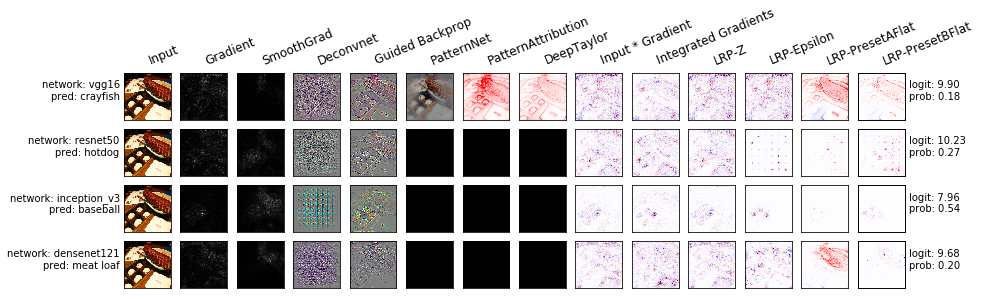

Image nr. 1, true label: bell pepper


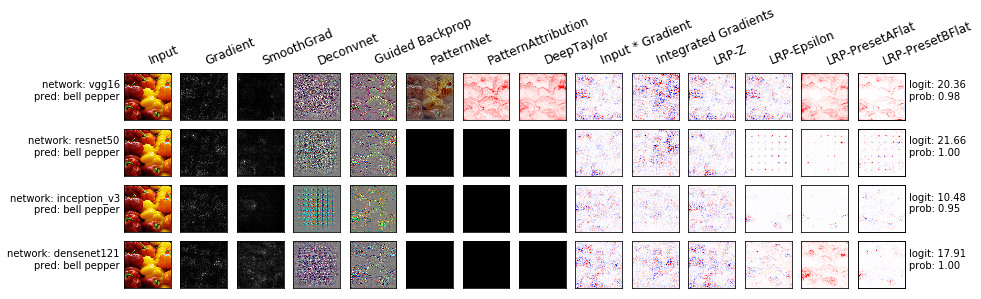

Image nr. 2, true label: ice lolly


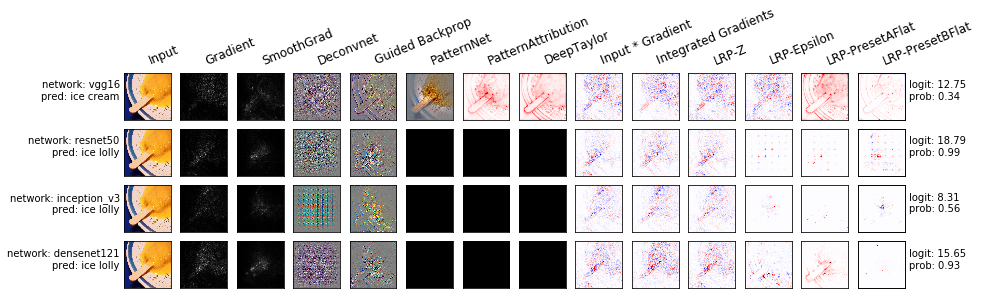

Image nr. 3, true label: broom


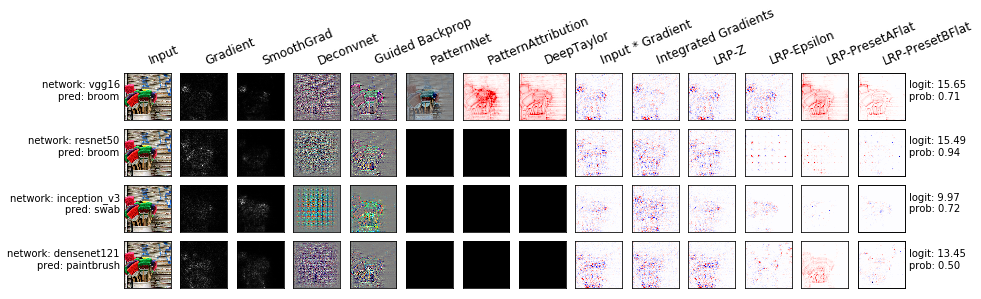

Image nr. 4, true label: abaya


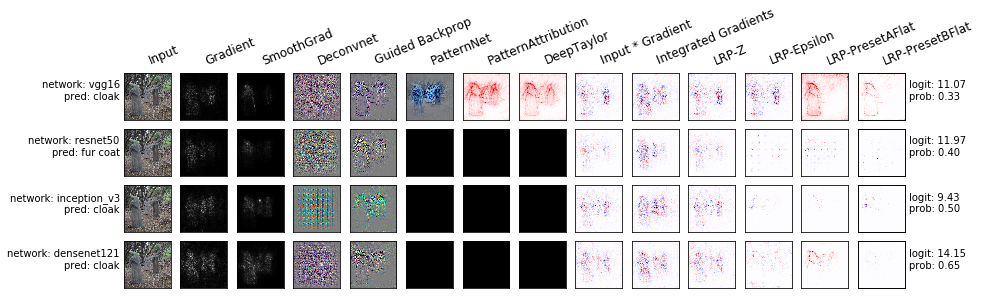

Image nr. 5, true label: Dungeness crab


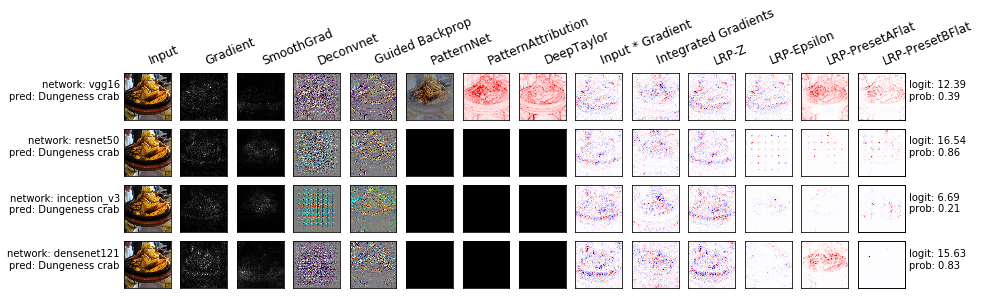

In [7]:
n_images = analyses[netnames[0]].shape[0]

# Prepare common labels
col_labels = [''.join(method[3]) for method in methods]

for image_index in range(n_images):
    grid = []
    row_labels_left = []
    row_labels_right = []
    
    for netname in netnames:
        analysis, text = analyses[netname], texts[netname]
        # Prepare the grid as rectengular list
        grid.append([analysis[image_index, j] for j in range(analysis.shape[1])])
        # Prepare the labels
        label, presm, prob, pred = zip(*text)
        label = label[image_index]
        row_labels_left.append(('network: {}'.format(netname),'pred: {}'.format(pred[image_index])))
        row_labels_right.append(('logit: {}'.format(presm[image_index]),'prob: {}'.format(prob[image_index])))

    # Plot the analysis.
    print("Image nr. {}, true label: {}".format(image_index, label))
    eutils.plot_image_grid(grid, row_labels_left, row_labels_right, col_labels,
                           file_name=os.environ.get("plot_file_name", None))

This figures show the analysis regarding the *actually predicted* class as computed by the selected analyzers. Each column shows the visualized results for different analyzers and each row shows the analyses wrt to one input sample. To the left of each row, the ground truth label `label` and the predicted label `pred` are show. To the right, the model's probabilistic (softmax) output is shown as `prob` and the logit output just before the terminating softmax layer as `logit`. Note that all analyses have been performed based on the logit output (layer).